In [1]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.linear_model import ElasticNetCV, ElasticNet
from sklearn.model_selection import RepeatedKFold
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import joblib
from sklearn.impute import SimpleImputer

In [ ]:
Clinical_Contineous_data = ['Baseline FVC Volume L',  'FEV1 Volume L', 'Age'
       ]

# Clinical_Categorical_data = [
#        'Primary Diagnosis_CHP', 'Primary Diagnosis_CTD-ILD',
#        'Primary Diagnosis_Emphysema', 'Primary Diagnosis_Exposure-related',
#        'Primary Diagnosis_Fibrotic HP (FHP)', 'Primary Diagnosis_INSIP',
#        'Primary Diagnosis_IPF', 'Primary Diagnosis_Idiopathic OP',
#        'Primary Diagnosis_Idiopathic pleuroparenchymal fibroelastosis (IPPFE)',
#        'Primary Diagnosis_Miscellaneous', 'Primary Diagnosis_NSIP',
#        'Primary Diagnosis_No information',
#        'Primary Diagnosis_Occupational-related ILD',
#        'Primary Diagnosis_Sarcoidosis',
#        'Primary Diagnosis_Smoking Related ILD (DIP / RB / RB-ILD)',
#        'Primary Diagnosis_UILD', 'Sex_Female', 'Sex_Male',
#        'Smoking History_Active Smoker', 'Smoking History_Ex Smoker',
#        'Smoking History_Never Smoker', 'Smoking History_No Knowledge']

Clinical_Categorical_data = ['Sex_Male', 'Primary Diagnosis_CTD-ILD', 'Primary Diagnosis_Exposure-related', 'Primary Diagnosis_Fibrotic HP (FHP)', 'Primary Diagnosis_INSIP', 'Primary Diagnosis_IPF', 'Primary Diagnosis_Idiopathic OP', 'Primary Diagnosis_Miscellaneous', 'Primary Diagnosis_No information', 'Primary Diagnosis_Occupational-related ILD', 'Primary Diagnosis_Sarcoidosis', 'Primary Diagnosis_Smoking Related ILD (DIP / RB / RB-ILD)', 'Primary Diagnosis_UILD', 'Smoking History_Ex Smoker', 'Smoking History_Never Smoker', 'Smoking History_No Knowledge']


In [3]:



def train_and_evaluate_elasticnet(X_train, X_test, y_train, y_test,
                                  feature_list, numeric_features, onehot_features,
                                  model_name="elasticnet_regression_pipeline.pkl"):

    print("Numeric features:", numeric_features)
    print("One-hot features:", onehot_features)
    print("number of features given as input:", len(numeric_features) + len(onehot_features))

    # ------------------------------
    # Preprocessor
    # ------------------------------
    preprocessor = ColumnTransformer(
        transformers=[
            ("num", StandardScaler(), numeric_features),
            ("onehot", "passthrough", onehot_features)
        ]
    )

    # Repeated 5-fold CV (15 folds total)
    rkf = RepeatedKFold(n_splits=5, n_repeats=3, random_state=42)

    # ------------------------------
    # Elastic Net with CV
    # ------------------------------
    pipeline = Pipeline([
        ("scaler", preprocessor),
        ("elasticnet", ElasticNetCV(
            l1_ratio = np.linspace(0.1, 1.0, 10),  # 0.70, 0.75, ..., 1.0
            alphas=np.logspace(-3.5, -1, 30),        # covers weak → strong regularization
            cv=rkf,
            n_jobs=-1,
            max_iter=100000,
            random_state=42
        ))
    ])

    # ------------------------------
    # Cross-validation performance
    # ------------------------------
    mae_scores, mse_scores, rmse_scores, r2_scores, fold_ids = [], [], [], [], []

    for repeat_idx, (train_idx, val_idx) in enumerate(rkf.split(X_train), start=1):
        pipeline.fit(X_train.iloc[train_idx], y_train.iloc[train_idx])
        y_val_pred = pipeline.predict(X_train.iloc[val_idx])
        y_val_true = y_train.iloc[val_idx]

        mae_scores.append(mean_absolute_error(y_val_true, y_val_pred))
        mse_scores.append(mean_squared_error(y_val_true, y_val_pred))
        rmse_scores.append(np.sqrt(mean_squared_error(y_val_true, y_val_pred)))
        r2_scores.append(r2_score(y_val_true, y_val_pred))
        fold_ids.append(repeat_idx)

    cv_results = pd.DataFrame({
        "RepeatFold": fold_ids,
        "MAE": mae_scores,
        "MSE": mse_scores,
        "RMSE": rmse_scores,
        "R2": r2_scores
    })

    print(f"MAE: {mae_scores}")
    print(f"MSE: {mse_scores}")
    # Convert each np.float64 to a normal float
    rmse = [float(x) for x in rmse_scores]
    print(f"RMSE: {rmse}")
    print(f"R2: {r2_scores}")
    print(cv_results)

    print("\nRepeated 5-Fold CV Results (15 runs):")
    print(cv_results.describe())

    # ------------------------------
    # Fit final model
    # ------------------------------
    pipeline.fit(X_train, y_train)
    y_test_pred = pipeline.predict(X_test)

    best_alpha = pipeline.named_steps["elasticnet"].alpha_
    best_l1_ratio = pipeline.named_steps["elasticnet"].l1_ratio_
    print(f"\nBest alpha chosen by ElasticNetCV: {best_alpha:.6f}")
    print(f"Best l1_ratio chosen by ElasticNetCV: {best_l1_ratio:.2f}")

        # ------------------------------
    # Evaluate on test set
    # ------------------------------
    test_mae = mean_absolute_error(y_test, y_test_pred)
    test_mse = mean_squared_error(y_test, y_test_pred)
    test_rmse = np.sqrt(test_mse)
    test_r2 = r2_score(y_test, y_test_pred)

    print("\nTest set performance:")
    print(f"- MAE:  {test_mae:.2f} L")
    print(f"- MSE:  {test_mse:.2f} L²")
    print(f"- RMSE: {test_rmse:.2f} L")
    print(f"- R²:   {test_r2:.3f}")

    # Training set performance
    y_train_pred = pipeline.predict(X_train)
    train_mae = mean_absolute_error(y_train, y_train_pred)
    train_mse = mean_squared_error(y_train, y_train_pred)
    train_rmse = np.sqrt(train_mse)
    train_r2 = r2_score(y_train, y_train_pred)

    print("\nTraining set performance:")
    print(f"- MAE:  {train_mae:.2f} L")
    print(f"- MSE:  {train_mse:.2f} L²")
    print(f"- RMSE: {train_rmse:.2f} L")
    print(f"- R²:   {train_r2:.3f}")

    # ------------------------------
    # Plot Training and Test R² vs alpha (for best l1_ratio)
    # ------------------------------
    enet_cv = pipeline.named_steps["elasticnet"]
    alphas = enet_cv.alphas_
    r2_train_scores, r2_test_scores = [], []

    # Scale training and test data using fitted preprocessor
    X_train_scaled = pipeline.named_steps["scaler"].transform(X_train)
    X_test_scaled = pipeline.named_steps["scaler"].transform(X_test)

    for a in alphas:
        enet = ElasticNet(alpha=a, l1_ratio=best_l1_ratio, max_iter=10000, random_state=42)
        enet.fit(X_train_scaled, y_train)

        r2_train_scores.append(r2_score(y_train, enet.predict(X_train_scaled)))
        r2_test_scores.append(r2_score(y_test, enet.predict(X_test_scaled)))

    plt.figure(figsize=(8, 6))
    plt.plot(np.log10(alphas), r2_train_scores, marker="o", label="Training R²")
    plt.plot(np.log10(alphas), r2_test_scores, marker="s", label="Test R²")
    plt.axvline(np.log10(best_alpha), color="red", linestyle="--",
                label=f"Best alpha = {best_alpha:.4f}")
    plt.xlabel("log10(alpha)")
    plt.ylabel("R² Score")
    plt.title(f"Elastic Net: Training vs Test R² (l1_ratio={best_l1_ratio:.2f})")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

   
    # ------------------------------
    # Plot MSE vs alpha (for best l1_ratio)
    # ------------------------------
    enet_cv = pipeline.named_steps["elasticnet"]

    alphas = enet_cv.alphas_
    mse_path = enet_cv.mse_path_

    # Handle both possible shapes of mse_path_
    if mse_path.ndim == 2:
        # Shape: (n_alphas, n_folds)
        mse_mean = mse_path.mean(axis=1)
        mse_std = mse_path.std(axis=1)

    elif mse_path.ndim == 3:
        # Shape: (n_l1_ratios, n_alphas, n_folds)
        # Find index of best l1_ratio
        l1_list = np.linspace(0.1, 1.0, 10)  # or whatever range you used
        best_idx = np.argmin(np.abs(l1_list - best_l1_ratio))

        mse_mean = mse_path[best_idx].mean(axis=1)
        mse_std = mse_path[best_idx].std(axis=1)

    else:
        raise ValueError("Unexpected mse_path_ shape")

    # Plot MSE vs alpha
    plt.figure(figsize=(8, 6))
    plt.errorbar(
        np.log10(alphas), mse_mean, yerr=mse_std,
        fmt='o-', color='blue', ecolor='lightgray', capsize=4,
        label="MSE ± std"
    )

    plt.axvline(np.log10(best_alpha), color="red", linestyle="--",
                label=f"Best alpha = {best_alpha:.4f}")

    plt.xlabel("log10(alpha)")
    plt.ylabel("Mean Squared Error")
    plt.title(f"ElasticNet: MSE vs alpha (l1_ratio={best_l1_ratio:.2f})")
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()



    # ------------------------------
    # Plot MSE vs l1_ratio using GridSearchCV
    # ------------------------------
    print("\nComputing MSE vs l1_ratio...")

    from sklearn.model_selection import GridSearchCV

    # Define search space for l1_ratio
    param_grid = {
        "elasticnet__l1_ratio": np.linspace(0.1, 1.0, 10)
    }

    # Grid search over l1_ratio
    grid = GridSearchCV(
        estimator=pipeline,
        param_grid=param_grid,
        scoring="neg_mean_squared_error",
        cv=rkf,
        n_jobs=-1
    )

    grid.fit(X_train, y_train)

    # Extract results
    l1_ratios = grid.cv_results_["param_elasticnet__l1_ratio"].data.astype(float)
    mse_mean = -grid.cv_results_["mean_test_score"]
    mse_std = grid.cv_results_["std_test_score"]

    # Plot
    plt.figure(figsize=(8, 6))
    plt.errorbar(
        l1_ratios, mse_mean, yerr=mse_std,
        fmt='o-', color='blue', ecolor='lightgray', capsize=4,
        label="MSE ± std"
    )

    plt.axvline(best_l1_ratio, color="red", linestyle="--",
                label=f"Best l1_ratio = {best_l1_ratio:.2f}")

    plt.xlabel("l1_ratio")
    plt.ylabel("Mean Squared Error")
    plt.title("ElasticNet: MSE vs l1_ratio")
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()

    



    # ------------------------------
    # Inspect coefficients
    # ------------------------------
    coefs = pipeline.named_steps["elasticnet"].coef_
    feature_names = pipeline.named_steps["scaler"].get_feature_names_out()
    clean_feature_names = [name.split("__")[-1] for name in feature_names]

    coef_df = pd.DataFrame({
        "Feature": clean_feature_names,
        "Coefficient": coefs,
        "AbsCoefficient": np.abs(coefs)
    }).sort_values(by="AbsCoefficient", ascending=False)

    print("\nModel coefficients (sorted by |coef|):")
    print(coef_df[["Feature", "Coefficient"]])

    # Selected features (non-zero coefficients)
    selected_features = coef_df[coef_df["Coefficient"] != 0]["Feature"].tolist()
    print(f"\nSelected features (non-zero): {selected_features}")
    print(f"\nSelected features (non-zero): {len(selected_features)}")

    plt.figure(figsize=(8, 6))
    sns.barplot(
        data=coef_df.sort_values(by="AbsCoefficient", ascending=True),
        x="Coefficient", y="Feature", palette="viridis"
    )
    plt.title("Elastic Net Regression Coefficients")
    plt.xlabel("Coefficient")
    plt.ylabel("Feature")
    plt.tight_layout()
    plt.show()

    # ------------------------------
    # Predicted vs Actual Plot
    # ------------------------------
    plt.figure(figsize=(7, 6))
    sns.scatterplot(x=y_test, y=y_test_pred, alpha=0.7)
    plt.plot([y_test.min(), y_test.max()],
             [y_test.min(), y_test.max()],
             color="red", linestyle="--", label="Perfect Prediction")
    plt.xlabel("Actual Values (L)")
    plt.ylabel("Predicted Values (L)")
    plt.title("Predicted vs Actual (Test Set)")
    plt.legend()
    plt.tight_layout()
    plt.show()

    # ------------------------------
    # Residual Plot
    # ------------------------------
    residuals = y_test - y_test_pred
    plt.figure(figsize=(7, 6))
    sns.scatterplot(x=y_test_pred, y=residuals, alpha=0.7)
    plt.axhline(0, color="red", linestyle="--")
    plt.xlabel("Predicted Values (L)")
    plt.ylabel("Residuals (L)")
    plt.title("Residual Plot (Test Set)")
    plt.tight_layout()
    plt.show()

        # ------------------------------
    # Worst 5 patients (largest errors)
    # ------------------------------
    errors = np.abs(y_test - y_test_pred)
    error_df = pd.DataFrame({
        "Baseline_FVC": X_test["Baseline FVC Volume L"].values if "Baseline FVC Volume L" in X_test.columns else np.nan,
        "Target_FVC": y_test.values,
        "Predicted_FVC": y_test_pred,
        "Abs_Error": errors,
        "Baseline_FVC_Week": X_test["Baseline FVC Week"].values if "Baseline FVC Week" in X_test.columns else np.nan,
        "Followup_FVC_Week": X_test["Followup FVC Week"].values if "Followup FVC Week" in X_test.columns else np.nan,
    })

    worst5 = error_df.sort_values(by="Abs_Error", ascending=False).head(5)
    print("\nTop 5 patients with largest errors:")
    print(worst5)

    for idx, row in worst5.iterrows():
        patient_df = pd.DataFrame({
            "Week": [row["Baseline_FVC_Week"], row["Followup_FVC_Week"]],
            "Actual_FVC": [row["Baseline_FVC"], row["Target_FVC"]],
            "Predicted_FVC": [row["Baseline_FVC"], row["Predicted_FVC"]]
        })
        plot_df = patient_df.melt(id_vars="Week",
                                  value_vars=["Actual_FVC", "Predicted_FVC"],
                                  var_name="Type", value_name="FVC")
        plt.figure(figsize=(7, 5))
        sns.lineplot(data=plot_df, x="Week", y="FVC", hue="Type", marker="o")
        plt.title(f"Patient {idx}: Actual vs Predicted FVC (Worst Error)")
        plt.xlabel("Week")
        plt.ylabel("FVC (Liters)")
        plt.tight_layout()
        plt.show()

    # ------------------------------
    # Best 5 patients (increasing FVC + lowest error)
    # ------------------------------
    increasing = error_df["Target_FVC"] > error_df["Baseline_FVC"]
    best_patients = error_df[increasing].sort_values(by="Abs_Error", ascending=True).head(5)

    print("\nTop 5 patients with increasing FVC and lowest error:")
    print(best_patients)

    for idx, row in best_patients.iterrows():
        patient_df = pd.DataFrame({
            "Week": [row["Baseline_FVC_Week"], row["Followup_FVC_Week"]],
            "Actual_FVC": [row["Baseline_FVC"], row["Target_FVC"]],
            "Predicted_FVC": [row["Baseline_FVC"], row["Predicted_FVC"]]
        })

        plot_df = patient_df.melt(id_vars="Week",
                                value_vars=["Actual_FVC", "Predicted_FVC"],
                                var_name="Type", value_name="FVC")

        plt.figure(figsize=(7, 5))
        sns.lineplot(data=plot_df, x="Week", y="FVC", hue="Type", marker="o")
        plt.title(f"Patient {idx}: Actual vs Predicted FVC (Low Error, Increasing FVC)")
        plt.xlabel("Week")
        plt.ylabel("FVC (Liters)")
        plt.legend(title="Measurement")
        plt.tight_layout()
        plt.show()

    import shap

    # Extract model and preprocessor
    lasso_model = pipeline.named_steps["elasticnet"]
    preprocessor = pipeline.named_steps["scaler"]

    # Transform data
    X_train_scaled = preprocessor.transform(X_train)
    X_test_scaled = preprocessor.transform(X_test)

    # Get feature names
    feature_names = preprocessor.get_feature_names_out()

    # Create explainer
    explainer = shap.LinearExplainer(lasso_model, X_train_scaled, feature_perturbation="interventional")

    # First compute shap_values
    raw_shap_values = explainer(X_test_scaled)

    # Now wrap into Explanation object with feature names
    shap_values = shap.Explanation(values=raw_shap_values.values,
                                base_values=raw_shap_values.base_values,
                                data=X_test_scaled,
                                feature_names=feature_names)

    # Example: waterfall plot for one patient
    patient_index = 0
    shap.plots.waterfall(shap_values[patient_index])

    shap.summary_plot(shap_values, X_test_scaled, max_display=5)
    shap.plots.beeswarm(shap_values)

    shap.summary_plot(shap_values, X_test_scaled, plot_type="bar", max_display=5)


    # ------------------------------
    # Save model
    # ------------------------------
    joblib.dump(pipeline, model_name)

    return {
        "cv_results": cv_results,
        "test_results": {
            "MAE": test_mae,
            "MSE": test_mse,
            "RMSE": test_rmse,
            "R2": test_r2
        },
        "coef_df": coef_df
    }


In [ ]:
# def train_and_evaluate_elasticnet(
#         X_train, X_test, y_train, y_test,
#         feature_list, numeric_features, onehot_features,
#         model_name="elasticnet_regression_pipeline.pkl"):

#     print("Numeric features:", numeric_features)
#     print("One-hot features:", onehot_features)
#     print("Total features:", len(numeric_features) + len(onehot_features))

#     # ---------------------------------------------------------
#     # PREPROCESSOR
#     # ---------------------------------------------------------
#     preprocessor = ColumnTransformer(
#         transformers=[
#             ("num", StandardScaler(), numeric_features),
#             ("onehot", "passthrough", onehot_features)
#         ]
#     )

#     # ---------------------------------------------------------
#     # ELASTICNETCV (THIS DOES ALL CV AUTOMATICALLY)
#     # ---------------------------------------------------------
#     rkf = RepeatedKFold(n_splits=5, n_repeats=3, random_state=42)

#     elastic = ElasticNetCV(
#         l1_ratio=np.linspace(0.1, 1, 10),
#         alphas=np.logspace(-3.5, 1, 30),
#         cv=rkf,
#         n_jobs=-1,
#         max_iter=300000,
#         random_state=42
#     )

#     pipeline = Pipeline([
#         ("scaler", preprocessor),
#         ("elasticnet", elastic)
#     ])

#     # ---------------------------------------------------------
#     # FIT FINAL MODEL (CV HAPPENS INSIDE ElasticNetCV)
#     # ---------------------------------------------------------
#     print("\nTraining ElasticNetCV (this includes all CV folds)...")
#     pipeline.fit(X_train, y_train)

#     best_alpha = pipeline.named_steps["elasticnet"].alpha_
#     best_l1 = pipeline.named_steps["elasticnet"].l1_ratio_

#     print(f"\nBest alpha: {best_alpha:.6f}")
#     print(f"Best l1_ratio: {best_l1:.3f}")

#     # ---------------------------------------------------------
#     # TRAINING PERFORMANCE
#     # ---------------------------------------------------------
#     y_train_pred = pipeline.predict(X_train)
#     train_mae = mean_absolute_error(y_train, y_train_pred)
#     train_mse = mean_squared_error(y_train, y_train_pred)
#     train_rmse = np.sqrt(train_mse)
#     train_r2 = r2_score(y_train, y_train_pred)

#     print("\nTraining performance:")
#     print(f"MAE:  {train_mae:.3f}")
#     print(f"MSE:  {train_mse:.3f}")
#     print(f"RMSE: {train_rmse:.3f}")
#     print(f"R²:   {train_r2:.3f}")

#     # ---------------------------------------------------------
#     # TEST PERFORMANCE
#     # ---------------------------------------------------------
#     y_test_pred = pipeline.predict(X_test)
#     test_mae = mean_absolute_error(y_test, y_test_pred)
#     test_mse = mean_squared_error(y_test, y_test_pred)
#     test_rmse = np.sqrt(test_mse)
#     test_r2 = r2_score(y_test, y_test_pred)

#     print("\nTest performance:")
#     print(f"MAE:  {test_mae:.3f}")
#     print(f"MSE:  {test_mse:.3f}")
#     print(f"RMSE: {test_rmse:.3f}")
#     print(f"R²:   {test_r2:.3f}")

#     # ---------------------------------------------------------
#     # PER-FOLD CV METRICS (FAST, NO DUPLICATE FITTING)
#     # ---------------------------------------------------------
#     cv_mae, cv_mse, cv_rmse, cv_r2 = [], [], [], []

#     for train_idx, val_idx in rkf.split(X_train):
#         X_tr = X_train.iloc[train_idx]
#         y_tr = y_train.iloc[train_idx]
#         X_val = X_train.iloc[val_idx]
#         y_val = y_train.iloc[val_idx]

#         X_tr_scaled = pipeline.named_steps["scaler"].transform(X_tr)
#         X_val_scaled = pipeline.named_steps["scaler"].transform(X_val)

#         enet = ElasticNet(
#             alpha=best_alpha,
#             l1_ratio=best_l1,
#             max_iter=10000,
#             random_state=42
#         )
#         enet.fit(X_tr_scaled, y_tr)

#         y_pred = enet.predict(X_val_scaled)

#         cv_mae.append(mean_absolute_error(y_val, y_pred))
#         cv_mse.append(mean_squared_error(y_val, y_pred))
#         cv_rmse.append(np.sqrt(mean_squared_error(y_val, y_pred)))
#         cv_r2.append(r2_score(y_val, y_pred))

#     print("\n=== Per-fold CV Metrics (15 folds) ===")
#     print("MAE per fold:", cv_mae)
#     print("MSE per fold:", cv_mse)
#     print("RMSE per fold:", cv_rmse)
#     print("R² per fold:", cv_r2)

#     print("\n=== CV Mean ± Std ===")
#     print(f"MAE:  {np.mean(cv_mae):.4f} ± {np.std(cv_mae):.4f}")
#     print(f"MSE:  {np.mean(cv_mse):.4f} ± {np.std(cv_mse):.4f}")
#     print(f"RMSE: {np.mean(cv_rmse):.4f} ± {np.std(cv_rmse):.4f}")
#     print(f"R²:   {np.mean(cv_r2):.4f} ± {np.std(cv_r2):.4f}")

#     # ---------------------------------------------------------
#     # CV PATH (MSE vs alpha)
#     # ---------------------------------------------------------
#     enet_cv = pipeline.named_steps["elasticnet"]
#     alphas = enet_cv.alphas_
#     mse_path = enet_cv.mse_path_

#     if mse_path.ndim == 3:
#         l1_list = np.linspace(0.1, 1, 10)
#         best_idx = np.argmin(np.abs(l1_list - best_l1))
#         mse_mean = mse_path[best_idx].mean(axis=1)
#         mse_std = mse_path[best_idx].std(axis=1)
#     else:
#         mse_mean = mse_path.mean(axis=1)
#         mse_std = mse_path.std(axis=1)

#     # ---------------------------------------------------------
#     # PLOT 1: MSE vs alpha
#     # ---------------------------------------------------------
#     plt.figure(figsize=(8, 6))
#     plt.errorbar(
#         np.log10(alphas), mse_mean, yerr=mse_std,
#         fmt="o-", color="blue", ecolor="gray", capsize=4,
#         label="MSE ± std"
#     )
#     plt.axvline(np.log10(best_alpha), color="red", linestyle="--",
#                 label=f"Best alpha = {best_alpha:.4f}")
#     plt.xlabel("log10(alpha)")
#     plt.ylabel("Mean Squared Error")
#     plt.title(f"ElasticNet: MSE vs alpha (l1_ratio={best_l1:.2f})")
#     plt.legend()
#     plt.grid(True)
#     plt.tight_layout()
#     plt.show()
#     plt.close()

#     # # ---------------------------------------------------------
#     # # PLOT 2: Training vs Test R² vs alpha
#     # # ---------------------------------------------------------
#     # X_train_scaled = pipeline.named_steps["scaler"].transform(X_train)
#     # X_test_scaled = pipeline.named_steps["scaler"].transform(X_test)

#     # r2_train_scores = []
#     # r2_test_scores = []

#     # for a in alphas:
#     #     enet = ElasticNet(alpha=a, l1_ratio=best_l1, max_iter=10000)
#     #     enet.fit(X_train_scaled, y_train)
#     #     r2_train_scores.append(r2_score(y_train, enet.predict(X_train_scaled)))
#     #     r2_test_scores.append(r2_score(y_test, enet.predict(X_test_scaled)))

#     # plt.figure(figsize=(8, 6))
#     # plt.plot(np.log10(alphas), r2_train_scores, marker="o", label="Training R²")
#     # plt.plot(np.log10(alphas), r2_test_scores, marker="s", label="Test R²")
#     # plt.axvline(np.log10(best_alpha), color="red", linestyle="--",
#     #             label=f"Best alpha = {best_alpha:.4f}")
#     # plt.xlabel("log10(alpha)")
#     # plt.ylabel("R² Score")
#     # plt.title(f"ElasticNet: Training vs Test R² (l1_ratio={best_l1:.2f})")
#     # plt.legend()
#     # plt.grid(True)
#     # plt.tight_layout()
#     # plt.show()
#     # plt.close()

   


#     # ---------------------------------------------------------
#     # COEFFICIENTS
#     # ---------------------------------------------------------
#     coefs = enet_cv.coef_
#     feature_names = pipeline.named_steps["scaler"].get_feature_names_out()
#     clean_names = [f.split("__")[-1] for f in feature_names]

#     coef_df = pd.DataFrame({
#         "Feature": clean_names,
#         "Coefficient": coefs,
#         "AbsCoefficient": np.abs(coefs)
#     }).sort_values("AbsCoefficient", ascending=False)

#     print("\nTop coefficients:")
#     print(coef_df.head(20))

#      # Selected features (non-zero coefficients)
#     selected_features = coef_df[coef_df["Coefficient"] != 0]["Feature"].tolist()
#     print(f"\nSelected features (non-zero): {selected_features}")
#     print(f"\nSelected features (non-zero): {len(selected_features)}")

#     # ---------------------------------------------------------
#     # PLOT 3: Coefficient barplot
#     # ---------------------------------------------------------
#     plt.figure(figsize=(8, 10))
#     sns.barplot(
#         data=coef_df.sort_values("AbsCoefficient", ascending=True),
#         x="Coefficient", y="Feature", palette="viridis"
#     )
#     plt.title("ElasticNet Coefficients")
#     plt.tight_layout()
#     plt.show()
#     plt.close()

#     # ------------------------------
#     # Predicted vs Actual Plot
#     # ------------------------------
#     plt.figure(figsize=(7, 6))
#     sns.scatterplot(x=y_test, y=y_test_pred, alpha=0.7)
#     plt.plot([y_test.min(), y_test.max()],
#              [y_test.min(), y_test.max()],
#              color="red", linestyle="--", label="Perfect Prediction")
#     plt.xlabel("Actual Values (L)")
#     plt.ylabel("Predicted Values (L)")
#     plt.title("Predicted vs Actual (Test Set)")
#     plt.legend()
#     plt.tight_layout()
#     plt.show()

#     # ------------------------------
#     # Residual Plot
#     # ------------------------------
#     residuals = y_test - y_test_pred
#     plt.figure(figsize=(7, 6))
#     sns.scatterplot(x=y_test_pred, y=residuals, alpha=0.7)
#     plt.axhline(0, color="red", linestyle="--")
#     plt.xlabel("Predicted Values (L)")
#     plt.ylabel("Residuals (L)")
#     plt.title("Residual Plot (Test Set)")
#     plt.tight_layout()
#     plt.show()

#         # ------------------------------
#     # Worst 5 patients (largest errors)
#     # ------------------------------
#     errors = np.abs(y_test - y_test_pred)
#     error_df = pd.DataFrame({
#         "Baseline_FVC": X_test["Baseline FVC Volume L"].values if "Baseline FVC Volume L" in X_test.columns else np.nan,
#         "Target_FVC": y_test.values,
#         "Predicted_FVC": y_test_pred,
#         "Abs_Error": errors,
#         "Baseline_FVC_Week": X_test["Baseline FVC Week"].values if "Baseline FVC Week" in X_test.columns else np.nan,
#         "Followup_FVC_Week": X_test["Followup FVC Week"].values if "Followup FVC Week" in X_test.columns else np.nan,
#     })

#     worst5 = error_df.sort_values(by="Abs_Error", ascending=False).head(5)
#     print("\nTop 5 patients with largest errors:")
#     print(worst5)

#     for idx, row in worst5.iterrows():
#         patient_df = pd.DataFrame({
#             "Week": [row["Baseline_FVC_Week"], row["Followup_FVC_Week"]],
#             "Actual_FVC": [row["Baseline_FVC"], row["Target_FVC"]],
#             "Predicted_FVC": [row["Baseline_FVC"], row["Predicted_FVC"]]
#         })
#         plot_df = patient_df.melt(id_vars="Week",
#                                   value_vars=["Actual_FVC", "Predicted_FVC"],
#                                   var_name="Type", value_name="FVC")
#         plt.figure(figsize=(7, 5))
#         sns.lineplot(data=plot_df, x="Week", y="FVC", hue="Type", marker="o")
#         plt.title(f"Patient {idx}: Actual vs Predicted FVC (Worst Error)")
#         plt.xlabel("Week")
#         plt.ylabel("FVC (Liters)")
#         plt.tight_layout()
#         plt.show()

#     # ------------------------------
#     # Best 5 patients (increasing FVC + lowest error)
#     # ------------------------------
#     increasing = error_df["Target_FVC"] > error_df["Baseline_FVC"]
#     best_patients = error_df[increasing].sort_values(by="Abs_Error", ascending=True).head(5)

#     print("\nTop 5 patients with increasing FVC and lowest error:")
#     print(best_patients)

#     for idx, row in best_patients.iterrows():
#         patient_df = pd.DataFrame({
#             "Week": [row["Baseline_FVC_Week"], row["Followup_FVC_Week"]],
#             "Actual_FVC": [row["Baseline_FVC"], row["Target_FVC"]],
#             "Predicted_FVC": [row["Baseline_FVC"], row["Predicted_FVC"]]
#         })

#         plot_df = patient_df.melt(id_vars="Week",
#                                 value_vars=["Actual_FVC", "Predicted_FVC"],
#                                 var_name="Type", value_name="FVC")

#         plt.figure(figsize=(7, 5))
#         sns.lineplot(data=plot_df, x="Week", y="FVC", hue="Type", marker="o")
#         plt.title(f"Patient {idx}: Actual vs Predicted FVC (Low Error, Increasing FVC)")
#         plt.xlabel("Week")
#         plt.ylabel("FVC (Liters)")
#         plt.legend(title="Measurement")
#         plt.tight_layout()
#         plt.show()

#     import shap

#     # Extract model and preprocessor
#     lasso_model = pipeline.named_steps["elasticnet"]
#     preprocessor = pipeline.named_steps["scaler"]

#     # Transform data
#     X_train_scaled = preprocessor.transform(X_train)
#     X_test_scaled = preprocessor.transform(X_test)

#     # Get feature names
#     feature_names = preprocessor.get_feature_names_out()

#     # Create explainer
#     explainer = shap.LinearExplainer(lasso_model, X_train_scaled, feature_perturbation="interventional")

#     # First compute shap_values
#     raw_shap_values = explainer(X_test_scaled)

#     # Now wrap into Explanation object with feature names
#     shap_values = shap.Explanation(values=raw_shap_values.values,
#                                 base_values=raw_shap_values.base_values,
#                                 data=X_test_scaled,
#                                 feature_names=feature_names)

#     # Example: waterfall plot for one patient
#     patient_index = 0
#     shap.plots.waterfall(shap_values[patient_index])

#     shap.summary_plot(shap_values, X_test_scaled, max_display=5)
#     shap.plots.beeswarm(shap_values)

#     shap.summary_plot(shap_values, X_test_scaled, plot_type="bar", max_display=5)


#     # ------------------------------
#     # Save model
#     # ------------------------------
#     joblib.dump(pipeline, model_name)

#     return {
#         "test_results": {
#             "MAE": test_mae,
#             "MSE": test_mse,
#             "RMSE": test_rmse,
#             "R2": test_r2
#         },
#         "coef_df": coef_df
#     }




/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


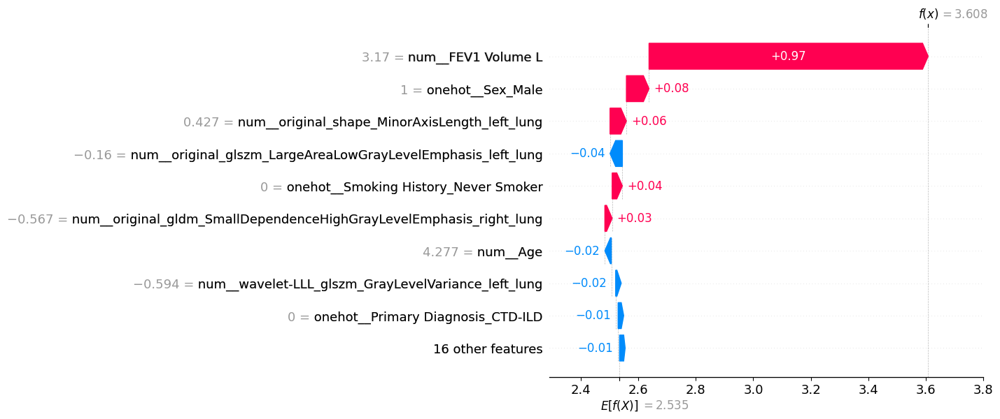

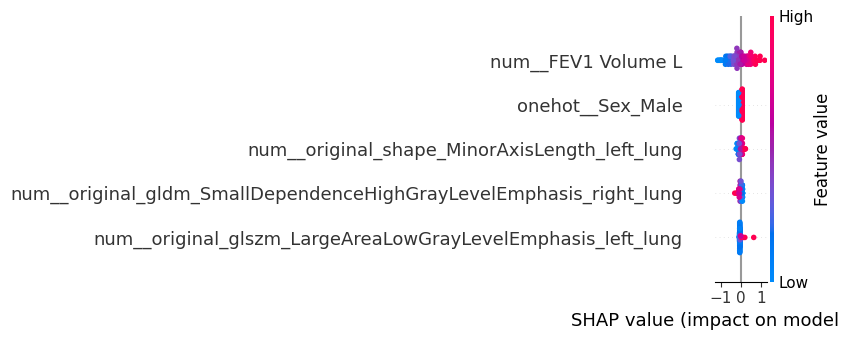

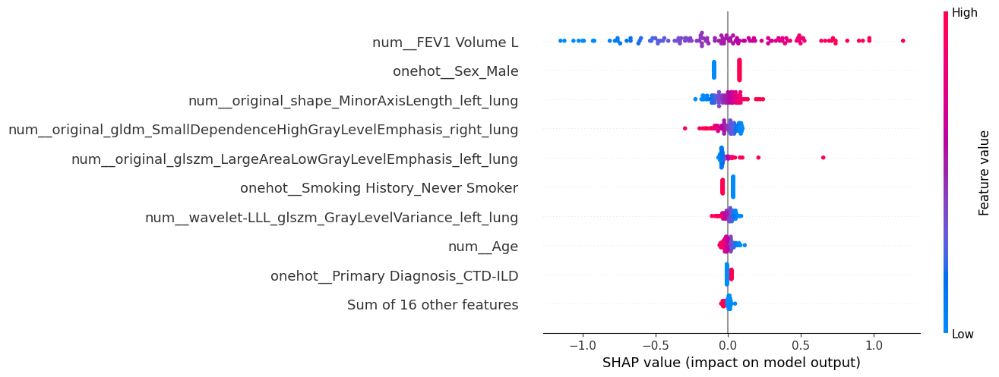

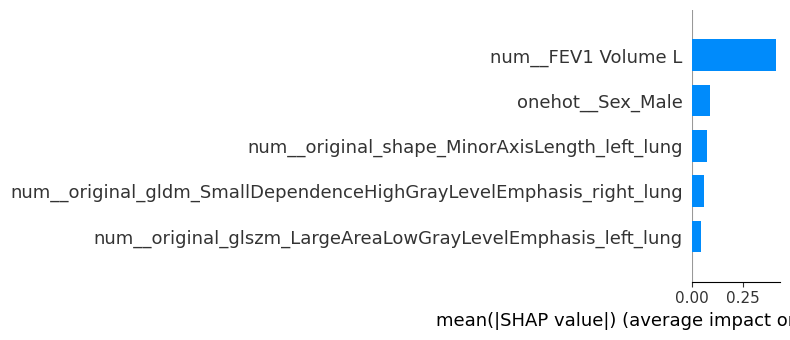

In [32]:
import shap
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_with_clinical_harmonization.pkl")
X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)
model = joblib.load("/home/pansurya/OSIC_thesis/EN_model/PAM_mrmr_VIF_EN_with_harmonizationPycombat.pkl")
# Extract model and preprocessor
lasso_model = model.named_steps["elasticnet"]
preprocessor = model.named_steps["scaler"]

# Transform data
X_train_scaled = preprocessor.transform(X_train_median_filled)
X_test_scaled = preprocessor.transform(X_test_median_filled)

# Get feature names
feature_names = preprocessor.get_feature_names_out()

# Create explainer
explainer = shap.LinearExplainer(lasso_model, X_train_scaled, feature_perturbation="interventional")

# First compute shap_values
raw_shap_values = explainer(X_test_scaled)

# Now wrap into Explanation object with feature names
shap_values = shap.Explanation(values=raw_shap_values.values,
                            base_values=raw_shap_values.base_values,
                            data=X_test_scaled,
                            feature_names=feature_names)

# Example: waterfall plot for one patient
patient_index = 0
shap.plots.waterfall(shap_values[patient_index])

shap.summary_plot(shap_values, X_test_scaled, max_display=5)
shap.plots.beeswarm(shap_values)

shap.summary_plot(shap_values, X_test_scaled, plot_type="bar", max_display=5)

In [ ]:
# # all combined radiomics + clinical features
# X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_clinical_without_harmonization.pkl")
# # Radiomics: automatically grab all columns with certain prefixes
# Radiomics_data = [col for col in X_train.columns 
#                   if col.startswith(("wavelet", "original", "log-sigma"))]
# all_features = Clinical_Contineous_data + Radiomics_data


# X_train_clini_log = X_train.copy()
# X_test_clini_log  = X_test.copy()

# # Transform Age
# for col in ['Age']:
#     X_train_clini_log[col] = np.log(X_train_clini_log[col])
#     X_test_clini_log[col] = np.log(X_test_clini_log[col])

# # Median imputation (only needed if missing values exist)
# imp_median = SimpleImputer(strategy='median')
# imp_median.fit(X_train_clini_log)

# X_train_median_filled = pd.DataFrame(
#     imp_median.transform(X_train_clini_log),
#     columns=X_train_clini_log.columns,
#     index=X_train_clini_log.index
# )

# X_test_median_filled = pd.DataFrame(
#     imp_median.transform(X_test_clini_log),
#     columns=X_test_clini_log.columns,
#     index=X_test_clini_log.index
# )

# results1 = train_and_evaluate_elasticnet(X_train_median_filled, X_test_median_filled, y_train, y_test, all_features, all_features, Clinical_Categorical_data, model_name="/home/pansurya/OSIC_thesis/EN_model/EN_With_All_Clinical_Radiomics_without_harmonization_50Resampling.pkl")

['Baseline FVC Volume L', 'FEV1 Volume L', 'Age']
Numeric features: ['Baseline FVC Volume L', 'FEV1 Volume L', 'Age']
One-hot features: ['Sex_Male', 'Primary Diagnosis_CTD-ILD', 'Primary Diagnosis_Exposure-related', 'Primary Diagnosis_Fibrotic HP (FHP)', 'Primary Diagnosis_INSIP', 'Primary Diagnosis_IPF', 'Primary Diagnosis_Idiopathic OP', 'Primary Diagnosis_Miscellaneous', 'Primary Diagnosis_No information', 'Primary Diagnosis_Occupational-related ILD', 'Primary Diagnosis_Sarcoidosis', 'Primary Diagnosis_Smoking Related ILD (DIP / RB / RB-ILD)', 'Primary Diagnosis_UILD', 'Smoking History_Ex Smoker', 'Smoking History_Never Smoker', 'Smoking History_No Knowledge']
number of features given as input: 19
MAE: [0.29755739461979647, 0.247154837223055, 0.23215462770960998, 0.25416195181560336, 0.21032855617928237, 0.2468143070409831, 0.2103681334133155, 0.22696624664419265, 0.22970401863655357, 0.33009893284185293, 0.2605913217440159, 0.2294990226725046, 0.22249154235036356, 0.243490590545402

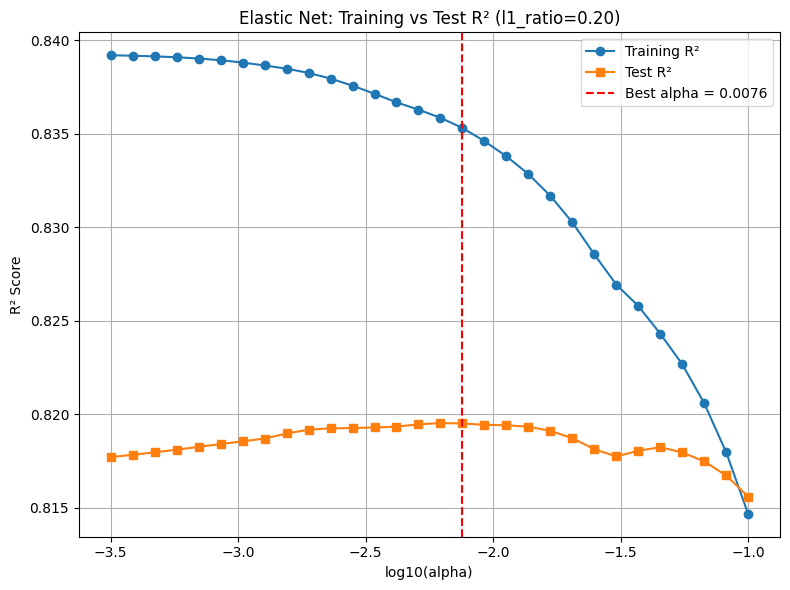

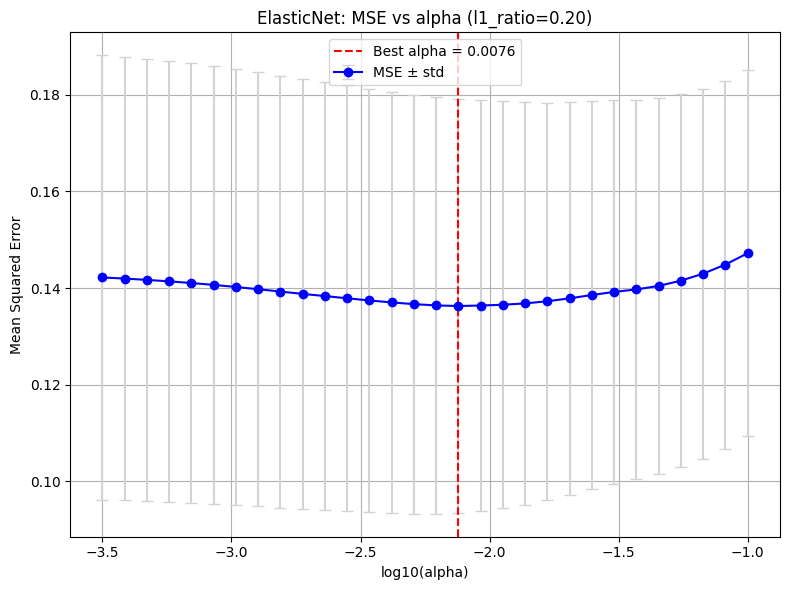


Computing MSE vs l1_ratio...


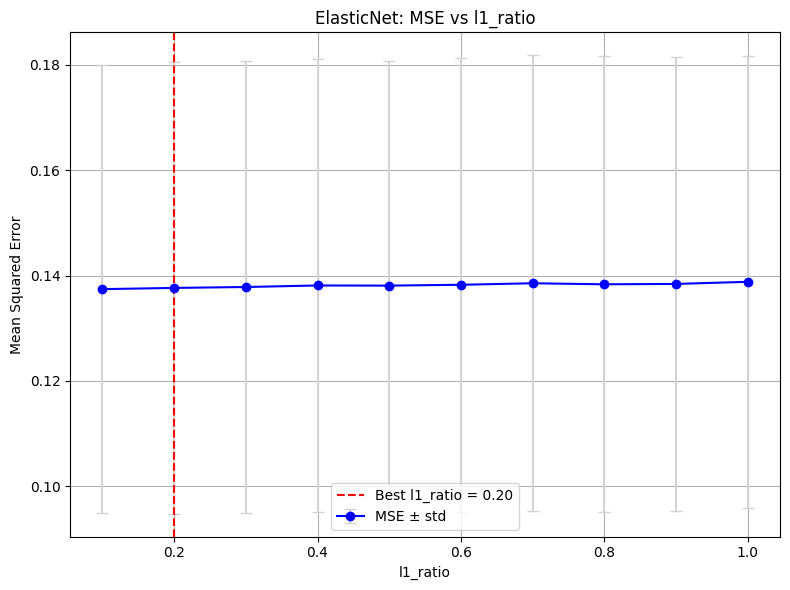


Model coefficients (sorted by |coef|):
                                              Feature  Coefficient
0                               Baseline FVC Volume L     0.760355
7                             Primary Diagnosis_INSIP     0.285460
17                       Smoking History_Never Smoker    -0.124490
16                          Smoking History_Ex Smoker    -0.087435
3                                            Sex_Male     0.080822
15                             Primary Diagnosis_UILD    -0.066839
2                                                 Age    -0.065028
8                               Primary Diagnosis_IPF    -0.029516
5                  Primary Diagnosis_Exposure-related     0.028021
4                           Primary Diagnosis_CTD-ILD     0.001787
1                                       FEV1 Volume L     0.000324
10                    Primary Diagnosis_Miscellaneous     0.000000
9                     Primary Diagnosis_Idiopathic OP     0.000000
6                 Prim

/tmp/ipykernel_4059943/2091552719.py:262: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


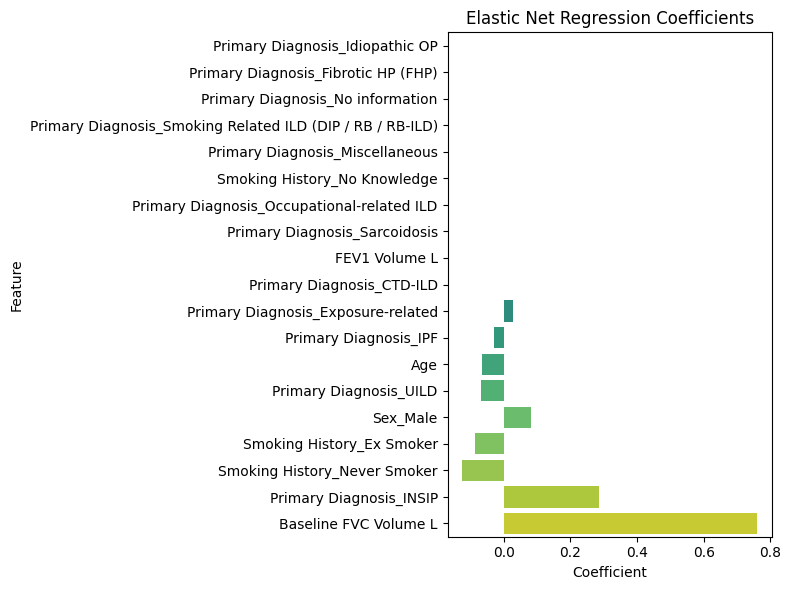

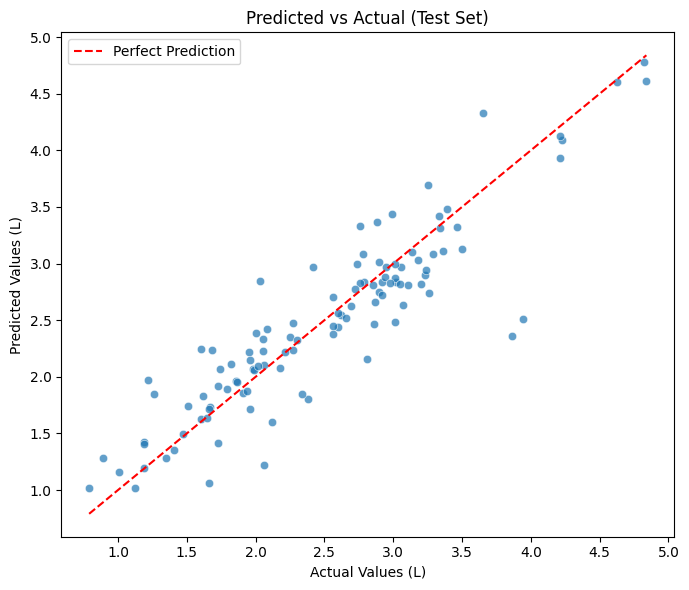

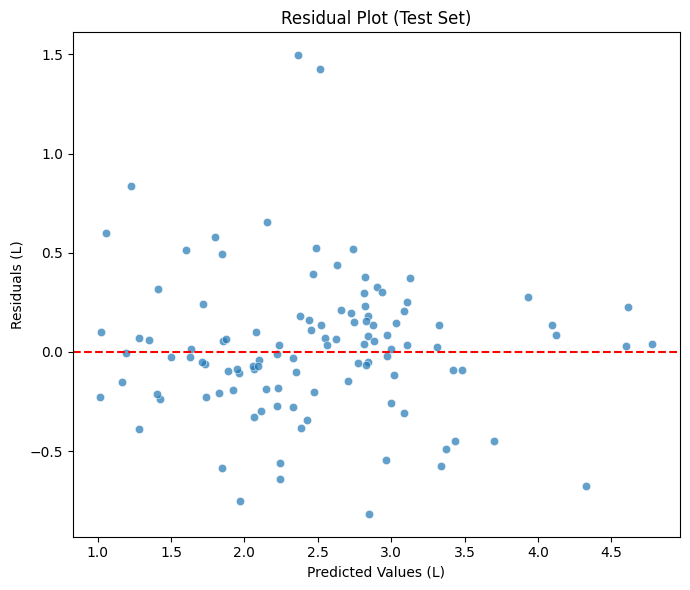


Top 5 patients with largest errors:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
587799           2.36        3.86       2.364232   1.495768   
1001085          2.50        3.94       2.514324   1.425676   
151493           1.16        2.06       1.224936   0.835064   
1001201          2.97        2.03       2.846427   0.816427   
1001175          1.98        1.22       1.970198   0.750198   

         Baseline_FVC_Week  Followup_FVC_Week  
587799                 0.0               56.0  
1001085                0.0               48.0  
151493                 0.0               50.0  
1001201                0.0               54.0  
1001175                0.0               54.0  


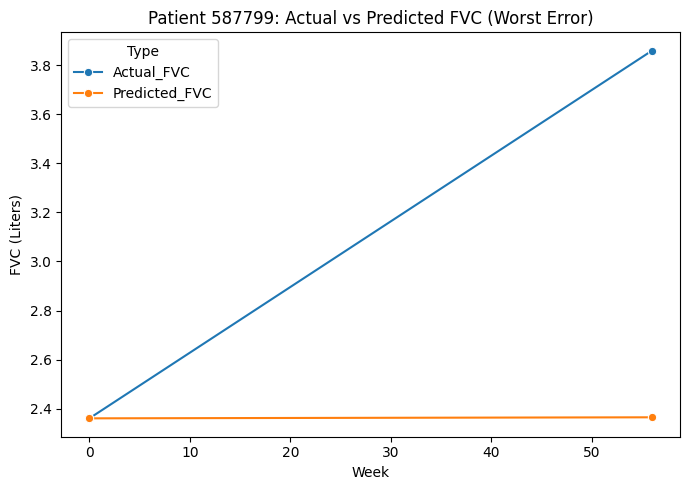

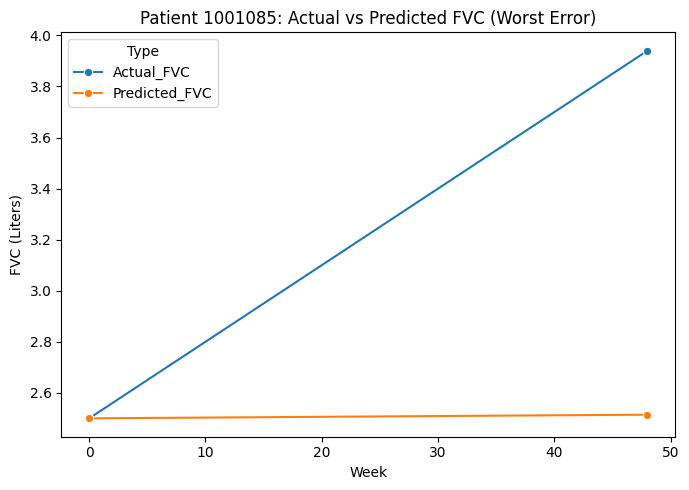

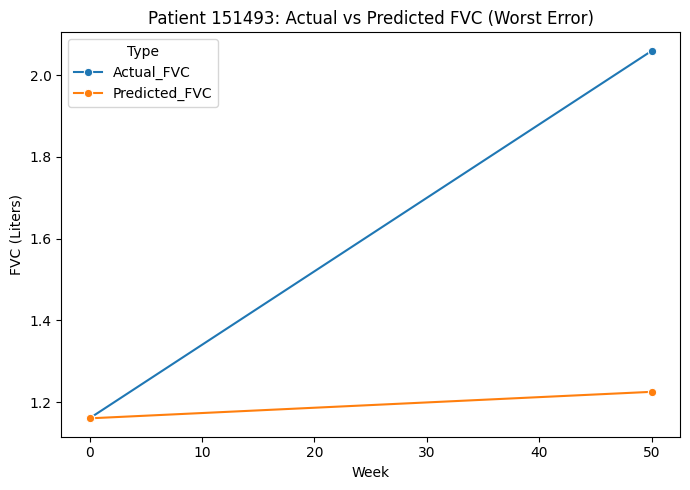

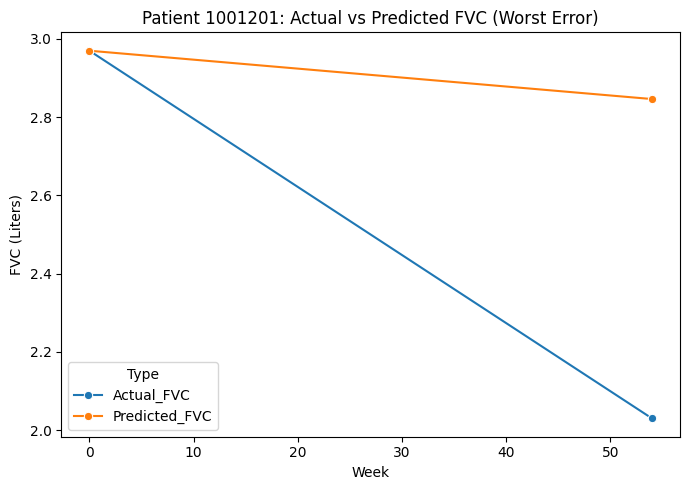

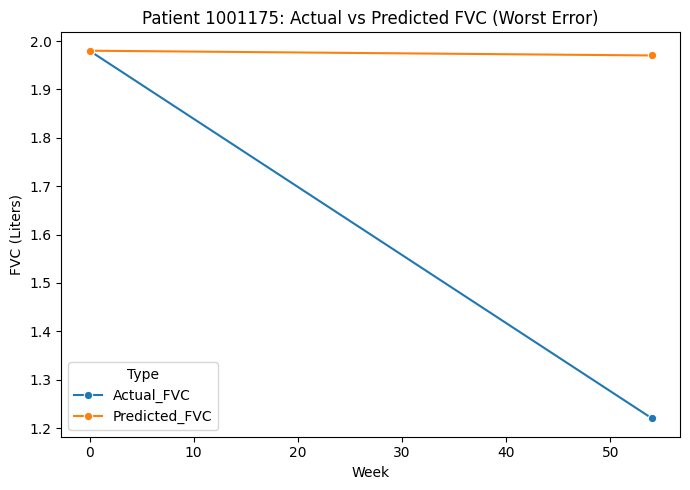


Top 5 patients with increasing FVC and lowest error:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
1001371          1.59        1.60       1.627430   0.027430   
1000634          2.55        2.60       2.563937   0.036063   
1001176          1.32        1.41       1.352420   0.057580   
1001354          1.82        1.94       1.873695   0.066305   
1000960          1.34        1.35       1.281314   0.068686   

         Baseline_FVC_Week  Followup_FVC_Week  
1001371                0.0               50.0  
1000634                0.0               52.0  
1001176                0.0               52.0  
1001354                0.0               52.0  
1000960                0.0               48.0  


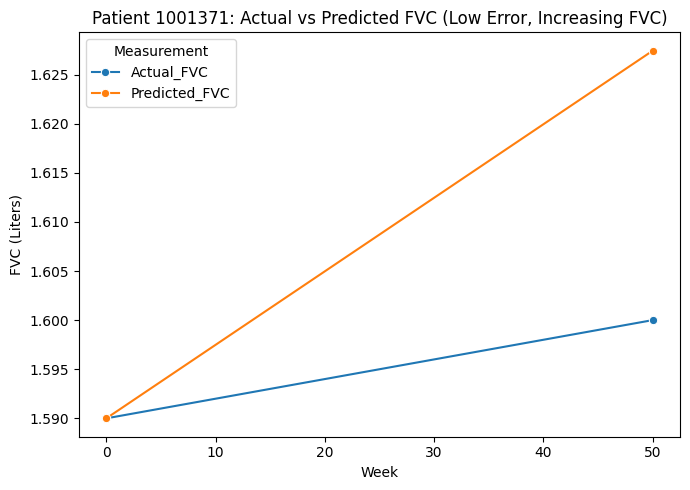

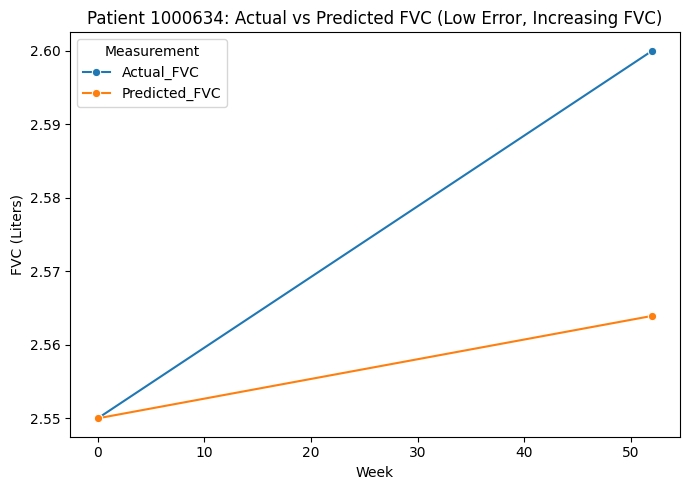

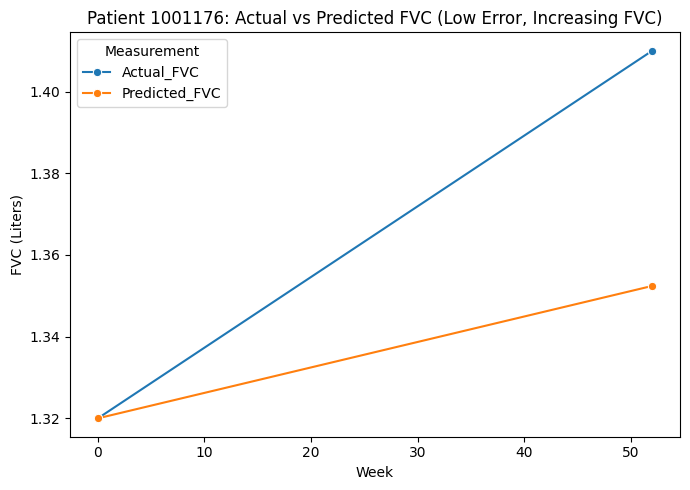

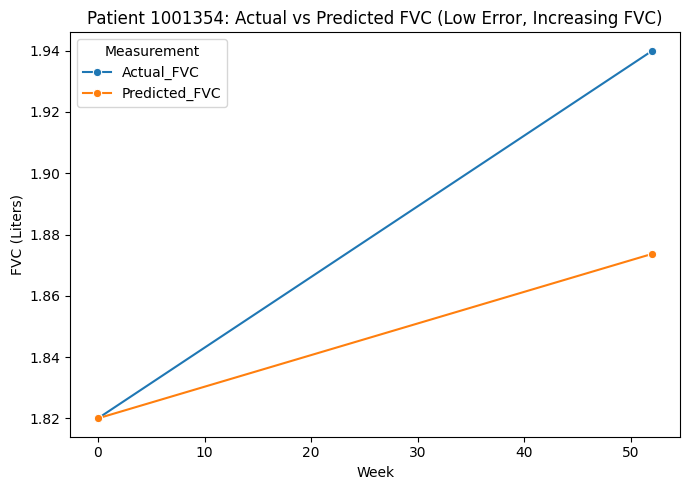

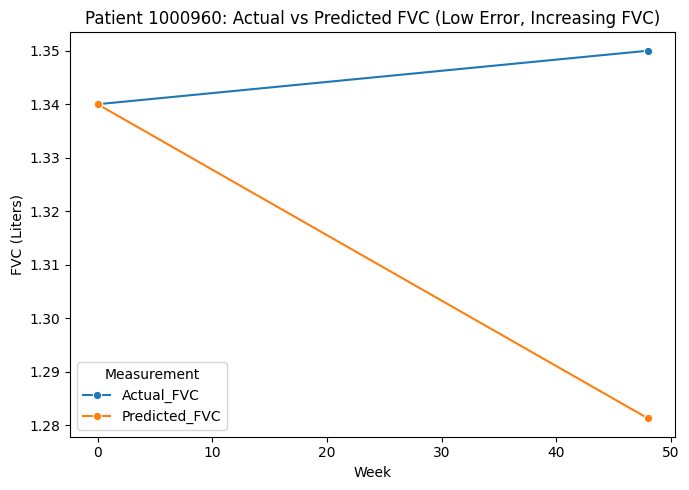

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


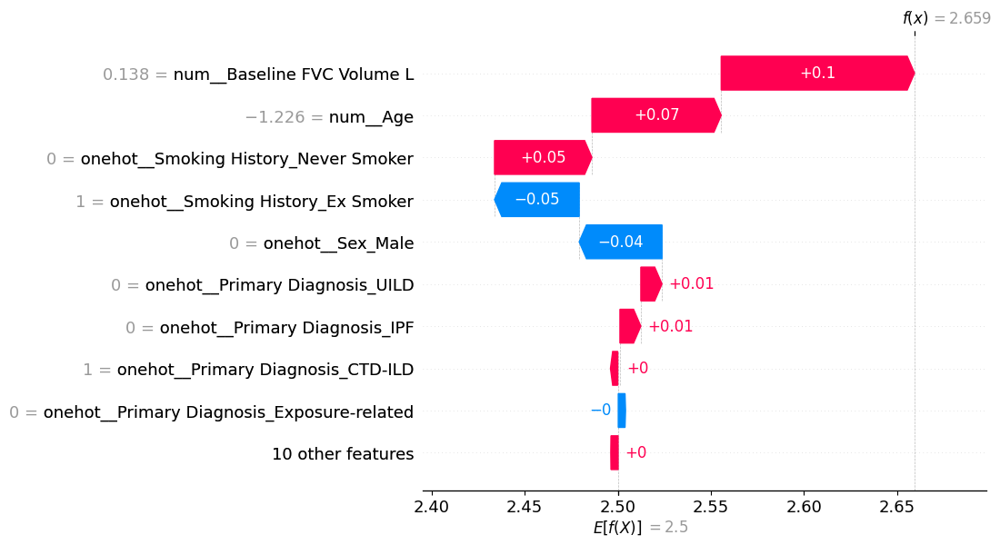

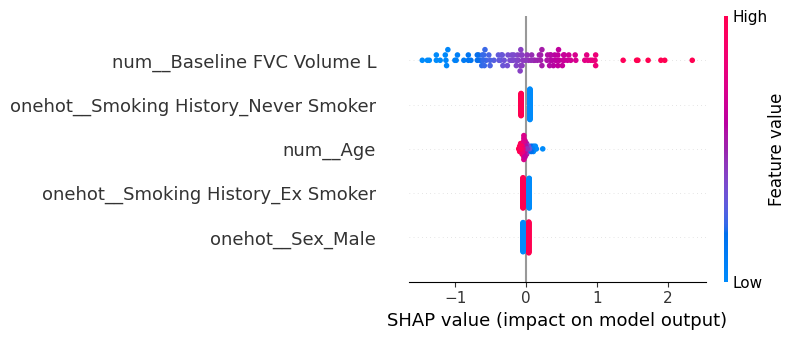

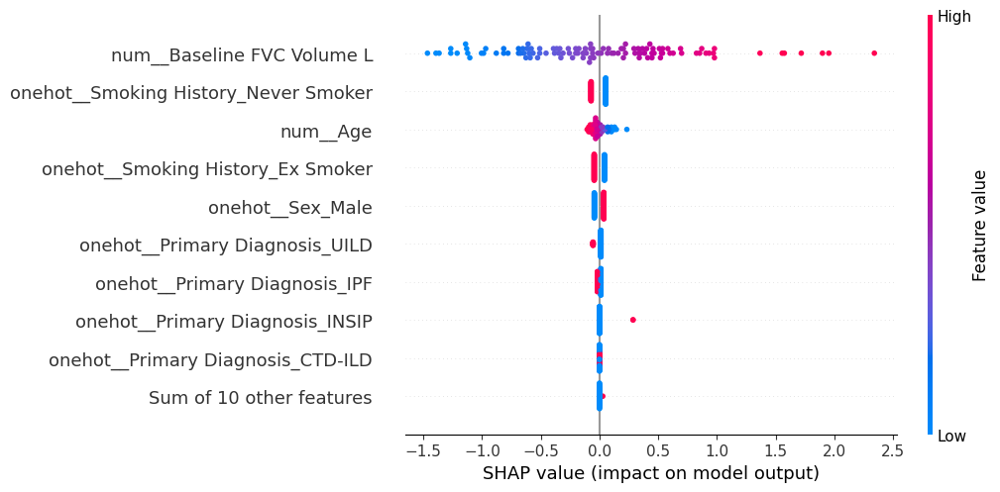

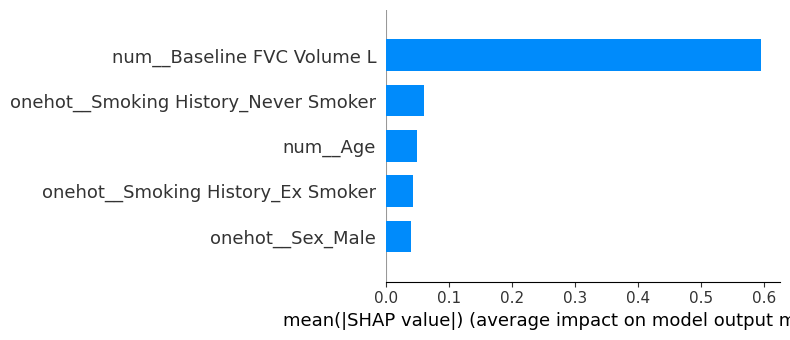

In [4]:
#all clinical-only features
selected_features = []

Clinical_Contineous_data_ext = selected_features + Clinical_Contineous_data
print(Clinical_Contineous_data_ext)
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_with_clinical_harmonization.pkl")
X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)
# Run experiments
results1 = train_and_evaluate_elasticnet(X_train_median_filled, X_test_median_filled, y_train, y_test, selected_features, Clinical_Contineous_data_ext, Clinical_Categorical_data, 
                                         model_name="/home/pansurya/OSIC_thesis/EN_model/all_clinical-only_features_EN_without_harmonization.pkl")


Model Training using Selected Features

PAM Clustering

['wavelet-LLL_glszm_GrayLevelVariance_left_lung', 'original_shape_MinorAxisLength_left_lung', 'original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung', 'original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung', 'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung', 'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung', 'Baseline FVC Volume L', 'FEV1 Volume L', 'Age']
Numeric features: ['wavelet-LLL_glszm_GrayLevelVariance_left_lung', 'original_shape_MinorAxisLength_left_lung', 'original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung', 'original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung', 'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung', 'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung', 'Baseline FVC Volume L', 'FEV1 Volume L', 'Age']
One-hot features: ['Sex_Male', 'Primary Diagnosis_CTD-ILD', 'Primary Diagnosis_Exposure-related', 'Primary Diagnosis_Fibrotic HP (FHP)', 'Primary Diagnosis_INSIP', 'Primary Diagnosis_IPF

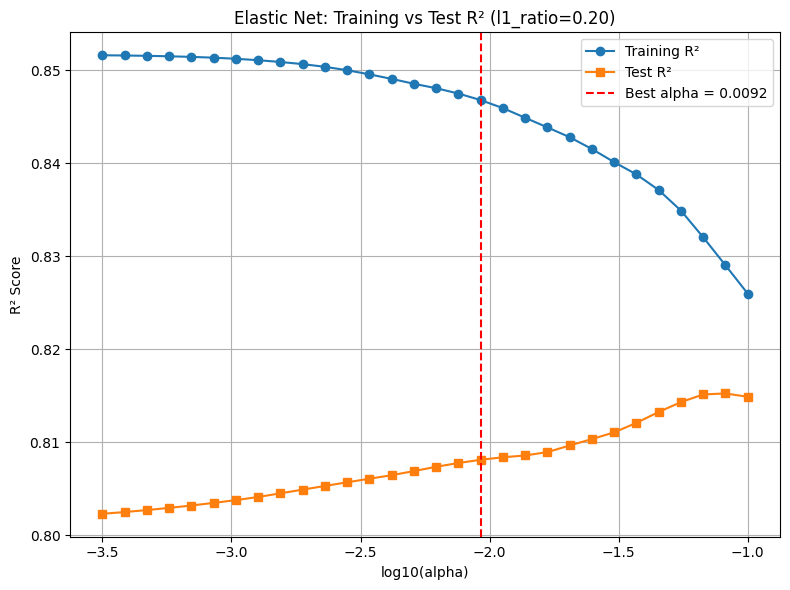

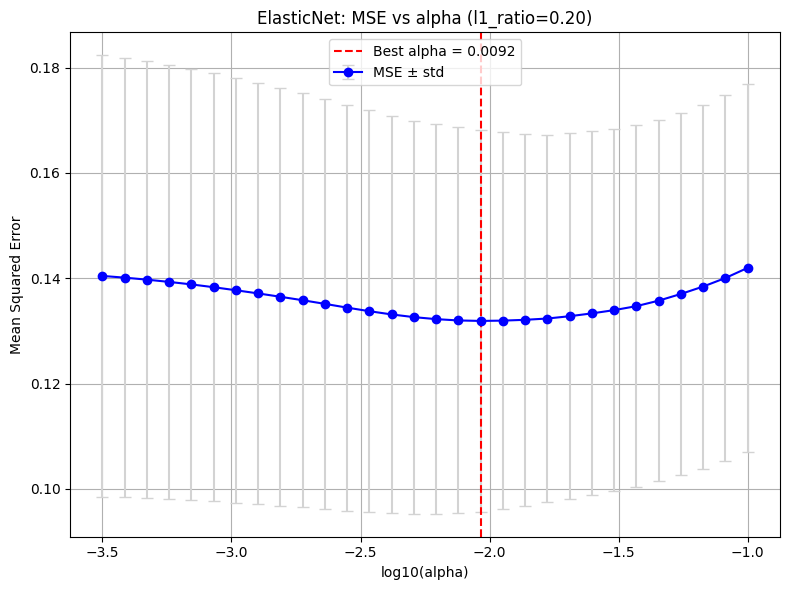


Computing MSE vs l1_ratio...


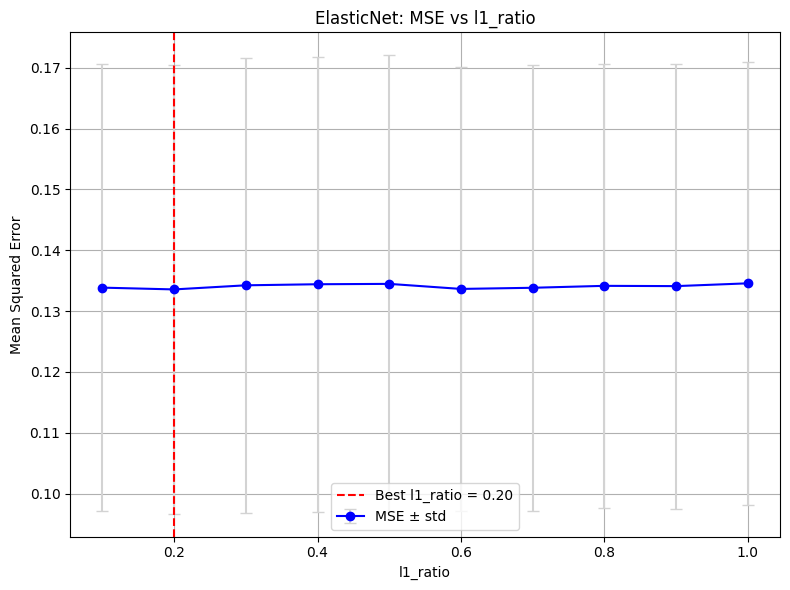


Model coefficients (sorted by |coef|):
                                              Feature  Coefficient
6                               Baseline FVC Volume L     0.672473
13                            Primary Diagnosis_INSIP     0.240301
9                                            Sex_Male     0.107037
21                             Primary Diagnosis_UILD    -0.075464
23                       Smoking History_Never Smoker    -0.072900
8                                                 Age    -0.071206
2   original_gldm_SmallDependenceHighGrayLevelEmph...    -0.061302
5   log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGr...    -0.054655
1            original_shape_MinorAxisLength_left_lung     0.049167
11                 Primary Diagnosis_Exposure-related     0.048925
0       wavelet-LLL_glszm_GrayLevelVariance_left_lung    -0.037021
3   original_glszm_LargeAreaLowGrayLevelEmphasis_l...     0.036633
10                          Primary Diagnosis_CTD-ILD     0.032184
22                    

/tmp/ipykernel_4059943/2091552719.py:262: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


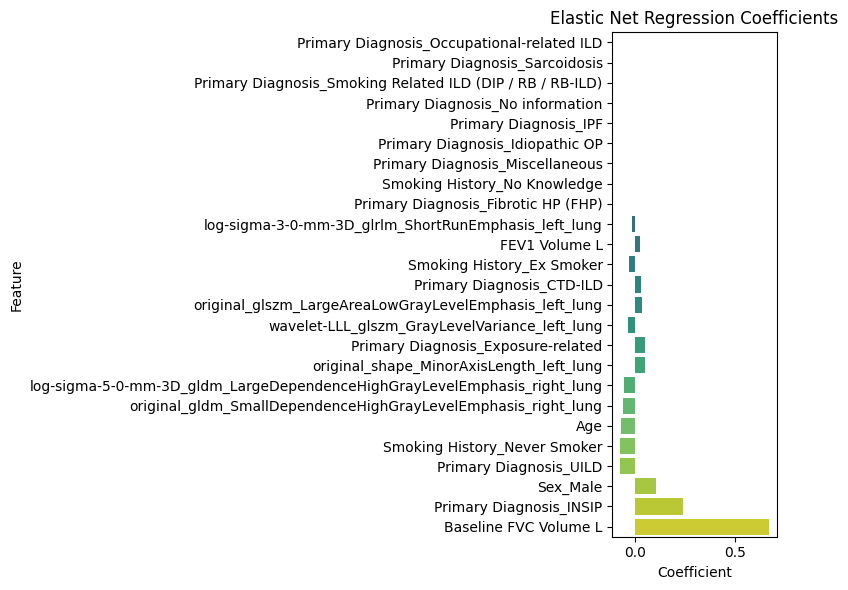

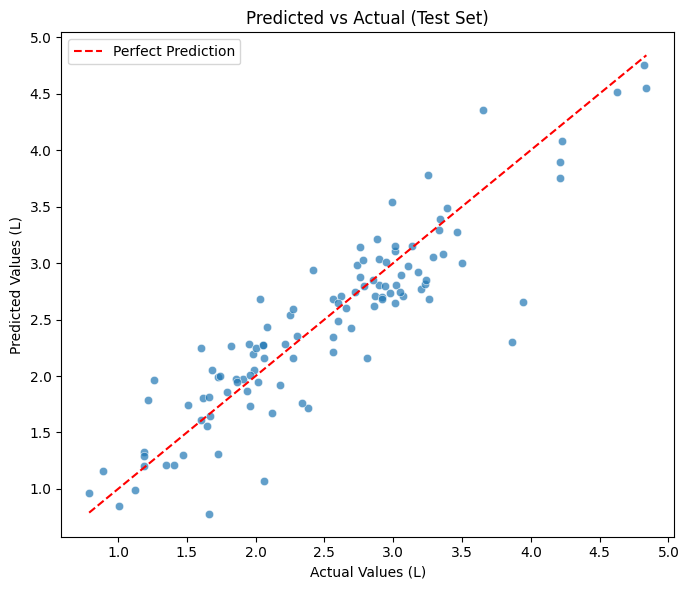

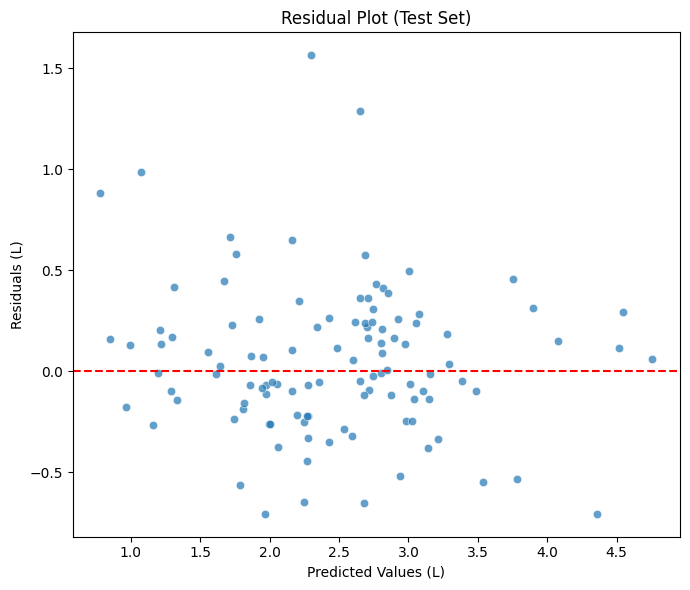


Top 5 patients with largest errors:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
587799           2.36        3.86       2.296766   1.563234   
1001085          2.50        3.94       2.653705   1.286295   
151493           1.16        2.06       1.073867   0.986133   
888514           1.02        1.66       0.779964   0.880036   
273452           4.47        3.65       4.355397   0.705397   

         Baseline_FVC_Week  Followup_FVC_Week  
587799                 0.0               56.0  
1001085                0.0               48.0  
151493                 0.0               50.0  
888514                 0.0               48.0  
273452                 0.0               48.0  


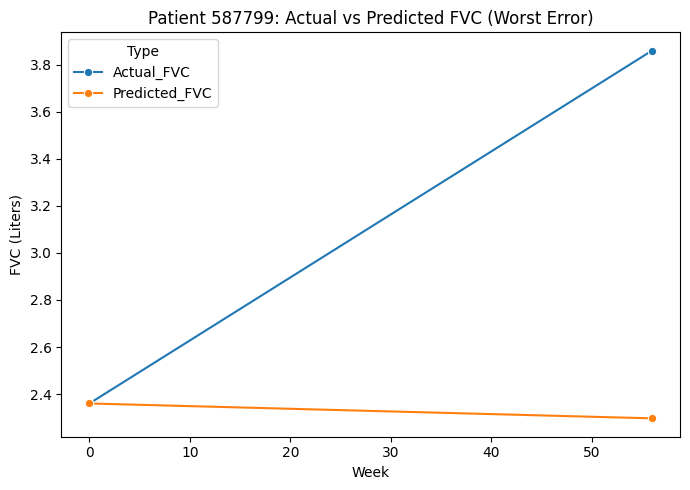

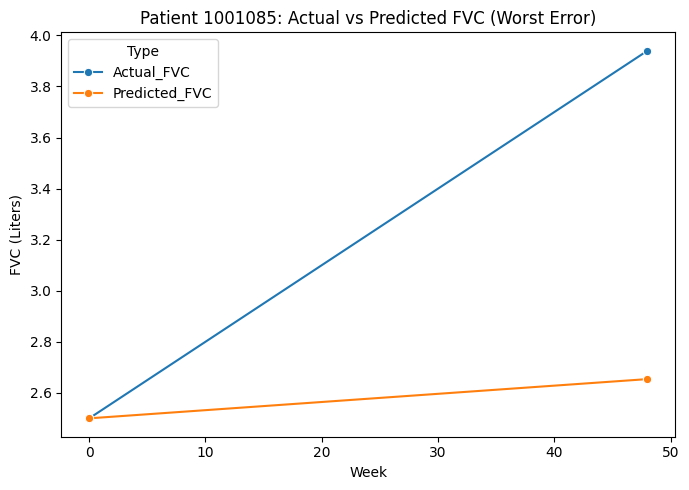

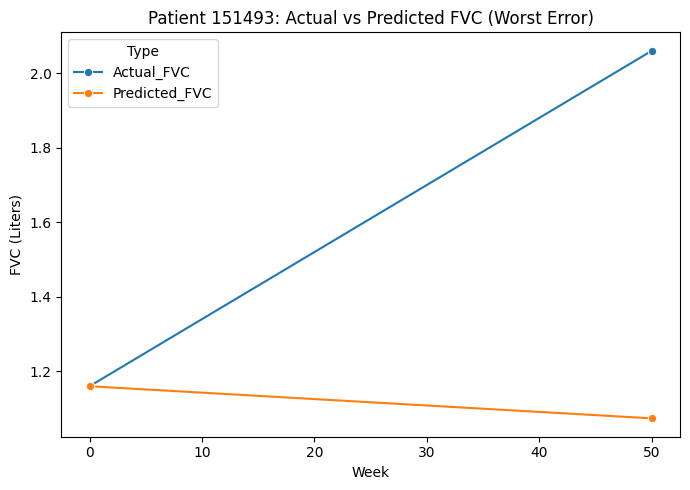

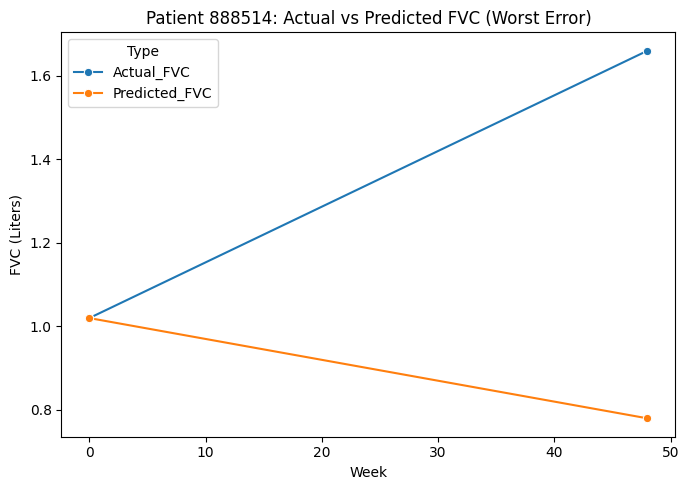

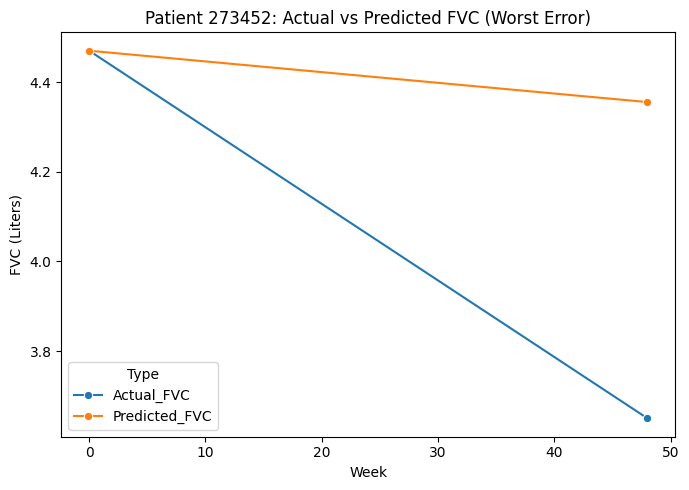


Top 5 patients with increasing FVC and lowest error:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
1001371          1.59        1.60       1.612778   0.012778   
1000634          2.55        2.60       2.650132   0.050132   
1000550          2.65        2.66       2.603021   0.056979   
1001354          1.82        1.94       1.864939   0.075061   
523961           2.79        2.90       2.809197   0.090803   

         Baseline_FVC_Week  Followup_FVC_Week  
1001371                0.0               50.0  
1000634                0.0               52.0  
1000550                0.0               52.0  
1001354                0.0               52.0  
523961                 0.0               51.0  


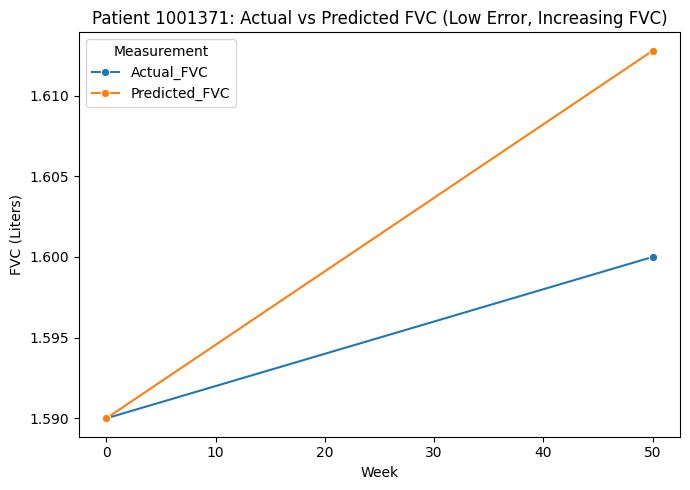

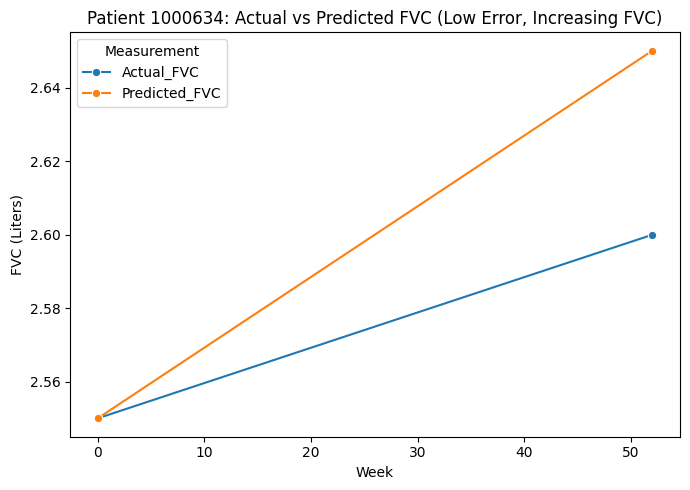

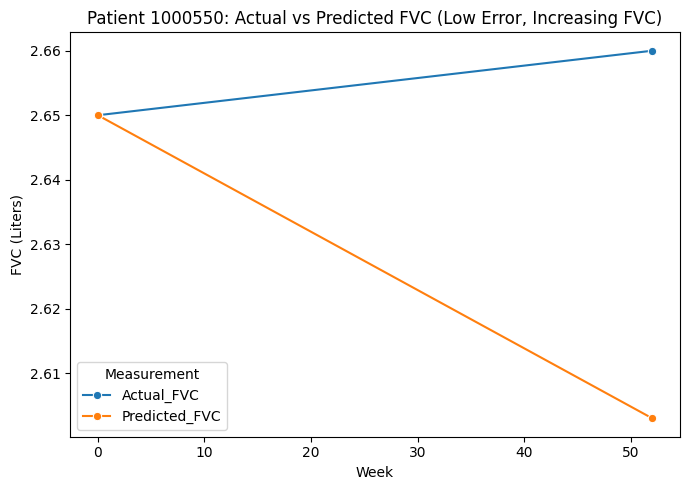

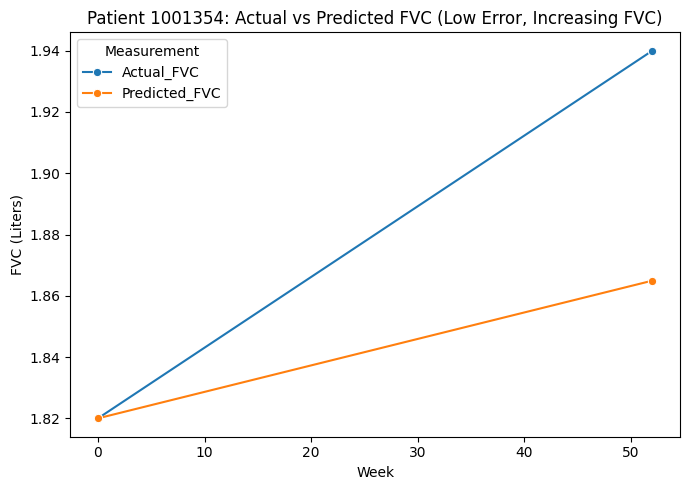

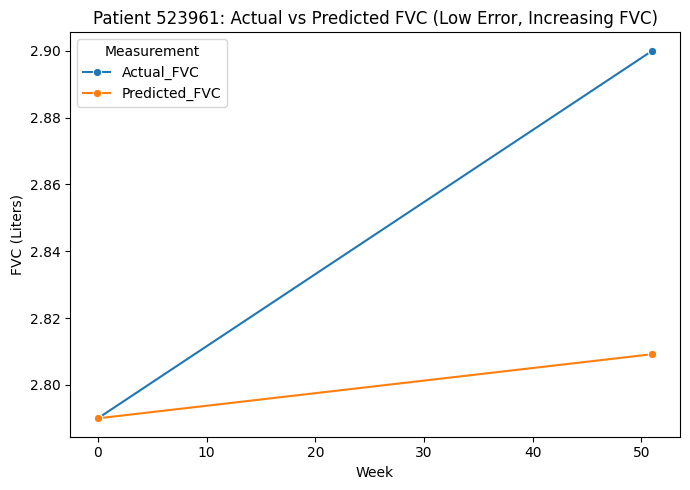

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


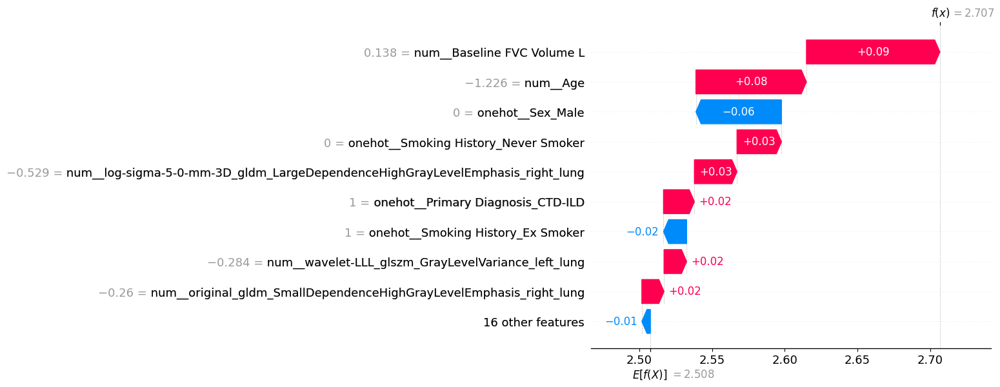

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/plots/_beeswarm.py:1150: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


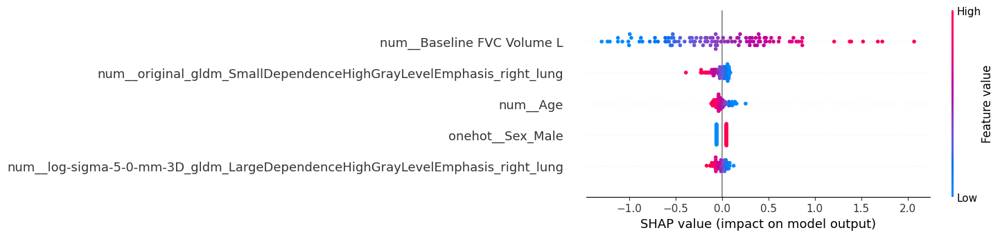

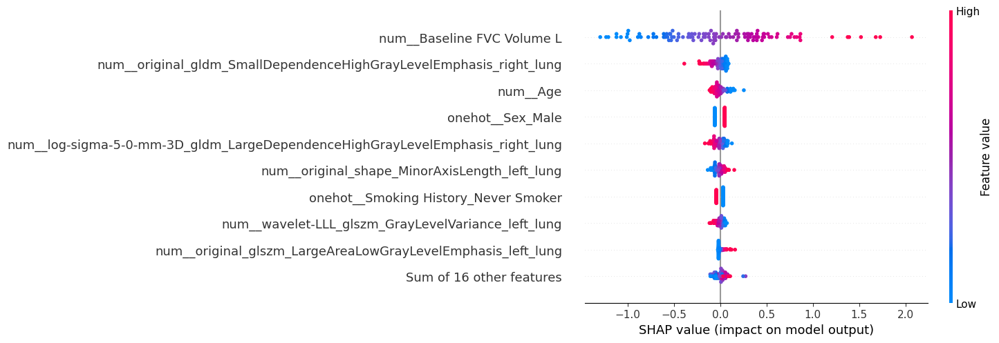

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/plots/_beeswarm.py:1150: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


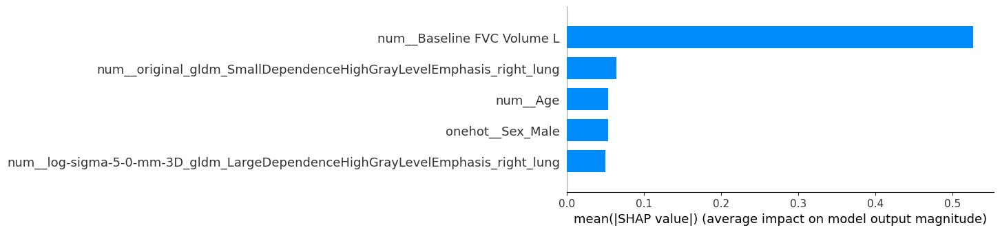

,Baseline FVC Week,Followup FVC Week
1000582,0,52.0
1000817,0,48.0
1002394,0,56.0
853662,0,55.0
358759,0,50.0
...,...,...
1000565,0,50.0
1001353,0,54.0
1001380,0,52.0
1000910,0,50.0


In [5]:
#Pipeline P1: PAM → Correlation with Target → mRMR → VIF
selected_features = ['wavelet-LLL_glszm_GrayLevelVariance_left_lung', 'original_shape_MinorAxisLength_left_lung', 'original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung', 'original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung', 'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung', 'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung']


Clinical_Contineous_data_ext = selected_features + Clinical_Contineous_data
print(Clinical_Contineous_data_ext)
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_with_clinical_harmonization.pkl")
X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)
# Run experiments
results1 = train_and_evaluate_elasticnet(X_train_median_filled, X_test_median_filled, y_train, y_test, selected_features, Clinical_Contineous_data_ext, Clinical_Categorical_data, 
                                         model_name="/home/pansurya/OSIC_thesis/EN_model/PAM_mrmr_VIF_EN_with_harmonizationPycombat.pkl")
# print("Running LOOCV experiment...")
# results1 = train_and_evaluate_with_LOOCV(X_train, X_test, y_train, y_test, selected_features, model_name="/home/pansurya/OSIC_thesis/Linear_model/PAM_ANOVA_VIF_LOOCV.pkl")
X_train[['Baseline FVC Week', 'Followup FVC Week']]

['original_firstorder_Kurtosis_right_lung', 'log-sigma-4-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_left_lung', 'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-LLL_glrlm_RunLengthNonUniformity_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Busyness_left_lung', 'log-sigma-1-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_right_lung', 'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung', 'log-sigma-3-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung', 'log-sigma-1-0-mm-3D_glrlm_GrayLevelNonUniformity_left_lung', 'original_firstorder_MeanAbsoluteDeviation_right_lung', 'wavelet-LHL_glrlm_GrayLevelNonUniformity_left_lung', 'log-sigma-4-0-mm-3D_glszm_GrayLevelNonUniformity_right_lung', 'log-sigma-2-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_left_lung', 'original_glrlm_GrayLevelNonUniformity_right_lung', 'original_firstorder_90Percentile_right_lung', 'log-sigma-5-0-mm-3D_firstorder_Energy_left_lung', 'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung

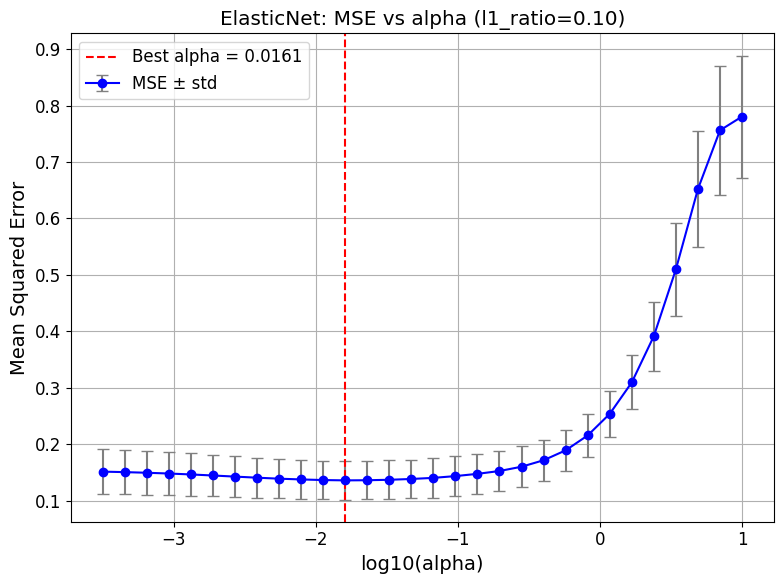


Top coefficients:
                                              Feature  Coefficient  \
30                              Baseline FVC Volume L     0.611348   
37                            Primary Diagnosis_INSIP     0.134291   
13   original_glrlm_GrayLevelNonUniformity_right_lung    -0.105259   
33                                           Sex_Male     0.098904   
28  log-sigma-3-0-mm-3D_glszm_ZoneVariance_right_lung     0.088362   
16  log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGr...    -0.085233   
17  log-sigma-2-0-mm-3D_glszm_LargeAreaLowGrayLeve...    -0.077733   
45                             Primary Diagnosis_UILD    -0.073071   
32                                                Age    -0.072676   
12  log-sigma-2-0-mm-3D_glrlm_LongRunHighGrayLevel...     0.069507   
4        log-sigma-2-0-mm-3D_ngtdm_Busyness_left_lung     0.066388   
5   log-sigma-1-0-mm-3D_glszm_LargeAreaHighGrayLev...    -0.064177   
31                                      FEV1 Volume L     0.061332   
3

/tmp/ipykernel_1751455/4243358687.py:215: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


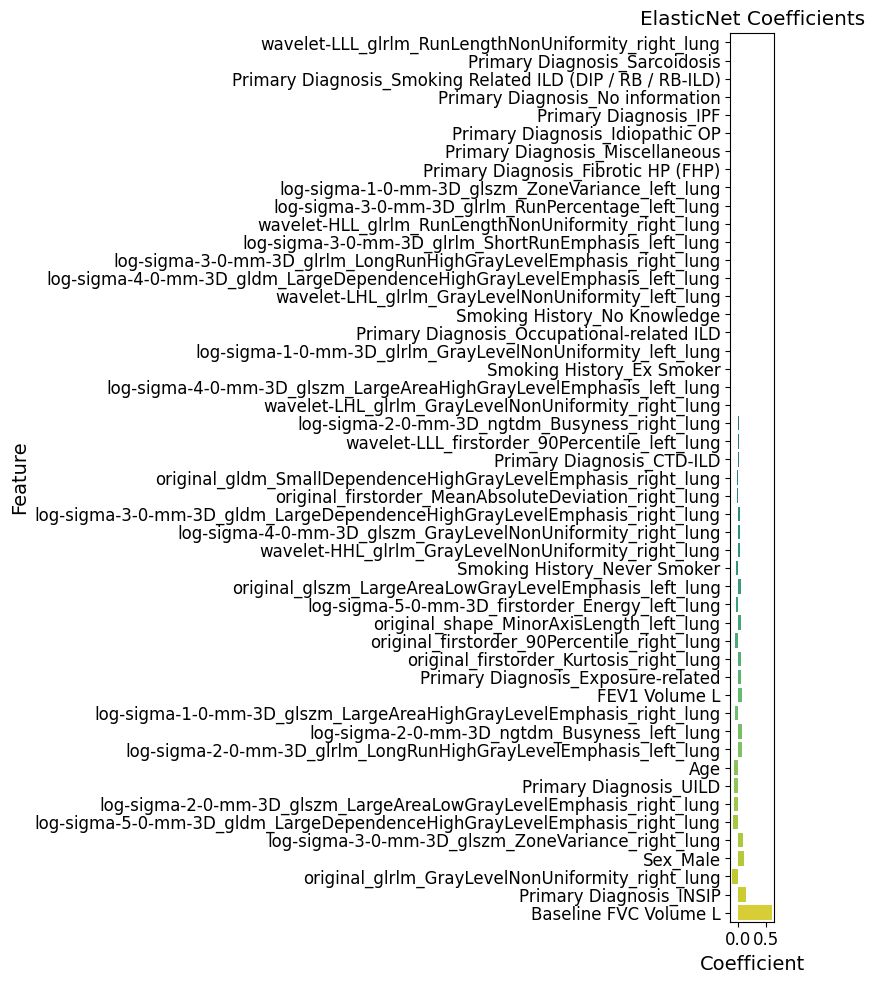

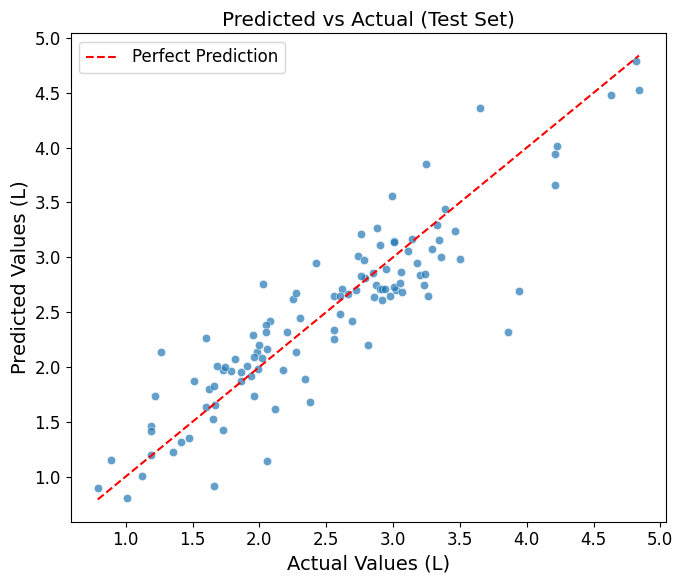

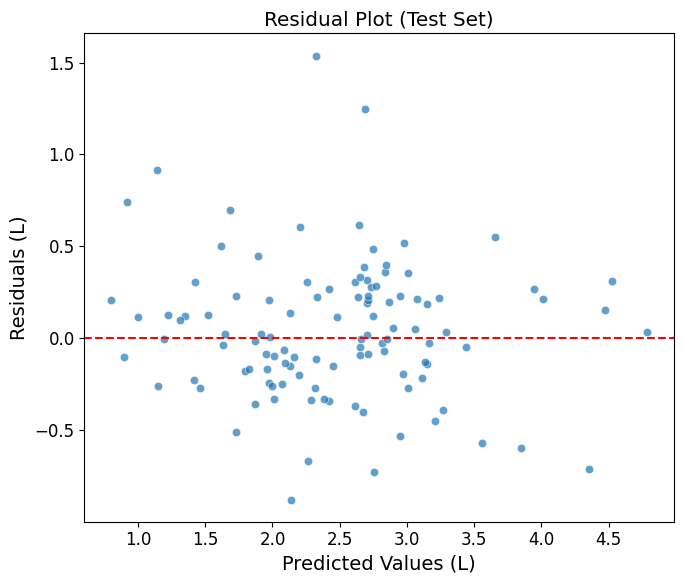


Top 5 patients with largest errors:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
587799           2.36        3.86       2.321909   1.538091   
1001085          2.50        3.94       2.691043   1.248957   
151493           1.16        2.06       1.143895   0.916105   
666514           1.80        1.26       2.136030   0.876030   
888514           1.02        1.66       0.915889   0.744111   

         Baseline_FVC_Week  Followup_FVC_Week  
587799                 0.0               56.0  
1001085                0.0               48.0  
151493                 0.0               50.0  
666514                 0.0               53.0  
888514                 0.0               48.0  


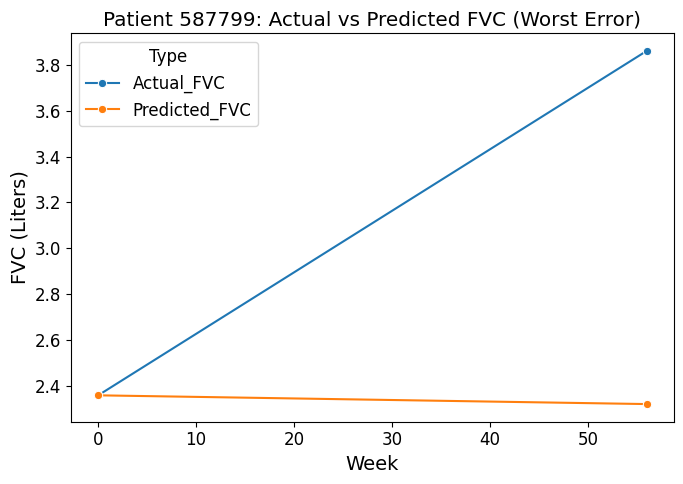

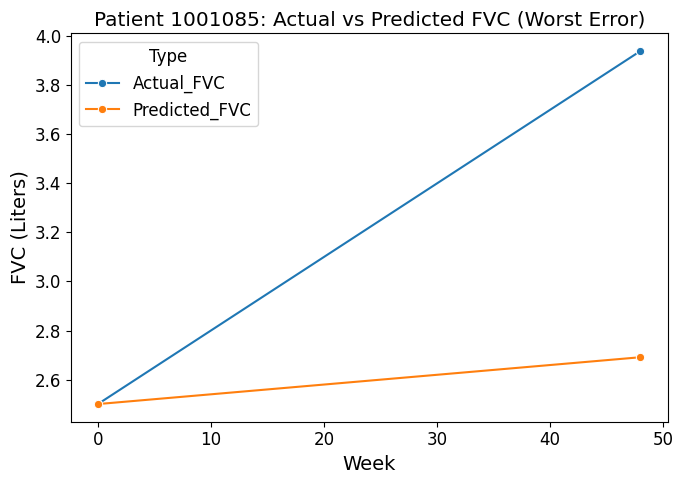

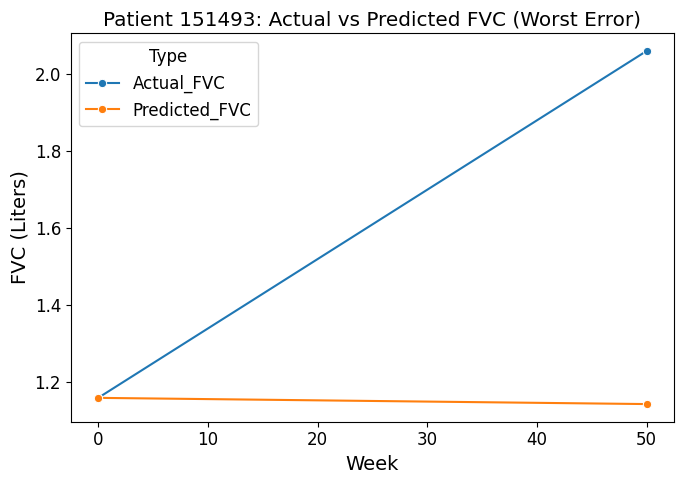

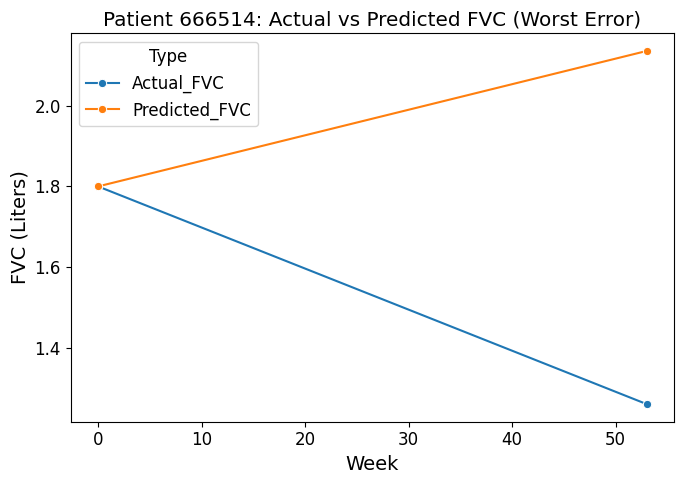

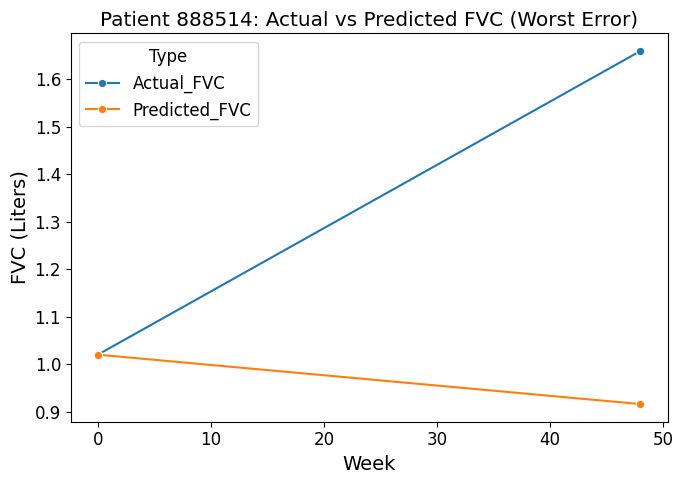


Top 5 patients with increasing FVC and lowest error:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
1000550          2.65        2.66       2.661761   0.001761   
1001354          1.82        1.94       1.917257   0.022743   
1001371          1.59        1.60       1.634992   0.034992   
1000634          2.55        2.60       2.647432   0.047432   
1001312          3.04        3.11       3.058173   0.051827   

         Baseline_FVC_Week  Followup_FVC_Week  
1000550                0.0               52.0  
1001354                0.0               52.0  
1001371                0.0               50.0  
1000634                0.0               52.0  
1001312                0.0               51.0  


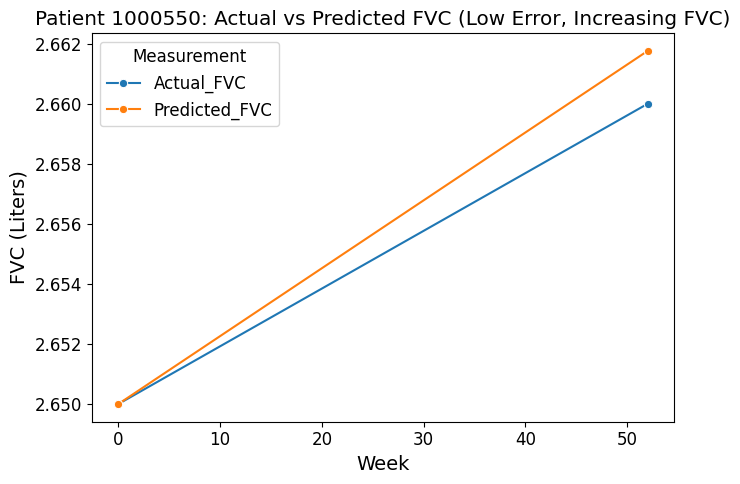

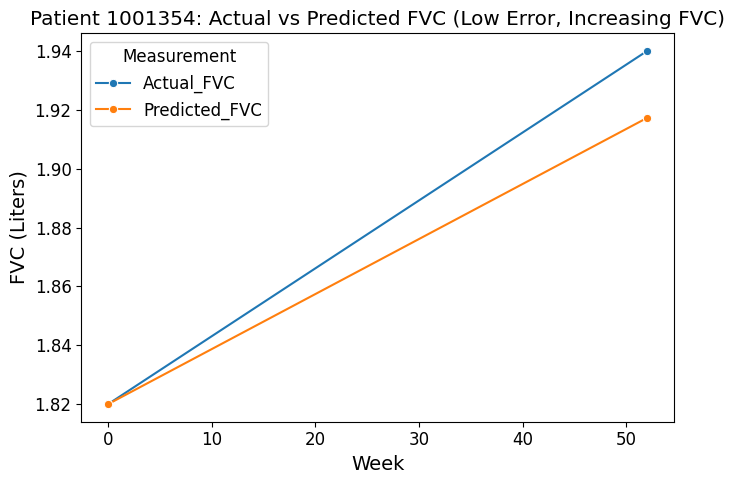

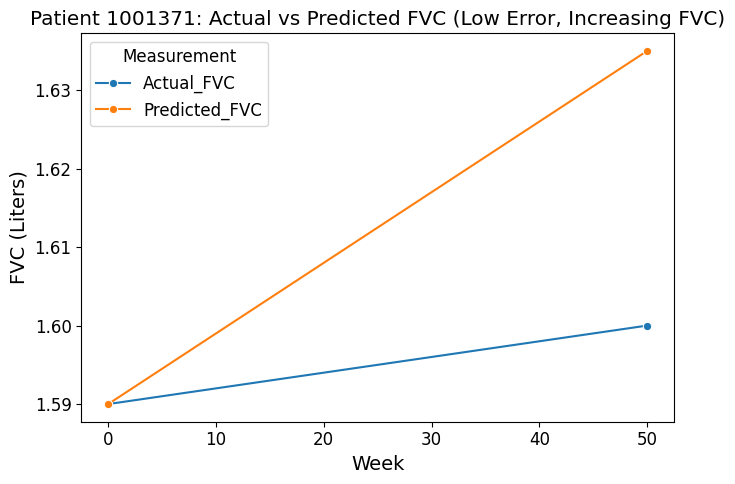

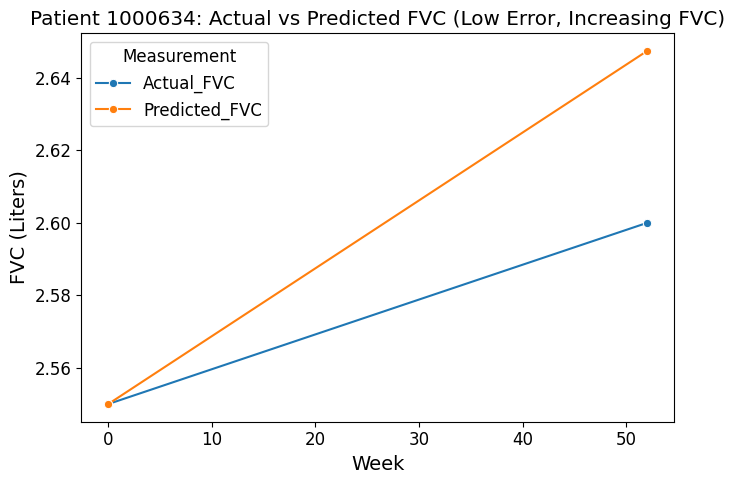

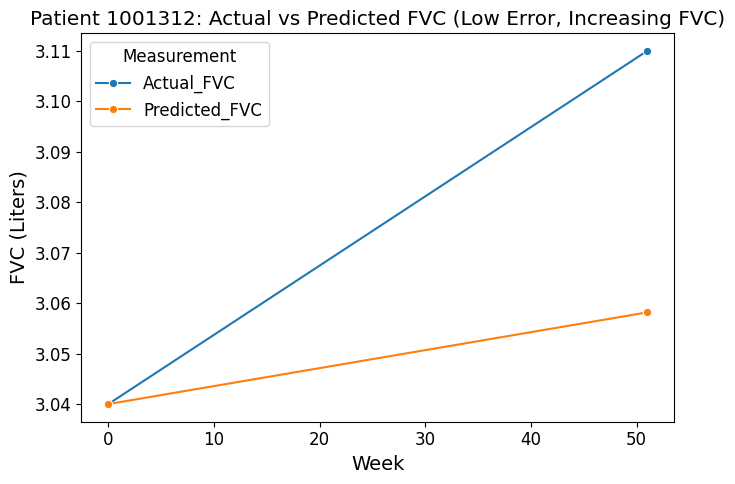

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


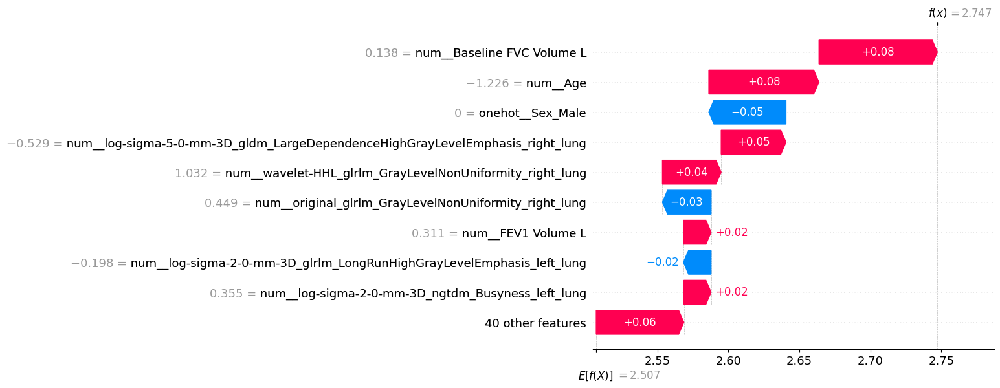

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/plots/_beeswarm.py:1150: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


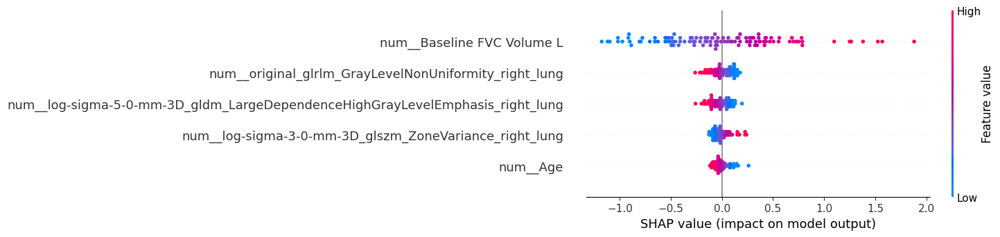

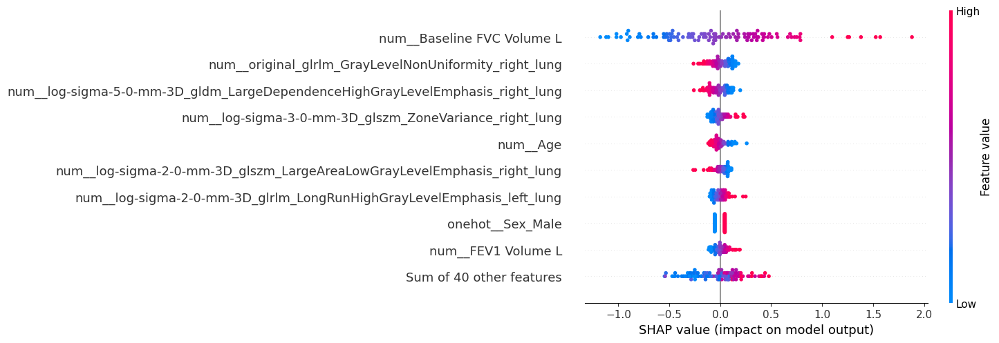

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/plots/_beeswarm.py:1150: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


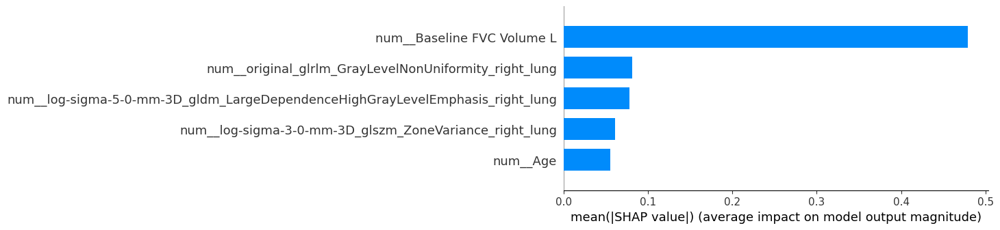

In [17]:
#tested, not good method
selected_features = ['original_firstorder_Kurtosis_right_lung',
       'log-sigma-4-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_left_lung',
       'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung',
       'wavelet-LLL_glrlm_RunLengthNonUniformity_right_lung',
       'log-sigma-2-0-mm-3D_ngtdm_Busyness_left_lung',
       'log-sigma-1-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_right_lung',
       'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung',
       'log-sigma-3-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung',
       'log-sigma-1-0-mm-3D_glrlm_GrayLevelNonUniformity_left_lung',
       'original_firstorder_MeanAbsoluteDeviation_right_lung',
       'wavelet-LHL_glrlm_GrayLevelNonUniformity_left_lung',
       'log-sigma-4-0-mm-3D_glszm_GrayLevelNonUniformity_right_lung',
       'log-sigma-2-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_left_lung',
       'original_glrlm_GrayLevelNonUniformity_right_lung',
       'original_firstorder_90Percentile_right_lung',
       'log-sigma-5-0-mm-3D_firstorder_Energy_left_lung',
       'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung',
       'log-sigma-2-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung',
       'log-sigma-3-0-mm-3D_glrlm_RunPercentage_left_lung',
       'wavelet-LLL_firstorder_90Percentile_left_lung',
       'wavelet-HLL_glrlm_RunLengthNonUniformity_right_lung',
       'log-sigma-1-0-mm-3D_glszm_ZoneVariance_left_lung',
       'original_shape_MinorAxisLength_left_lung',
       'log-sigma-2-0-mm-3D_ngtdm_Busyness_right_lung',
       'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung',
       'original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung',
       'original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung',
       'log-sigma-4-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung',
       'log-sigma-3-0-mm-3D_glszm_ZoneVariance_right_lung',
       'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung']
Clinical_Contineous_data_ext = selected_features + Clinical_Contineous_data
print(Clinical_Contineous_data_ext)
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_with_clinical_harmonization.pkl")
X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)


# Run experiments
results1 = train_and_evaluate_elasticnet(X_train_median_filled, X_test_median_filled, y_train, y_test, selected_features, Clinical_Contineous_data_ext, Clinical_Categorical_data, 
                                         model_name="/home/pansurya/OSIC_thesis/EN_model/PAM_ANOVA_VIF_EN_with_harmonizationPycombat.pkl")


Hierarchical 

['original_shape_MinorAxisLength_right_lung', 'original_shape_SurfaceArea_left_lung', 'wavelet-LLL_ngtdm_Contrast_right_lung', 'original_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'wavelet-HLL_firstorder_Skewness_right_lung', 'wavelet-HHL_glszm_LargeAreaHighGrayLevelEmphasis_right_lung', 'original_shape_MinorAxisLength_left_lung', 'log-sigma-1-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung', 'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung', 'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung', 'Baseline FVC Volume L', 'FEV1 Volume L', 'Age']
Numeric features: ['original_shape_MinorAxisLength_right_lung', 'original_shape_SurfaceArea_left_lung', 'wavelet-LLL_ngtdm_Contrast_right_lung', 'original_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'wavelet-HLL_firstorder_Skewness_right_lung', 'wavelet-HHL_glszm_LargeArea

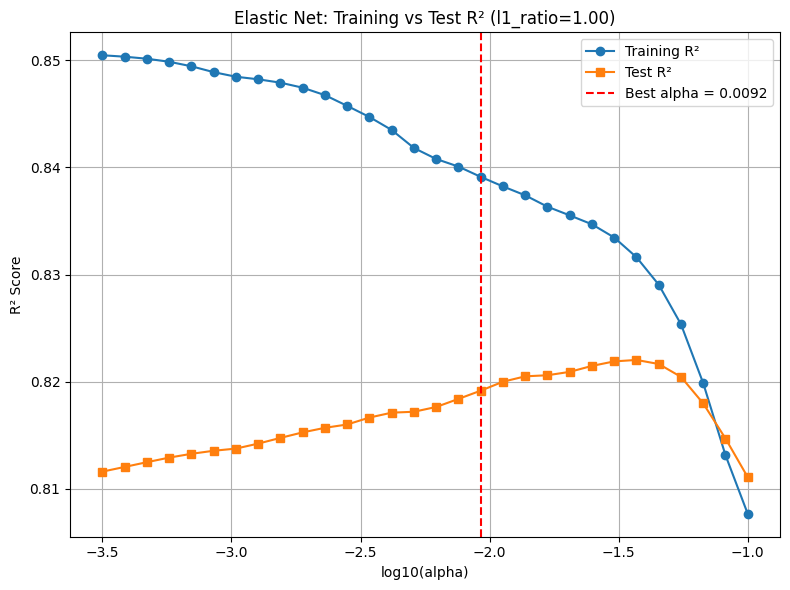

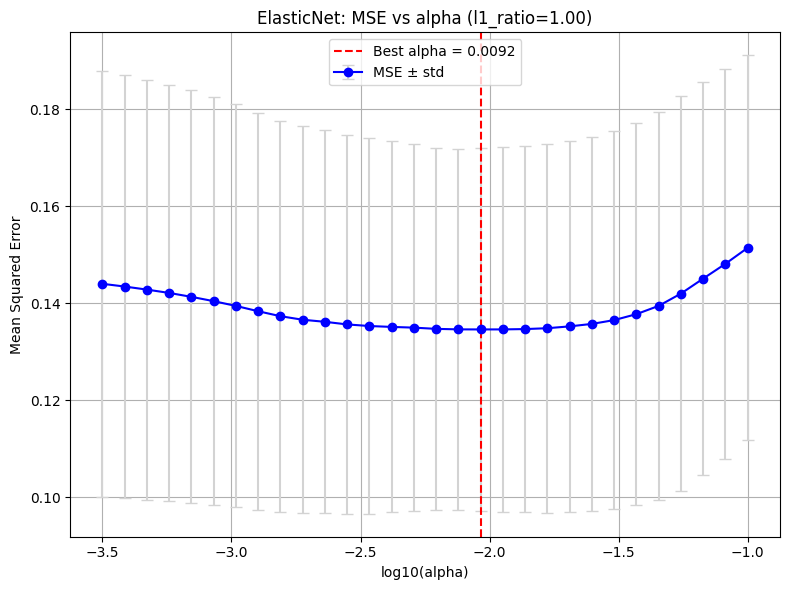


Computing MSE vs l1_ratio...


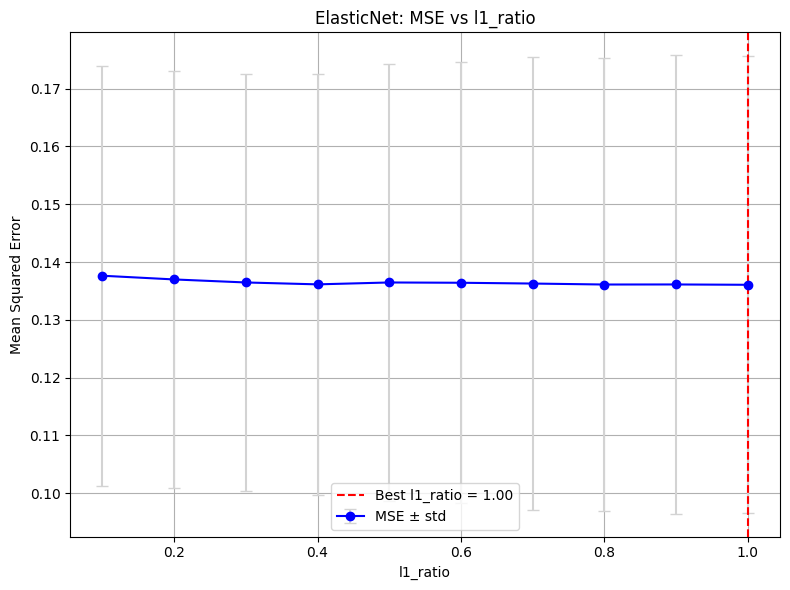


Model coefficients (sorted by |coef|):
                                              Feature  Coefficient
11                              Baseline FVC Volume L     0.689103
13                                                Age    -0.071678
1                original_shape_SurfaceArea_left_lung     0.058773
2               wavelet-LLL_ngtdm_Contrast_right_lung    -0.050626
14                                           Sex_Male     0.049172
7            original_shape_MinorAxisLength_left_lung     0.024445
28                       Smoking History_Never Smoker    -0.018512
4   original_gldm_LargeDependenceLowGrayLevelEmpha...     0.017262
26                             Primary Diagnosis_UILD    -0.012018
9   log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_lef...    -0.008104
8   log-sigma-1-0-mm-3D_gldm_LargeDependenceHighGr...     0.000000
5          wavelet-HLL_firstorder_Skewness_right_lung    -0.000000
0           original_shape_MinorAxisLength_right_lung     0.000000
3   original_glszm_Lar

/tmp/ipykernel_4059943/2091552719.py:262: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


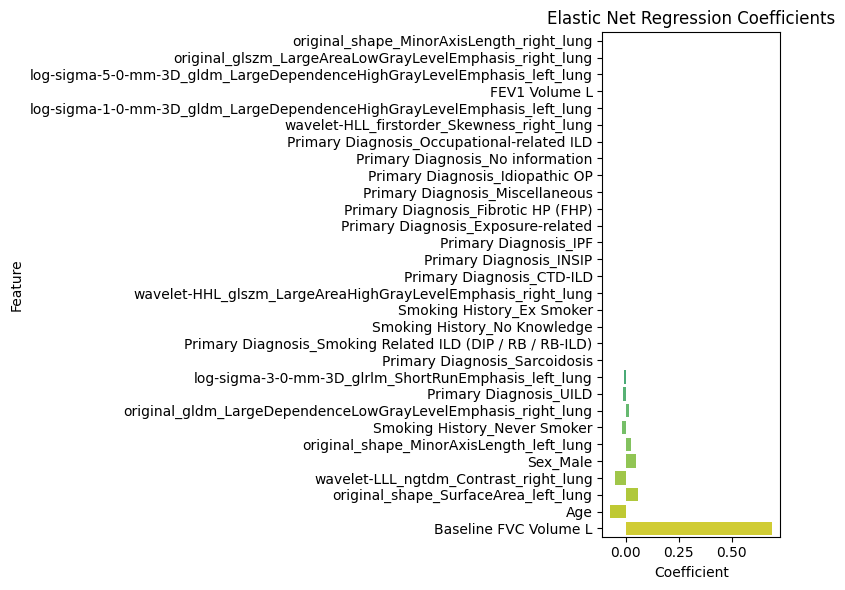

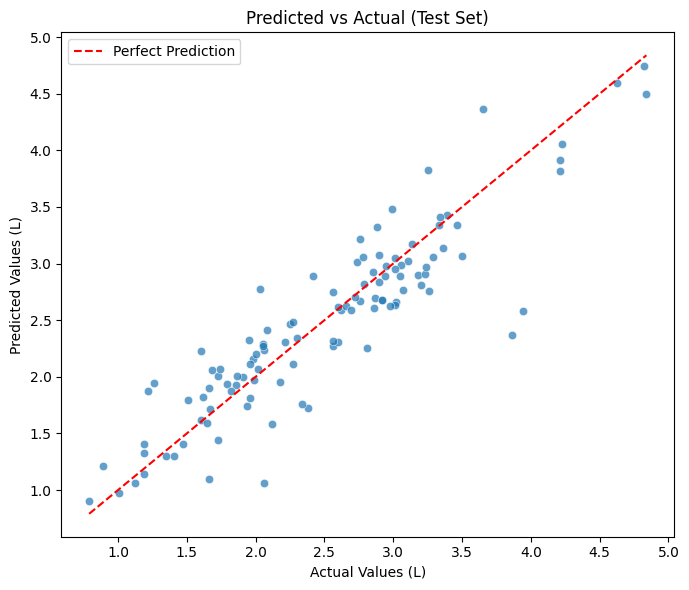

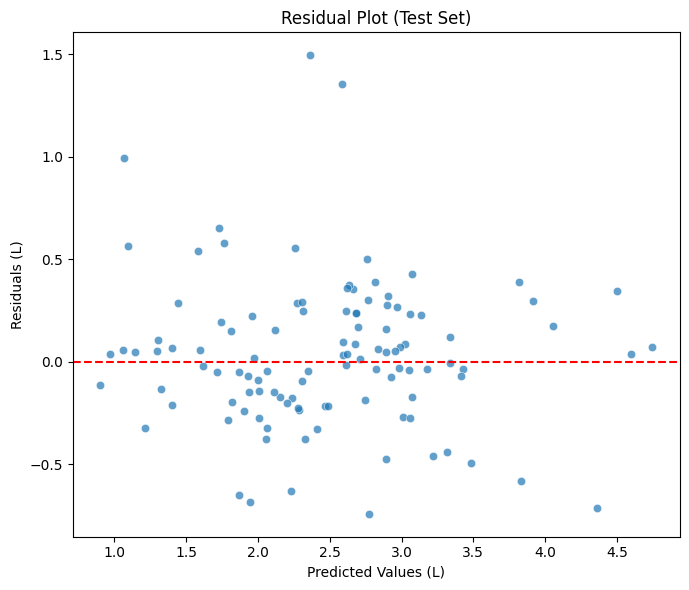


Top 5 patients with largest errors:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
587799           2.36        3.86       2.364889   1.495111   
1001085          2.50        3.94       2.585536   1.354464   
151493           1.16        2.06       1.065606   0.994394   
1001201          2.97        2.03       2.772670   0.742670   
273452           4.47        3.65       4.362435   0.712435   

         Baseline_FVC_Week  Followup_FVC_Week  
587799                 0.0               56.0  
1001085                0.0               48.0  
151493                 0.0               50.0  
1001201                0.0               54.0  
273452                 0.0               48.0  


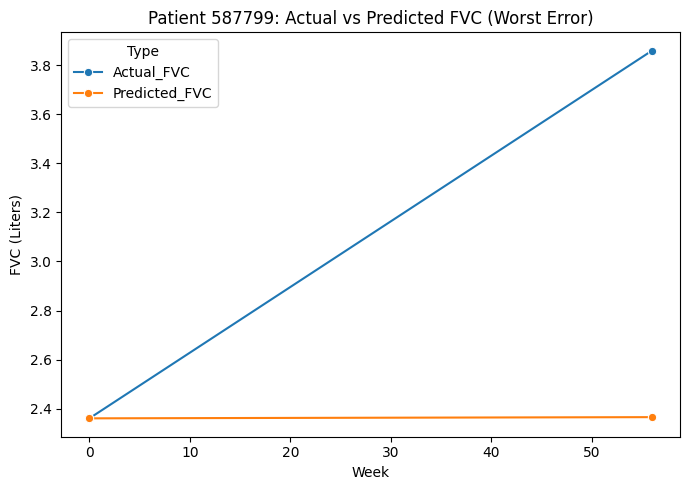

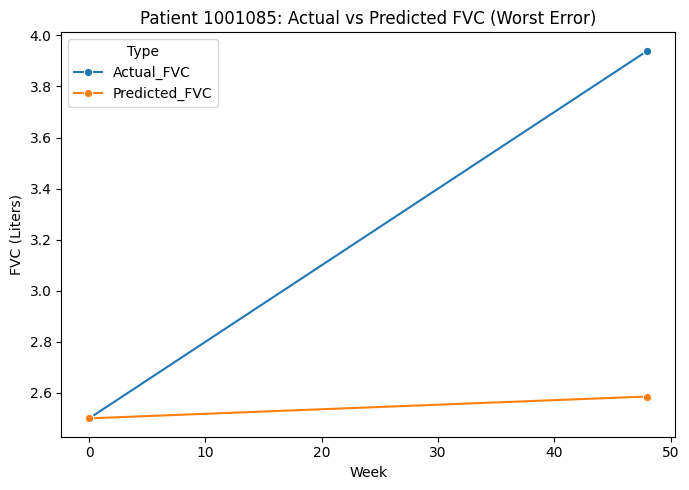

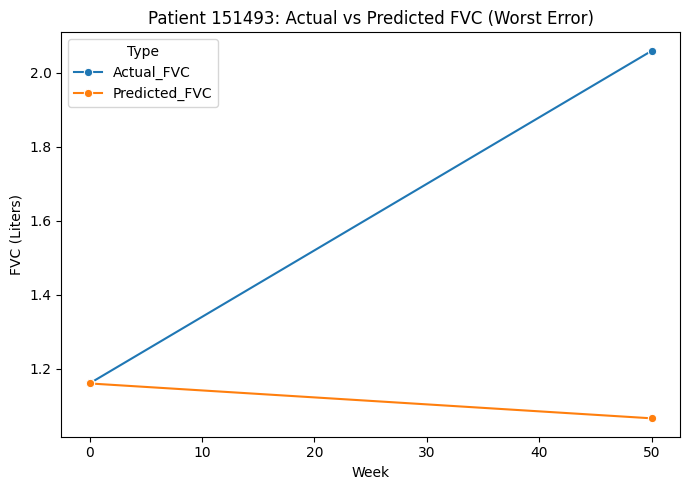

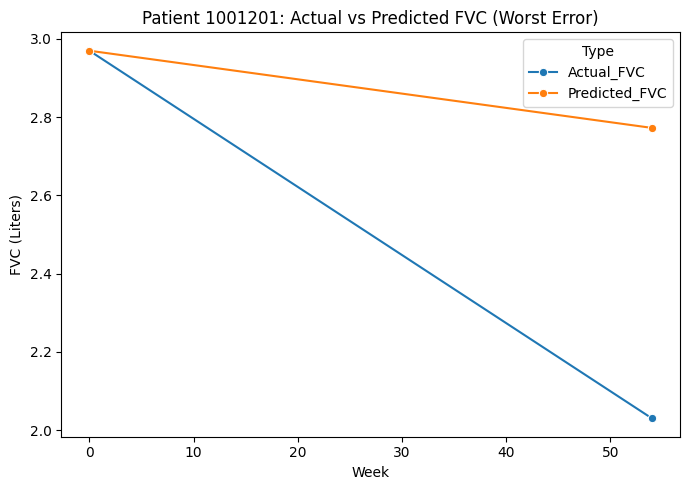

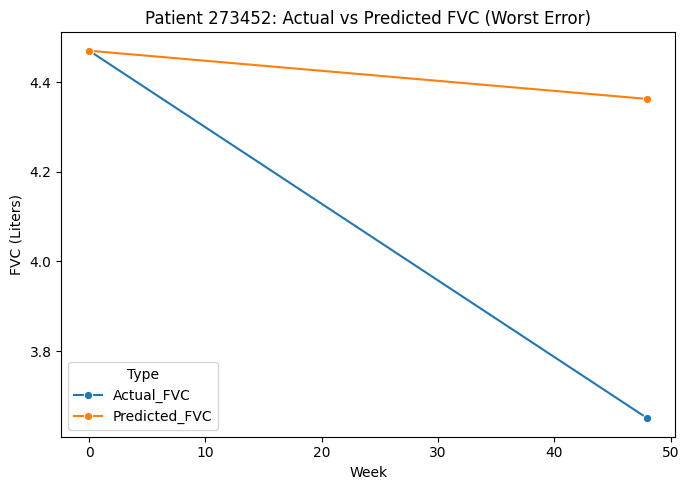


Top 5 patients with increasing FVC and lowest error:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
1000634          2.55        2.60       2.614389   0.014389   
1001371          1.59        1.60       1.620400   0.020400   
1000550          2.65        2.66       2.622955   0.037045   
1000960          1.34        1.35       1.300210   0.049790   
447330           2.99        3.01       2.955917   0.054083   

         Baseline_FVC_Week  Followup_FVC_Week  
1000634                0.0               52.0  
1001371                0.0               50.0  
1000550                0.0               52.0  
1000960                0.0               48.0  
447330                 0.0               55.0  


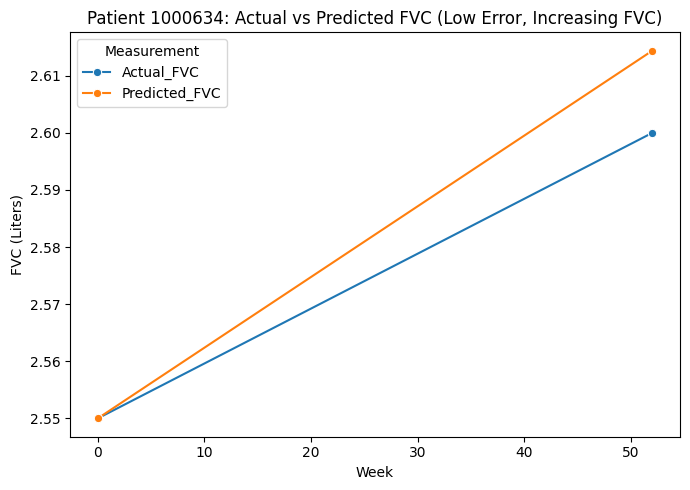

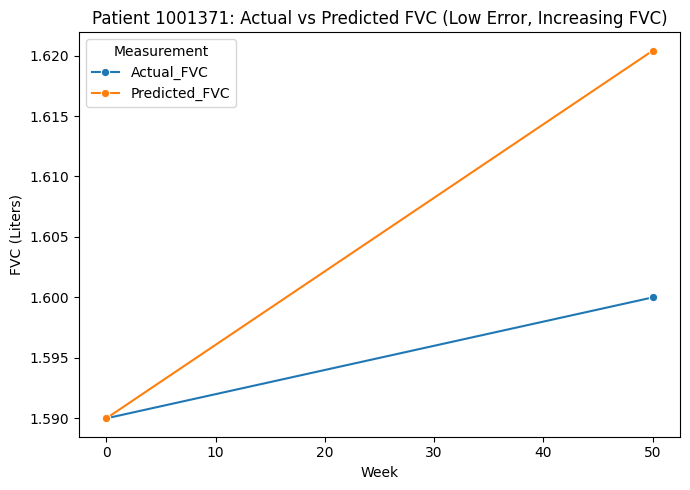

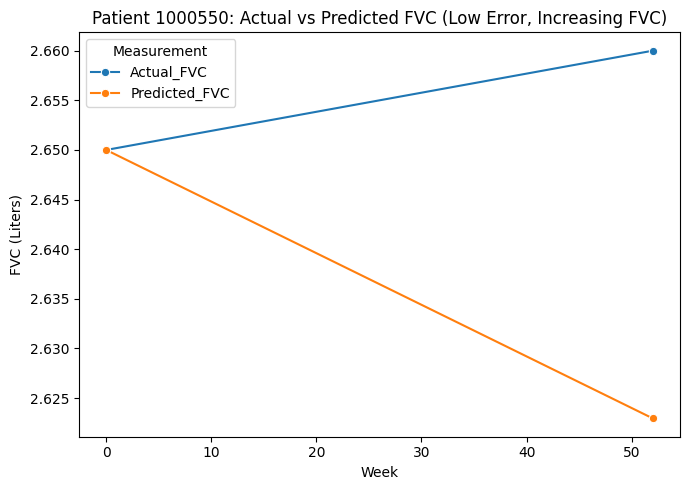

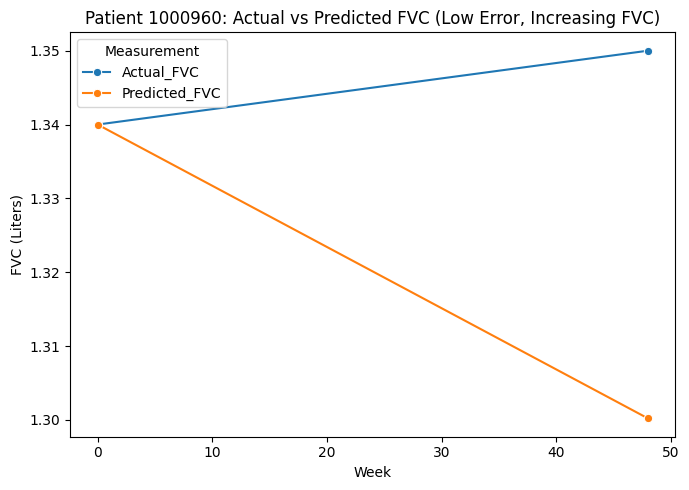

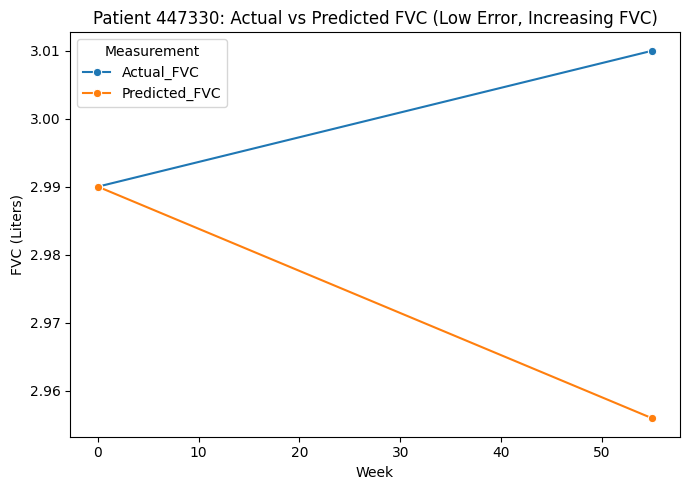

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


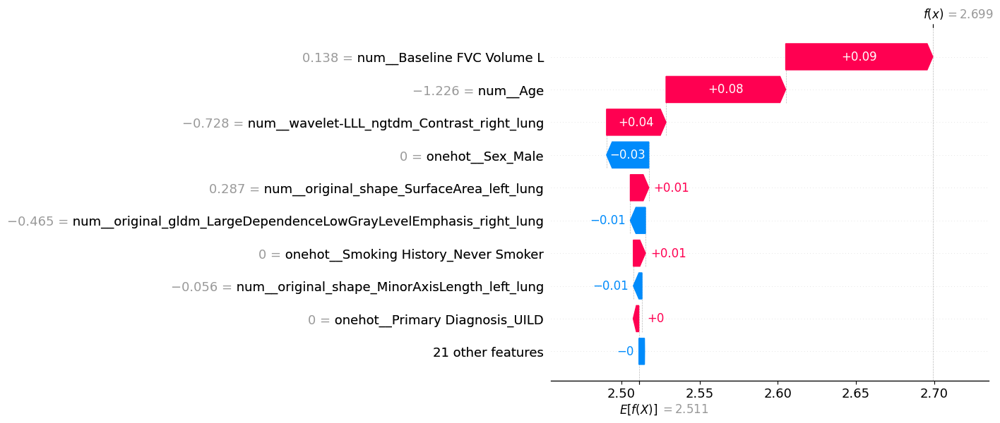

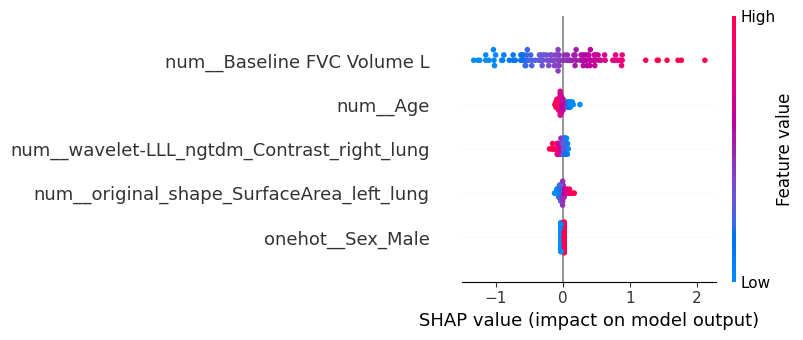

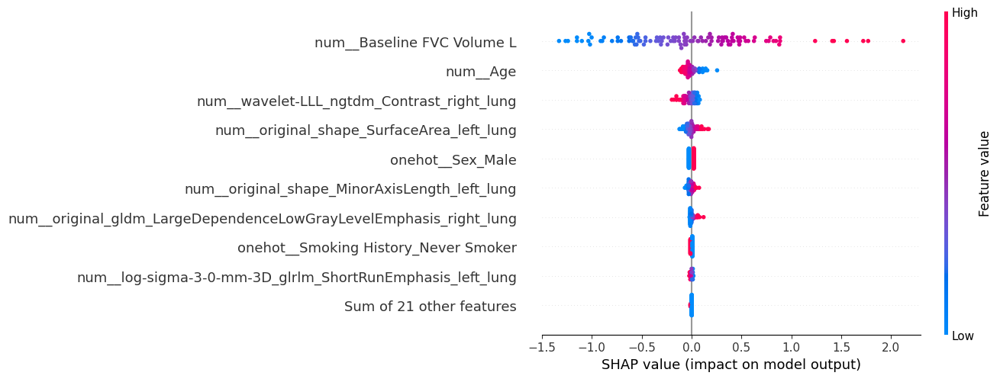

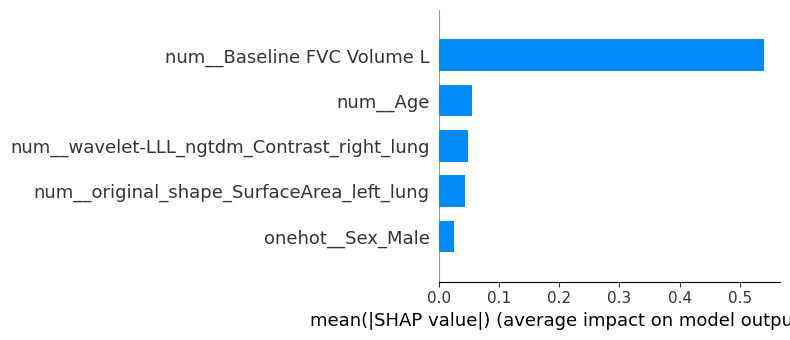

In [6]:
selected_features = ['original_shape_MinorAxisLength_right_lung', 'original_shape_SurfaceArea_left_lung', 'wavelet-LLL_ngtdm_Contrast_right_lung', 'original_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'wavelet-HLL_firstorder_Skewness_right_lung', 'wavelet-HHL_glszm_LargeAreaHighGrayLevelEmphasis_right_lung', 'original_shape_MinorAxisLength_left_lung', 'log-sigma-1-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung', 'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung', 'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung']
Clinical_Contineous_data_ext = selected_features + Clinical_Contineous_data
print(Clinical_Contineous_data_ext)
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_with_clinical_harmonization.pkl")
X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)
results1 = train_and_evaluate_elasticnet(X_train_median_filled, X_test_median_filled, y_train, y_test, selected_features, Clinical_Contineous_data_ext, Clinical_Categorical_data, 
                                         model_name="/home/pansurya/OSIC_thesis/EN_model/Hierarchical_ANOVA_VIF_EN_with_harmonizationPycombat.pkl")



['original_shape_MinorAxisLength_left_lung', 'wavelet-HHH_glcm_MCC_right_lung', 'wavelet-LLL_glszm_GrayLevelVariance_left_lung', 'original_shape_MinorAxisLength_right_lung', 'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung', 'log-sigma-1-0-mm-3D_gldm_GrayLevelNonUniformity_left_lung', 'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Busyness_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Busyness_left_lung', 'original_firstorder_90Percentile_right_lung', 'log-sigma-3-0-mm-3D_glszm_ZoneVariance_right_lung', 'original_shape_SurfaceArea_left_lung', 'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung', 'original_glszm_SmallAreaHighGrayLevelEmphasis_right_lung', 'log-sigma-1-0-mm-3D_ngtdm_Busyness_right_lung', 'log-sigma-1-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung', 'wavelet-LLH_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-LHL_firstorder_Kurtosis_right_lung', 'wavelet-LLL_glszm_GrayLevelNonUniformity_right_lung', 'original

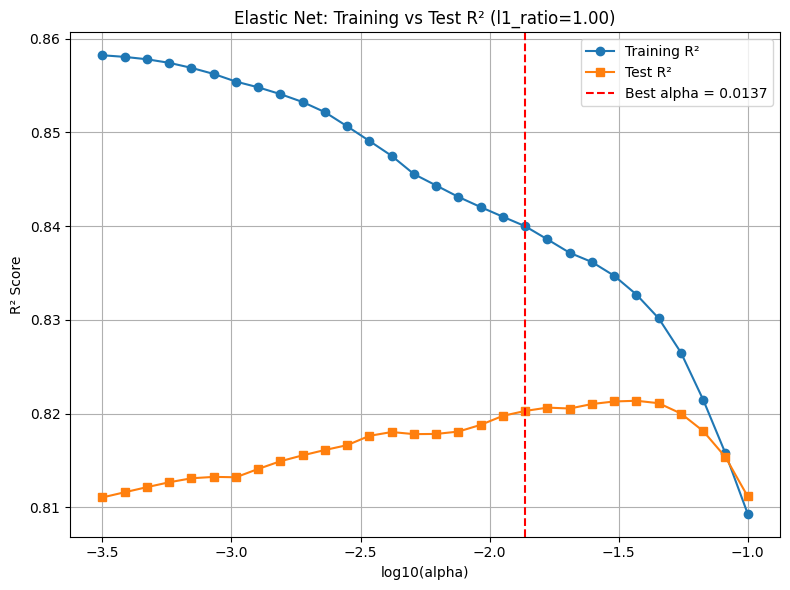

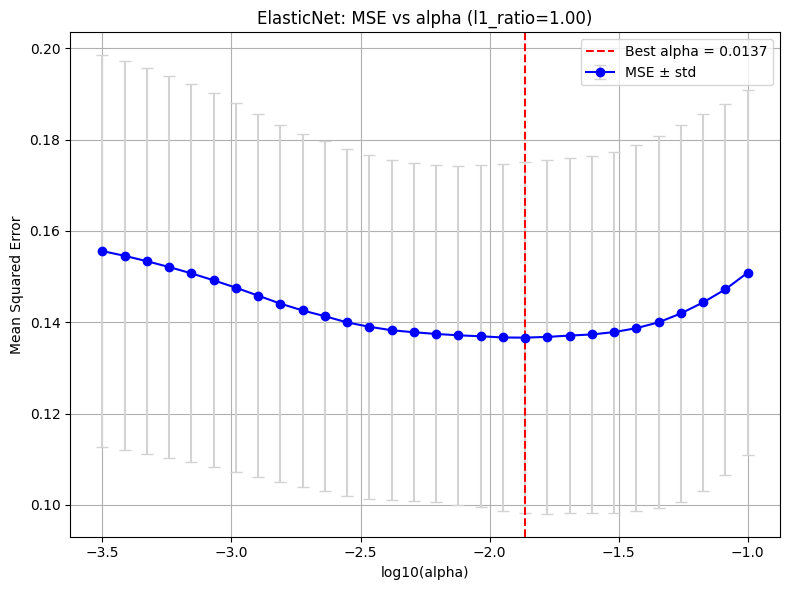


Computing MSE vs l1_ratio...


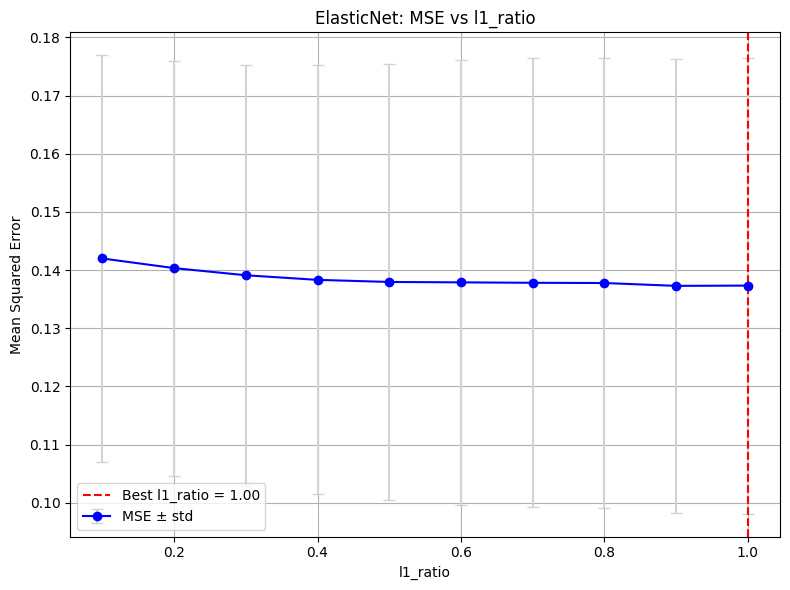


Model coefficients (sorted by |coef|):
                                              Feature  Coefficient
30                              Baseline FVC Volume L     0.696094
32                                                Age    -0.064438
29  log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGra...    -0.038987
33                                           Sex_Male     0.037275
0            original_shape_MinorAxisLength_left_lung     0.021860
2       wavelet-LLL_glszm_GrayLevelVariance_left_lung    -0.019289
11               original_shape_SurfaceArea_left_lung     0.016968
19  original_gldm_LargeDependenceLowGrayLevelEmpha...     0.015642
14      log-sigma-1-0-mm-3D_ngtdm_Busyness_right_lung     0.014686
28              wavelet-LLL_ngtdm_Contrast_right_lung    -0.014522
47                       Smoking History_Never Smoker    -0.007754
25              wavelet-LHL_ngtdm_Busyness_right_lung     0.007333
26  log-sigma-5-0-mm-3D_glrlm_LongRunHighGrayLevel...     0.006892
8        log-sigma-2-0

/tmp/ipykernel_4059943/2091552719.py:262: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


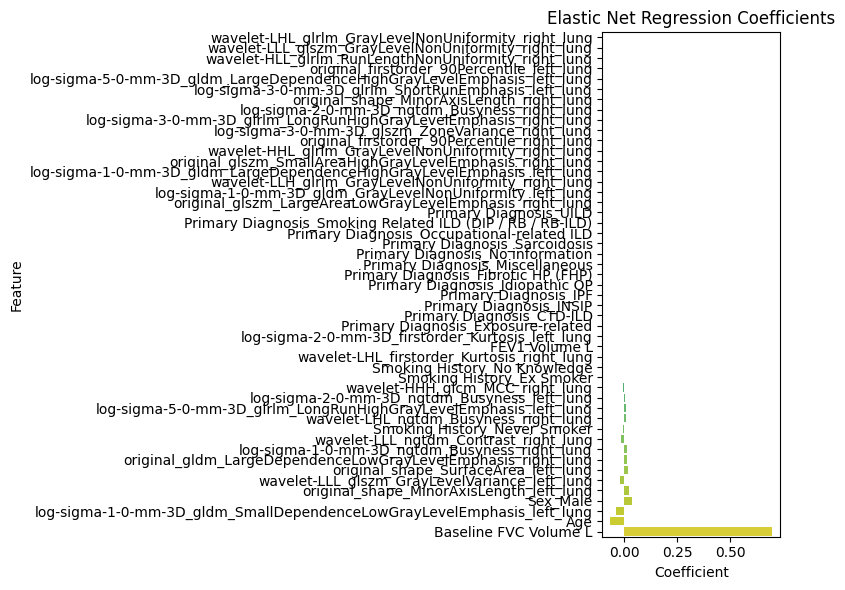

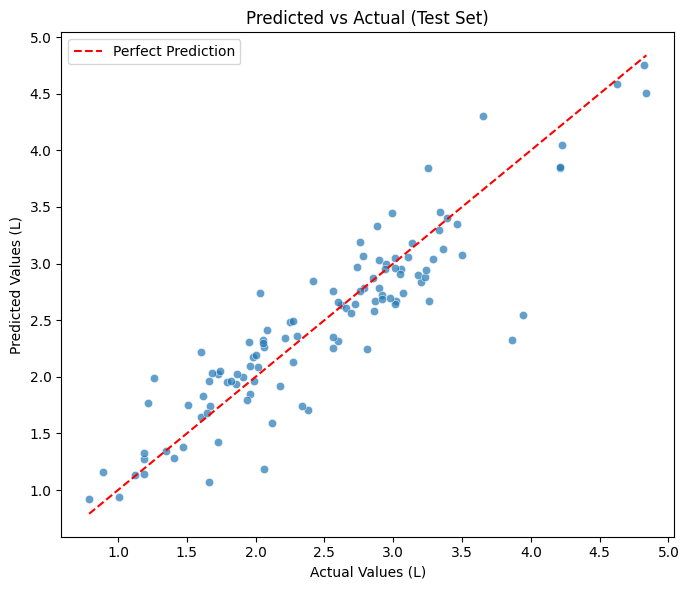

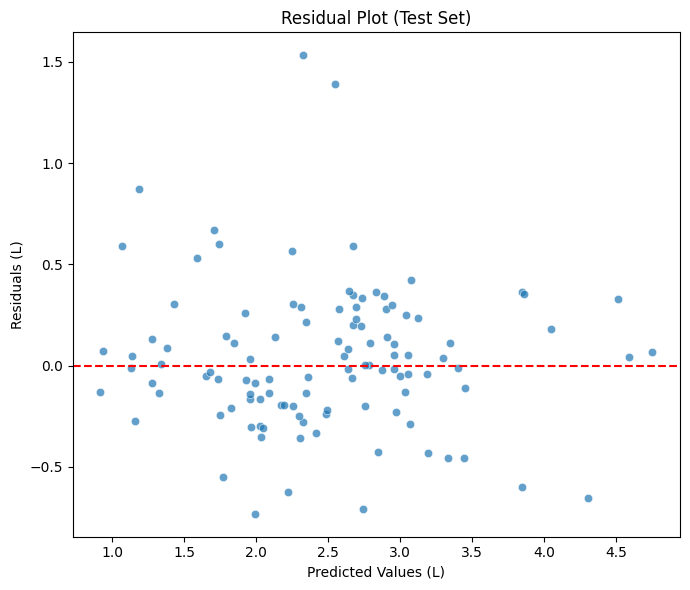


Top 5 patients with largest errors:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
587799           2.36        3.86       2.327932   1.532068   
1001085          2.50        3.94       2.549327   1.390673   
151493           1.16        2.06       1.187786   0.872214   
666514           1.80        1.26       1.991472   0.731472   
1001201          2.97        2.03       2.739218   0.709218   

         Baseline_FVC_Week  Followup_FVC_Week  
587799                 0.0               56.0  
1001085                0.0               48.0  
151493                 0.0               50.0  
666514                 0.0               53.0  
1001201                0.0               54.0  


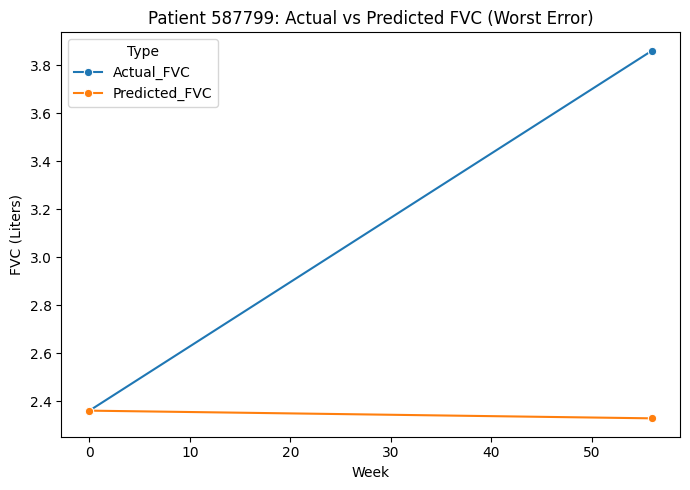

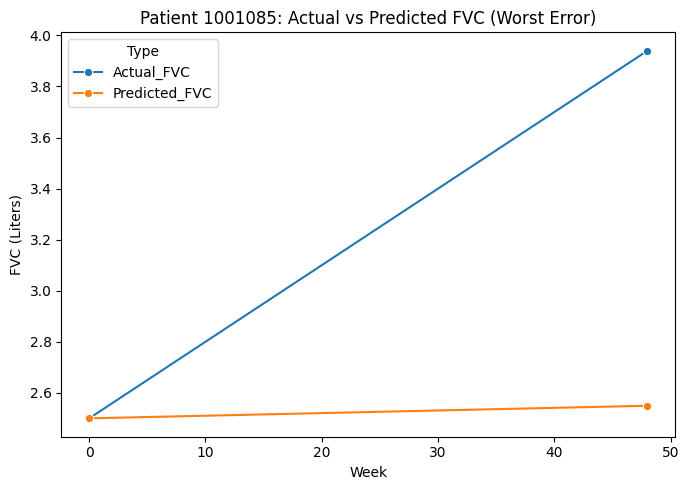

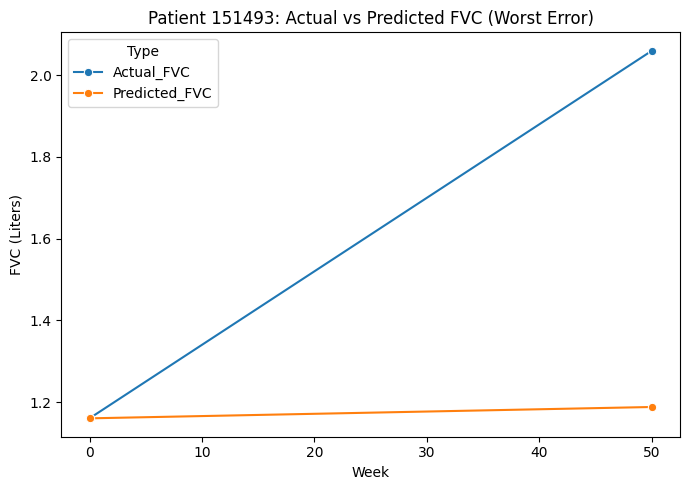

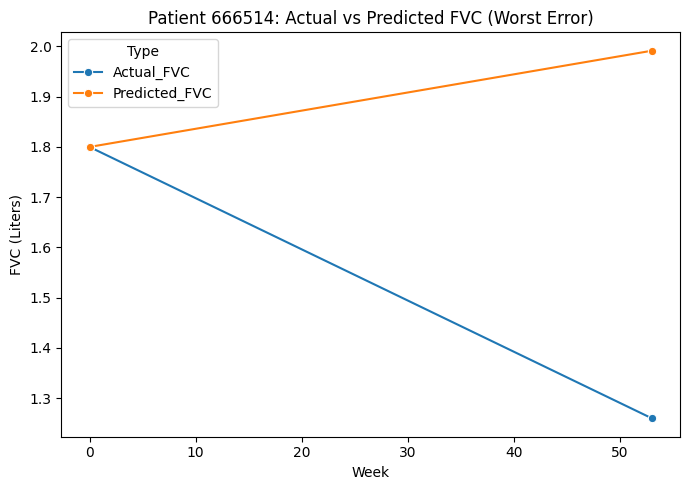

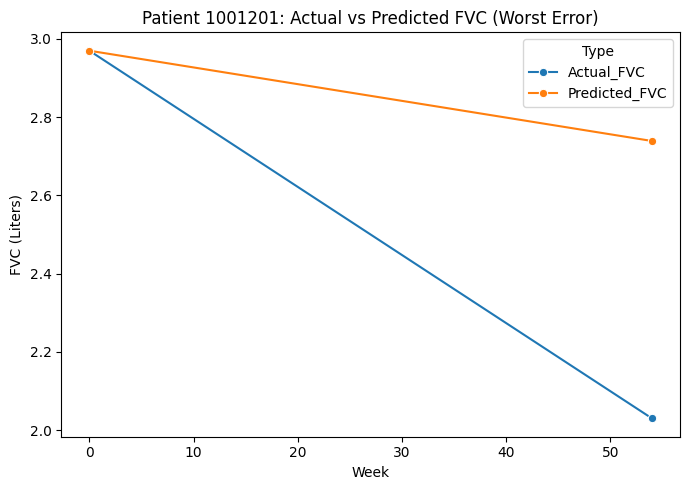


Top 5 patients with increasing FVC and lowest error:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
1000960          1.34        1.35       1.341922   0.008078   
1000550          2.65        2.66       2.611122   0.048878   
1001371          1.59        1.60       1.649151   0.049151   
447330           2.99        3.01       2.959559   0.050441   
1001312          3.04        3.11       3.057195   0.052805   

         Baseline_FVC_Week  Followup_FVC_Week  
1000960                0.0               48.0  
1000550                0.0               52.0  
1001371                0.0               50.0  
447330                 0.0               55.0  
1001312                0.0               51.0  


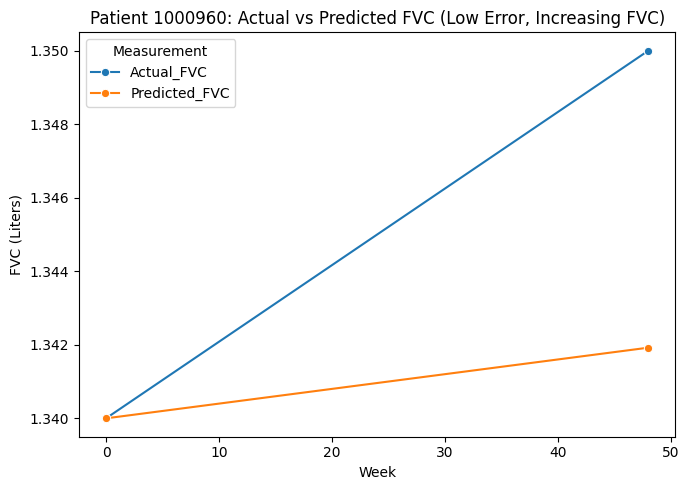

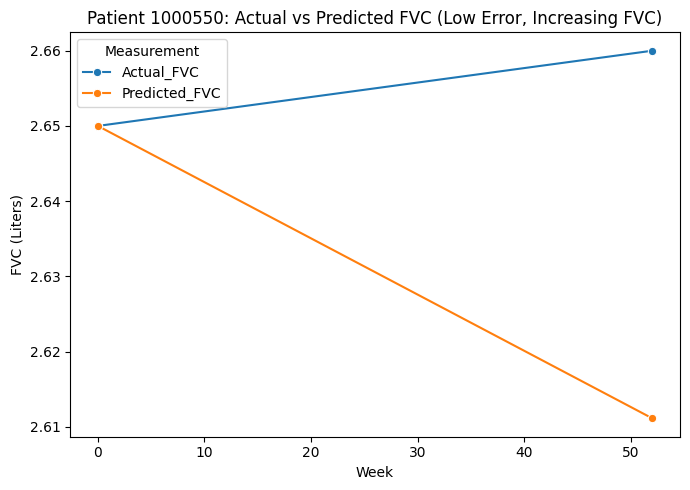

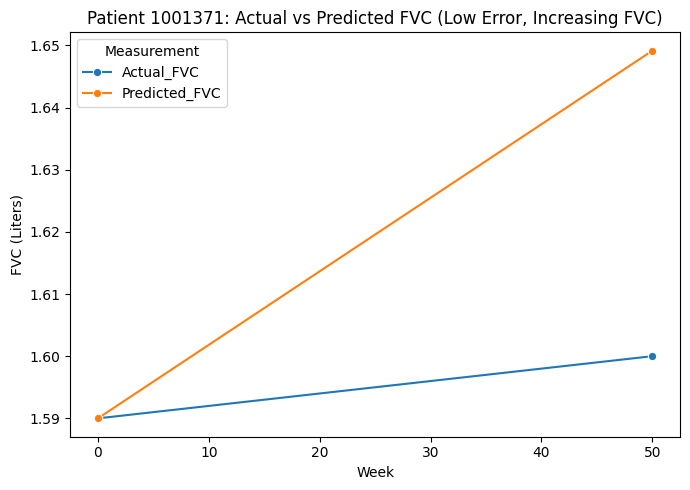

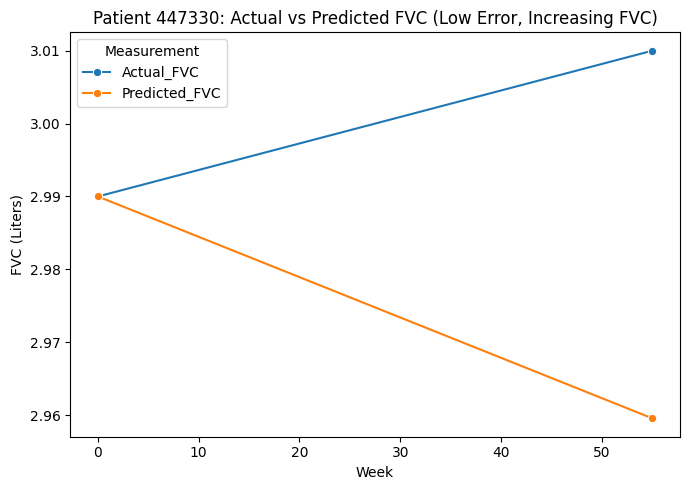

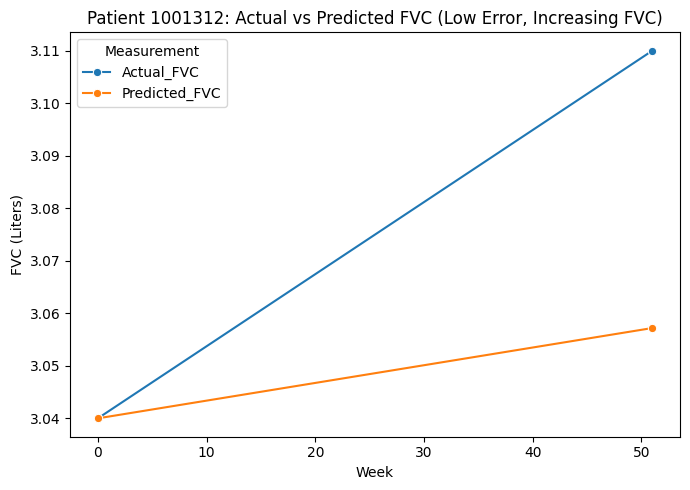

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


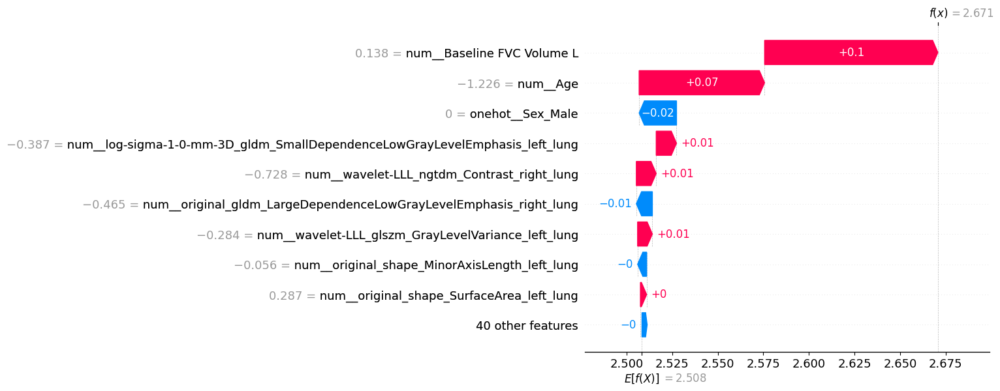

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/plots/_beeswarm.py:1150: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


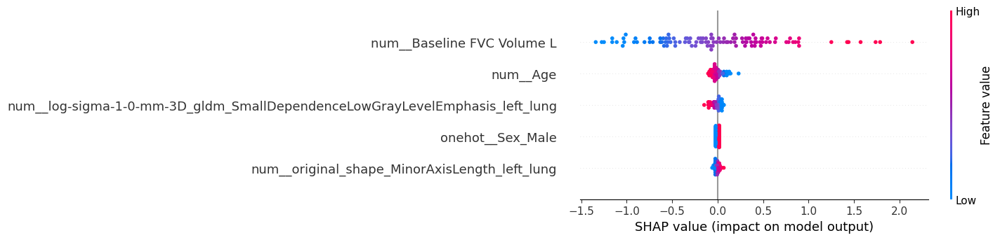

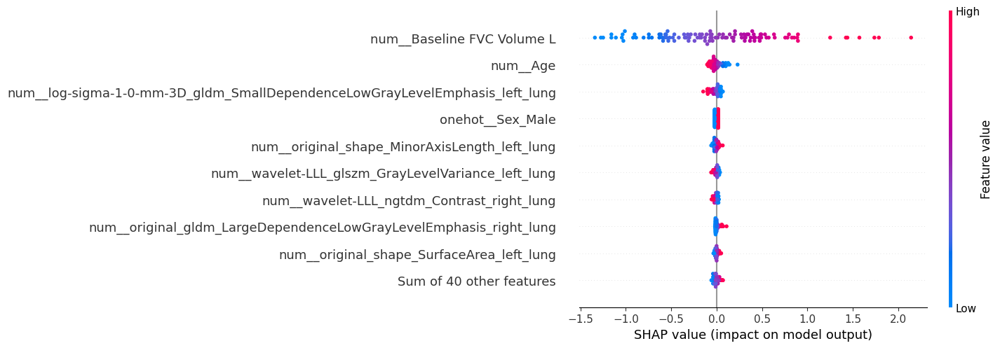

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/plots/_beeswarm.py:1150: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


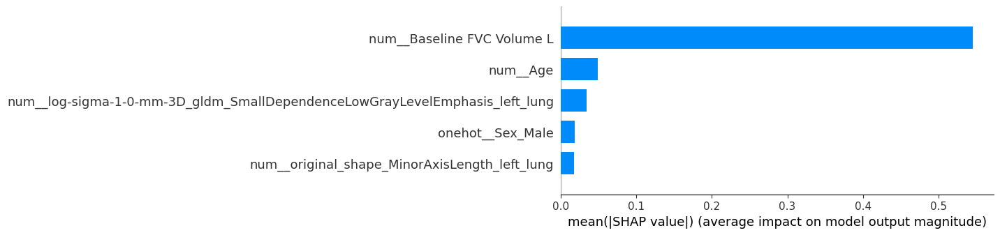

In [7]:
selected_features =['original_shape_MinorAxisLength_left_lung', 'wavelet-HHH_glcm_MCC_right_lung', 'wavelet-LLL_glszm_GrayLevelVariance_left_lung', 'original_shape_MinorAxisLength_right_lung', 'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung', 'log-sigma-1-0-mm-3D_gldm_GrayLevelNonUniformity_left_lung', 'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Busyness_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Busyness_left_lung', 'original_firstorder_90Percentile_right_lung', 'log-sigma-3-0-mm-3D_glszm_ZoneVariance_right_lung', 'original_shape_SurfaceArea_left_lung', 'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung', 'original_glszm_SmallAreaHighGrayLevelEmphasis_right_lung', 'log-sigma-1-0-mm-3D_ngtdm_Busyness_right_lung', 'log-sigma-1-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung', 'wavelet-LLH_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-LHL_firstorder_Kurtosis_right_lung', 'wavelet-LLL_glszm_GrayLevelNonUniformity_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'wavelet-HLL_glrlm_RunLengthNonUniformity_right_lung', 'original_firstorder_90Percentile_left_lung', 'original_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung', 'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung', 'wavelet-LHL_ngtdm_Busyness_right_lung', 'log-sigma-5-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_left_lung', 'log-sigma-2-0-mm-3D_firstorder_Kurtosis_left_lung', 'wavelet-LLL_ngtdm_Contrast_right_lung', 'log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung']
Clinical_Contineous_data_ext = selected_features + Clinical_Contineous_data
print(Clinical_Contineous_data_ext)
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_with_clinical_harmonization.pkl")
X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)
# Run experiments
results1 = train_and_evaluate_elasticnet(X_train_median_filled, X_test_median_filled, y_train, y_test, selected_features, Clinical_Contineous_data_ext, Clinical_Categorical_data, 
                                         model_name="/home/pansurya/OSIC_thesis/EN_model/Hierarchical_mrmr_VIF_EN_with_harmonizationPycombat.pkl")
# print("Running LOOCV experiment...")
# results1 = train_and_evaluate_with_LOOCV(X_train, X_test, y_train, y_test, selected_features, model_name="/home/pansurya/OSIC_thesis/Linear_model/Hierarchical_mrmr_VIF_LOOCV.pkl")



['wavelet-HHH_glcm_MCC_right_lung', 'wavelet-LHH_firstorder_Mean_left_lung', 'wavelet-LHH_firstorder_Skewness_left_lung', 'wavelet-LHH_glcm_ClusterShade_left_lung', 'wavelet-HHH_firstorder_Mean_left_lung', 'wavelet-HHH_glcm_MCC_left_lung', 'wavelet-LLL_firstorder_Maximum_left_lung', 'log-sigma-1-0-mm-3D_firstorder_Maximum_left_lung', 'Baseline FVC Volume L', 'Age', 'FEV1 Volume L']
Numeric features: ['wavelet-HHH_glcm_MCC_right_lung', 'wavelet-LHH_firstorder_Mean_left_lung', 'wavelet-LHH_firstorder_Skewness_left_lung', 'wavelet-LHH_glcm_ClusterShade_left_lung', 'wavelet-HHH_firstorder_Mean_left_lung', 'wavelet-HHH_glcm_MCC_left_lung', 'wavelet-LLL_firstorder_Maximum_left_lung', 'log-sigma-1-0-mm-3D_firstorder_Maximum_left_lung', 'Baseline FVC Volume L', 'Age', 'FEV1 Volume L']
One-hot features: ['Sex_Male', 'Primary Diagnosis_CTD-ILD', 'Primary Diagnosis_Exposure-related', 'Primary Diagnosis_Fibrotic HP (FHP)', 'Primary Diagnosis_INSIP', 'Primary Diagnosis_IPF', 'Primary Diagnosis_Idio

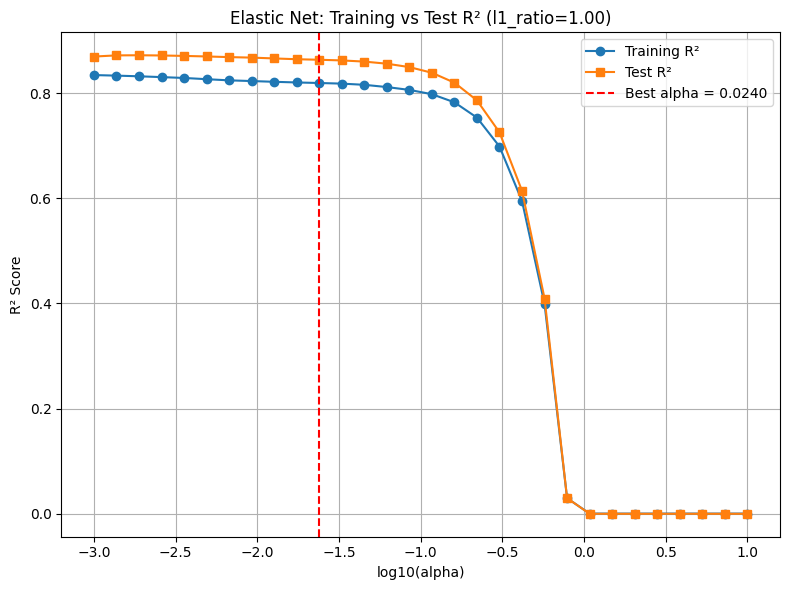


Test set performance:
- MAE:  0.22 L
- MSE:  0.10 L²
- RMSE: 0.31 L
- R²:   0.864

Training set performance:
- MAE:  0.25 L
- MSE:  0.14 L²
- RMSE: 0.38 L
- R²:   0.820

Model coefficients (sorted by |coef|):
                                              Feature  Coefficient
8                               Baseline FVC Volume L      0.77540
9                                                 Age     -0.04256
0                     wavelet-HHH_glcm_MCC_right_lung     -0.00000
1               wavelet-LHH_firstorder_Mean_left_lung     -0.00000
3             wavelet-LHH_glcm_ClusterShade_left_lung      0.00000
2           wavelet-LHH_firstorder_Skewness_left_lung      0.00000
4               wavelet-HHH_firstorder_Mean_left_lung      0.00000
5                      wavelet-HHH_glcm_MCC_left_lung      0.00000
7    log-sigma-1-0-mm-3D_firstorder_Maximum_left_lung     -0.00000
6            wavelet-LLL_firstorder_Maximum_left_lung      0.00000
10                                      FEV1 Volume L

/tmp/ipykernel_2854133/1228108370.py:154: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


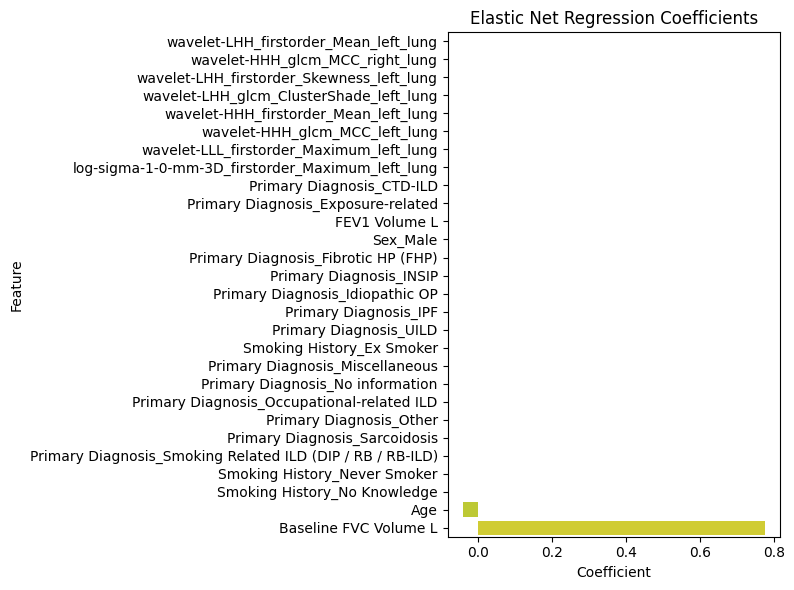

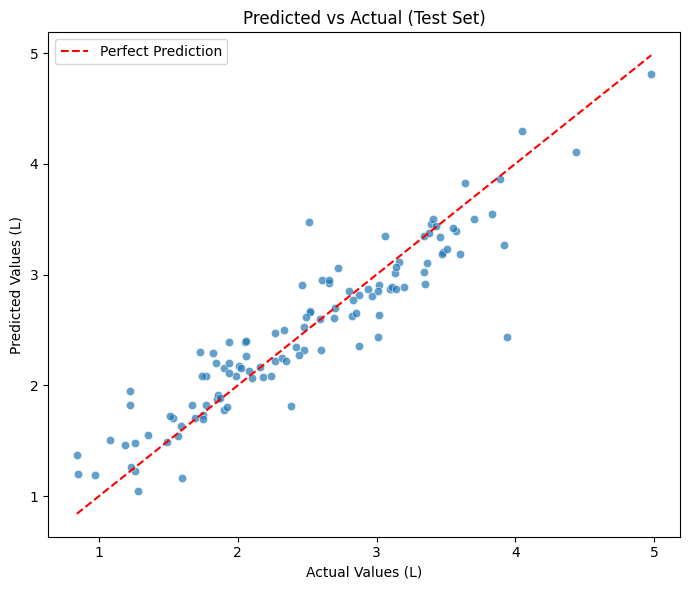

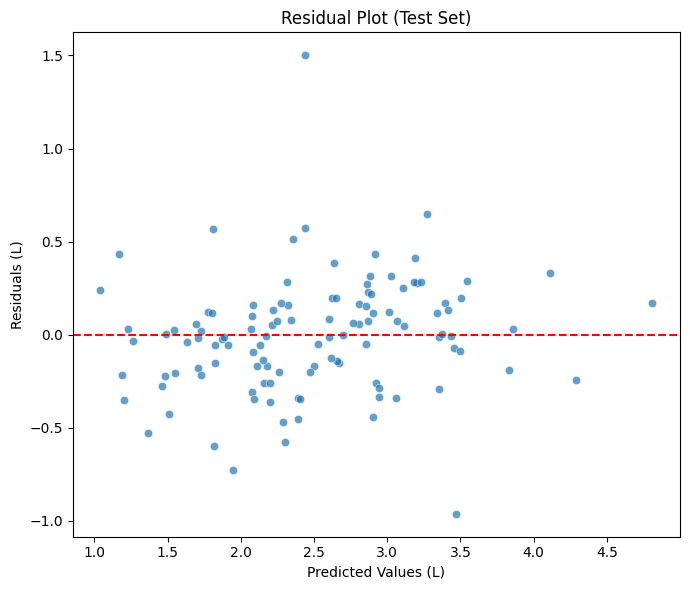


Top 5 patients with largest errors:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
1000934          2.50        3.94       2.438990   1.501010   
545418           3.63        2.51       3.472173   0.962173   
1001175          1.98        1.22       1.947253   0.727253   
1001223          3.46        3.92       3.269980   0.650020   
347690           1.80        1.22       1.818370   0.598370   

         Baseline_FVC_Week  Followup_FVC_Week  
1000934                0.0               52.0  
545418                 0.0               53.0  
1001175                0.0               54.0  
1001223                0.0               48.0  
347690                 0.0               50.0  


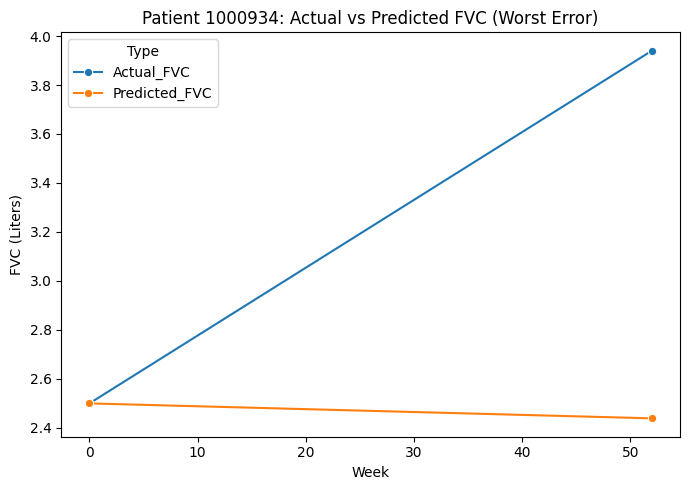

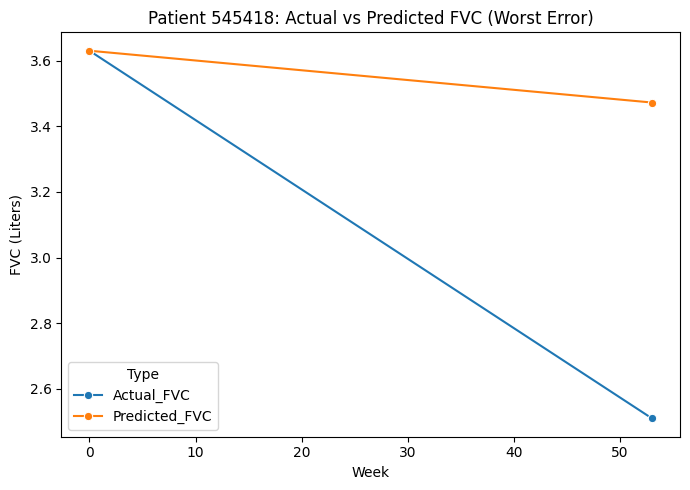

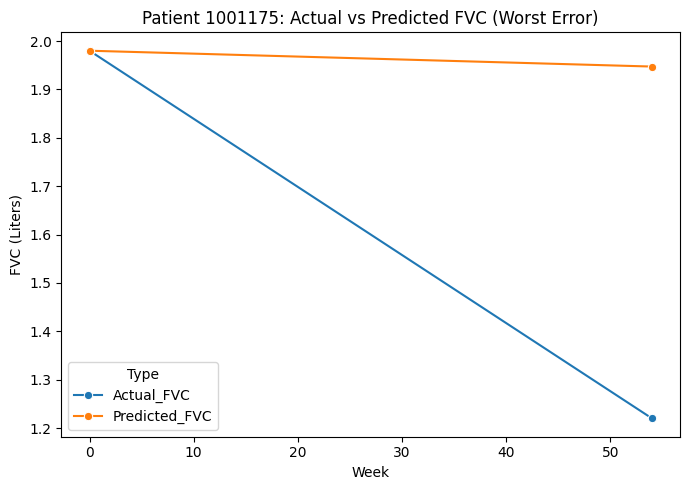

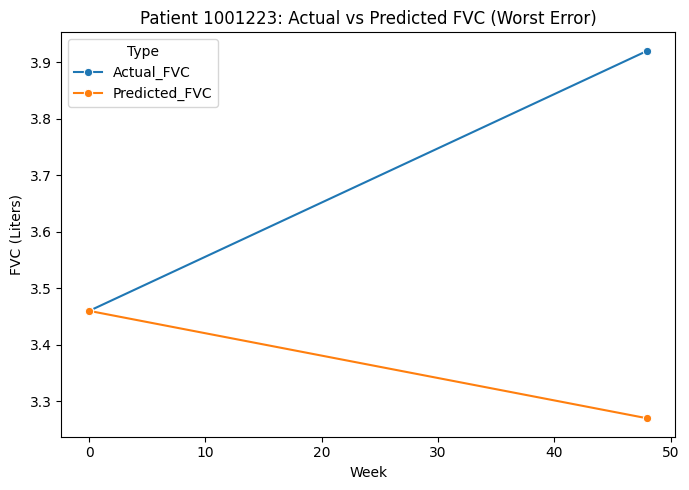

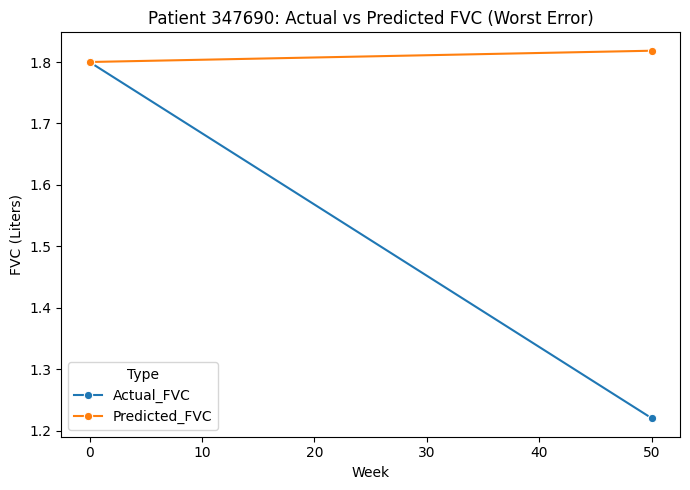


Top 5 patients with increasing FVC and lowest error:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
1001253          1.43        1.49       1.487119   0.002881   
142332           1.67        1.69       1.707191   0.017191   
1000616          1.73        1.75       1.731895   0.018105   
1000769          1.56        1.57       1.545961   0.024039   
1001197          1.18        1.26       1.226864   0.033136   

         Baseline_FVC_Week  Followup_FVC_Week  
1001253                0.0               54.0  
142332                 0.0               50.0  
1000616                0.0               48.0  
1000769                0.0               52.0  
1001197                0.0               48.0  


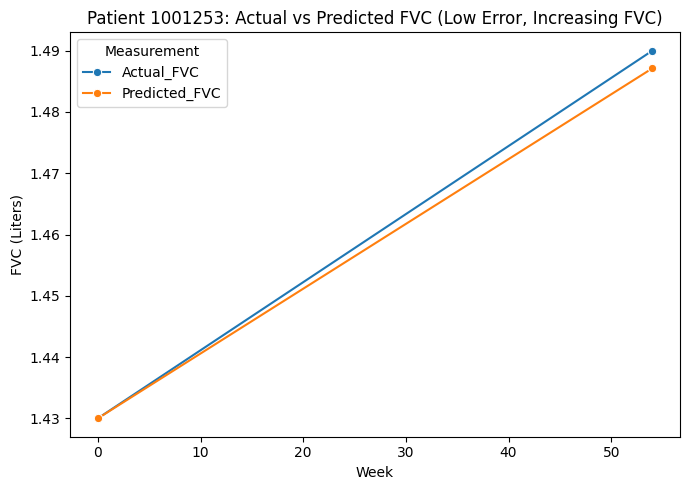

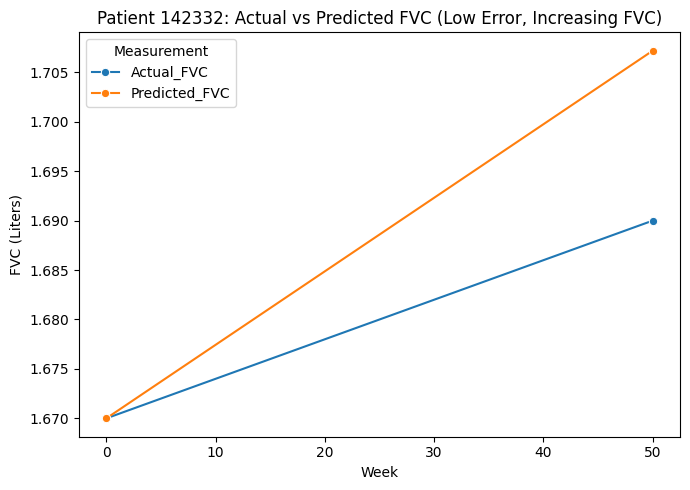

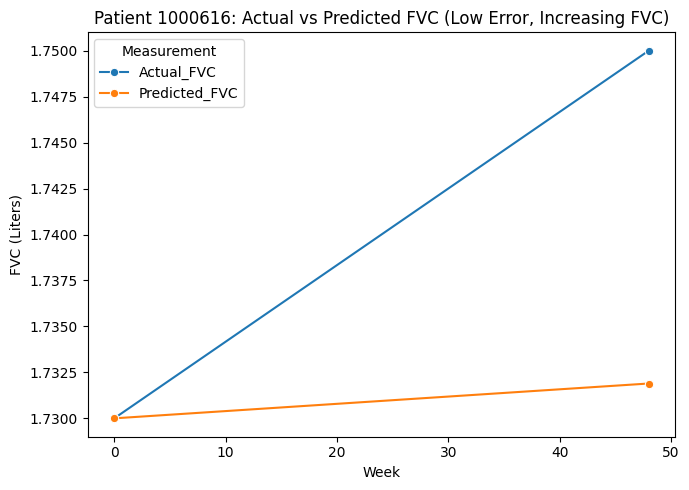

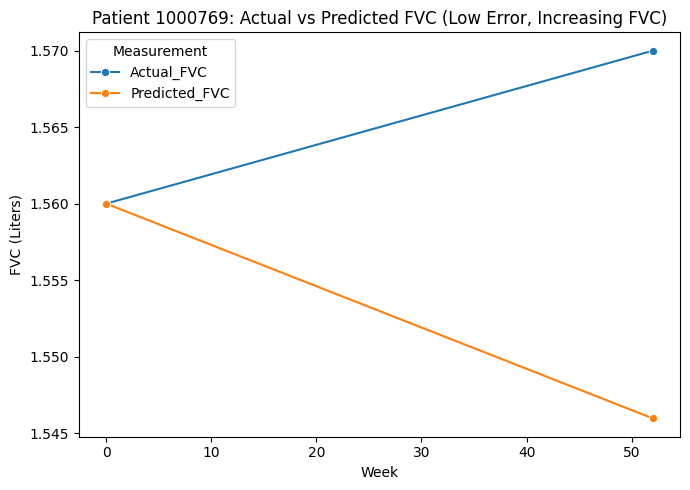

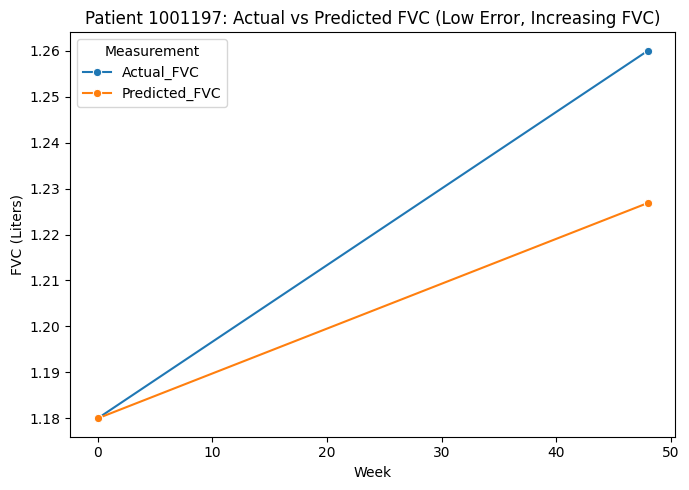

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


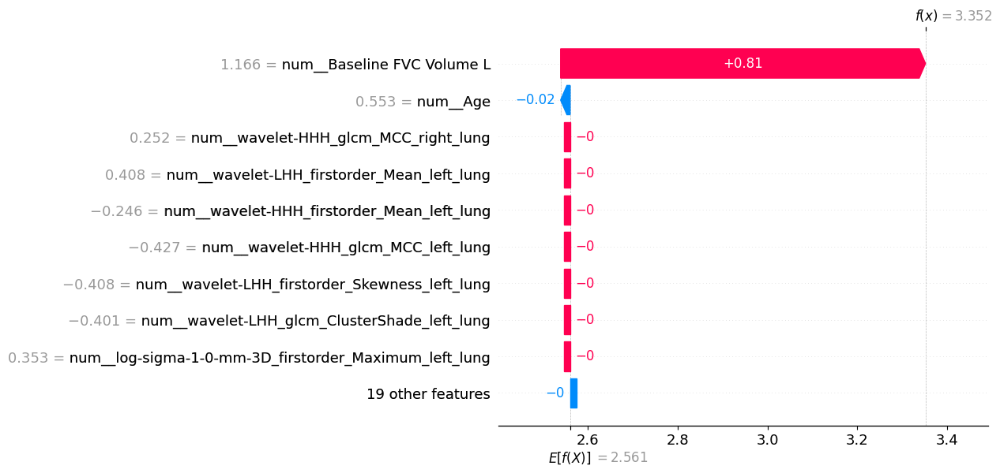

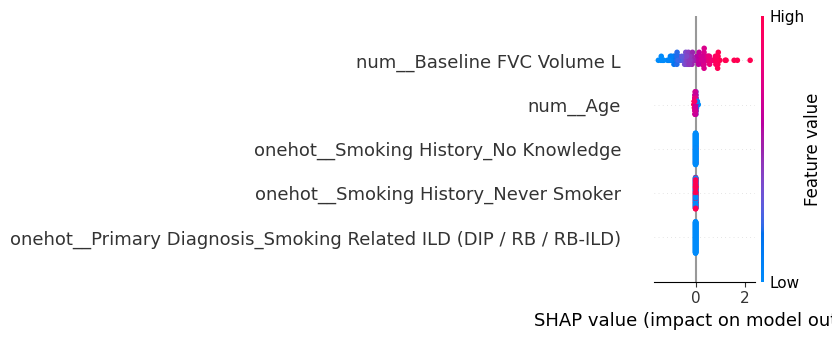

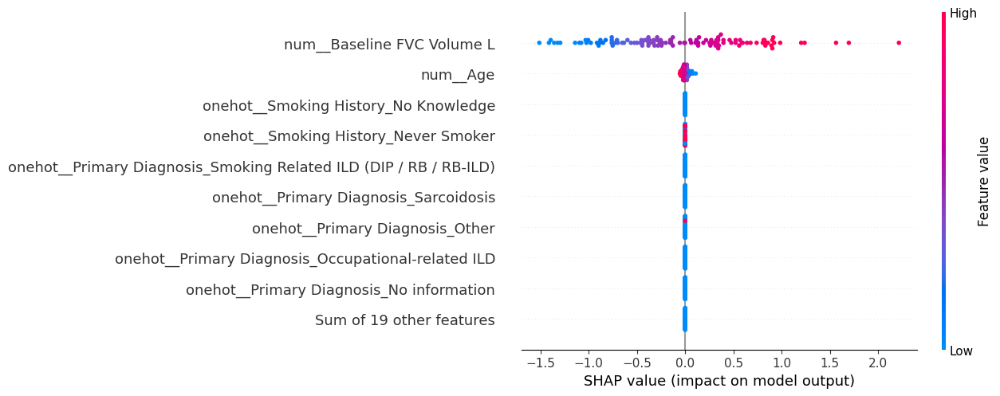

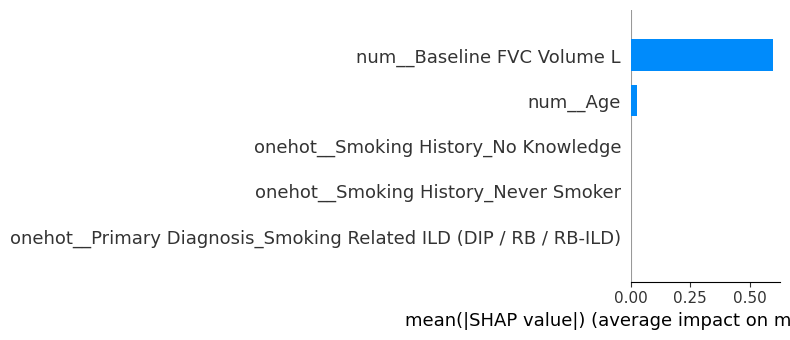

In [ ]:
selected_features = ['wavelet-HHH_glcm_MCC_right_lung', 'wavelet-LHH_firstorder_Mean_left_lung', 'wavelet-LHH_firstorder_Skewness_left_lung', 'wavelet-LHH_glcm_ClusterShade_left_lung', 'wavelet-HHH_firstorder_Mean_left_lung', 'wavelet-HHH_glcm_MCC_left_lung', 'wavelet-LLL_firstorder_Maximum_left_lung', 'log-sigma-1-0-mm-3D_firstorder_Maximum_left_lung']
Clinical_Contineous_data_ext = selected_features + Clinical_Contineous_data
print(Clinical_Contineous_data_ext)
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_with_clinical_harmonization.pkl")
X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)
# Run experiments
results1 = train_and_evaluate_elasticnet(X_train_median_filled, X_test_median_filled, y_train, y_test, selected_features, Clinical_Contineous_data_ext, Clinical_Categorical_data, 
                                         model_name="/home/pansurya/OSIC_thesis/EN_model/Hierarchical_cluster_mrmr_VIF_EN_with_harmonizationPycombat.pkl")



['log-sigma-2-0-mm-3D_ngtdm_Strength_left_lung', 'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-HLH_glszm_LargeAreaHighGrayLevelEmphasis_right_lung', 'log-sigma-5-0-mm-3D_glrlm_RunEntropy_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Coarseness_right_lung', 'original_firstorder_90Percentile_right_lung', 'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-2-0-mm-3D_firstorder_Energy_left_lung', 'wavelet-LHH_ngtdm_Contrast_right_lung', 'wavelet-HHL_ngtdm_Contrast_right_lung', 'wavelet-HLH_ngtdm_Contrast_left_lung', 'Baseline FVC Volume L', 'Age', 'FEV1 Volume L']
Numeric features: ['log-sigma-2-0-mm-3D_ngtdm_Strength_left_lung', 'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-HLH_glszm_LargeAreaHighGrayLevelEmphasis_right_lung', 'log-sigma-5-0-mm-3D_glrlm_RunEntropy_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Coarseness_right_lung', 'original_firstorder_90Percentile_right_lung', 'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_rig

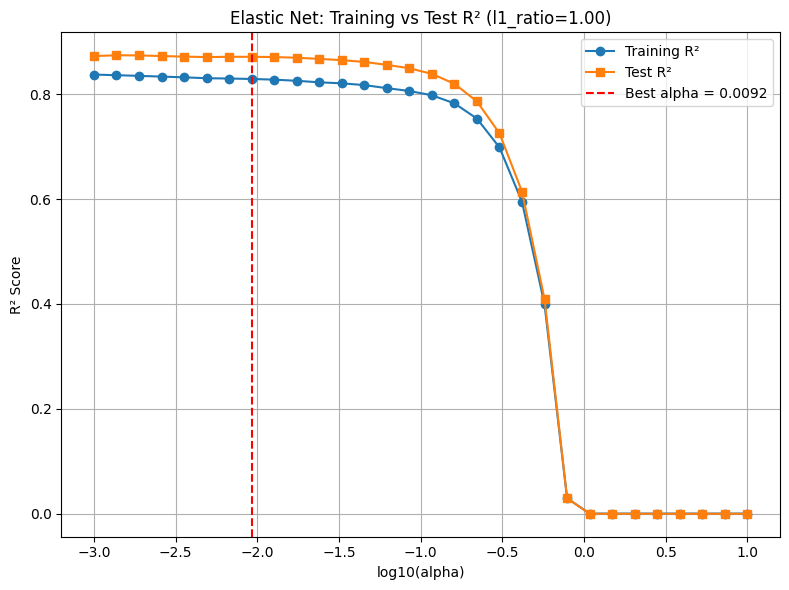


Test set performance:
- MAE:  0.22 L
- MSE:  0.09 L²
- RMSE: 0.30 L
- R²:   0.872

Training set performance:
- MAE:  0.25 L
- MSE:  0.13 L²
- RMSE: 0.37 L
- R²:   0.829

Model coefficients (sorted by |coef|):
                                              Feature  Coefficient
11                              Baseline FVC Volume L     0.726611
12                                                Age    -0.065562
14                                           Sex_Male     0.063227
10               wavelet-HLH_ngtdm_Contrast_left_lung     0.030919
0        log-sigma-2-0-mm-3D_ngtdm_Strength_left_lung    -0.028898
9               wavelet-HHL_ngtdm_Contrast_right_lung    -0.027969
5         original_firstorder_90Percentile_right_lung    -0.026303
7     log-sigma-2-0-mm-3D_firstorder_Energy_left_lung     0.015348
6   log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevel...     0.015260
1   wavelet-HHL_glrlm_GrayLevelNonUniformity_right...     0.007753
29                       Smoking History_Never Smoker

/tmp/ipykernel_2854133/1228108370.py:154: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


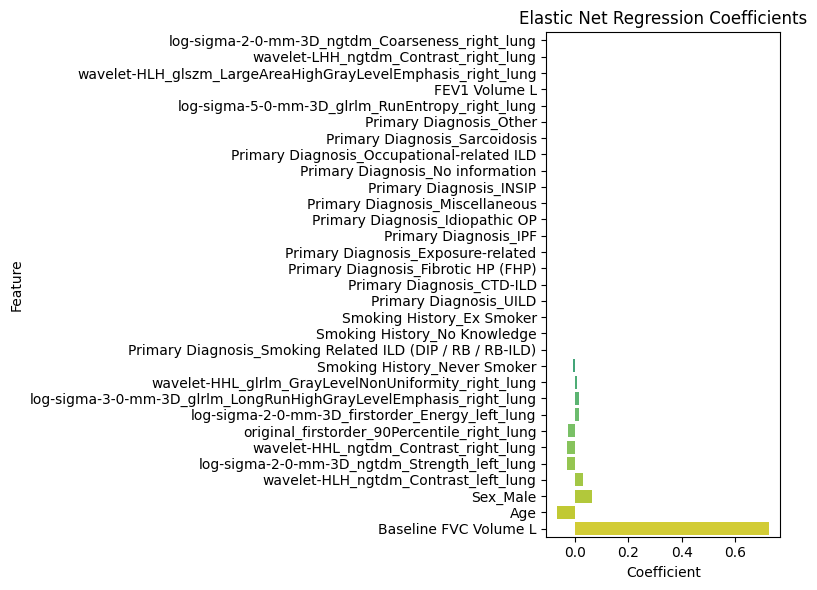

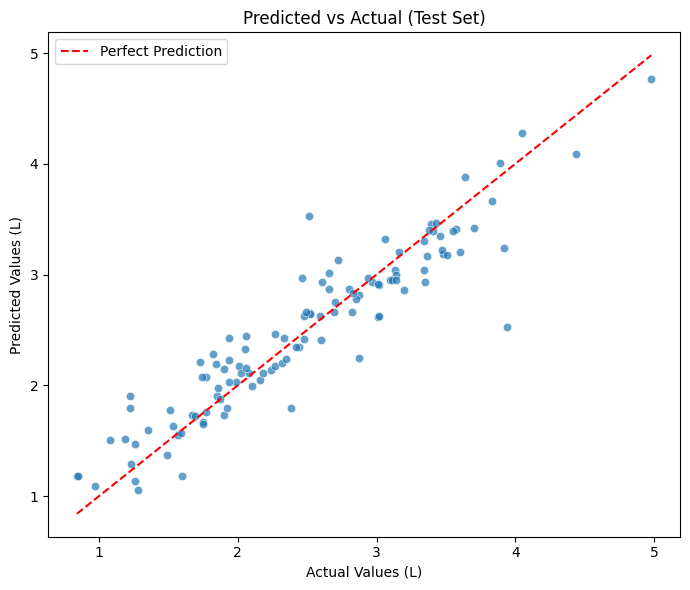

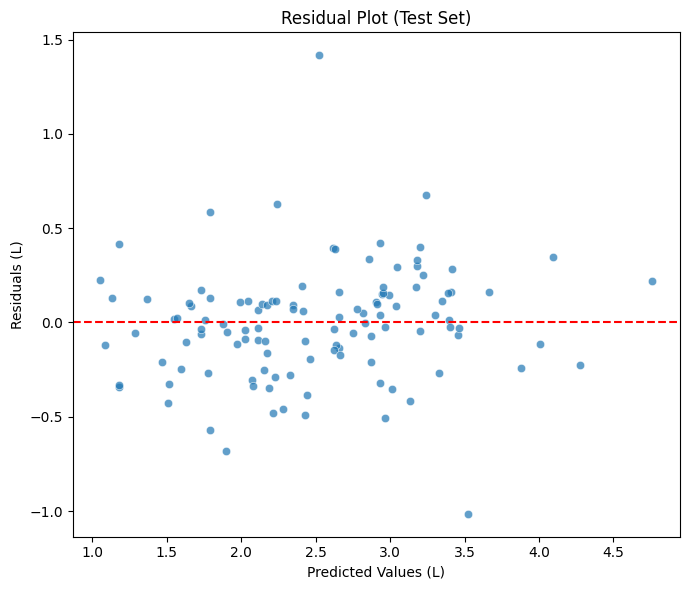


Top 5 patients with largest errors:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
1000934          2.50        3.94       2.523168   1.416832   
545418           3.63        2.51       3.524521   1.014521   
1001175          1.98        1.22       1.901390   0.681390   
1001223          3.46        3.92       3.243866   0.676134   
1001066          2.42        2.87       2.242767   0.627233   

         Baseline_FVC_Week  Followup_FVC_Week  
1000934                0.0               52.0  
545418                 0.0               53.0  
1001175                0.0               54.0  
1001223                0.0               48.0  
1001066                0.0               48.0  


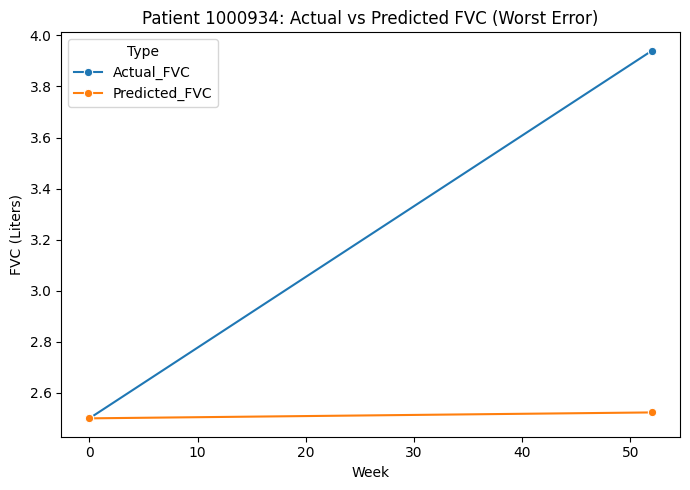

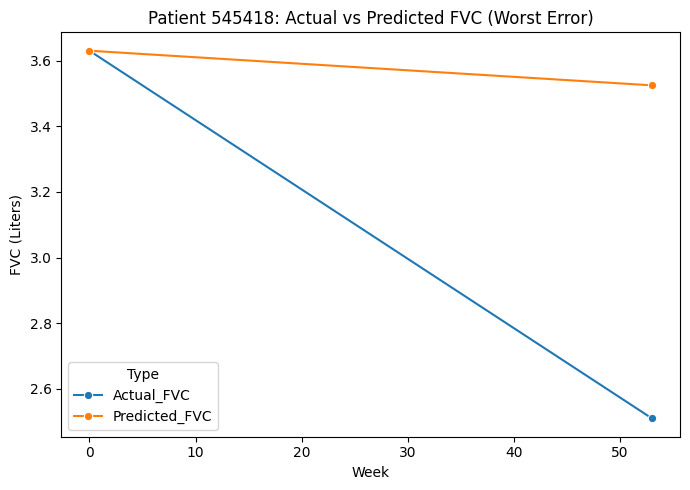

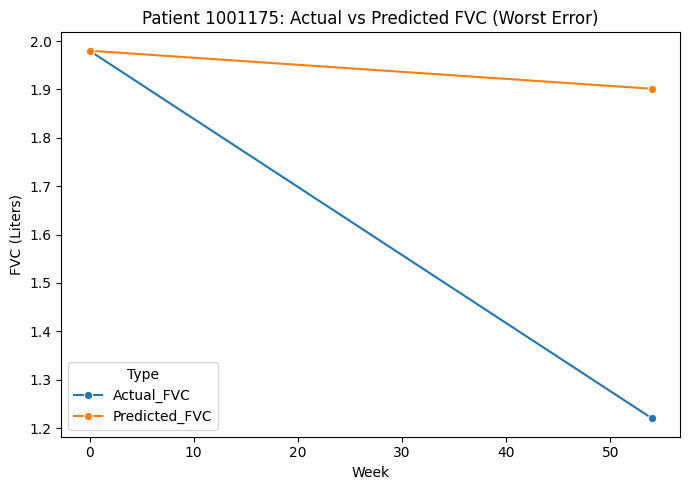

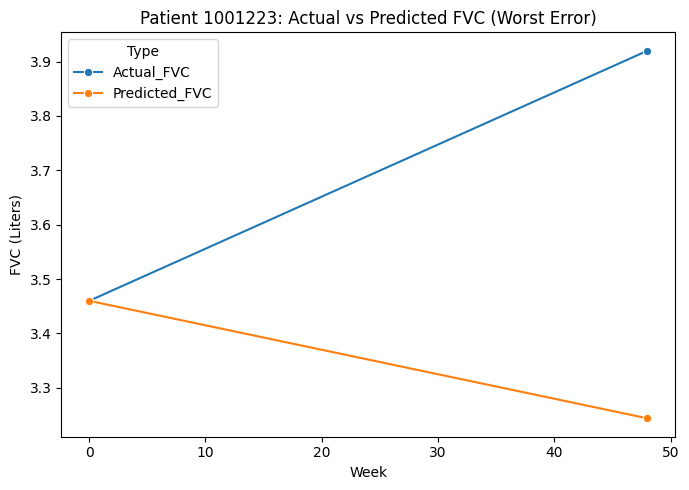

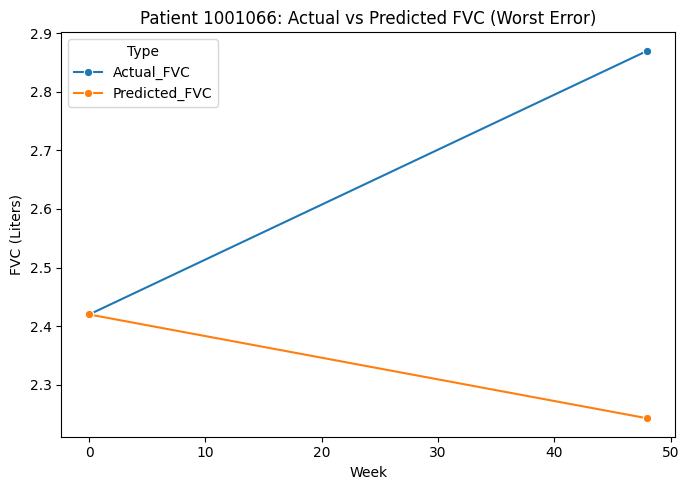


Top 5 patients with increasing FVC and lowest error:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
1000769          1.56        1.57       1.551526   0.018474   
142332           1.67        1.69       1.727286   0.037286   
1000649          2.92        2.97       2.931107   0.038893   
1000971          1.21        1.23       1.287976   0.057976   
191720           2.36        2.48       2.418659   0.061341   

         Baseline_FVC_Week  Followup_FVC_Week  
1000769                0.0               52.0  
142332                 0.0               50.0  
1000649                0.0               48.0  
1000971                0.0               48.0  
191720                 0.0               53.0  


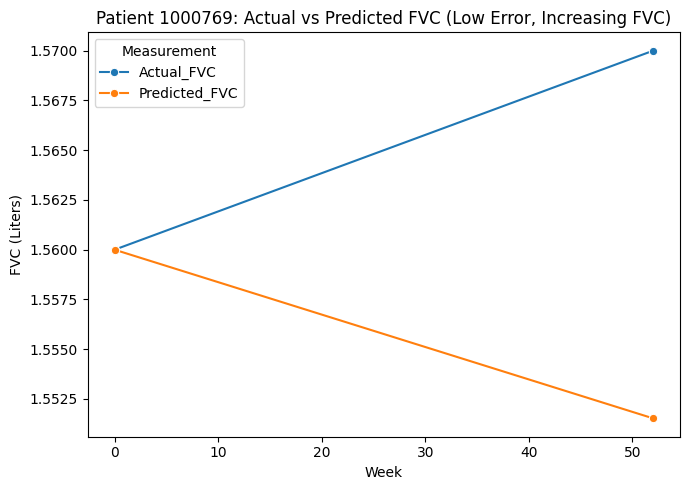

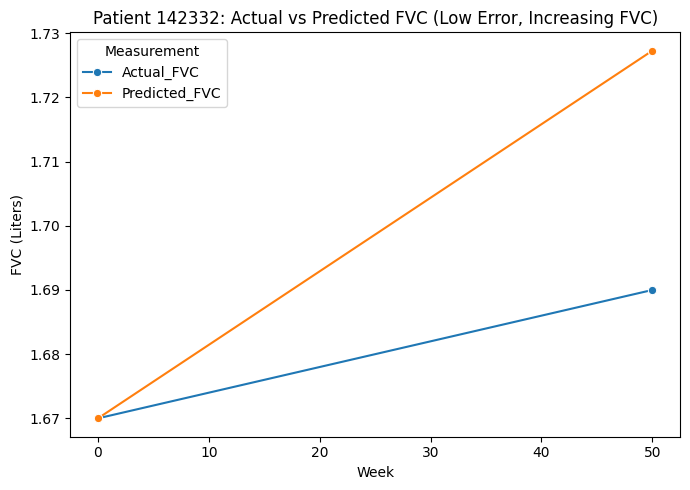

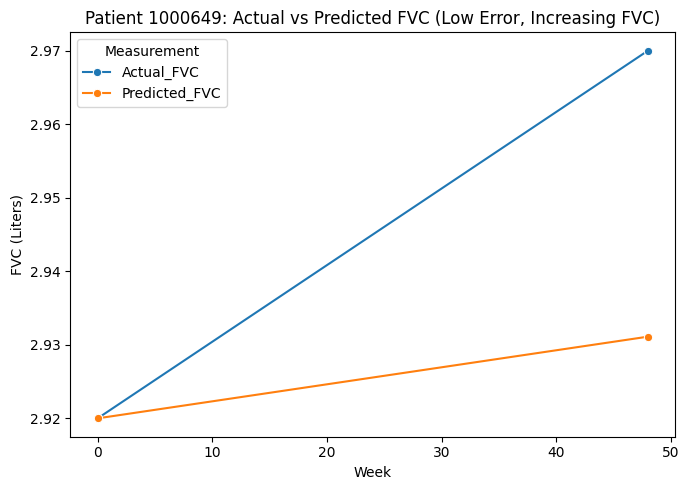

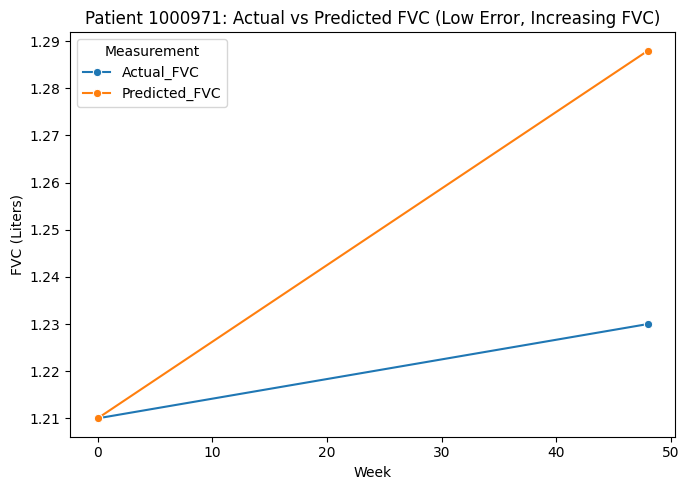

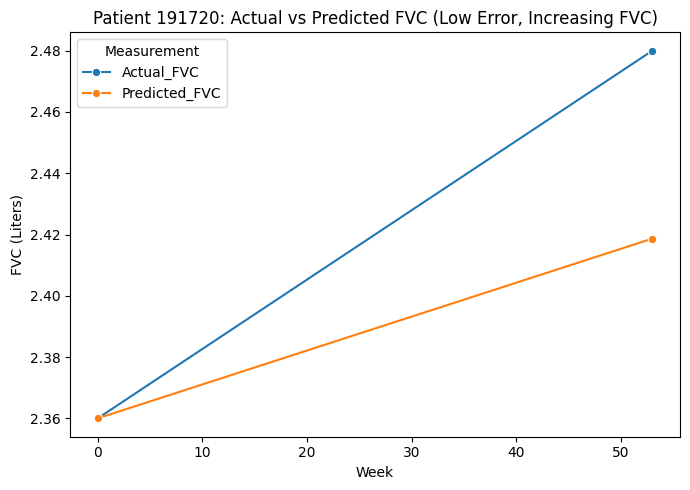

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


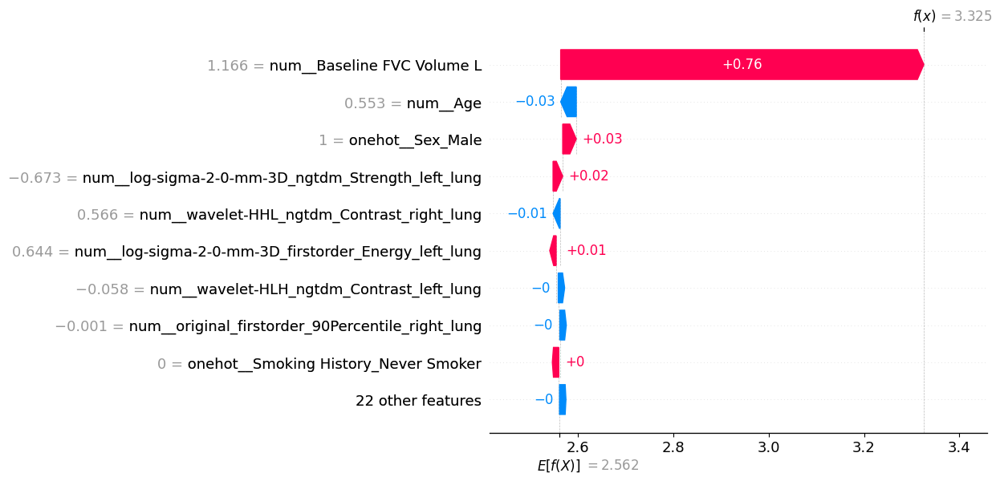

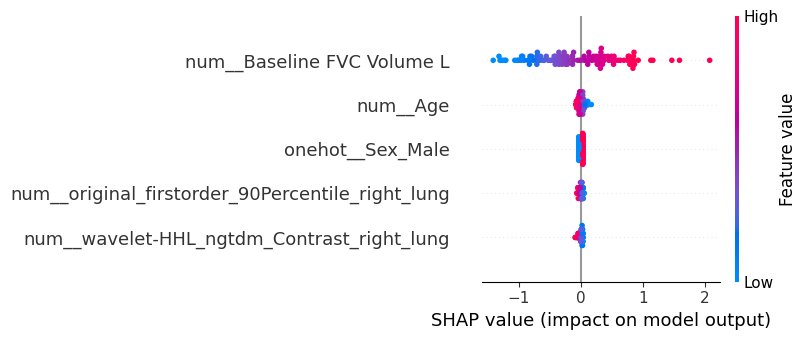

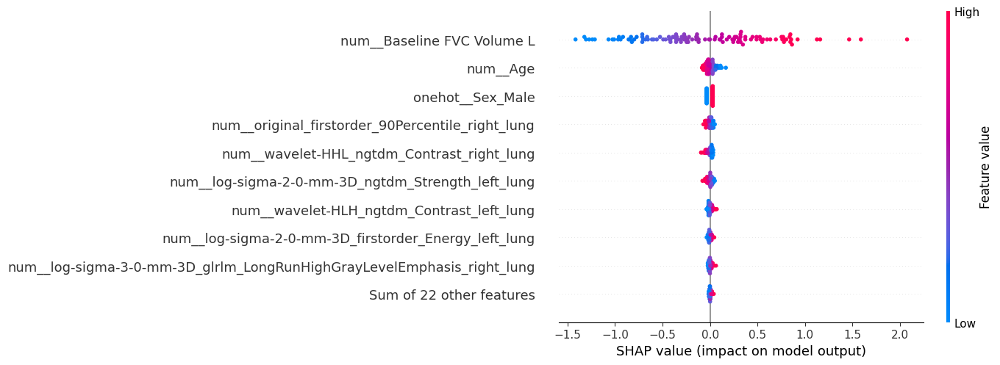

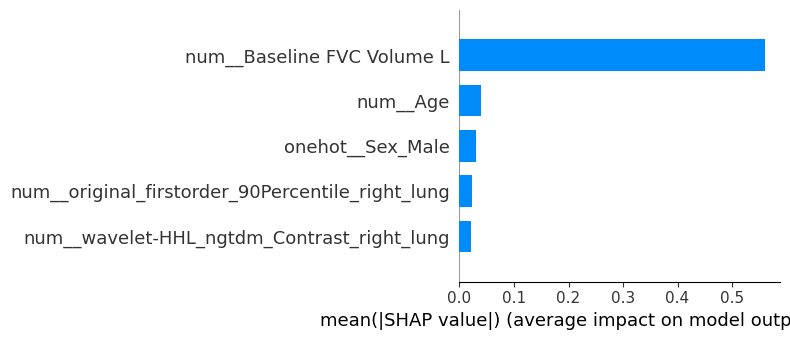

In [ ]:
selected_features = ['log-sigma-2-0-mm-3D_ngtdm_Strength_left_lung', 'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-HLH_glszm_LargeAreaHighGrayLevelEmphasis_right_lung', 'log-sigma-5-0-mm-3D_glrlm_RunEntropy_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Coarseness_right_lung', 'original_firstorder_90Percentile_right_lung', 'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-2-0-mm-3D_firstorder_Energy_left_lung', 'wavelet-LHH_ngtdm_Contrast_right_lung', 'wavelet-HHL_ngtdm_Contrast_right_lung', 'wavelet-HLH_ngtdm_Contrast_left_lung']
Clinical_Contineous_data_ext = selected_features + Clinical_Contineous_data
print(Clinical_Contineous_data_ext)
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_with_clinical_harmonization.pkl")
X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)
# Run experiments
results1 = train_and_evaluate_elasticnet(X_train_median_filled, X_test_median_filled, y_train, y_test, selected_features, Clinical_Contineous_data_ext, Clinical_Categorical_data, 
                                         model_name="/home/pansurya/OSIC_thesis/EN_model/PCA_K-means_EN_with_harmonizationPycombat.pkl")



Correlation-Based Pipelines 

['original_shape_MinorAxisLength_right_lung', 'original_shape_SurfaceArea_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'wavelet-HHL_glcm_Idmn_right_lung', 'log-sigma-2-0-mm-3D_firstorder_Median_right_lung', 'log-sigma-3-0-mm-3D_glcm_Idmn_right_lung', 'log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'log-sigma-4-0-mm-3D_glcm_InverseVariance_right_lung', 'original_shape_MinorAxisLength_left_lung', 'log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung', 'Baseline FVC Volume L', 'Age', 'FEV1 Volume L']
Numeric features: ['original_shape_MinorAxisLength_right_lung', 'original_shape_SurfaceArea_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'wavelet-HHL_glcm_Idmn_right_lung', 'log-sigma-2-0-mm-3D_firstorder_Median_right_lung', 'log-sigma-3-0-mm-3D_glcm_Idmn_right_lung', 'log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'log-sigma-4-0-mm-3D_glcm_InverseVariance_right_lung',

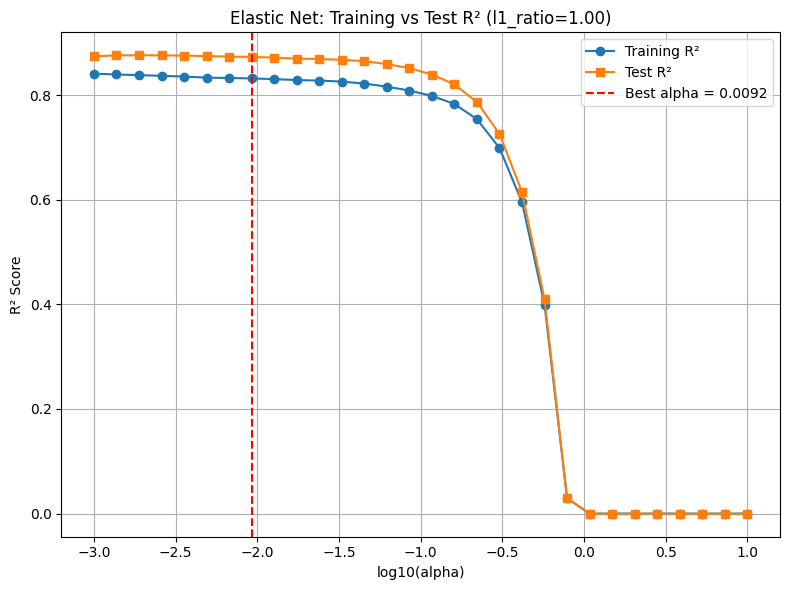


Test set performance:
- MAE:  0.21 L
- MSE:  0.09 L²
- RMSE: 0.30 L
- R²:   0.873

Training set performance:
- MAE:  0.25 L
- MSE:  0.13 L²
- RMSE: 0.36 L
- R²:   0.832

Model coefficients (sorted by |coef|):
                                              Feature  Coefficient
10                              Baseline FVC Volume L     0.713657
11                                                Age    -0.068519
8            original_shape_MinorAxisLength_left_lung     0.066387
13                                           Sex_Male     0.043004
9   log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGra...    -0.038228
6   log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLeve...     0.029763
5            log-sigma-3-0-mm-3D_glcm_Idmn_right_lung    -0.013066
28                       Smoking History_Never Smoker    -0.010355
2   original_gldm_LargeDependenceLowGrayLevelEmpha...     0.008519
0           original_shape_MinorAxisLength_right_lung     0.000000
4    log-sigma-2-0-mm-3D_firstorder_Median_right_lung

/tmp/ipykernel_2854133/1228108370.py:154: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


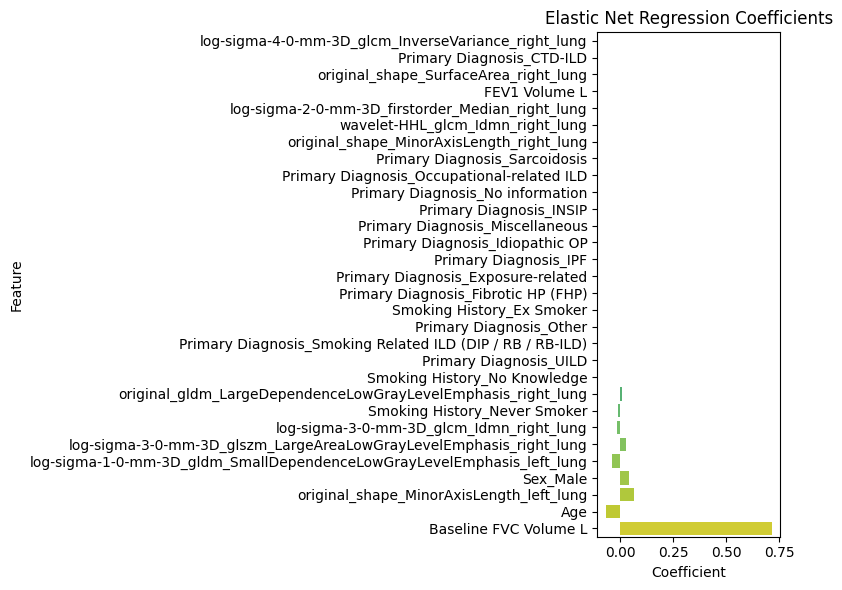

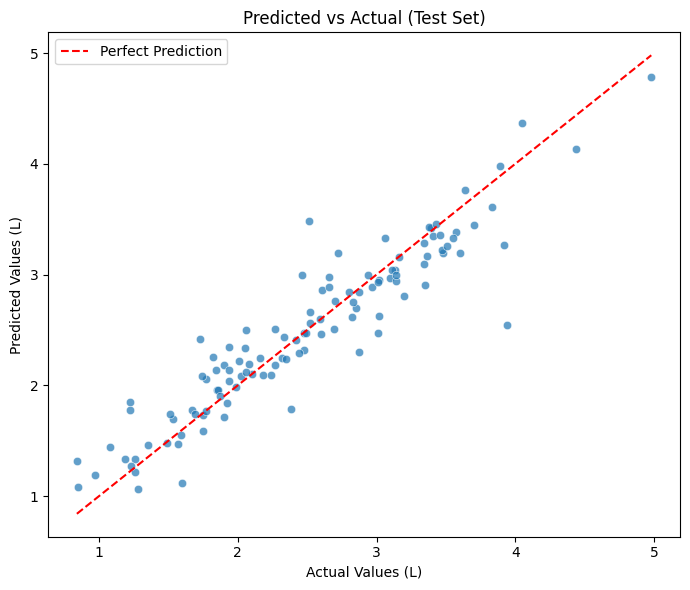

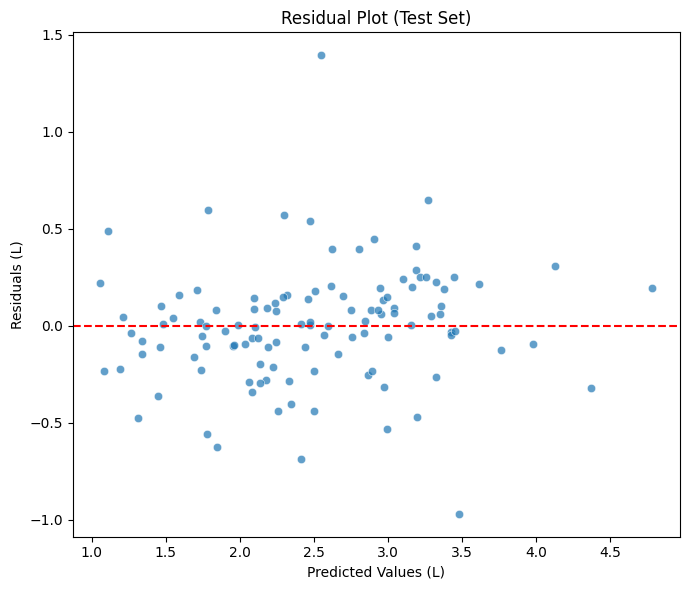


Top 5 patients with largest errors:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
1000934          2.50        3.94       2.545837   1.394163   
545418           3.63        2.51       3.480214   0.970214   
1000699          2.37        1.73       2.416382   0.686382   
1001223          3.46        3.92       3.270693   0.649307   
1001175          1.98        1.22       1.847847   0.627847   

         Baseline_FVC_Week  Followup_FVC_Week  
1000934                0.0               52.0  
545418                 0.0               53.0  
1000699                0.0               56.0  
1001223                0.0               48.0  
1001175                0.0               54.0  


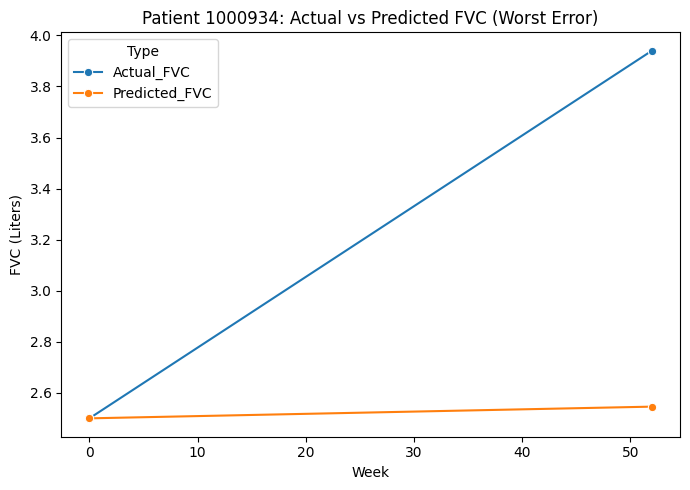

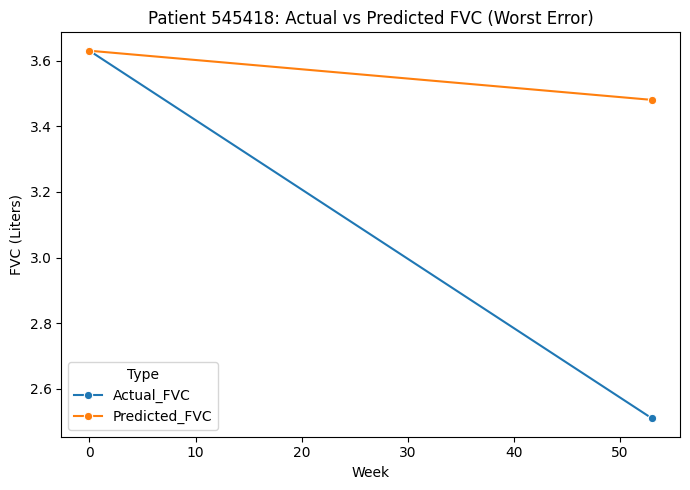

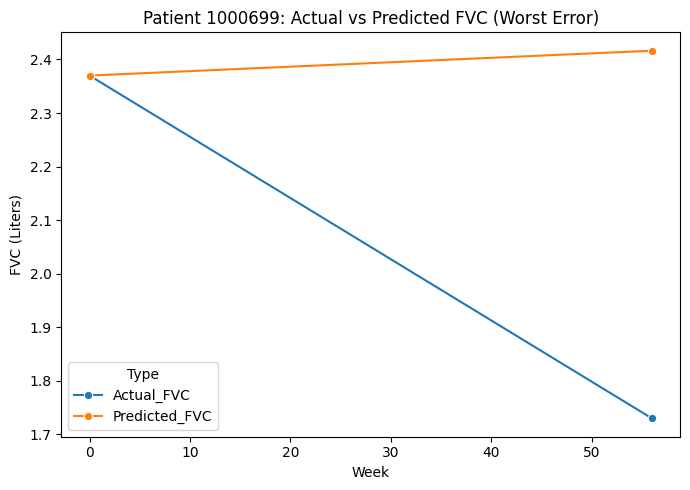

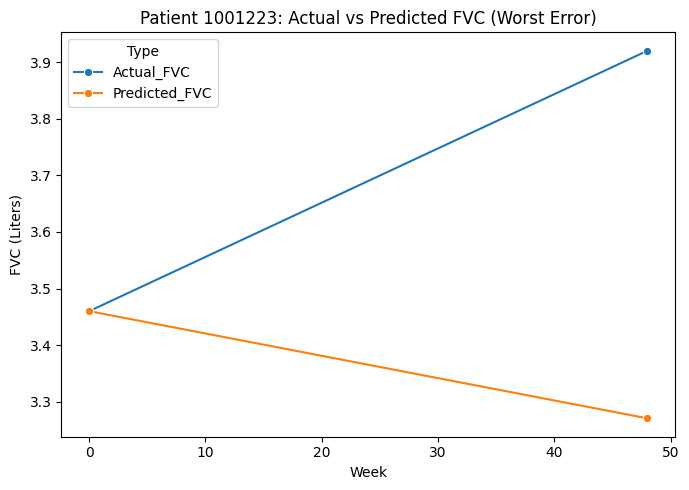

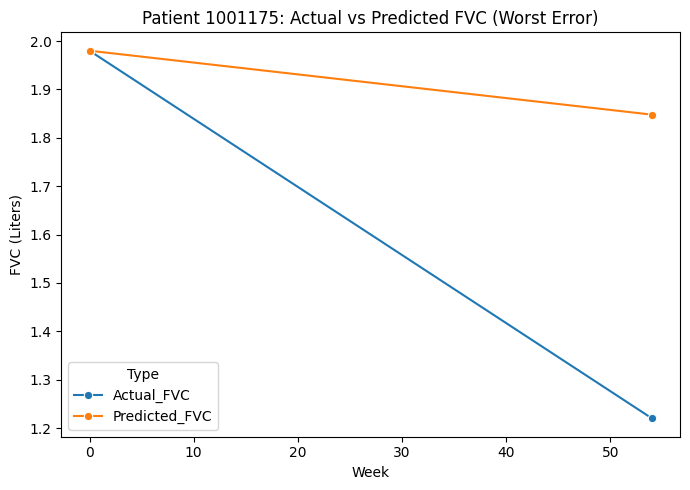


Top 5 patients with increasing FVC and lowest error:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
1001370          2.32        2.42       2.413652   0.006348   
1001253          1.43        1.49       1.479550   0.010450   
1000616          1.73        1.75       1.731169   0.018831   
1000971          1.21        1.23       1.269401   0.039401   
1001197          1.18        1.26       1.213841   0.046159   

         Baseline_FVC_Week  Followup_FVC_Week  
1001370                0.0               49.0  
1001253                0.0               54.0  
1000616                0.0               48.0  
1000971                0.0               48.0  
1001197                0.0               48.0  


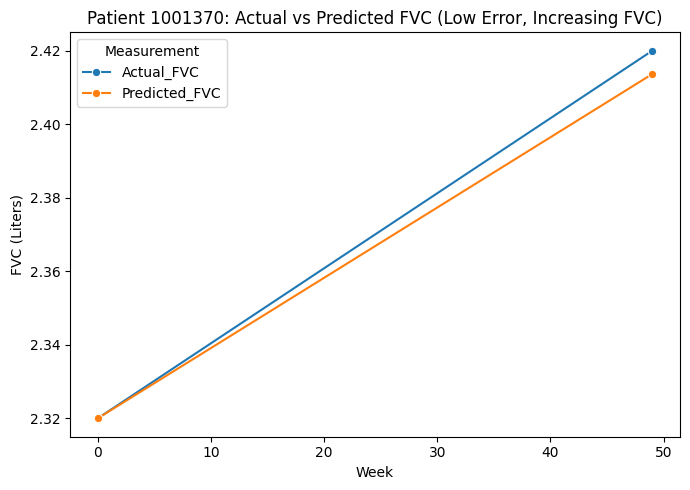

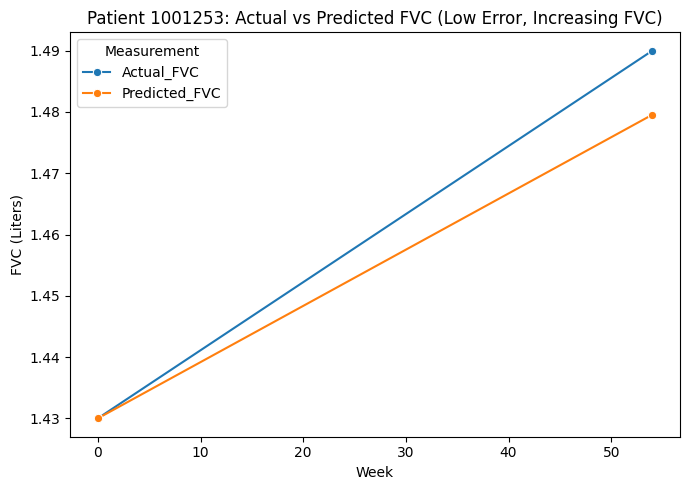

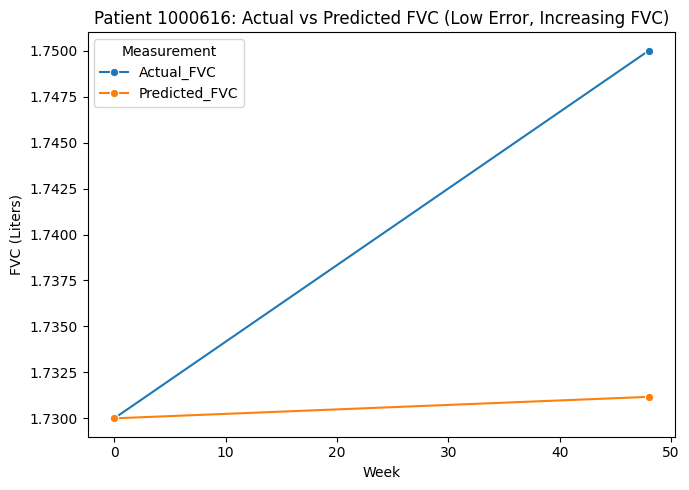

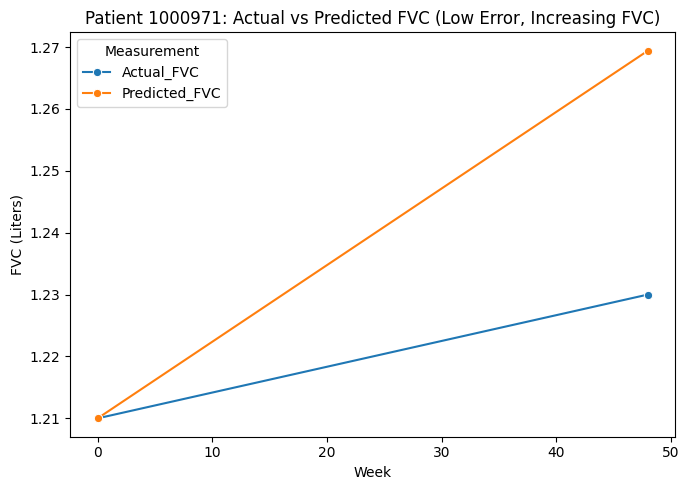

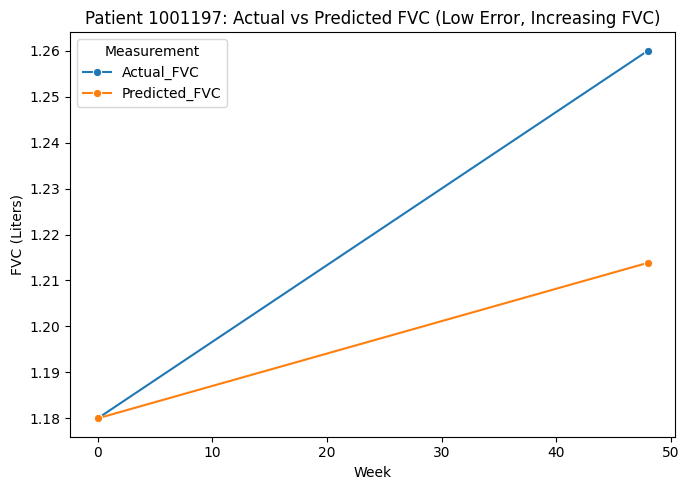

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


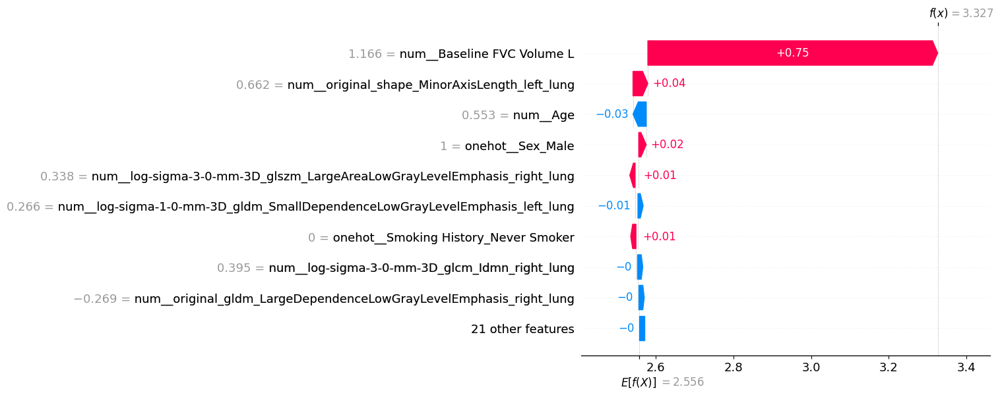

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/plots/_beeswarm.py:1150: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


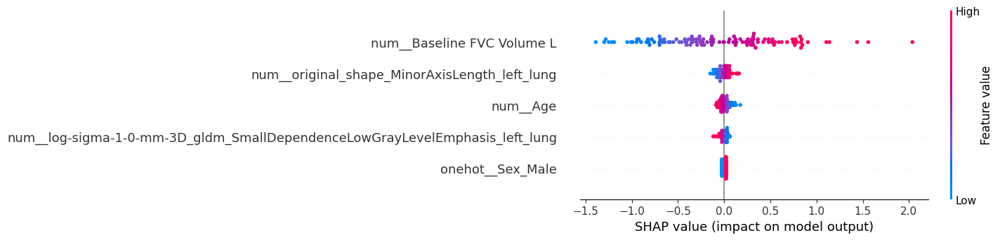

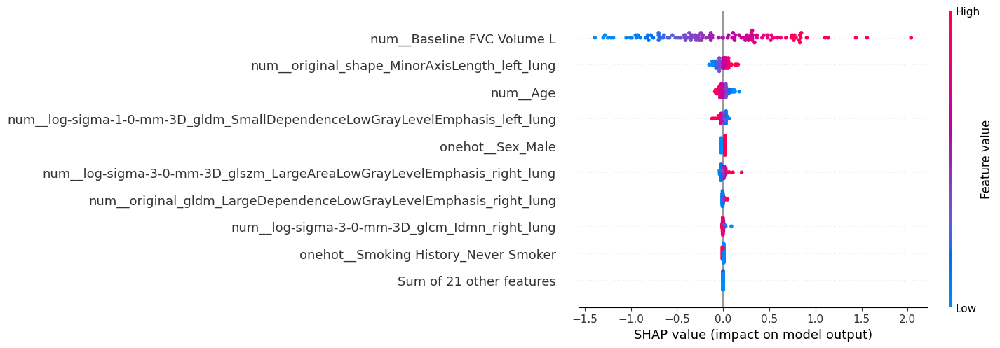

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/plots/_beeswarm.py:1150: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


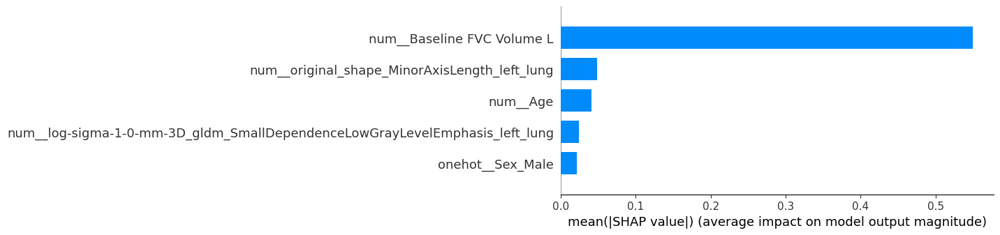

In [ ]:
selected_features = ['original_shape_MinorAxisLength_right_lung', 'original_shape_SurfaceArea_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'wavelet-HHL_glcm_Idmn_right_lung', 'log-sigma-2-0-mm-3D_firstorder_Median_right_lung', 'log-sigma-3-0-mm-3D_glcm_Idmn_right_lung', 'log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'log-sigma-4-0-mm-3D_glcm_InverseVariance_right_lung', 'original_shape_MinorAxisLength_left_lung', 'log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung']
Clinical_Contineous_data_ext = selected_features + Clinical_Contineous_data
print(Clinical_Contineous_data_ext)
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_with_clinical_harmonization.pkl")
X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)
results1 = train_and_evaluate_elasticnet(X_train_median_filled, X_test_median_filled, y_train, y_test, selected_features, Clinical_Contineous_data_ext, Clinical_Categorical_data, 
                                         model_name="/home/pansurya/OSIC_thesis/EN_model/Correlation_based_Using_Target_FVC_EN_with_harmonizationPycombat.pkl")
# print("Running LOOCV experiment...")
# results1 = train_and_evaluate_with_LOOCV(X_train, X_test, y_train, y_test, selected_features, model_name="/home/pansurya/OSIC_thesis/Linear_model/PAM_ANOVA_VIF_LOOCV.pkl")


['original_shape_MinorAxisLength_left_lung', 'wavelet-HLH_gldm_DependenceNonUniformityNormalized_right_lung', 'log-sigma-2-0-mm-3D_firstorder_10Percentile_right_lung', 'original_shape_MinorAxisLength_right_lung', 'wavelet-HHL_glcm_Idmn_right_lung', 'original_shape_SurfaceArea_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'log-sigma-3-0-mm-3D_glcm_InverseVariance_right_lung', 'log-sigma-2-0-mm-3D_firstorder_Kurtosis_left_lung', 'log-sigma-1-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung', 'log-sigma-4-0-mm-3D_glcm_InverseVariance_right_lung', 'wavelet-LHL_glcm_Idmn_left_lung', 'log-sigma-1-0-mm-3D_firstorder_Skewness_left_lung', 'wavelet-HLL_firstorder_Kurtosis_left_lung', 'Baseline FVC Volume L', 'Age', 'FEV1 Volume L']
Numeric features: ['original_shape_MinorAxisLength_left_lung', 'wavelet-HLH_gldm_Depende

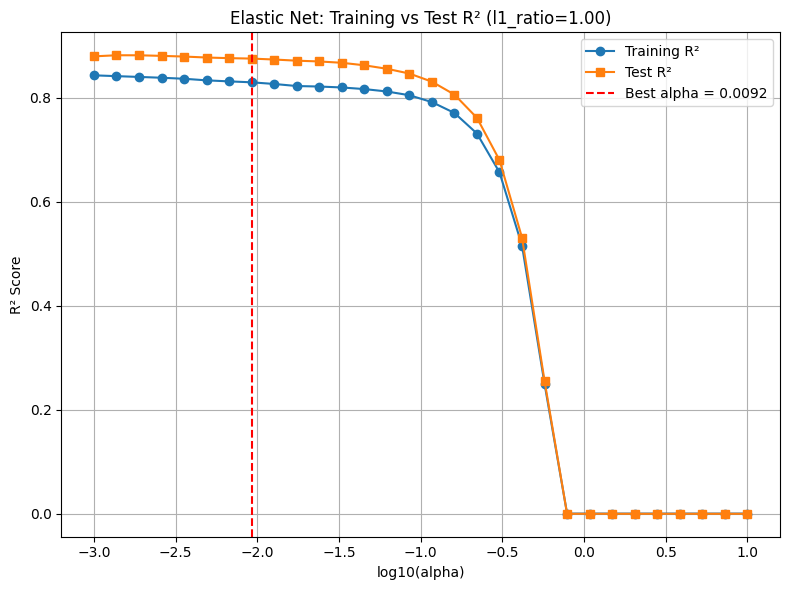


Test set performance:
- MAE:  0.21 L
- MSE:  0.09 L²
- RMSE: 0.30 L
- R²:   0.876

Training set performance:
- MAE:  0.25 L
- MSE:  0.13 L²
- RMSE: 0.37 L
- R²:   0.830

Model coefficients (sorted by |coef|):
                                              Feature  Coefficient
16                              Baseline FVC Volume L     0.831517
17                                                Age    -0.153181
0            original_shape_MinorAxisLength_left_lung     0.066130
19                                           Sex_Male     0.044826
11  log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGra...    -0.029680
10  log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLeve...     0.026179
2   log-sigma-2-0-mm-3D_firstorder_10Percentile_ri...     0.023572
34                       Smoking History_Never Smoker    -0.010804
14  log-sigma-1-0-mm-3D_firstorder_Skewness_left_lung    -0.007332
13                    wavelet-LHL_glcm_Idmn_left_lung     0.004362
3           original_shape_MinorAxisLength_right_lung

/tmp/ipykernel_1686712/3075823424.py:154: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


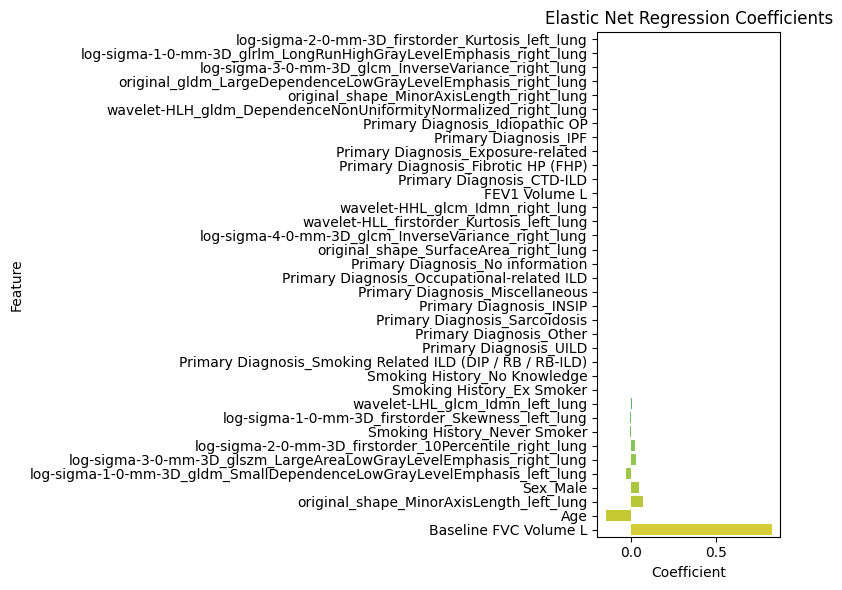

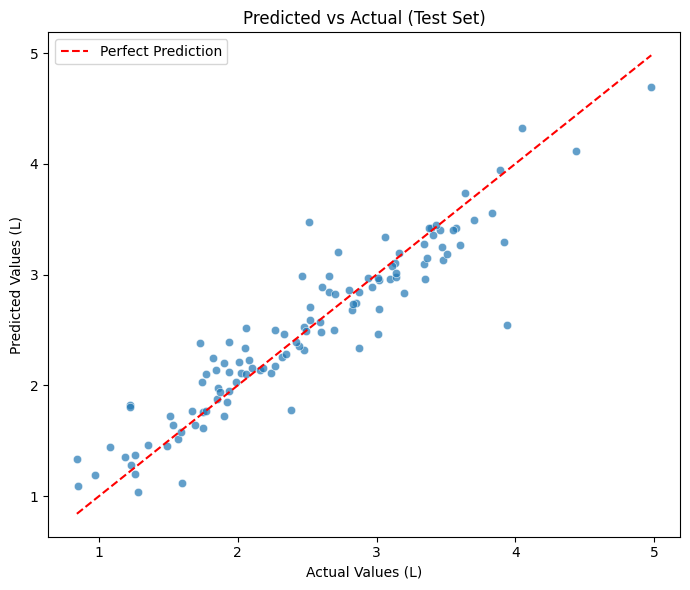

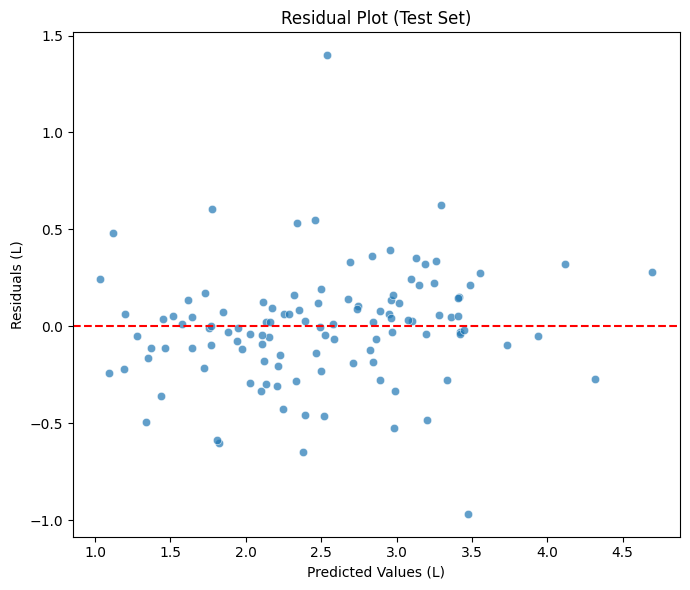


Top 5 patients with largest errors:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
1000934          2.50        3.94       2.541859   1.398141   
545418           3.63        2.51       3.475527   0.965527   
1000699          2.37        1.73       2.377724   0.647724   
1001223          3.46        3.92       3.292310   0.627690   
1001225          1.80        2.38       1.776343   0.603657   

         Baseline_FVC_Week  Followup_FVC_Week  
1000934                0.0               52.0  
545418                 0.0               53.0  
1000699                0.0               56.0  
1001223                0.0               48.0  
1001225                0.0               50.0  


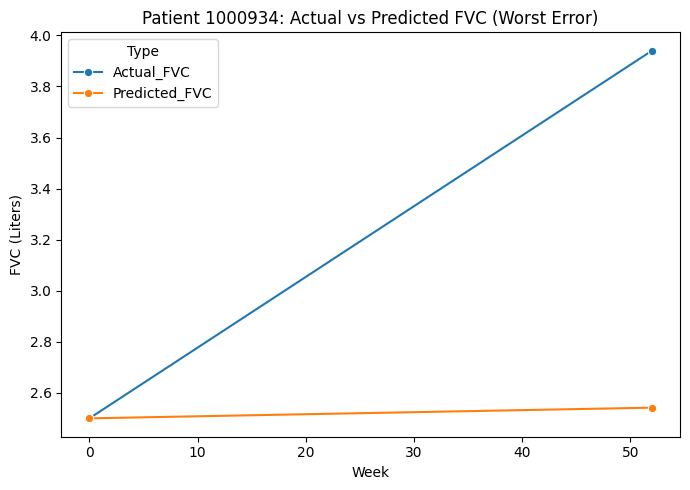

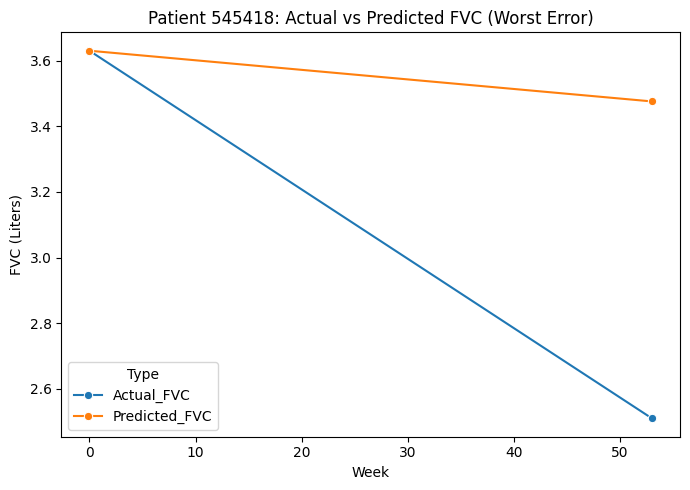

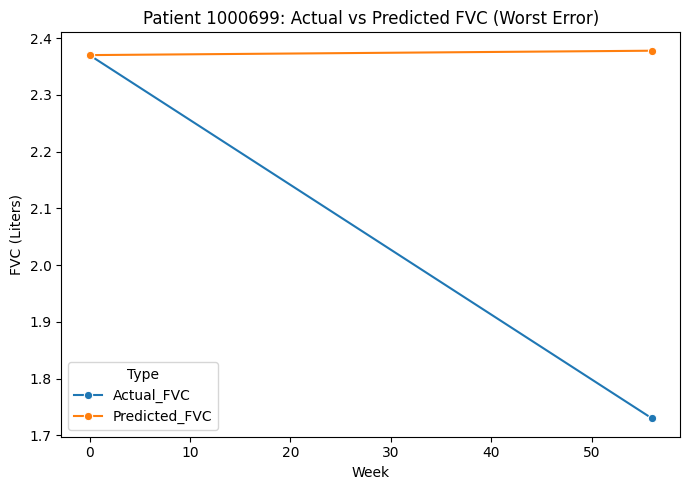

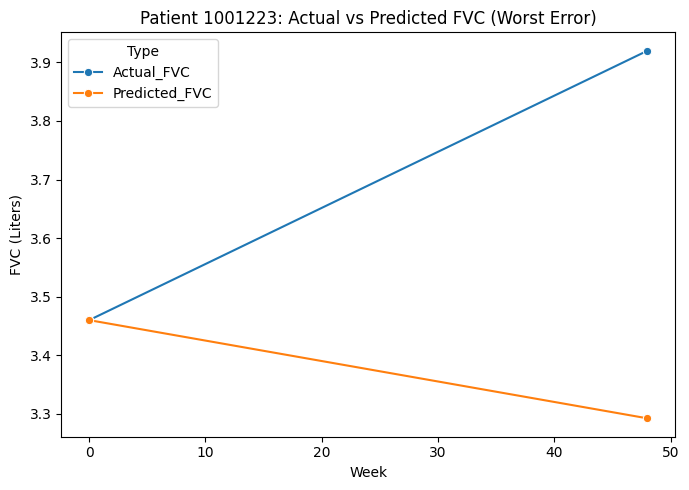

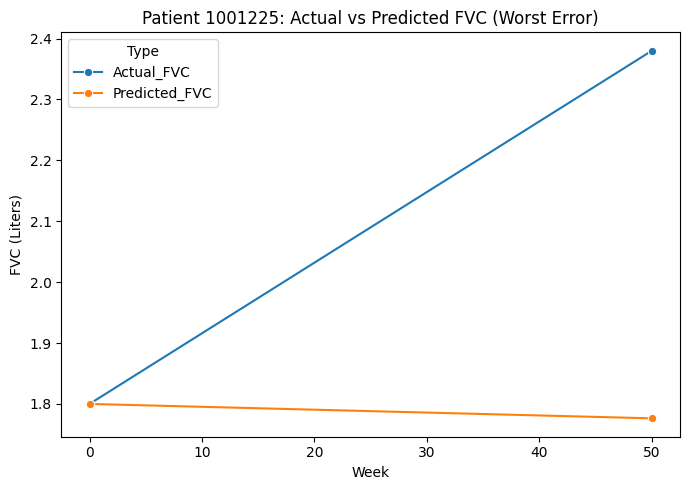


Top 5 patients with increasing FVC and lowest error:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
1000616          1.73        1.75       1.755577   0.005577   
788550           2.15        2.18       2.157828   0.022172   
1001370          2.32        2.42       2.391499   0.028501   
422697           3.02        3.11       3.075558   0.034442   
1001253          1.43        1.49       1.450837   0.039163   

         Baseline_FVC_Week  Followup_FVC_Week  
1000616                0.0               48.0  
788550                 0.0               54.0  
1001370                0.0               49.0  
422697                 0.0               52.0  
1001253                0.0               54.0  


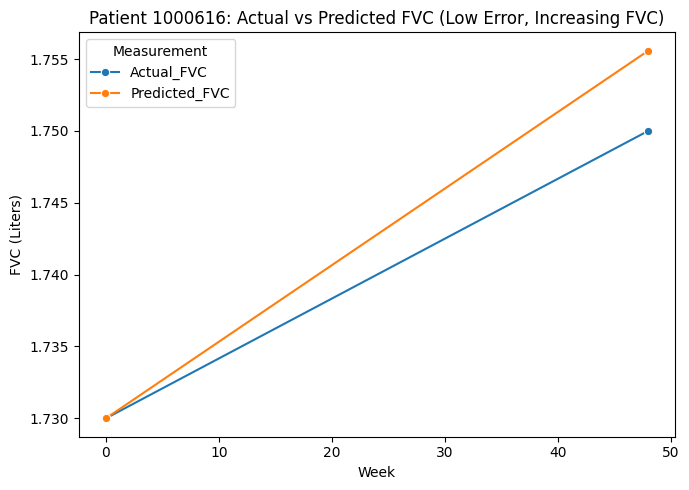

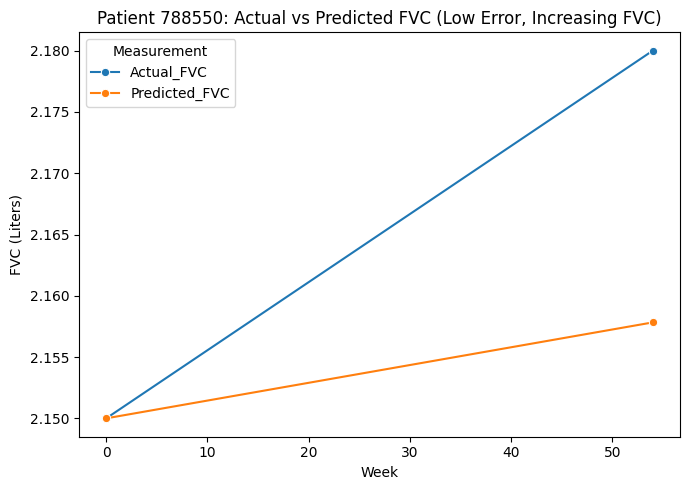

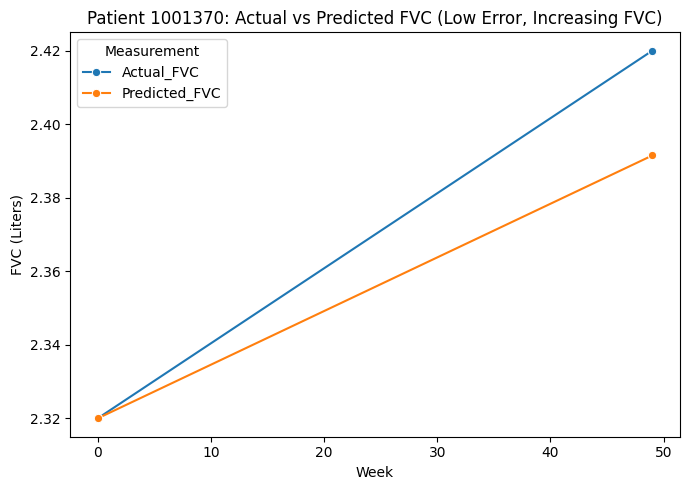

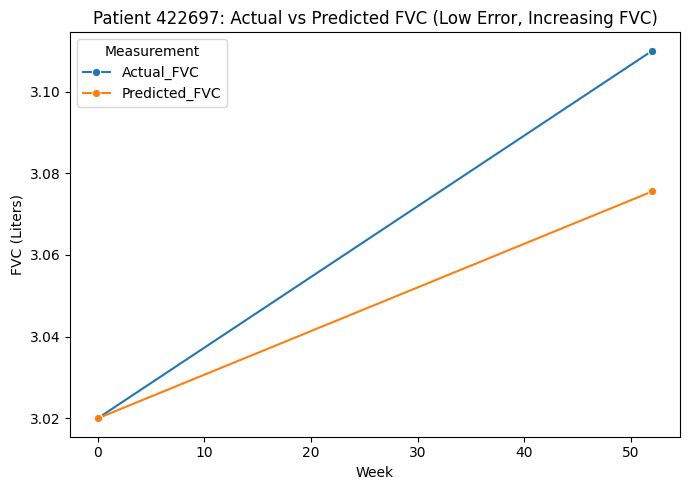

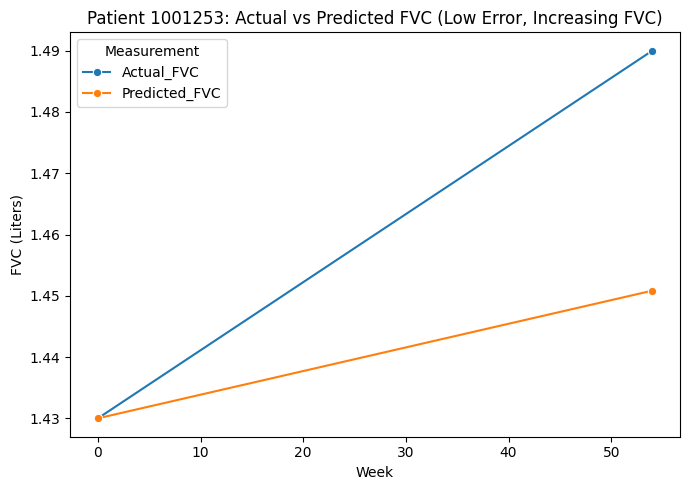

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


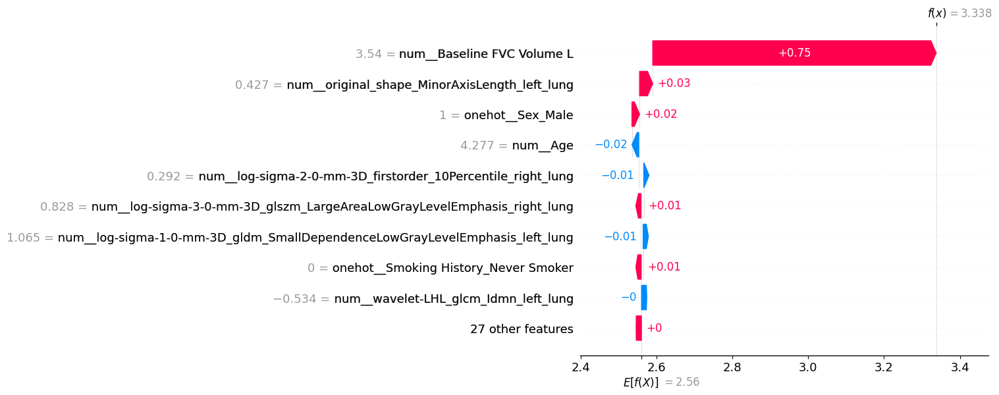

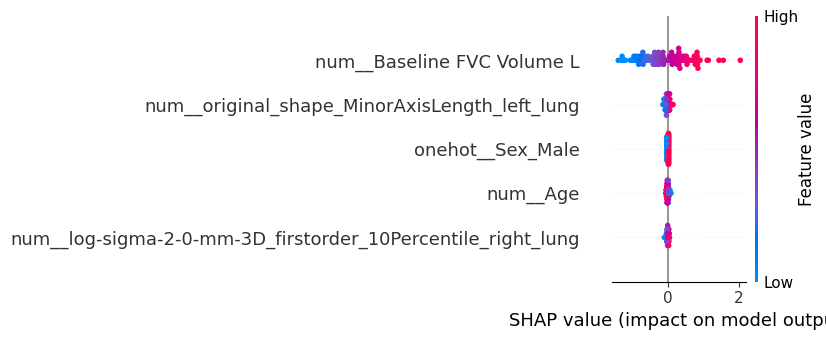

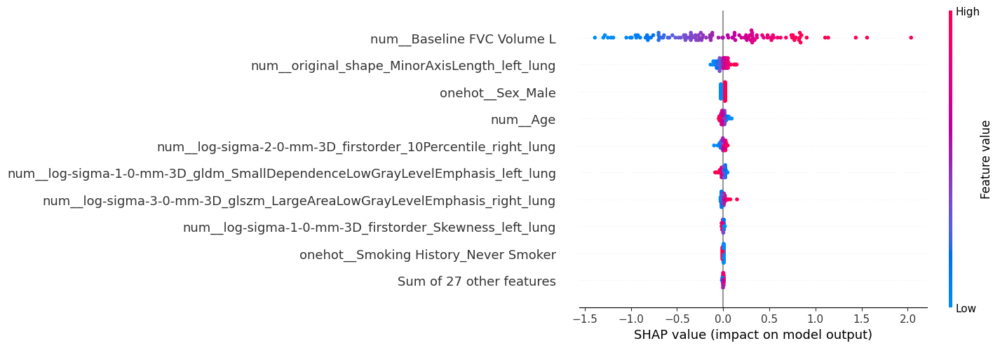

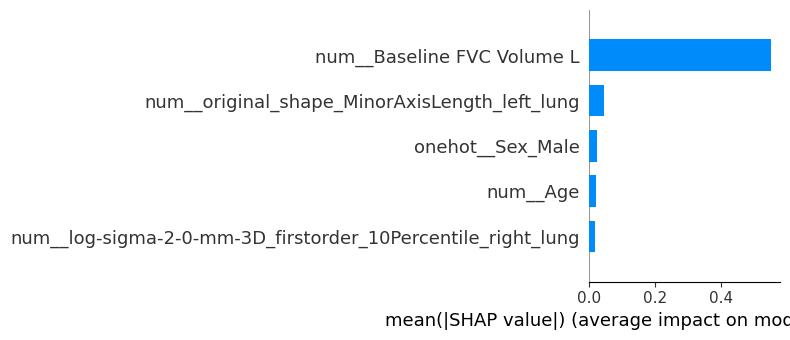

In [ ]:
selected_features = ['original_shape_MinorAxisLength_left_lung', 'wavelet-HLH_gldm_DependenceNonUniformityNormalized_right_lung', 'log-sigma-2-0-mm-3D_firstorder_10Percentile_right_lung', 'original_shape_MinorAxisLength_right_lung', 'wavelet-HHL_glcm_Idmn_right_lung', 'original_shape_SurfaceArea_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'log-sigma-3-0-mm-3D_glcm_InverseVariance_right_lung', 'log-sigma-2-0-mm-3D_firstorder_Kurtosis_left_lung', 'log-sigma-1-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung', 'log-sigma-4-0-mm-3D_glcm_InverseVariance_right_lung', 'wavelet-LHL_glcm_Idmn_left_lung', 'log-sigma-1-0-mm-3D_firstorder_Skewness_left_lung', 'wavelet-HLL_firstorder_Kurtosis_left_lung']
Clinical_Contineous_data_ext = selected_features + Clinical_Contineous_data
print(Clinical_Contineous_data_ext)
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_with_clinical_harmonization.pkl")
X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)


# Run experiments
results1 = train_and_evaluate_elasticnet(X_train_median_filled, X_test_median_filled, y_train, y_test, selected_features, Clinical_Contineous_data_ext, Clinical_Categorical_data, 
                                         model_name="/home/pansurya/OSIC_thesis/EN_model/Correlation_based_Using_mrmr_EN_with_harmonizationPycombat.pkl")
# print("Running LOOCV experiment...")
# results1 = train_and_evaluate_with_LOOCV(X_train, X_test, y_train, y_test, selected_features, model_name="/home/pansurya/OSIC_thesis/Linear_model/PAM_ANOVA_VIF_LOOCV.pkl")


In [55]:
import joblib
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import numpy as np

# ---------------------------------------------------------
# ✅ Load saved model (full pipeline)
# ---------------------------------------------------------
model_path = "/home/pansurya/OSIC_thesis/LASSO_model/Correlation_based_Using_mrmr_without_harmonization.pkl"
pipeline = joblib.load(model_path)

# ---------------------------------------------------------
# ✅ Load the same train/test split used during training
# ---------------------------------------------------------
X_train, X_test, y_train, y_test = joblib.load(
    "/home/pansurya/OSIC_thesis/radiomics_files/data_splits_clinical_without_harmonization.pkl"
)

X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)

# ---------------------------------------------------------
# ✅ Predict on test set (pipeline handles preprocessing)
# ---------------------------------------------------------
y_pred = pipeline.predict(X_test_median_filled)

# ---------------------------------------------------------
# ✅ Compute metrics
# ---------------------------------------------------------
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

# ---------------------------------------------------------
# ✅ Print results
# ---------------------------------------------------------
print("\nTest Set Performance (Using Saved Model):")
print(f"MAE :  {mae:.2f}")
print(f"MSE :  {mse:.2f}")
print(f"RMSE:  {rmse:.2f}")
print(f"R²   :  {r2:.4f}")



Test Set Performance (Using Saved Model):
MAE :  0.28
MSE :  0.15
RMSE:  0.39
R²   :  0.8177


['Age', 'original_shape_MinorAxisLength_left_lung', 'wavelet-HLH_gldm_DependenceNonUniformityNormalized_right_lung', 'log-sigma-2-0-mm-3D_firstorder_10Percentile_right_lung', 'original_shape_MinorAxisLength_right_lung', 'wavelet-HHL_glcm_Idmn_right_lung', 'original_shape_SurfaceArea_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'log-sigma-3-0-mm-3D_glcm_InverseVariance_right_lung', 'log-sigma-2-0-mm-3D_firstorder_Kurtosis_left_lung', 'log-sigma-1-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung', 'log-sigma-4-0-mm-3D_glcm_InverseVariance_right_lung', 'wavelet-LHL_glcm_Idmn_left_lung', 'log-sigma-1-0-mm-3D_firstorder_Skewness_left_lung', 'wavelet-HLL_firstorder_Kurtosis_left_lung']
Numeric features: ['Age', 'original_shape_MinorAxisLength_left_lung', 'wavelet-HLH_gldm_DependenceNonUniformityNormalized_right_lu

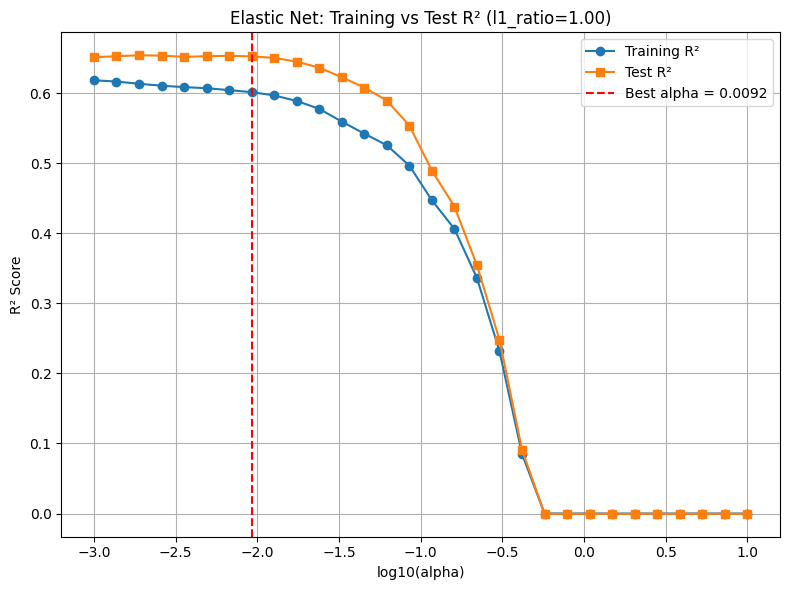


Test set performance:
- MAE:  0.39 L
- MSE:  0.24 L²
- RMSE: 0.49 L
- R²:   0.653

Training set performance:
- MAE:  0.44 L
- MSE:  0.31 L²
- RMSE: 0.56 L
- R²:   0.602

Model coefficients (sorted by |coef|):
                                              Feature  Coefficient
0                                                 Age    -0.567244
17                                           Sex_Male     0.522848
4           original_shape_MinorAxisLength_right_lung     0.159281
1            original_shape_MinorAxisLength_left_lung     0.116518
6               original_shape_SurfaceArea_right_lung     0.109694
12  log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGra...    -0.101225
3   log-sigma-2-0-mm-3D_firstorder_10Percentile_ri...     0.096925
7   original_gldm_LargeDependenceLowGrayLevelEmpha...     0.078310
15  log-sigma-1-0-mm-3D_firstorder_Skewness_left_lung    -0.070709
11  log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLeve...     0.066710
29                             Primary Diagnosis_UILD

/tmp/ipykernel_3189061/3075823424.py:154: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


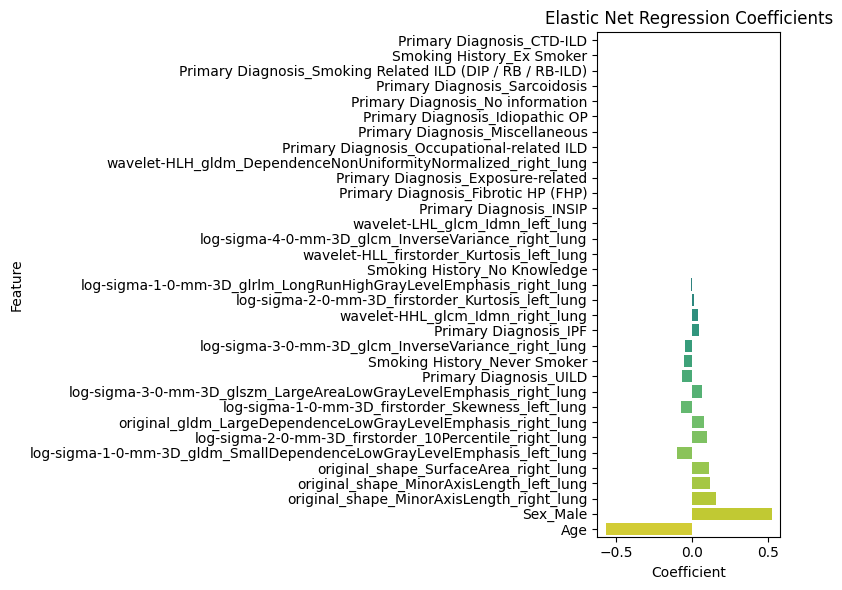

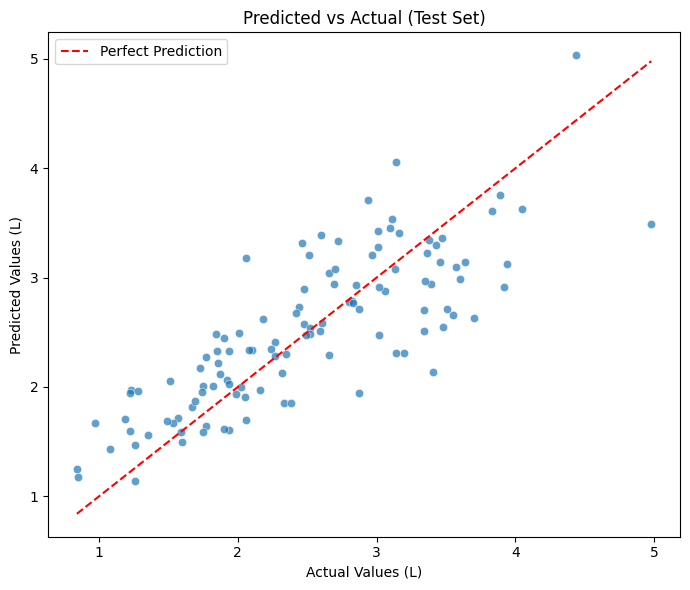

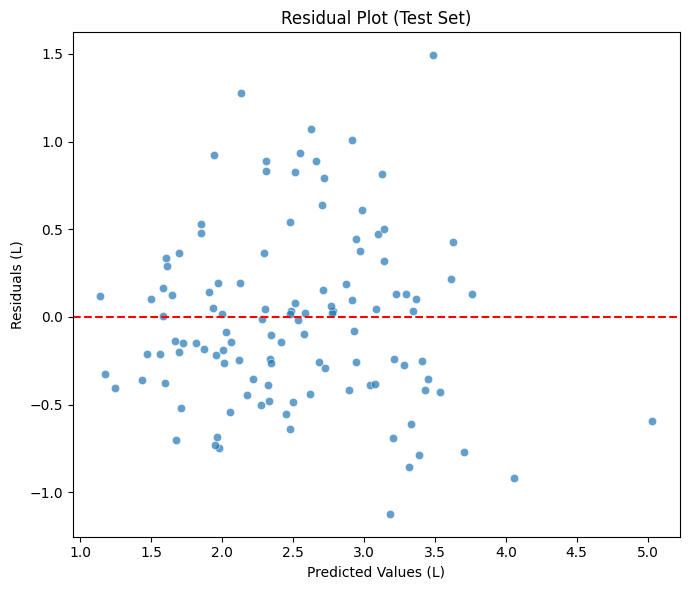


Top 5 patients with largest errors:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
1001336          5.09        4.98       3.487989   1.492011   
1001062          3.66        3.41       2.134922   1.275078   
1000636          2.47        2.06       3.181839   1.121839   
1001092          3.73        3.70       2.629187   1.070813   
1001223          3.46        3.92       2.912881   1.007119   

         Baseline_FVC_Week  Followup_FVC_Week  
1001336                0.0               52.0  
1001062                0.0               54.0  
1000636                0.0               48.0  
1001092                0.0               55.0  
1001223                0.0               48.0  


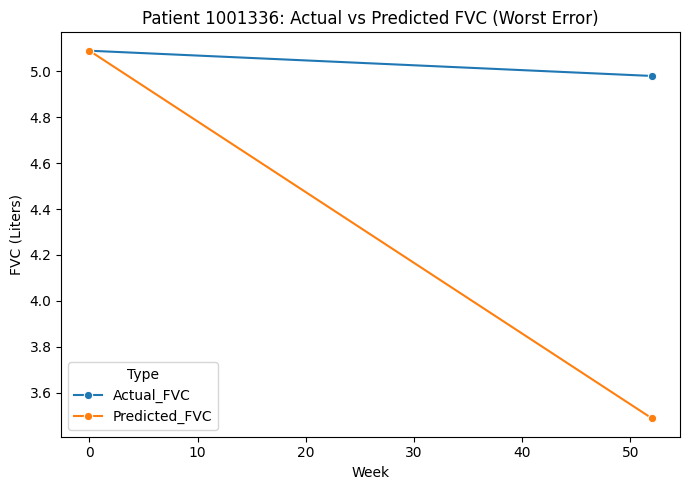

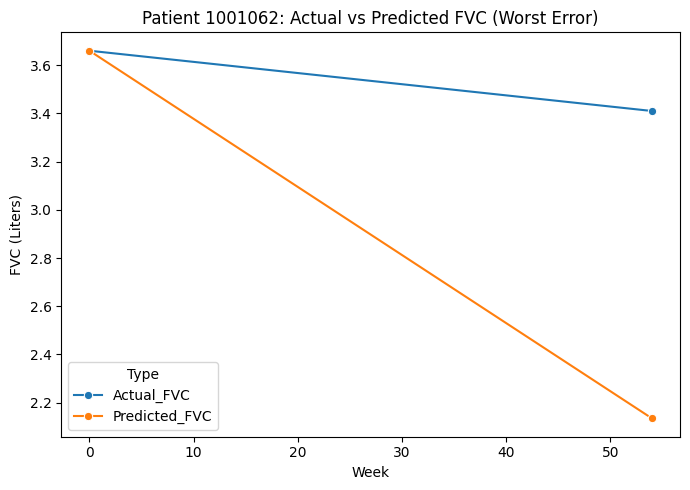

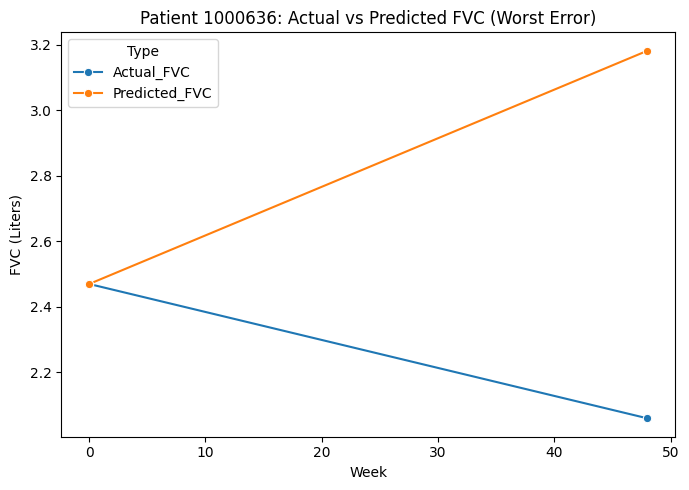

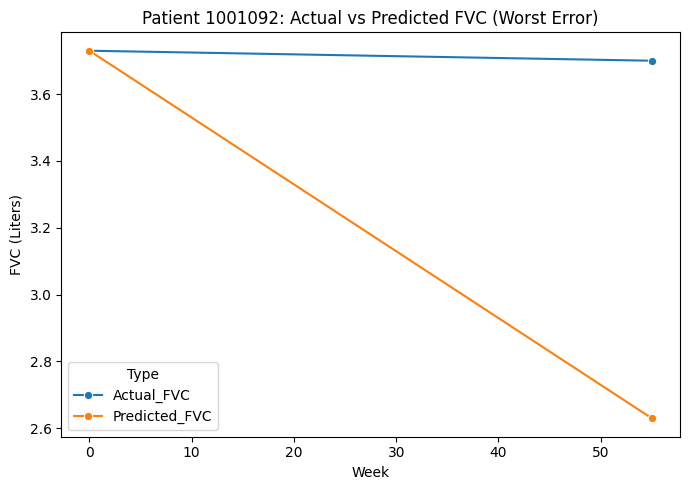

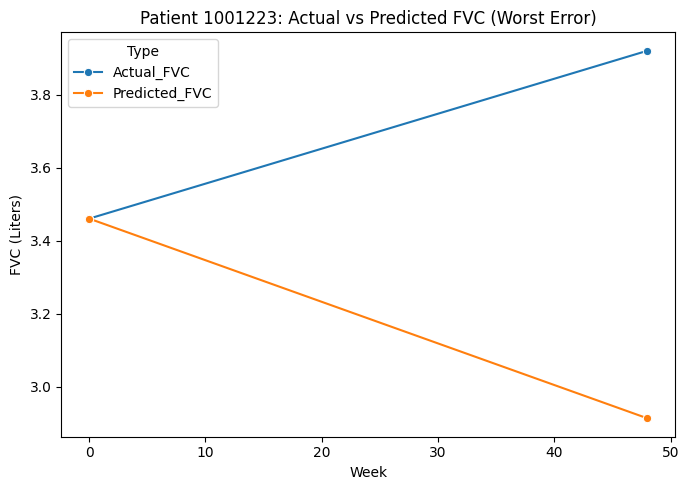


Top 5 patients with increasing FVC and lowest error:
         Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  \
492401           2.76        2.82       2.783581   0.036419   
192247           2.29        2.35       2.302440   0.047560   
241232           2.79        2.85       2.928158   0.078158   
191720           2.36        2.48       2.575899   0.095899   
1000821          1.08        1.60       1.500034   0.099966   

         Baseline_FVC_Week  Followup_FVC_Week  
492401                 0.0               55.0  
192247                 0.0               52.0  
241232                 0.0               49.0  
191720                 0.0               53.0  
1000821                0.0               52.0  


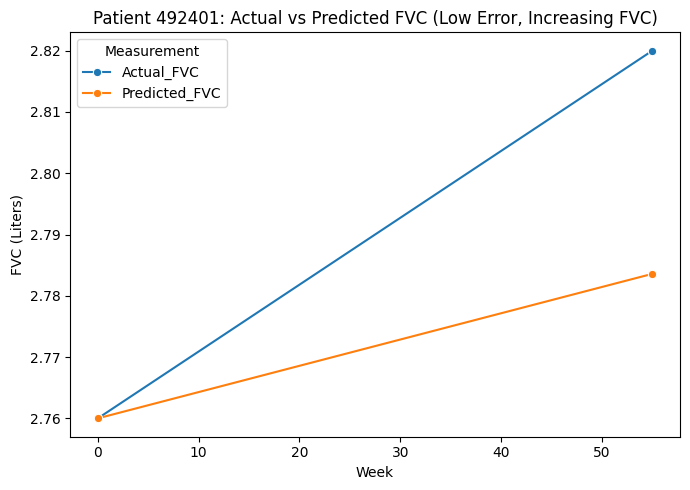

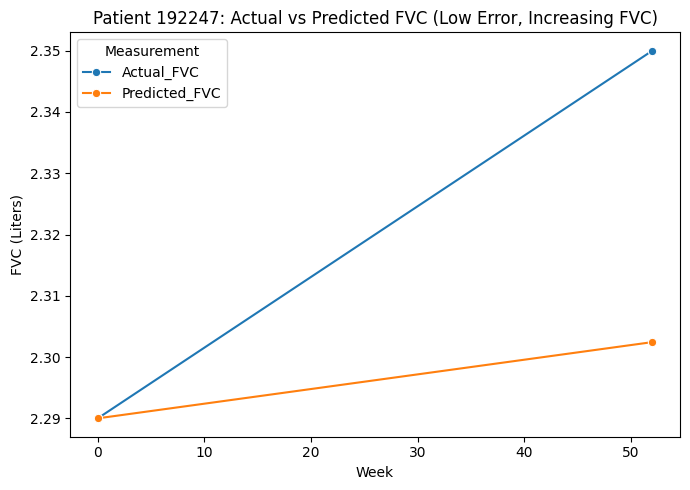

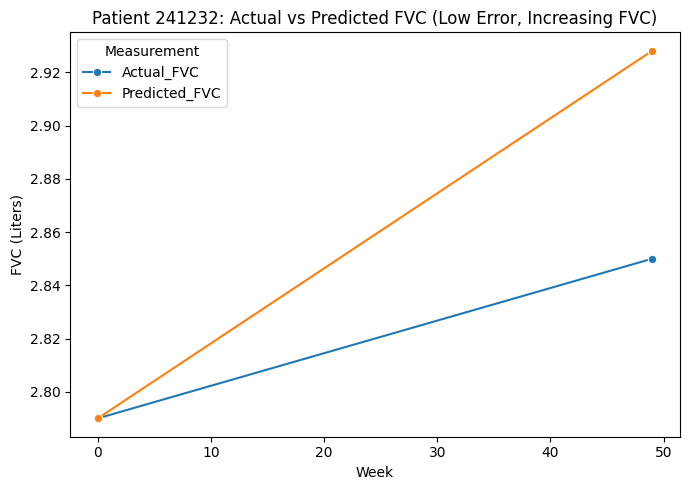

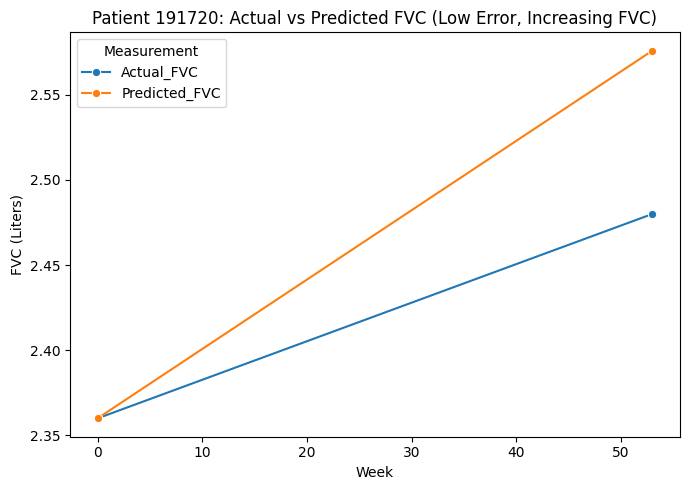

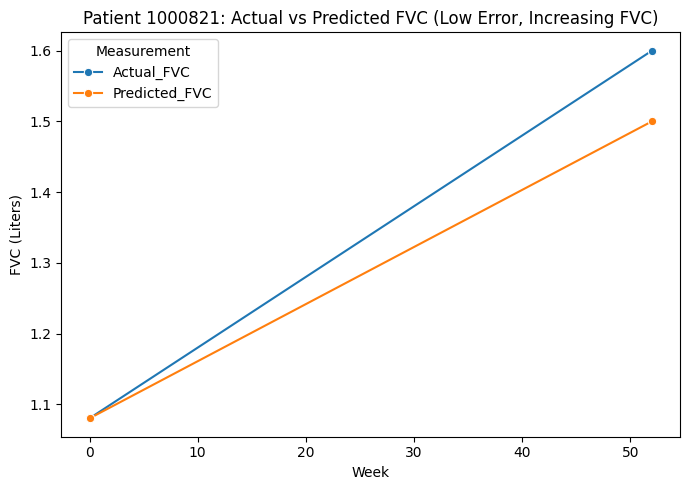

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


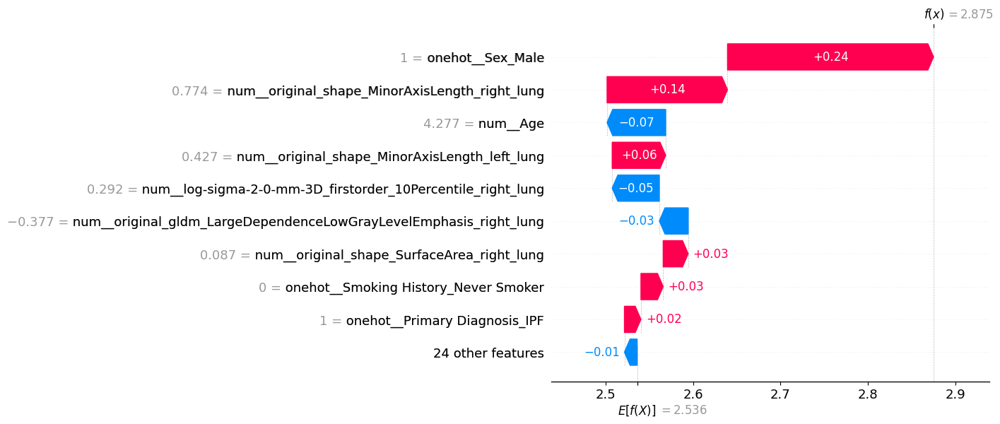

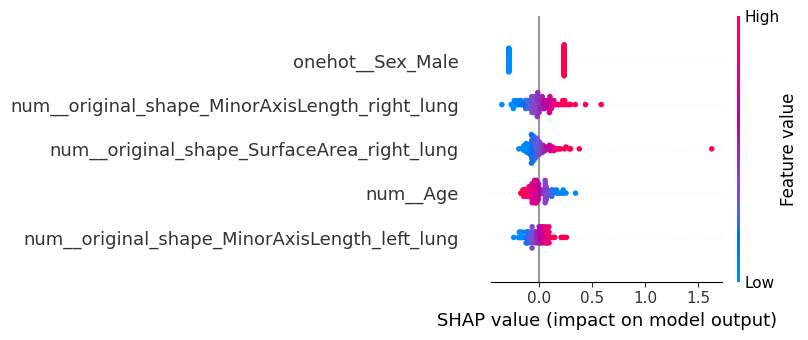

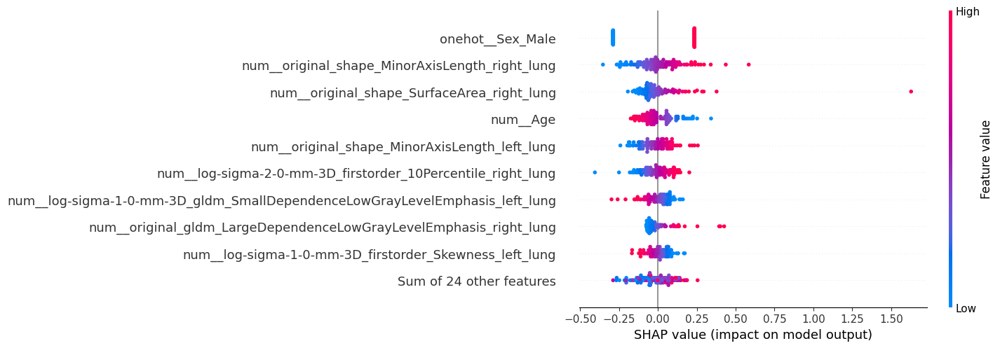

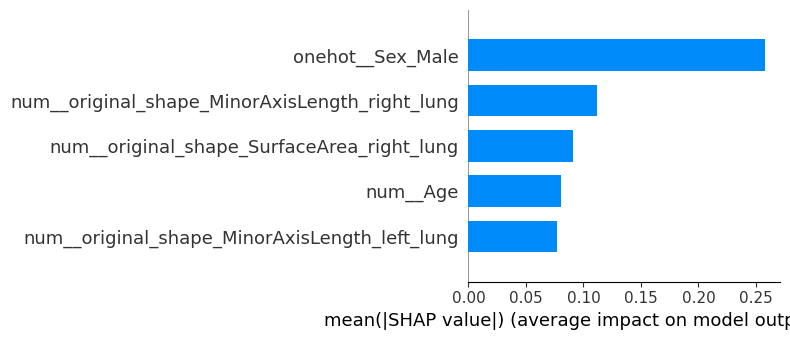

In [26]:
selected_features = ['original_shape_MinorAxisLength_left_lung', 'wavelet-HLH_gldm_DependenceNonUniformityNormalized_right_lung', 'log-sigma-2-0-mm-3D_firstorder_10Percentile_right_lung', 'original_shape_MinorAxisLength_right_lung', 'wavelet-HHL_glcm_Idmn_right_lung', 'original_shape_SurfaceArea_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'log-sigma-3-0-mm-3D_glcm_InverseVariance_right_lung', 'log-sigma-2-0-mm-3D_firstorder_Kurtosis_left_lung', 'log-sigma-1-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung', 'log-sigma-4-0-mm-3D_glcm_InverseVariance_right_lung', 'wavelet-LHL_glcm_Idmn_left_lung', 'log-sigma-1-0-mm-3D_firstorder_Skewness_left_lung', 'wavelet-HLL_firstorder_Kurtosis_left_lung']

Clinical_Contineous_data_ext = Clinical_Contineous_data + selected_features
print(Clinical_Contineous_data_ext)
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_with_clinical_harmonization.pkl")
X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)


# Run experiments
results1 = train_and_evaluate_elasticnet(X_train_median_filled, X_test_median_filled, y_train, y_test, selected_features, Clinical_Contineous_data_ext, Clinical_Categorical_data, model_name="/home/pansurya/OSIC_thesis/EN_model/Only_with_clinical_EN_with_harmonizationPycombat.pkl")
# print("Running LOOCV experiment...")
# results1 = train_and_evaluate_with_LOOCV(X_train, X_test, y_train, y_test, selected_features, model_name="/home/pansurya/OSIC_thesis/Linear_model/PAM_ANOVA_VIF_LOOCV.pkl")


Numeric features: 2635
Categorical features: 22


/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


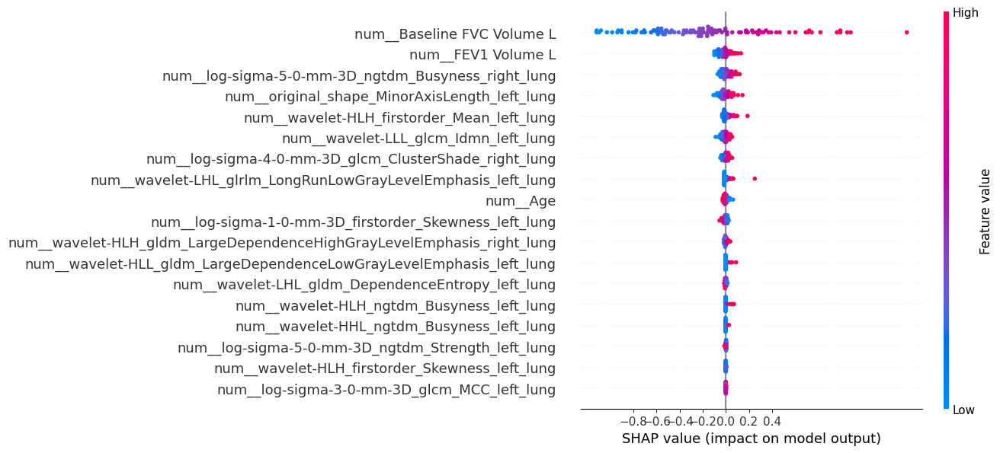

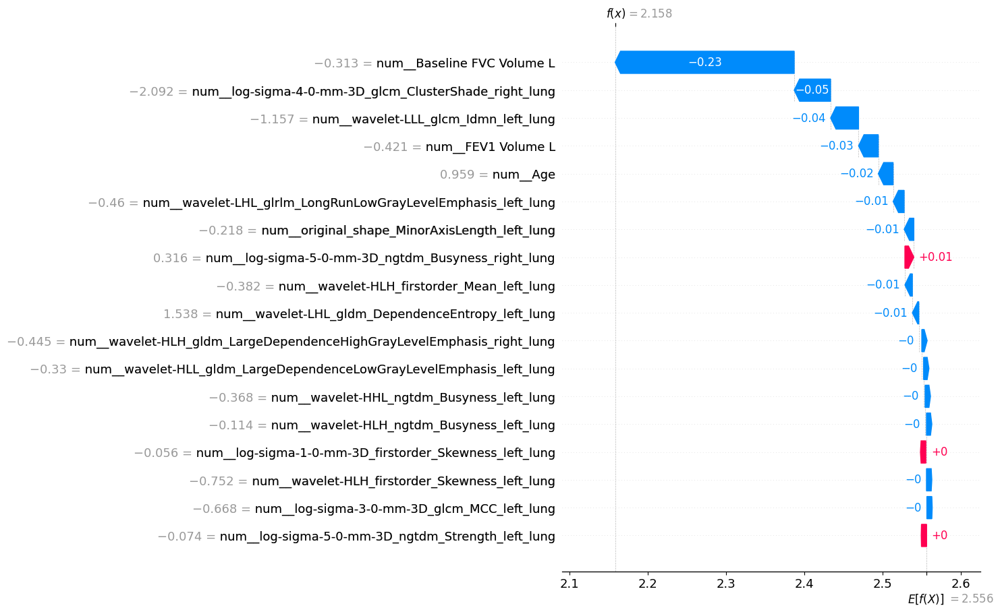

Generating Dependence Plots...


IndexError: too many indices for array

<Figure size 800x500 with 0 Axes>

In [ ]:
import joblib
import shap
import numpy as np
import matplotlib.pyplot as plt

# ---------------------------------------------------------
# ✅ Load model and data
# ---------------------------------------------------------
model = joblib.load("/home/pansurya/OSIC_thesis/EN_model/All_Clinical_RadiomicsData/EN_With_All_Clinical_Radiomics_without_harmonization1.pkl")
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_clinical_without_harmonization.pkl")
X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)
# Extract ColumnTransformer and ElasticNet model
preprocessor = model.named_steps["scaler"]
en_model = model.named_steps["elasticnet"]

# ---------------------------------------------------------
# ✅ Extract feature groups from ColumnTransformer
# ---------------------------------------------------------
numeric_features = preprocessor.transformers_[0][2]      # scaled
categorical_features = preprocessor.transformers_[1][2]  # passthrough
print("Numeric features:", len(numeric_features))
print("Categorical features:", len(categorical_features))

# Get full feature names in transformed order
feature_names = preprocessor.get_feature_names_out()

# ---------------------------------------------------------
# ✅ Apply the SAME transformation as during training
# ---------------------------------------------------------
X_train_transformed = preprocessor.transform(X_train_median_filled)
X_test_transformed = preprocessor.transform(X_test_median_filled)

# ---------------------------------------------------------
# ✅ Select features used by ElasticNet
# ---------------------------------------------------------
coef = en_model.coef_
selected_mask = coef != 0
selected_features = feature_names[selected_mask]

X_test_selected = X_test_transformed[:, selected_mask]

# ---------------------------------------------------------
# ✅ SHAP explainer
# ---------------------------------------------------------
explainer = shap.LinearExplainer(
    en_model,
    X_train_transformed,
    feature_perturbation="interventional"
)

shap_values = explainer.shap_values(X_test_transformed)
shap_values_selected = shap_values[:, selected_mask]

# ---------------------------------------------------------
# ✅ SHAP SUMMARY PLOT
# ---------------------------------------------------------
shap.summary_plot(
    shap_values_selected,
    X_test_selected,
    feature_names=selected_features,
    max_display=50,
    show=False
)

plt.gcf().set_size_inches(14, 6)
plt.xticks(np.arange(-0.8, 0.6, 0.2))
plt.axvline(x=0, color="gray", linestyle="--", linewidth=1)
plt.tight_layout()
plt.show()

# ---------------------------------------------------------
# ✅ SHAP WATERFALL PLOT FOR ONE PATIENT
# ---------------------------------------------------------
patient_index = 10

safe_shap_values = np.nan_to_num(shap_values_selected[patient_index])
safe_input_data = np.nan_to_num(X_test_selected[patient_index])
safe_base_value = np.nan_to_num(explainer.expected_value)

explanation = shap.Explanation(
    values=safe_shap_values,
    base_values=safe_base_value,
    data=safe_input_data,
    feature_names=selected_features
)

plt.gcf().set_size_inches(10, 8)
shap.plots.waterfall(explanation, max_display=20)


# ---------------------------------------------------------
# ✅ SHAP DEPENDENCE PLOTS
# ---------------------------------------------------------

# Function to find the exact column name in the transformed feature set
def get_col_name(substring, feature_list):
    return [name for name in feature_list if substring in name][0]

# Identify the specific feature names after transformation
fvc_col = get_col_name("Baseline FVC Volume L", selected_features)
minor_axis_col = get_col_name("original_shape_MinorAxisLength_left_lung", selected_features)

# 1. Dependence Plot for Baseline FVC
plt.figure()
shap.dependence_plot(
    fvc_col, 
    shap_values_selected, 
    X_test_selected, 
    feature_names=selected_features,
    interaction_index=None, # Set to None for a simple trend, or "auto" for interactions
    show=False
)
plt.title(f"SHAP Dependence: {fvc_col}")
plt.show()

# 2. Dependence Plot for Minor Axis Length (Left Lung)
plt.figure()
shap.dependence_plot(
    minor_axis_col, 
    shap_values_selected, 
    X_test_selected, 
    feature_names=selected_features,
    interaction_index=fvc_col, # Interaction with Baseline FVC often yields interesting insights
    show=False
)
plt.title(f"SHAP Dependence: {minor_axis_col}")
plt.show()

# # ---------------------------------------------------------
# # ✅ SHAP BAR PLOT (MEAN ABSOLUTE SHAP VALUES)
# # ---------------------------------------------------------
# explanation_all = shap.Explanation(
#     values=shap_values_selected,
#     base_values=explainer.expected_value,
#     data=X_test_selected,
#     feature_names=selected_features
# )

# plt.gcf().set_size_inches(10, 8)
# shap.plots.bar(explanation_all, max_display=20)


/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)
/home/pansurya/.venv/lib64/python3.9/site-packages/shap/plots/_beeswarm.py:1150: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


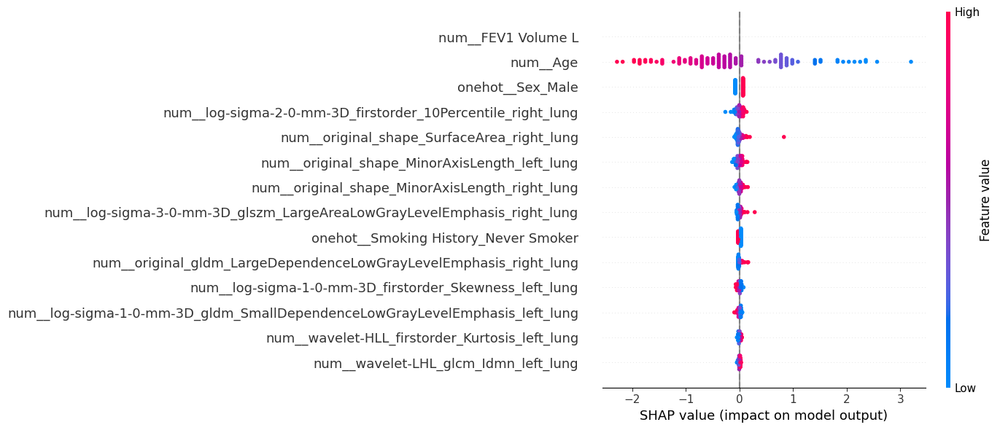

posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and posy should be finite values
posx and pos

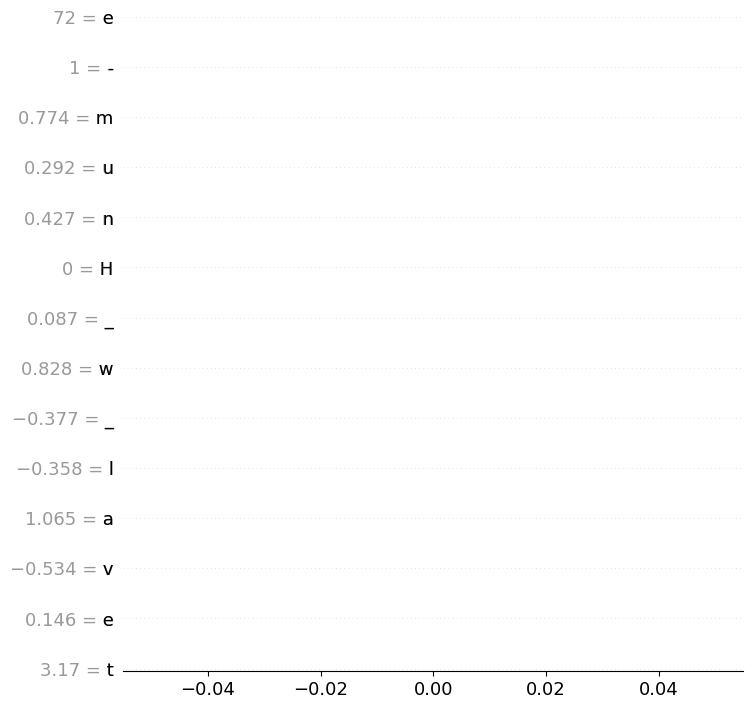

posx and posy should be finite values
posx and posy should be finite values


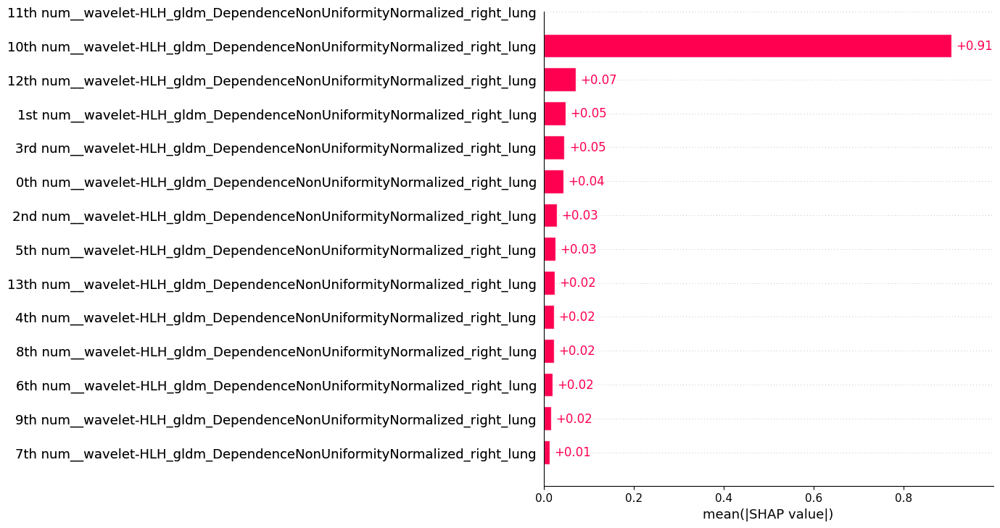

In [ ]:
import shap

model = joblib.load("/home/pansurya/OSIC_thesis/EN_model/Correlation_based_Using_mrmr_EN_with_harmonizationPycombat.pkl")
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_with_clinical_harmonization.pkl")

# Extract ColumnTransformer and ElasticNet model
preprocessor = model.named_steps["scaler"]
lasso_model = model.named_steps["elasticnet"]


# Transform data
X_train_scaled = preprocessor.transform(X_train)
X_test_scaled = preprocessor.transform(X_test)

# Get feature names
feature_names = preprocessor.get_feature_names_out()

# Create explainer
explainer = shap.LinearExplainer(lasso_model, X_train_scaled, feature_perturbation="interventional")

# First compute shap_values
raw_shap_values = explainer(X_test_scaled)

# Now wrap into Explanation object with feature names
shap_values = shap.Explanation(values=raw_shap_values.values,
                            base_values=raw_shap_values.base_values,
                            data=X_test_scaled,
                            feature_names=feature_names)

# Example: waterfall plot for one patient
patient_index = 0
shap.plots.waterfall(shap_values[patient_index])

# shap.summary_plot(shap_values, X_test_scaled, max_display=5)
shap.plots.beeswarm(shap_values)

shap.summary_plot(shap_values, X_test_scaled, plot_type="bar", max_display=5)

Without Harmonization

['wavelet-LLL_glszm_GrayLevelVariance_left_lung', 'original_shape_MinorAxisLength_left_lung', 'original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung', 'original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung', 'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung', 'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung', 'Baseline FVC Volume L', 'FEV1 Volume L', 'Age']
Numeric features: ['wavelet-LLL_glszm_GrayLevelVariance_left_lung', 'original_shape_MinorAxisLength_left_lung', 'original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung', 'original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung', 'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung', 'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung', 'Baseline FVC Volume L', 'FEV1 Volume L', 'Age']
One-hot features: ['Sex_Male', 'Primary Diagnosis_CTD-ILD', 'Primary Diagnosis_Exposure-related', 'Primary Diagnosis_Fibrotic HP (FHP)', 'Primary Diagnosis_INSIP', 'Primary Diagnosis_IPF

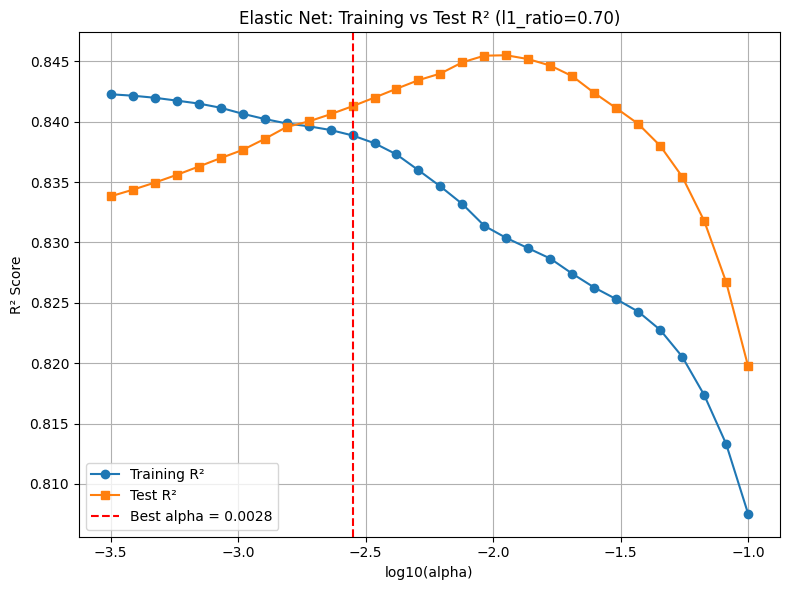

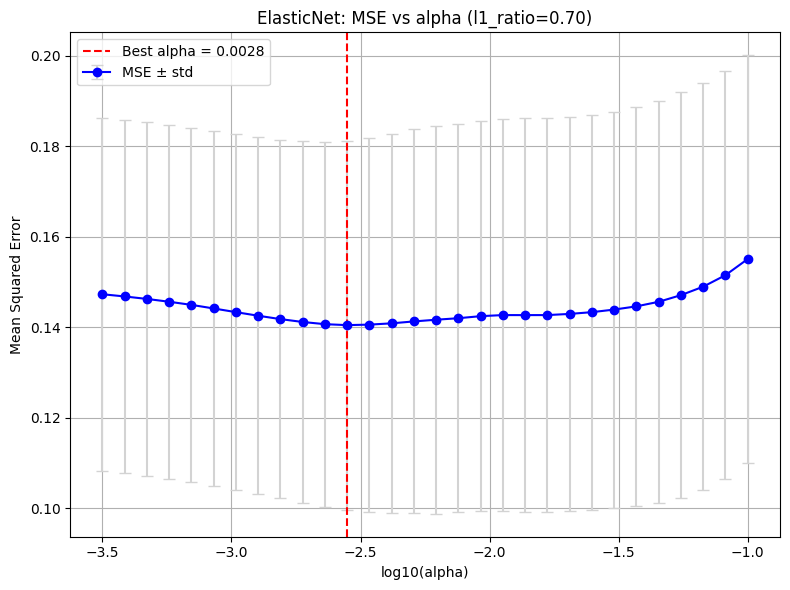


Computing MSE vs l1_ratio...


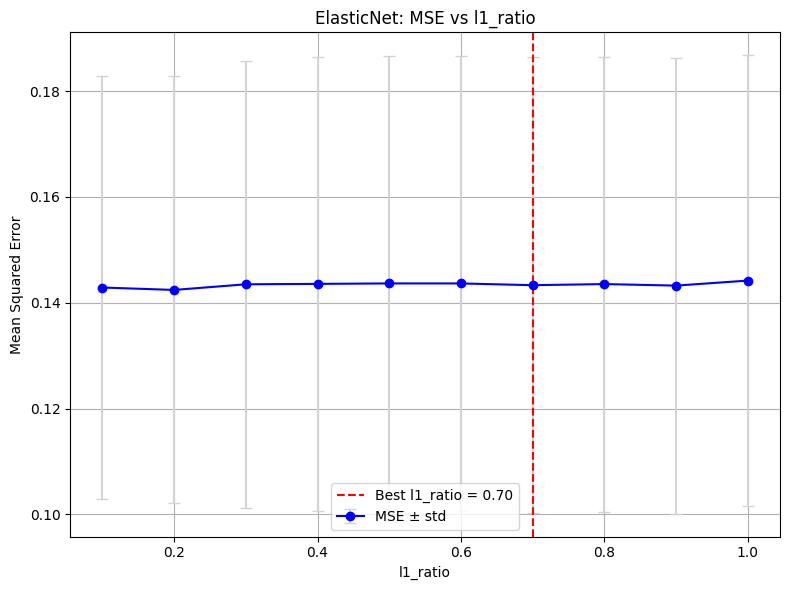


Model coefficients (sorted by |coef|):
                                              Feature  Coefficient
6                               Baseline FVC Volume L     0.705272
13                            Primary Diagnosis_INSIP     0.415042
11                 Primary Diagnosis_Exposure-related     0.113156
9                                            Sex_Male     0.097873
1            original_shape_MinorAxisLength_left_lung     0.072891
22                          Smoking History_Ex Smoker    -0.067584
8                                                 Age    -0.062935
23                       Smoking History_Never Smoker    -0.061874
10                          Primary Diagnosis_CTD-ILD     0.060928
5   log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGr...    -0.049854
3   original_glszm_LargeAreaLowGrayLevelEmphasis_l...     0.038439
2   original_gldm_SmallDependenceHighGrayLevelEmph...    -0.034347
0       wavelet-LLL_glszm_GrayLevelVariance_left_lung    -0.025609
4   log-sigma-3-0-mm-3

/tmp/ipykernel_4059943/2091552719.py:262: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


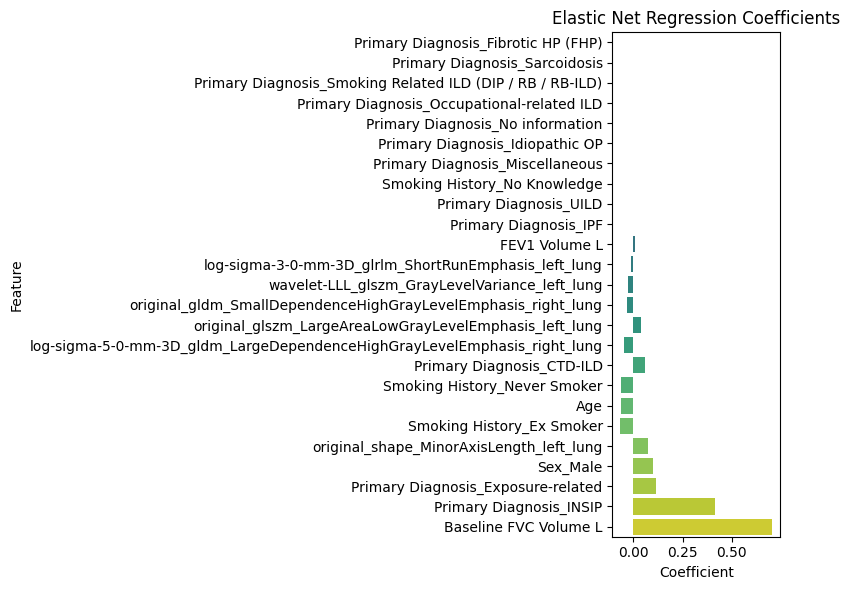

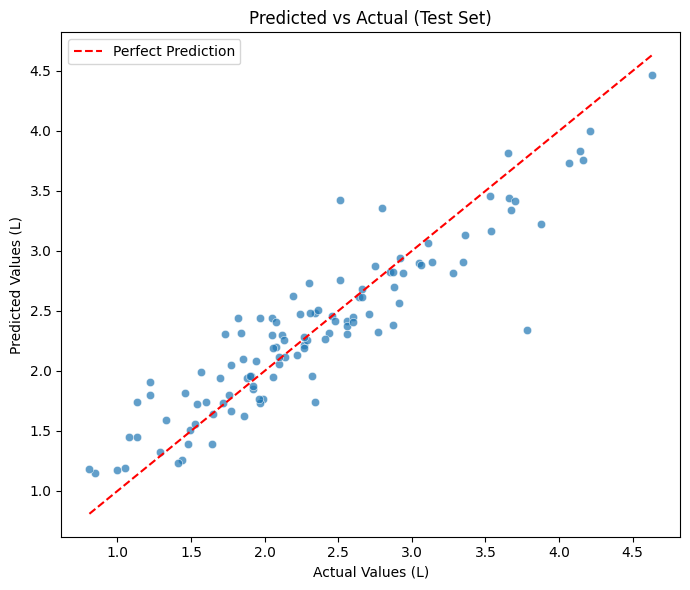

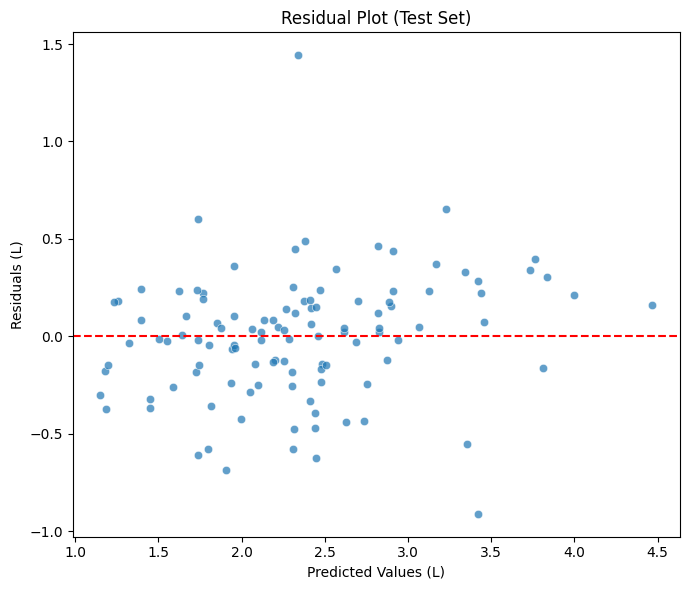


Top 5 patients with largest errors:
     Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  Baseline_FVC_Week  \
123          2.23        3.78       2.337695   1.442305                0.0   
152          3.63        2.51       3.420315   0.910315                0.0   
233          1.98        1.22       1.906973   0.686973                0.0   
81           3.59        3.88       3.227881   0.652119                0.0   
241          1.88        1.82       2.444494   0.624494                0.0   

     Followup_FVC_Week  
123               51.0  
152               53.0  
233               54.0  
81                52.0  
241               55.0  


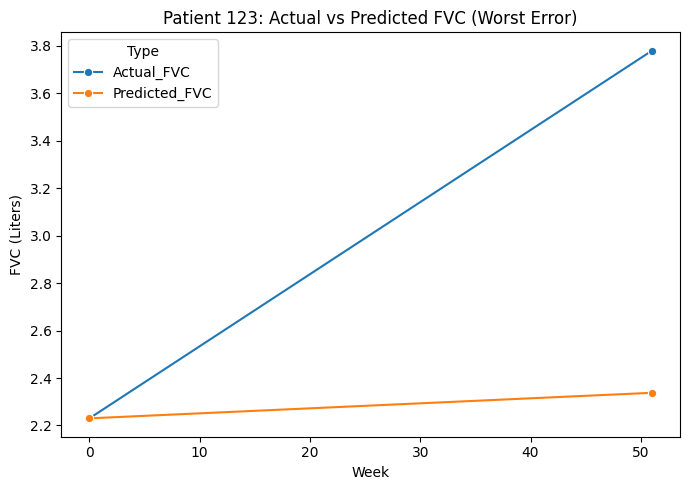

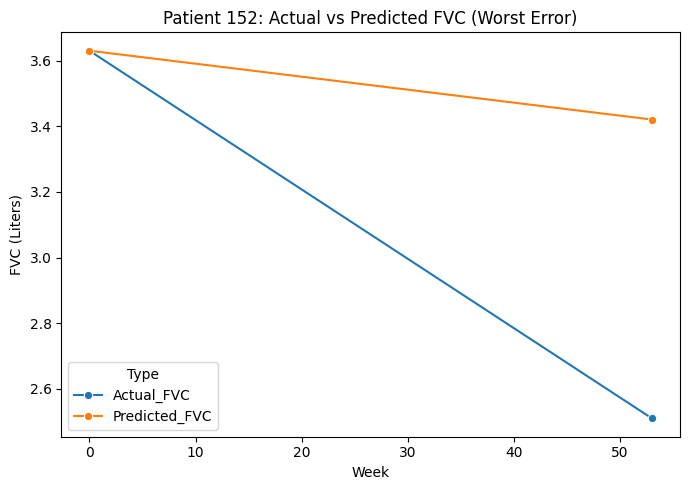

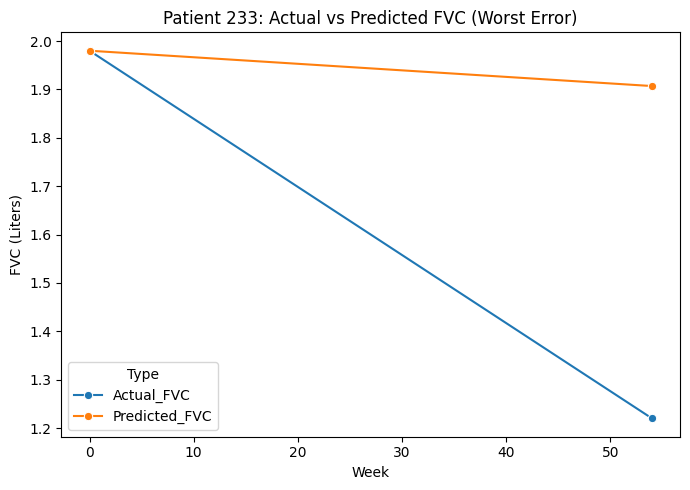

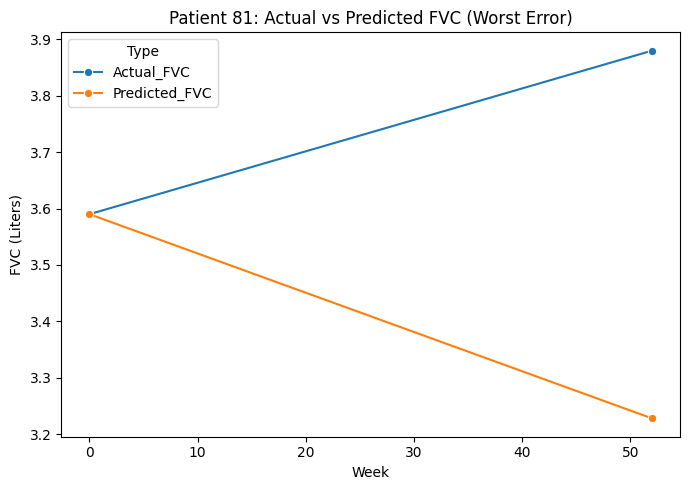

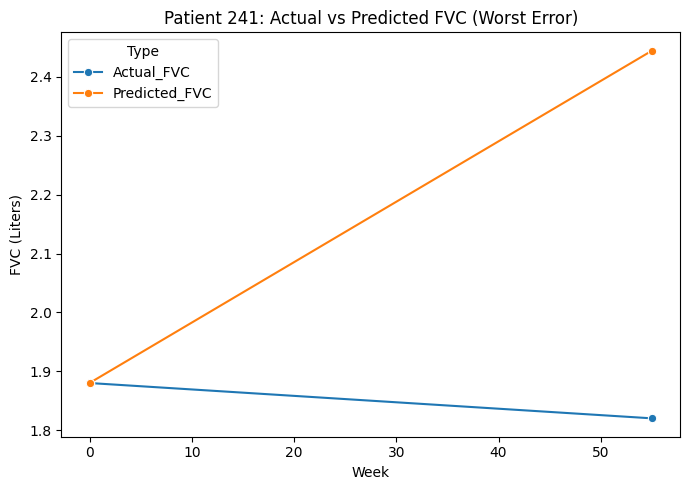


Top 5 patients with increasing FVC and lowest error:
     Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  Baseline_FVC_Week  \
100          2.35       2.460       2.459743   0.000257                0.0   
511          1.43       1.490       1.505484   0.015484                0.0   
426          1.66       1.720       1.736349   0.016349                0.0   
99           1.81       1.920       1.877877   0.042123                0.0   
453          2.87       2.871       2.828150   0.042850                0.0   

     Followup_FVC_Week  
100               53.0  
511               54.0  
426               52.0  
99                48.0  
453               55.0  


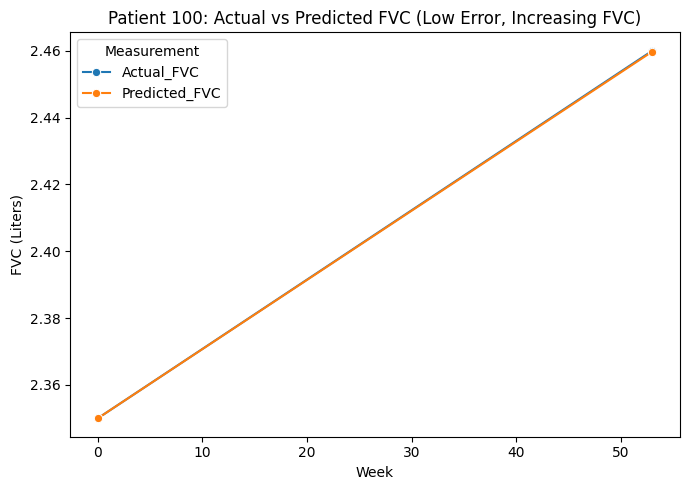

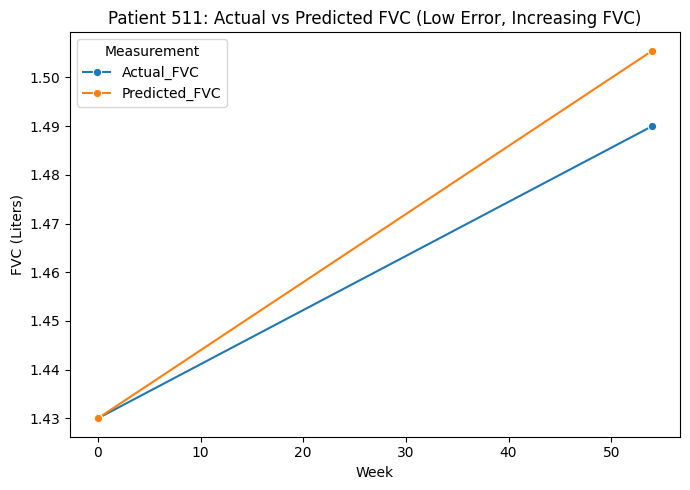

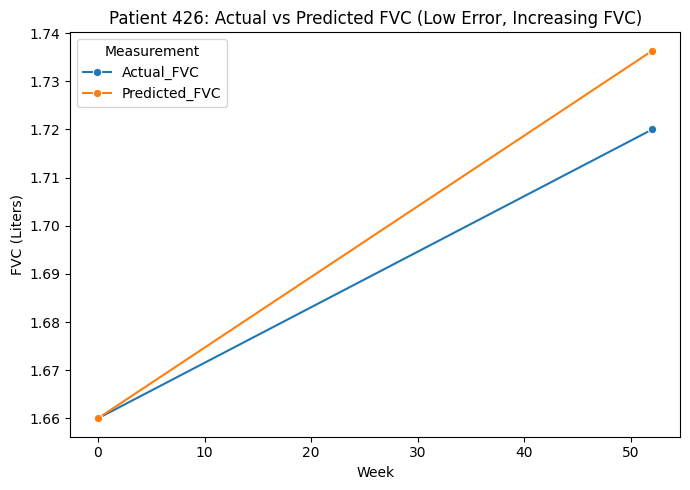

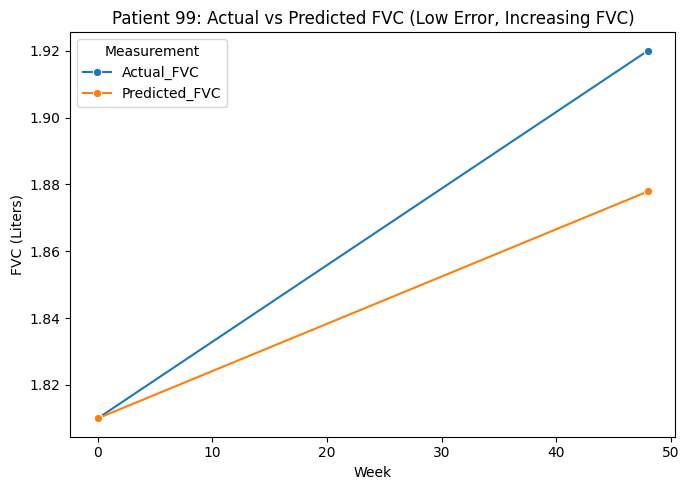

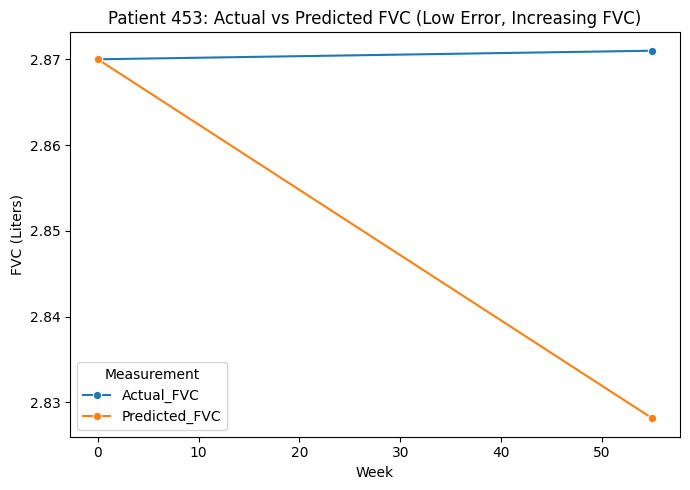

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


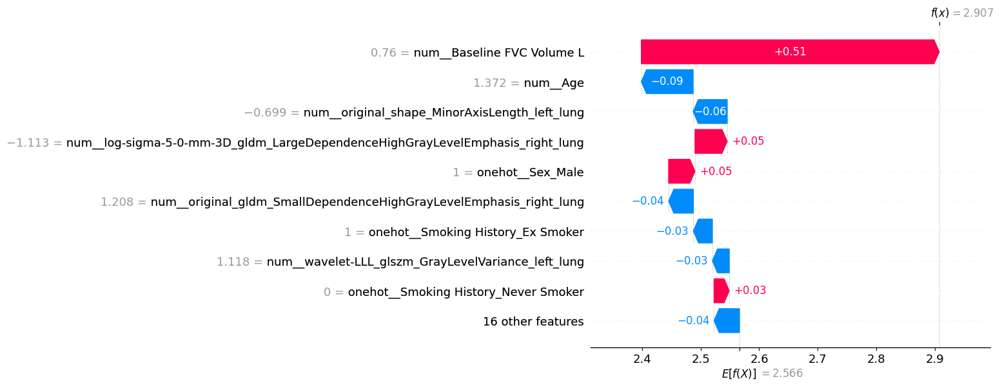

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/plots/_beeswarm.py:1150: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


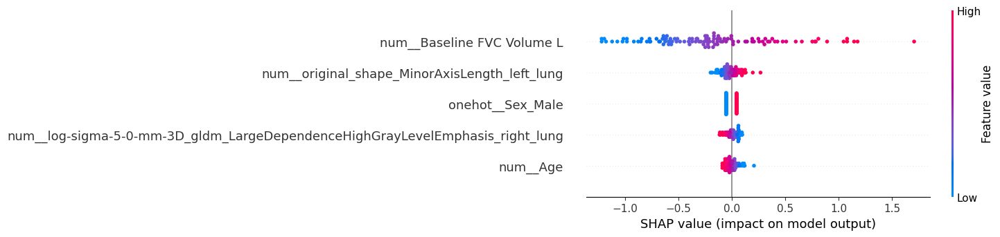

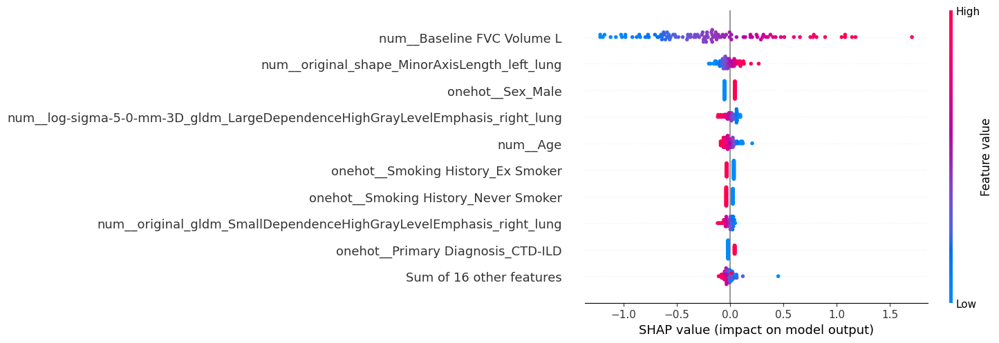

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/plots/_beeswarm.py:1150: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


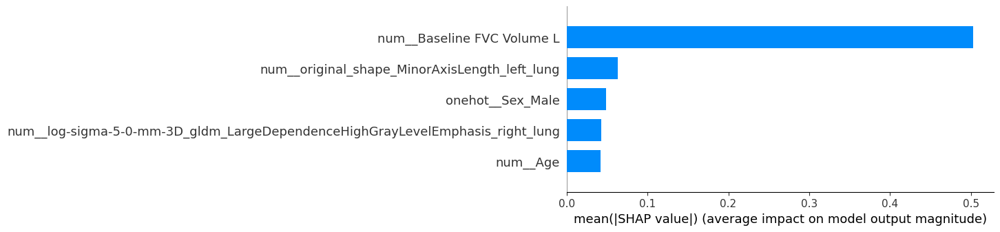

In [9]:
#Pipeline P1: PAM → Correlation with Target → mRMR → VIF
selected_features = ['wavelet-LLL_glszm_GrayLevelVariance_left_lung', 'original_shape_MinorAxisLength_left_lung', 'original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung', 'original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung', 'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung', 'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung']


Clinical_Contineous_data_ext = selected_features + Clinical_Contineous_data
print(Clinical_Contineous_data_ext)
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_clinical_without_harmonization.pkl")
X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)
# Run experiments
results1 = train_and_evaluate_elasticnet(X_train_median_filled, X_test_median_filled, y_train, y_test, selected_features, Clinical_Contineous_data_ext, Clinical_Categorical_data, 
                                         model_name="/home/pansurya/OSIC_thesis/EN_model/PAM_mrmr_VIF_EN_without_harmonization.pkl")


['original_firstorder_Kurtosis_right_lung', 'log-sigma-4-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_left_lung', 'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-LLL_glrlm_RunLengthNonUniformity_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Busyness_left_lung', 'log-sigma-1-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_right_lung', 'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung', 'log-sigma-3-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung', 'log-sigma-1-0-mm-3D_glrlm_GrayLevelNonUniformity_left_lung', 'original_firstorder_MeanAbsoluteDeviation_right_lung', 'wavelet-LHL_glrlm_GrayLevelNonUniformity_left_lung', 'log-sigma-4-0-mm-3D_glszm_GrayLevelNonUniformity_right_lung', 'log-sigma-2-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_left_lung', 'original_glrlm_GrayLevelNonUniformity_right_lung', 'original_firstorder_90Percentile_right_lung', 'log-sigma-5-0-mm-3D_firstorder_Energy_left_lung', 'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung

/tmp/ipykernel_987374/1313661345.py:215: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


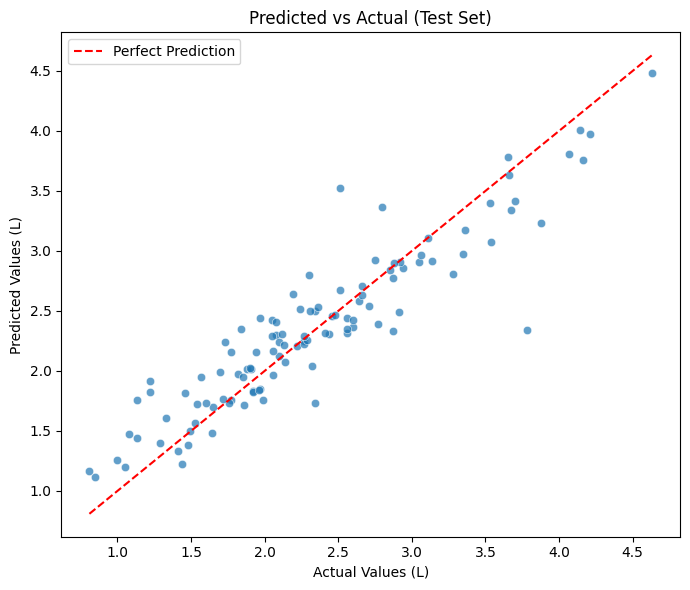

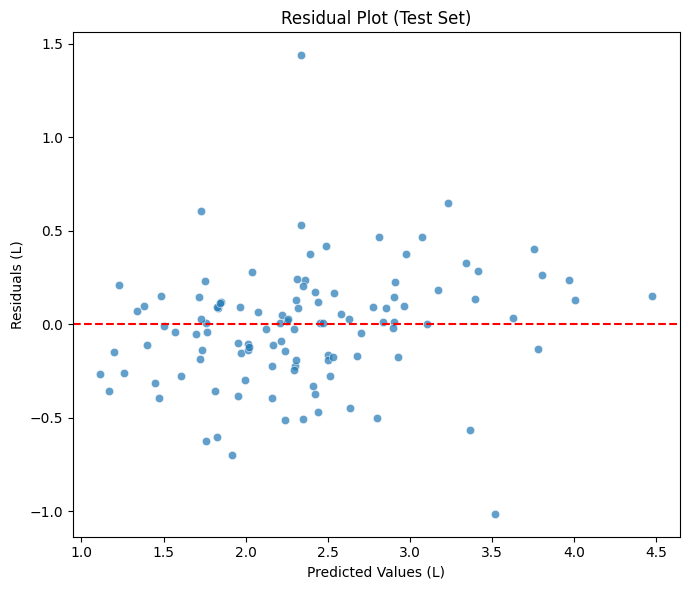


Top 5 patients with largest errors:
     Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  Baseline_FVC_Week  \
123          2.23        3.78       2.340797   1.439203                0.0   
152          3.63        2.51       3.522804   1.012804                0.0   
233          1.98        1.22       1.919986   0.699986                0.0   
81           3.59        3.88       3.232339   0.647661                0.0   
368          1.56        1.13       1.756068   0.626068                0.0   

     Followup_FVC_Week  
123               51.0  
152               53.0  
233               54.0  
81                52.0  
368               49.0  


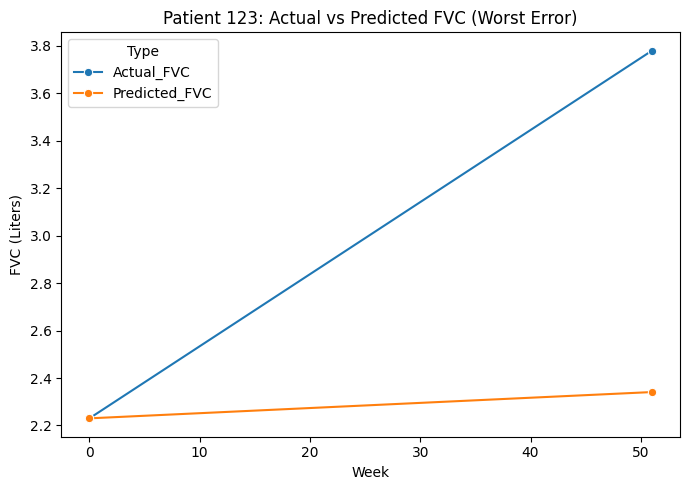

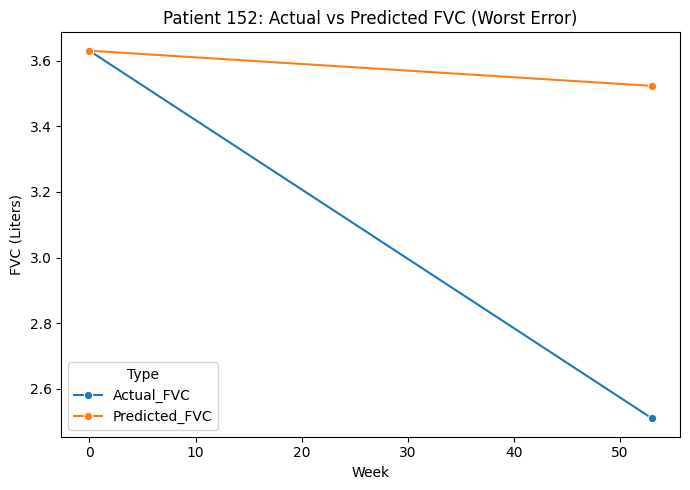

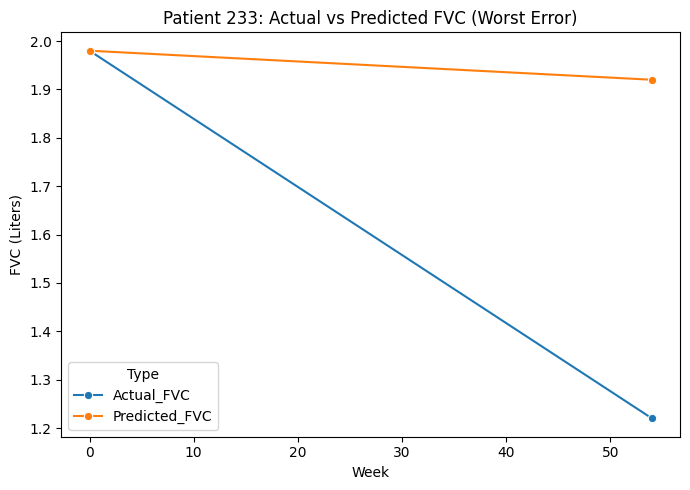

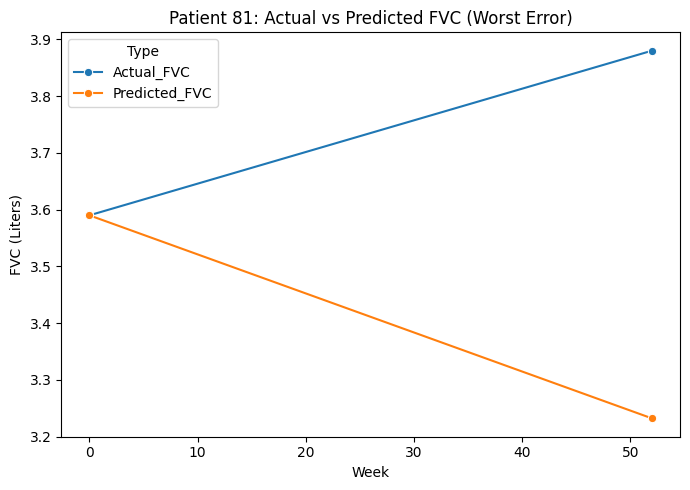

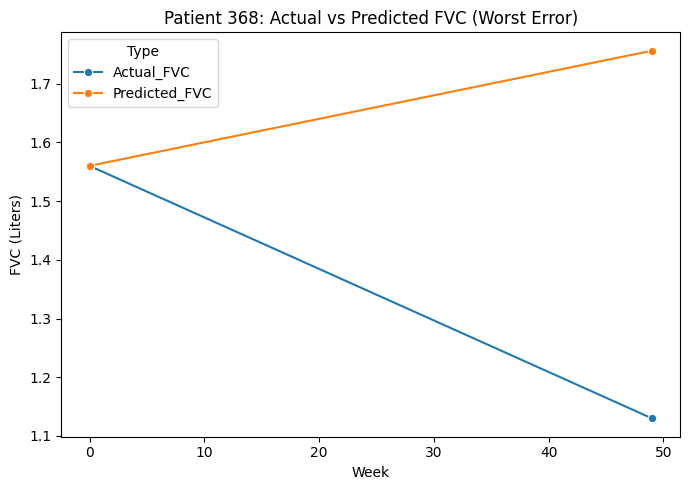


Top 5 patients with increasing FVC and lowest error:
     Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  Baseline_FVC_Week  \
229          3.02        3.11       3.105244   0.004756                0.0   
100          2.35        2.46       2.454952   0.005048                0.0   
511          1.43        1.49       1.500245   0.010245                0.0   
107          2.81        2.88       2.899963   0.019963                0.0   
514          2.65        2.66       2.631217   0.028783                0.0   

     Followup_FVC_Week  
229               52.0  
100               53.0  
511               54.0  
107               54.0  
514               52.0  


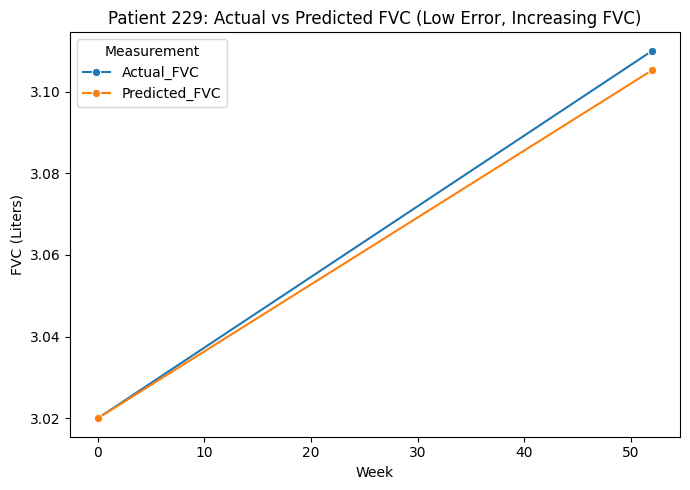

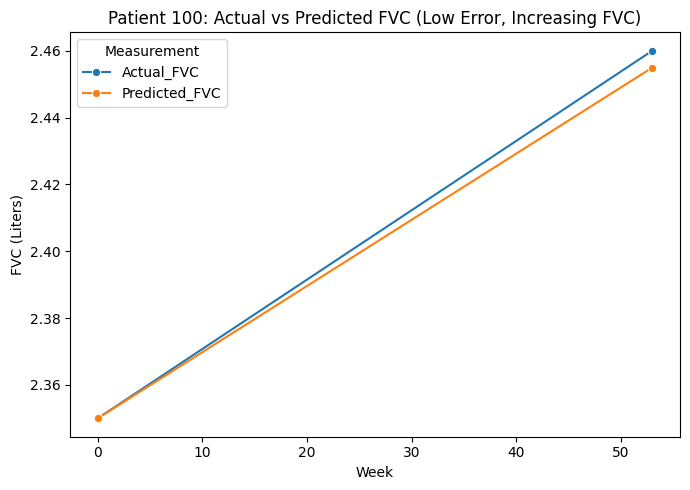

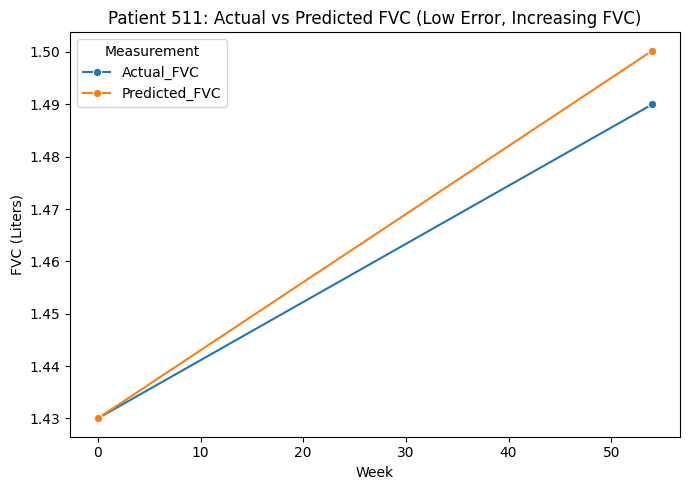

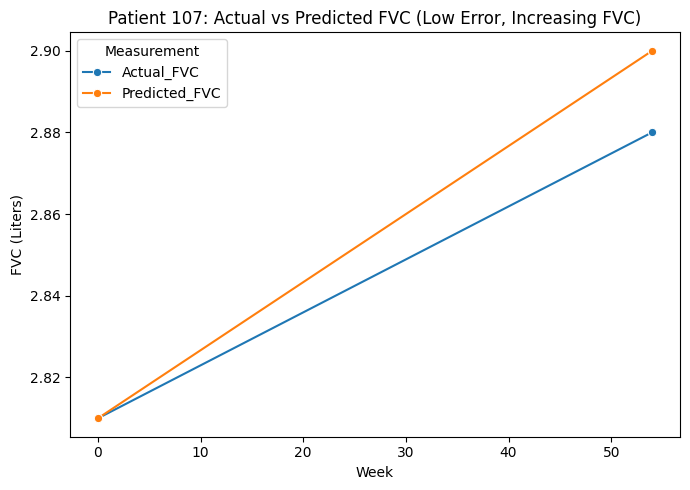

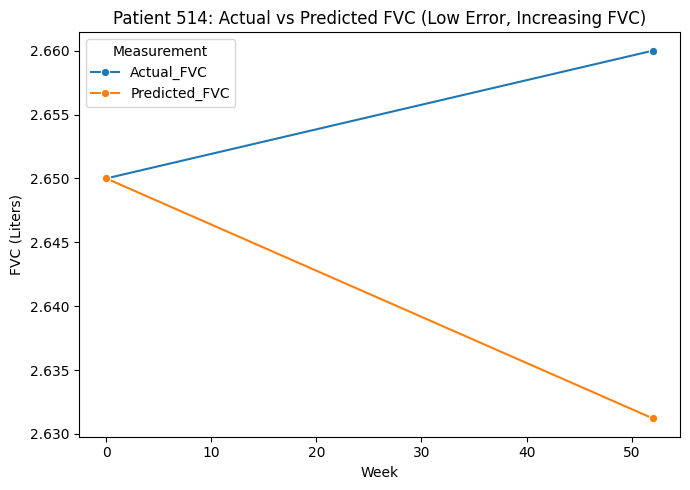

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


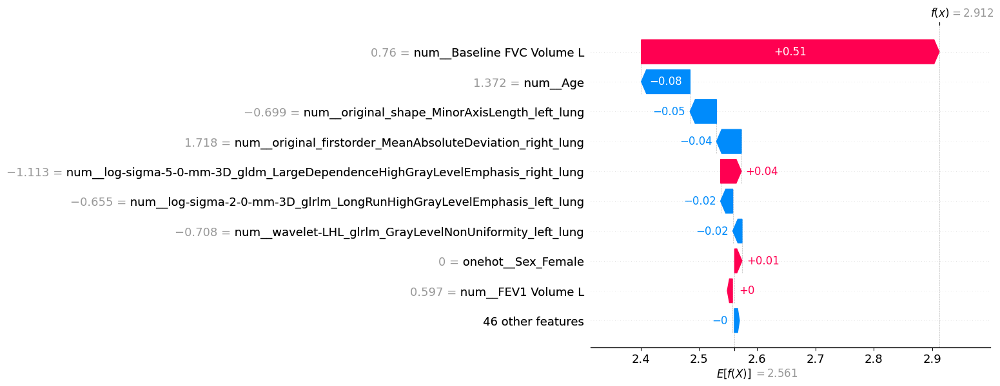

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/plots/_beeswarm.py:1150: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


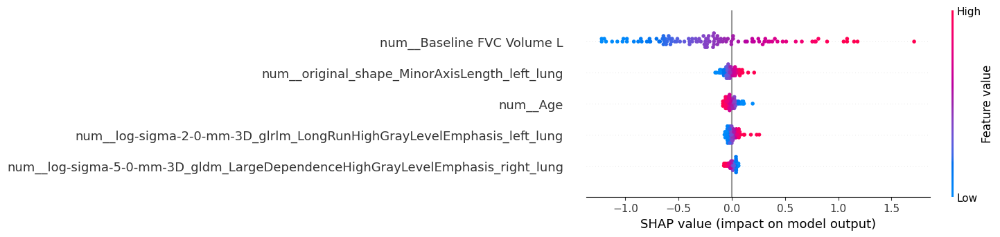

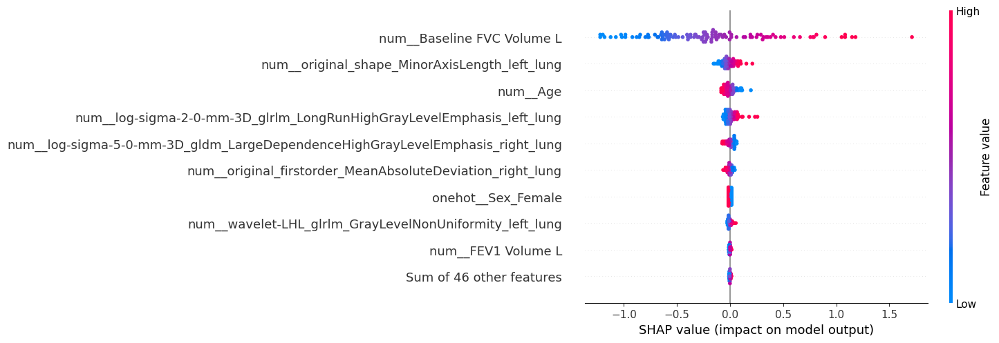

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/plots/_beeswarm.py:1150: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


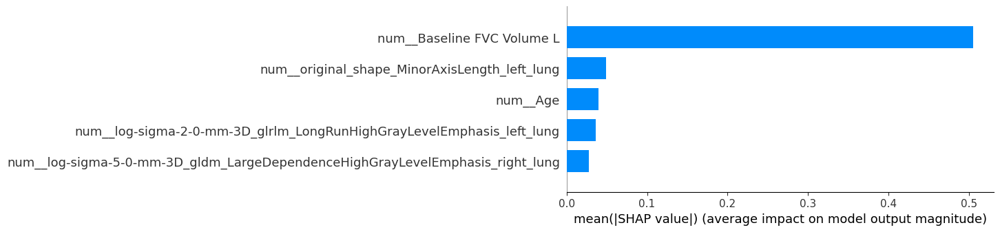

In [16]:
#tested, not good method
selected_features = ['original_firstorder_Kurtosis_right_lung',
       'log-sigma-4-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_left_lung',
       'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung',
       'wavelet-LLL_glrlm_RunLengthNonUniformity_right_lung',
       'log-sigma-2-0-mm-3D_ngtdm_Busyness_left_lung',
       'log-sigma-1-0-mm-3D_glszm_LargeAreaHighGrayLevelEmphasis_right_lung',
       'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung',
       'log-sigma-3-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung',
       'log-sigma-1-0-mm-3D_glrlm_GrayLevelNonUniformity_left_lung',
       'original_firstorder_MeanAbsoluteDeviation_right_lung',
       'wavelet-LHL_glrlm_GrayLevelNonUniformity_left_lung',
       'log-sigma-4-0-mm-3D_glszm_GrayLevelNonUniformity_right_lung',
       'log-sigma-2-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_left_lung',
       'original_glrlm_GrayLevelNonUniformity_right_lung',
       'original_firstorder_90Percentile_right_lung',
       'log-sigma-5-0-mm-3D_firstorder_Energy_left_lung',
       'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_right_lung',
       'log-sigma-2-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung',
       'log-sigma-3-0-mm-3D_glrlm_RunPercentage_left_lung',
       'wavelet-LLL_firstorder_90Percentile_left_lung',
       'wavelet-HLL_glrlm_RunLengthNonUniformity_right_lung',
       'log-sigma-1-0-mm-3D_glszm_ZoneVariance_left_lung',
       'original_shape_MinorAxisLength_left_lung',
       'log-sigma-2-0-mm-3D_ngtdm_Busyness_right_lung',
       'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung',
       'original_gldm_SmallDependenceHighGrayLevelEmphasis_right_lung',
       'original_glszm_LargeAreaLowGrayLevelEmphasis_left_lung',
       'log-sigma-4-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung',
       'log-sigma-3-0-mm-3D_glszm_ZoneVariance_right_lung',
       'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung']
Clinical_Contineous_data_ext = selected_features + Clinical_Contineous_data
print(Clinical_Contineous_data_ext)
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_clinical_without_harmonization.pkl")
X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)


# Run experiments
results1 = train_and_evaluate_elasticnet(X_train_median_filled, X_test_median_filled, y_train, y_test, selected_features, Clinical_Contineous_data_ext, Clinical_Categorical_data, 
                                         model_name="/home/pansurya/OSIC_thesis/EN_model/PAM_ANOVA_VIF_EN_without_harmonization.pkl")


['original_shape_MinorAxisLength_right_lung', 'original_shape_SurfaceArea_left_lung', 'wavelet-LLL_ngtdm_Contrast_right_lung', 'original_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'wavelet-HLL_firstorder_Skewness_right_lung', 'wavelet-HHL_glszm_LargeAreaHighGrayLevelEmphasis_right_lung', 'original_shape_MinorAxisLength_left_lung', 'log-sigma-1-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung', 'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung', 'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung', 'Baseline FVC Volume L', 'FEV1 Volume L', 'Age']
Numeric features: ['original_shape_MinorAxisLength_right_lung', 'original_shape_SurfaceArea_left_lung', 'wavelet-LLL_ngtdm_Contrast_right_lung', 'original_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'wavelet-HLL_firstorder_Skewness_right_lung', 'wavelet-HHL_glszm_LargeArea

/tmp/ipykernel_987374/1313661345.py:215: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


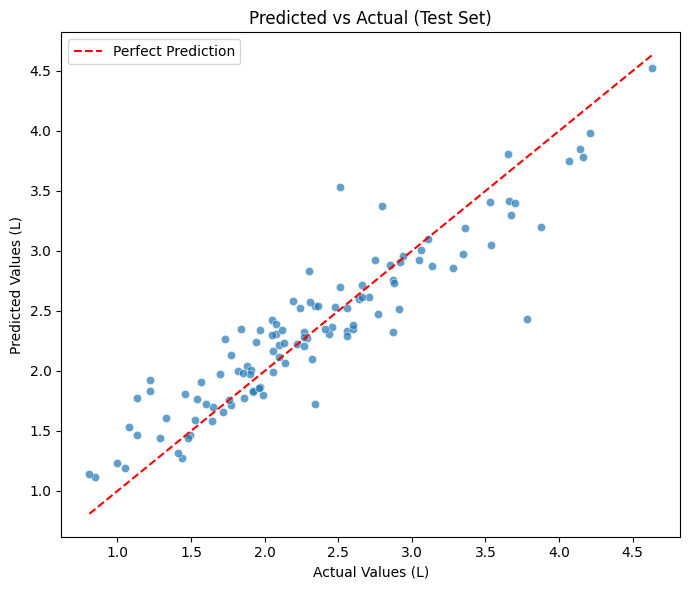

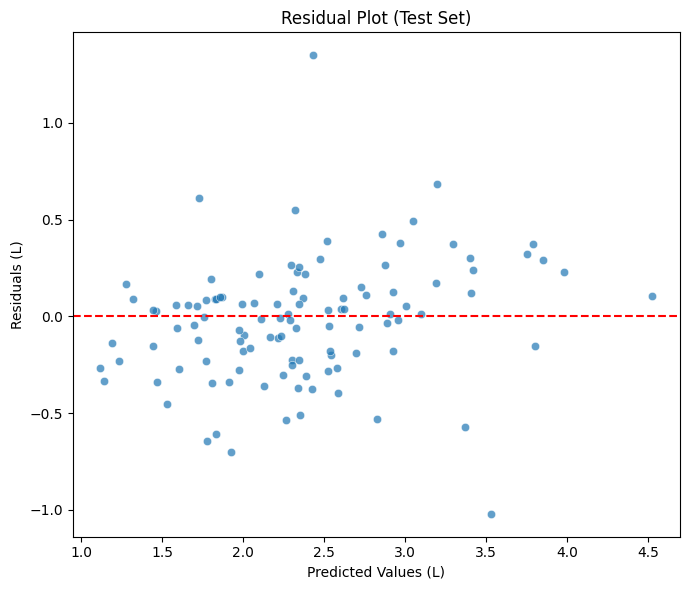


Top 5 patients with largest errors:
     Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  Baseline_FVC_Week  \
123          2.23        3.78       2.430256   1.349744                0.0   
152          3.63        2.51       3.530657   1.020657                0.0   
233          1.98        1.22       1.922249   0.702249                0.0   
81           3.59        3.88       3.196998   0.683002                0.0   
368          1.56        1.13       1.774158   0.644158                0.0   

     Followup_FVC_Week  
123               51.0  
152               53.0  
233               54.0  
81                52.0  
368               49.0  


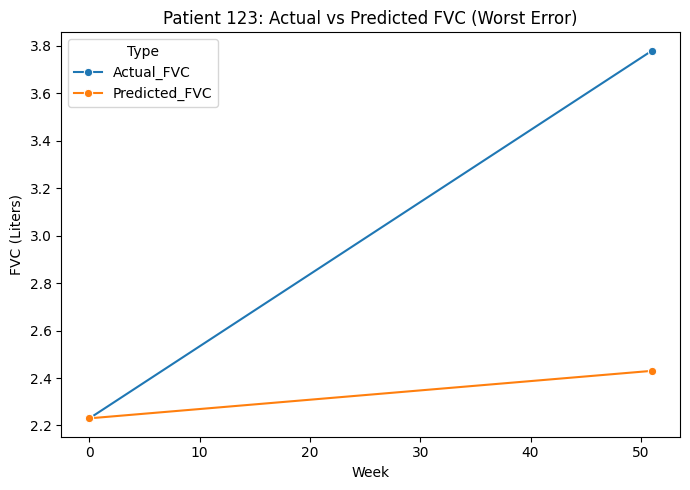

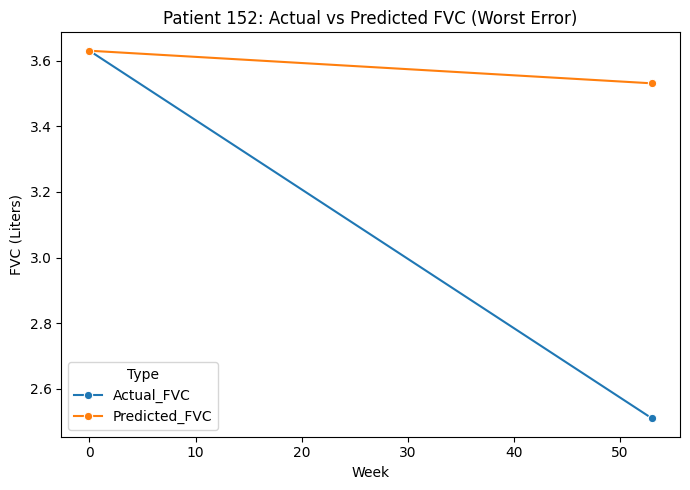

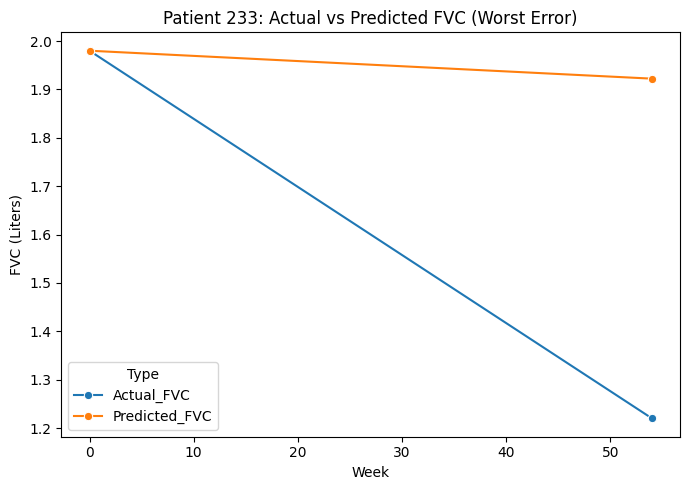

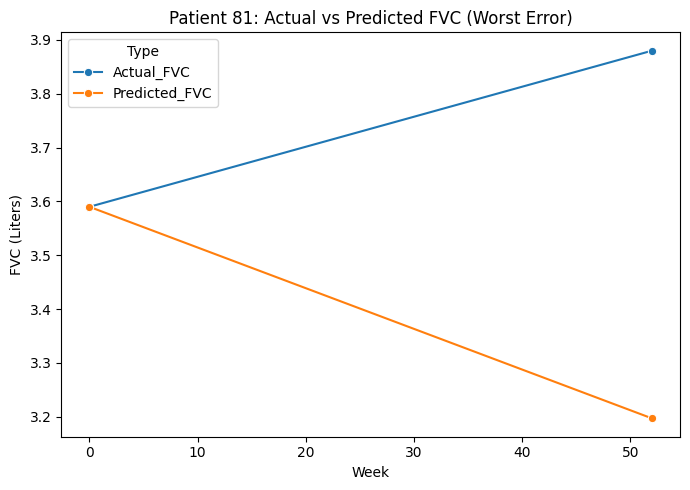

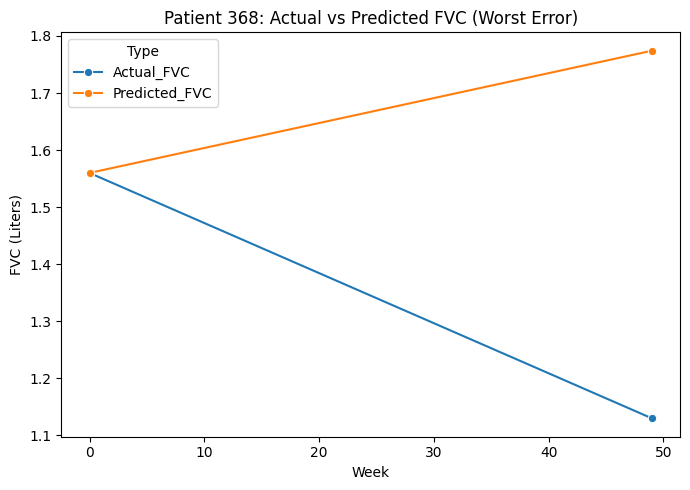


Top 5 patients with increasing FVC and lowest error:
     Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  Baseline_FVC_Week  \
229          3.02        3.11       3.095669   0.014331                0.0   
511          1.43        1.49       1.463031   0.026969                0.0   
114          2.47        2.56       2.526192   0.033808                0.0   
535          1.43        1.48       1.444965   0.035035                0.0   
514          2.65        2.66       2.619866   0.040134                0.0   

     Followup_FVC_Week  
229               52.0  
511               54.0  
114               51.0  
535               55.0  
514               52.0  


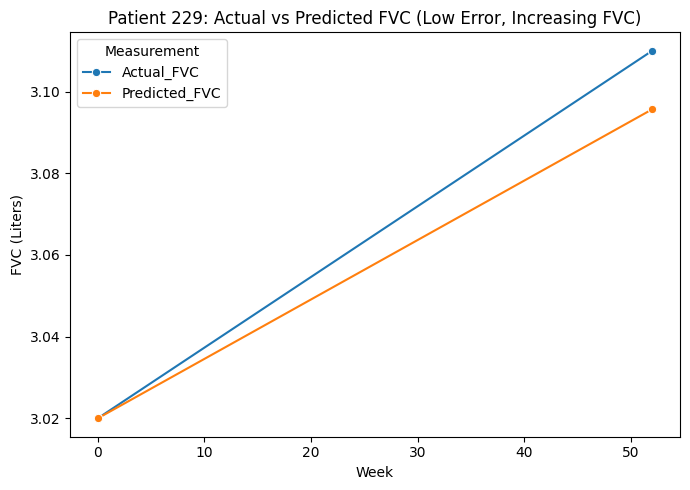

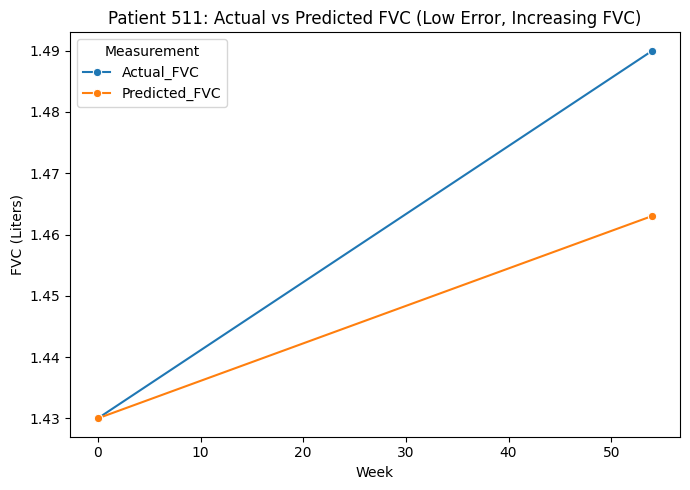

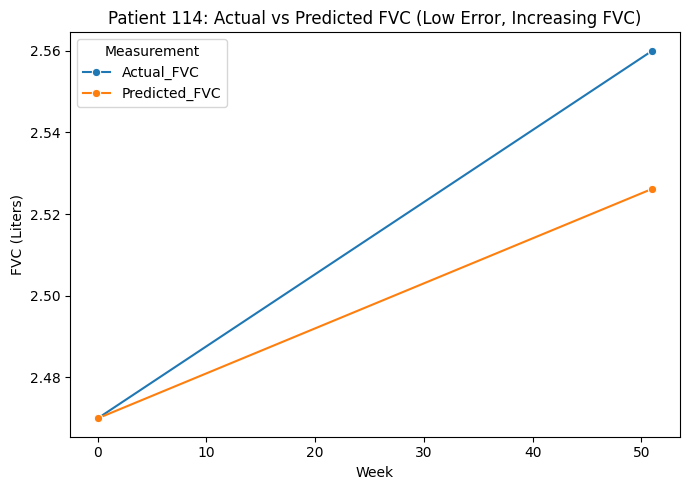

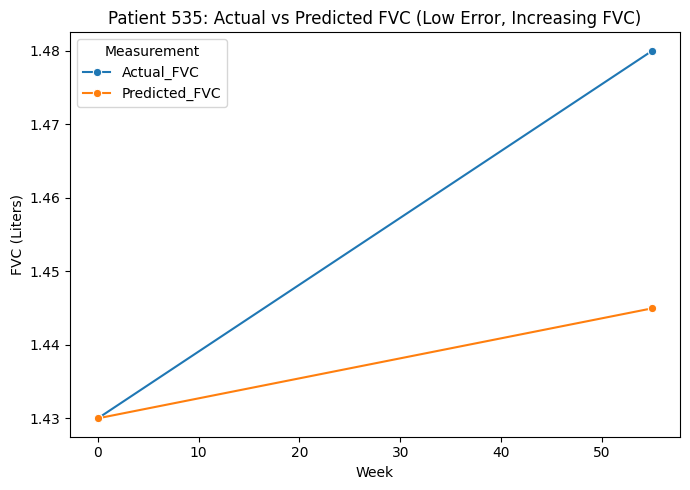

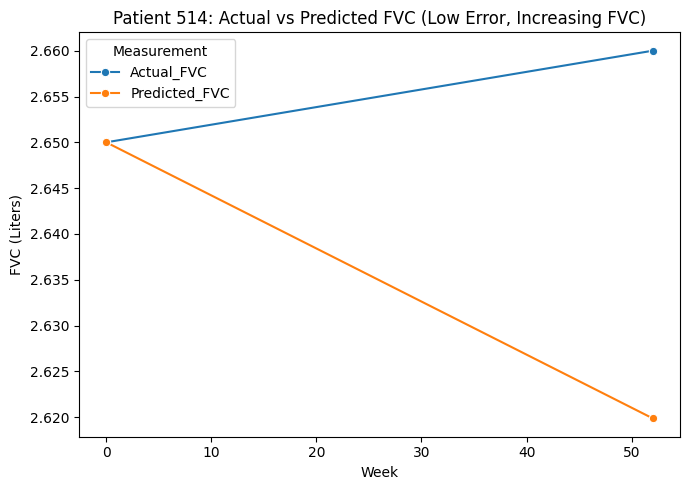

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


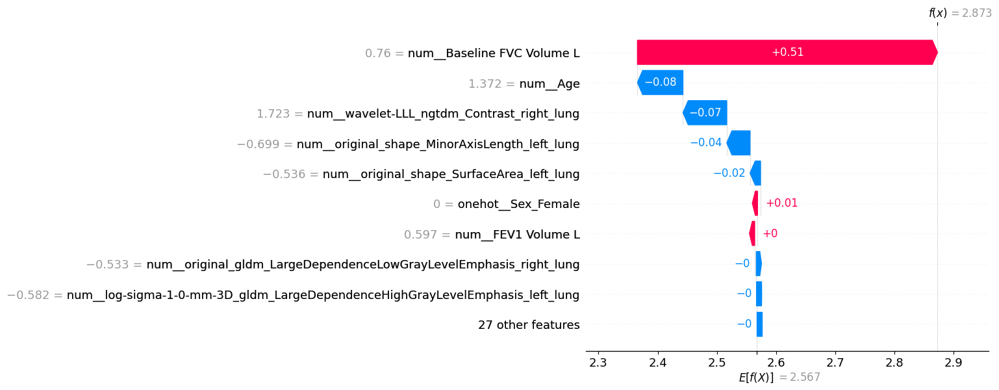

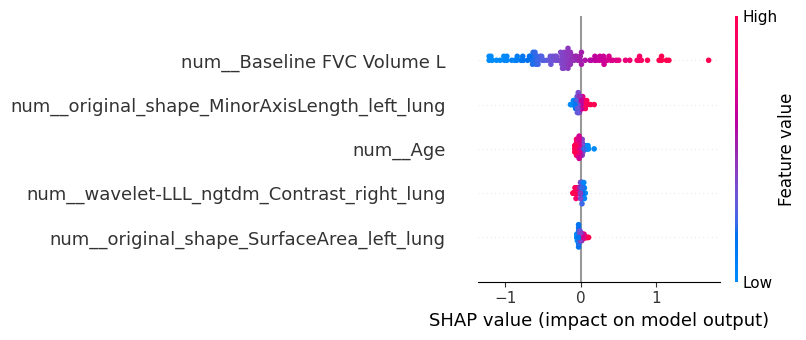

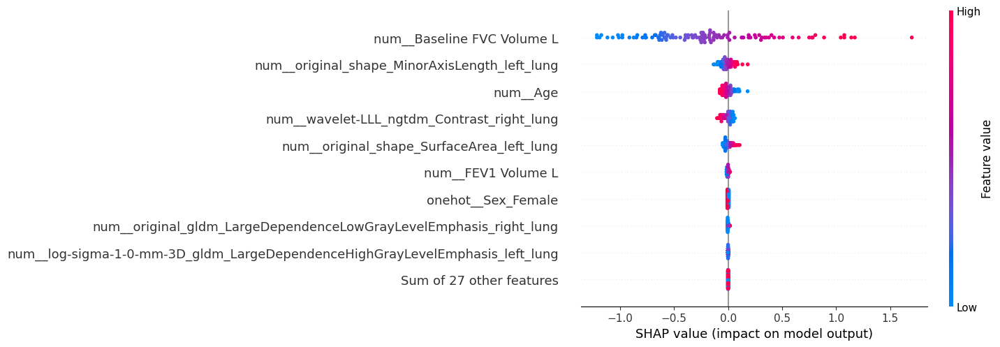

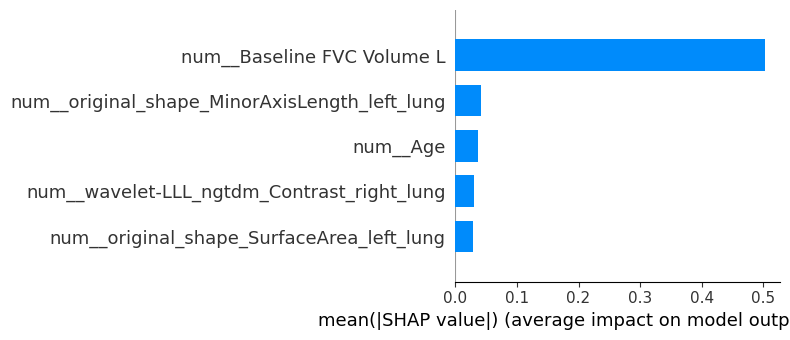

In [17]:
selected_features = ['original_shape_MinorAxisLength_right_lung', 'original_shape_SurfaceArea_left_lung', 'wavelet-LLL_ngtdm_Contrast_right_lung', 'original_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'wavelet-HLL_firstorder_Skewness_right_lung', 'wavelet-HHL_glszm_LargeAreaHighGrayLevelEmphasis_right_lung', 'original_shape_MinorAxisLength_left_lung', 'log-sigma-1-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung', 'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung', 'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung']
Clinical_Contineous_data_ext = selected_features + Clinical_Contineous_data
print(Clinical_Contineous_data_ext)
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_clinical_without_harmonization.pkl")
X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)
results1 = train_and_evaluate_elasticnet(X_train_median_filled, X_test_median_filled, y_train, y_test, selected_features, Clinical_Contineous_data_ext, Clinical_Categorical_data, 
                                         model_name="/home/pansurya/OSIC_thesis/EN_model/Hierarchical_ANOVA_VIF_EN_without_harmonization.pkl")



['original_shape_MinorAxisLength_left_lung', 'wavelet-HHH_glcm_MCC_right_lung', 'wavelet-LLL_glszm_GrayLevelVariance_left_lung', 'original_shape_MinorAxisLength_right_lung', 'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung', 'log-sigma-1-0-mm-3D_gldm_GrayLevelNonUniformity_left_lung', 'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Busyness_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Busyness_left_lung', 'original_firstorder_90Percentile_right_lung', 'log-sigma-3-0-mm-3D_glszm_ZoneVariance_right_lung', 'original_shape_SurfaceArea_left_lung', 'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung', 'original_glszm_SmallAreaHighGrayLevelEmphasis_right_lung', 'log-sigma-1-0-mm-3D_ngtdm_Busyness_right_lung', 'log-sigma-1-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung', 'wavelet-LLH_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-LHL_firstorder_Kurtosis_right_lung', 'wavelet-LLL_glszm_GrayLevelNonUniformity_right_lung', 'original

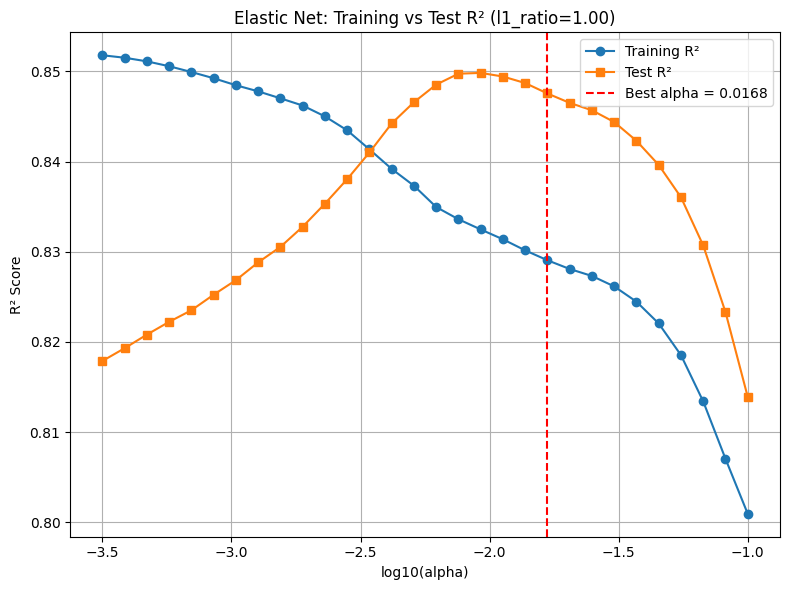

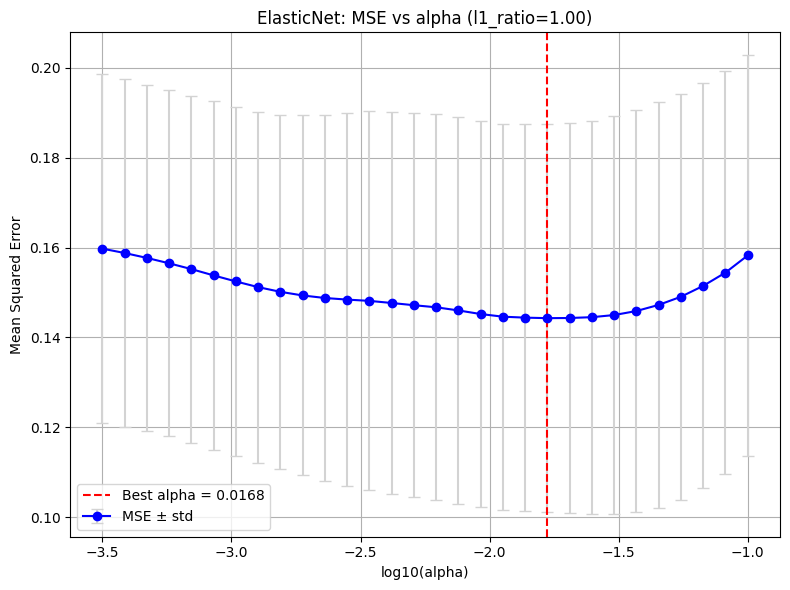


Computing MSE vs l1_ratio...


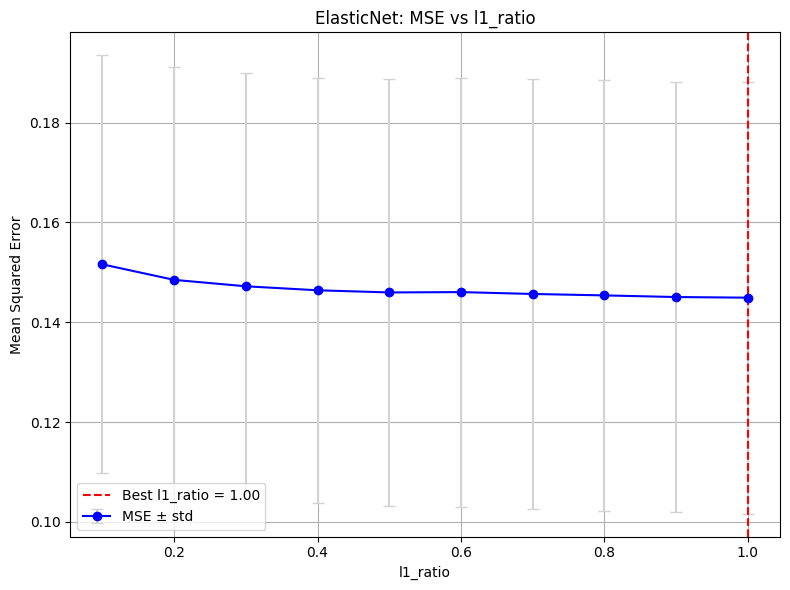


Model coefficients (sorted by |coef|):
                                              Feature  Coefficient
30                              Baseline FVC Volume L     0.707757
32                                                Age    -0.054385
0            original_shape_MinorAxisLength_left_lung     0.044751
29  log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGra...    -0.031641
25              wavelet-LHL_ngtdm_Busyness_right_lung     0.021028
28              wavelet-LLL_ngtdm_Contrast_right_lung    -0.016785
33                                           Sex_Male     0.010963
11               original_shape_SurfaceArea_left_lung     0.008304
2       wavelet-LLL_glszm_GrayLevelVariance_left_lung    -0.007855
31                                      FEV1 Volume L     0.006240
26  log-sigma-5-0-mm-3D_glrlm_LongRunHighGrayLevel...     0.005876
19  original_gldm_LargeDependenceLowGrayLevelEmpha...     0.001399
3           original_shape_MinorAxisLength_right_lung     0.000000
5   log-sigma-1-0-mm-3

/tmp/ipykernel_4059943/2091552719.py:262: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


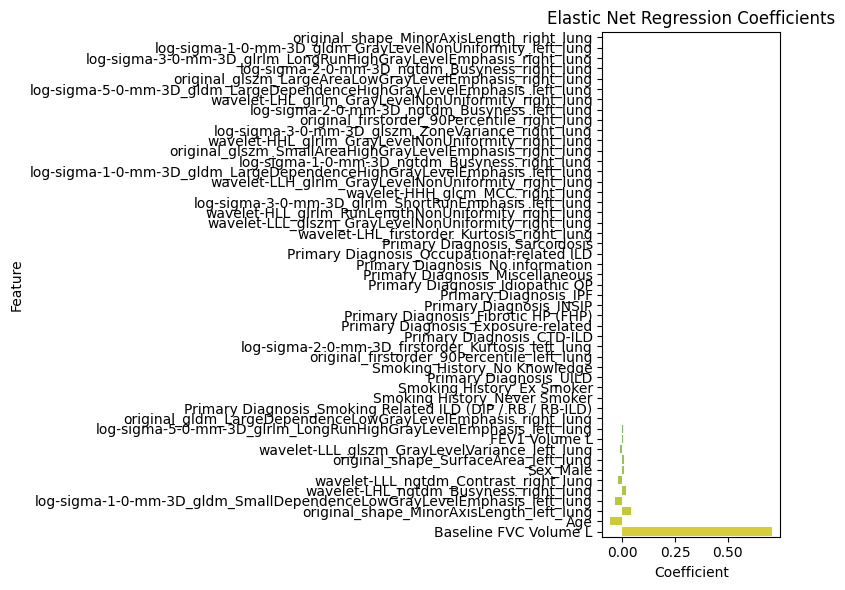

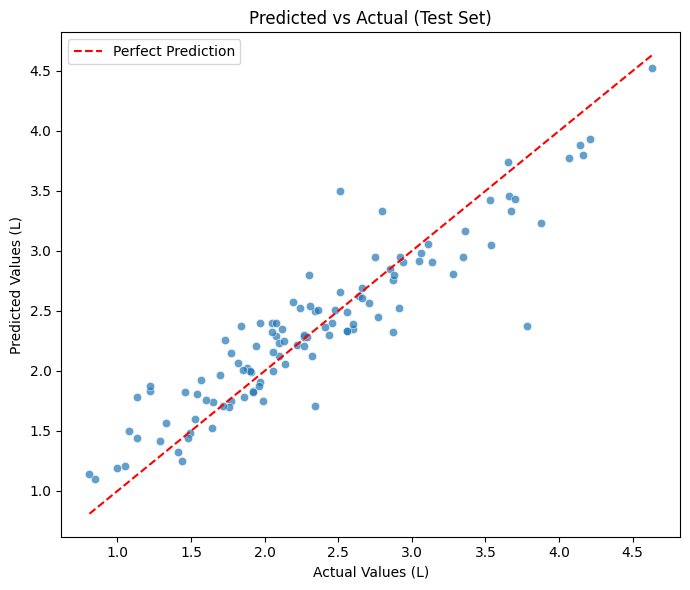

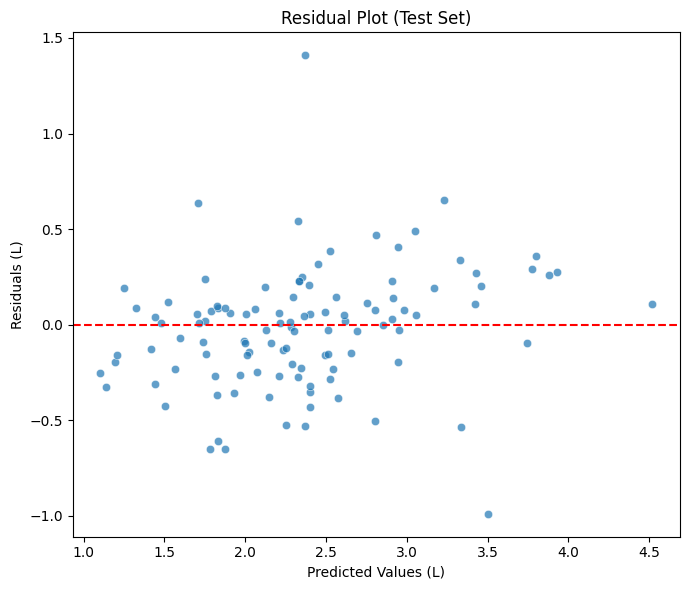


Top 5 patients with largest errors:
     Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  Baseline_FVC_Week  \
123          2.23        3.78       2.370497   1.409503                0.0   
152          3.63        2.51       3.499862   0.989862                0.0   
233          1.98        1.22       1.872789   0.652789                0.0   
368          1.56        1.13       1.780985   0.650985                0.0   
81           3.59        3.88       3.229558   0.650442                0.0   

     Followup_FVC_Week  
123               51.0  
152               53.0  
233               54.0  
368               49.0  
81                52.0  


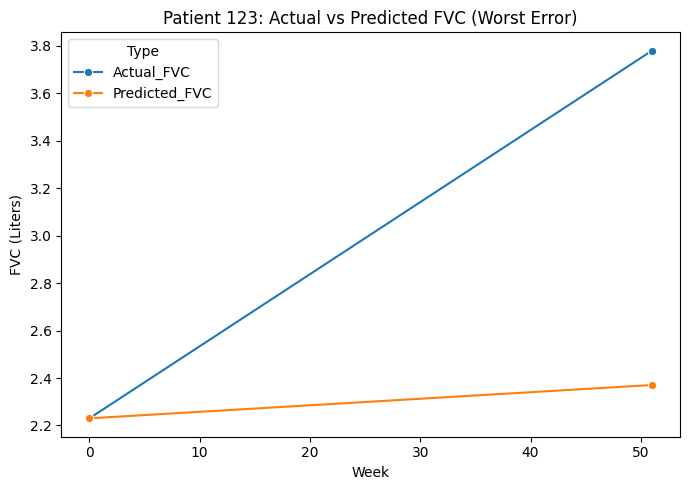

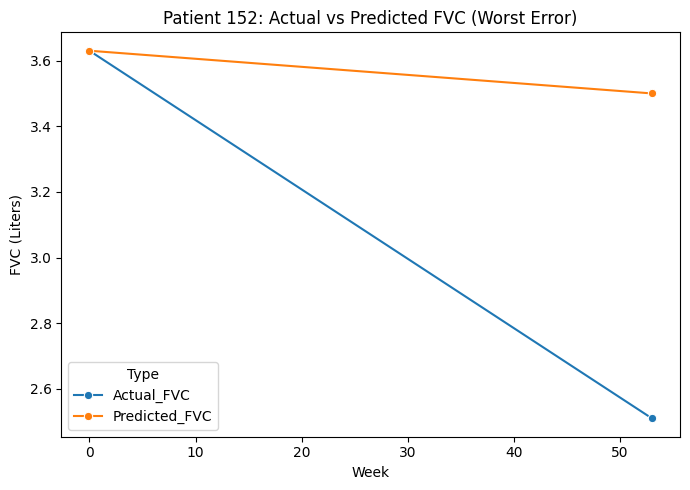

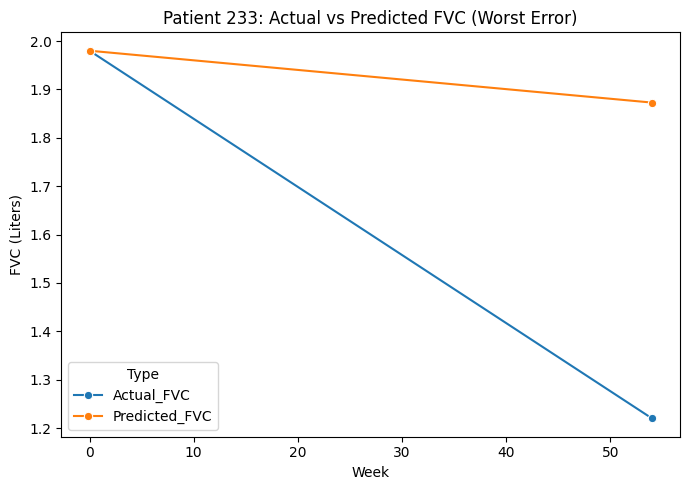

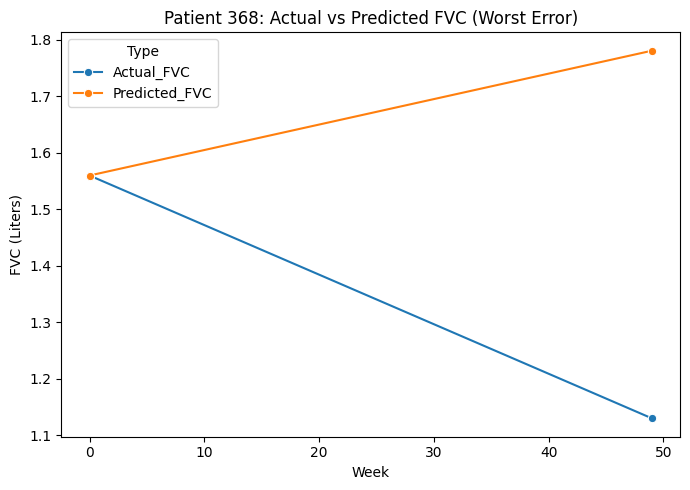

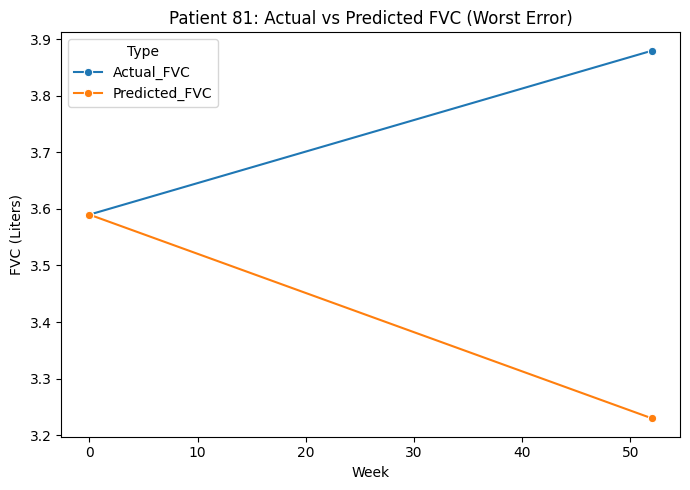


Top 5 patients with increasing FVC and lowest error:
     Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  Baseline_FVC_Week  \
426          1.66        1.72       1.711276   0.008724                0.0   
511          1.43        1.49       1.480720   0.009280                0.0   
535          1.43        1.48       1.439407   0.040593                0.0   
229          3.02        3.11       3.059853   0.050147                0.0   
514          2.65        2.66       2.608488   0.051512                0.0   

     Followup_FVC_Week  
426               52.0  
511               54.0  
535               55.0  
229               52.0  
514               52.0  


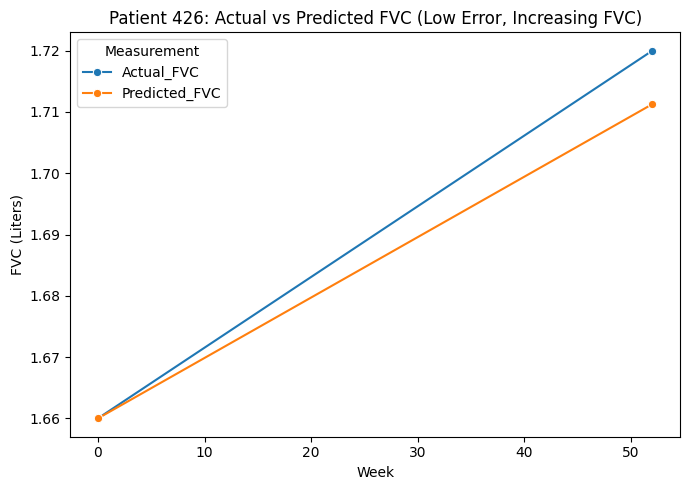

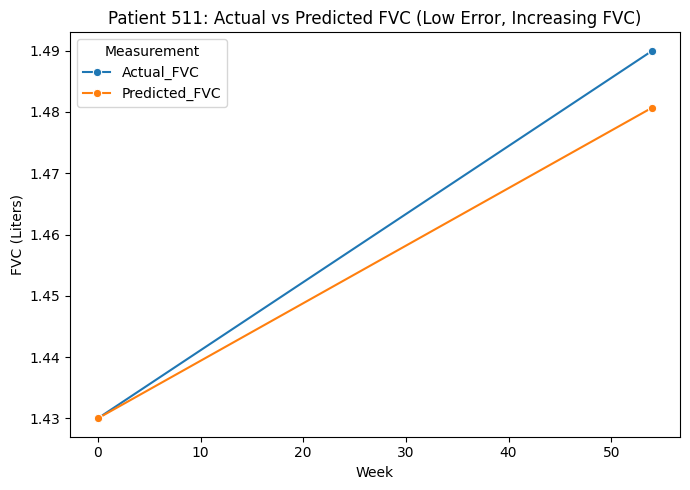

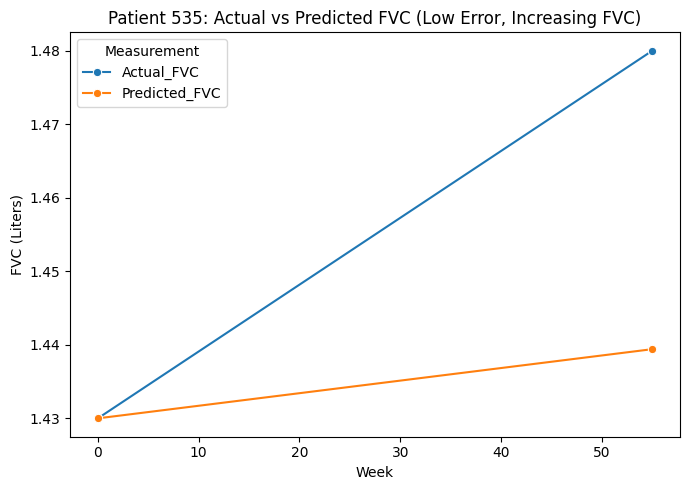

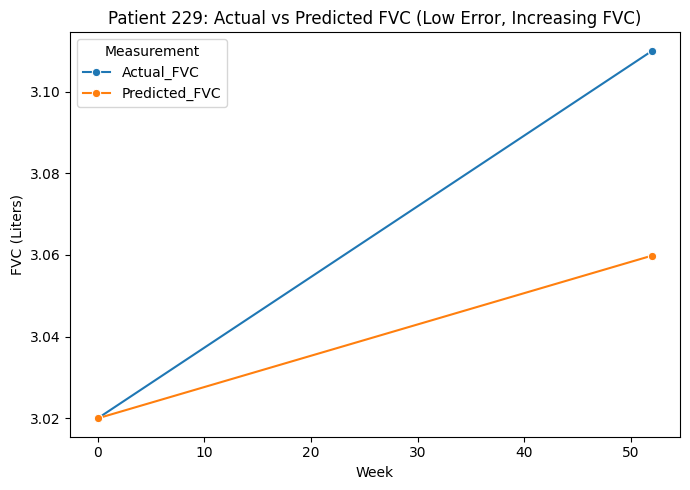

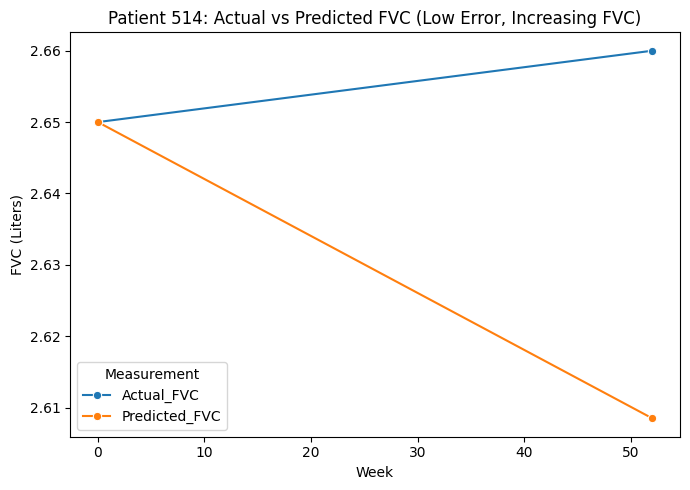

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


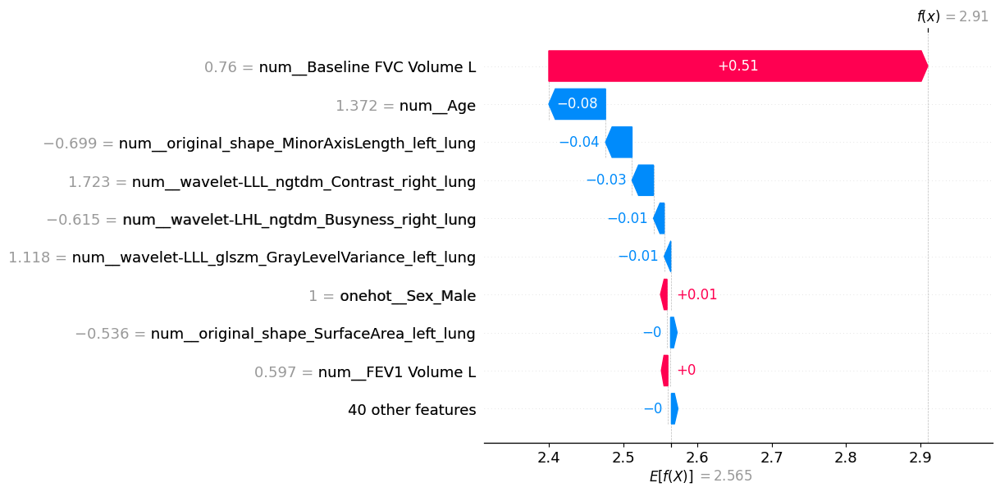

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/plots/_beeswarm.py:1150: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


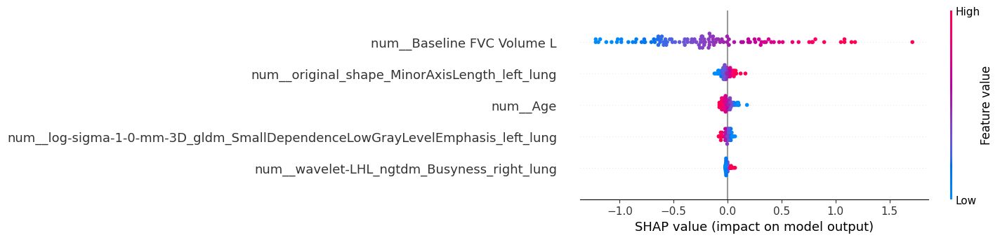

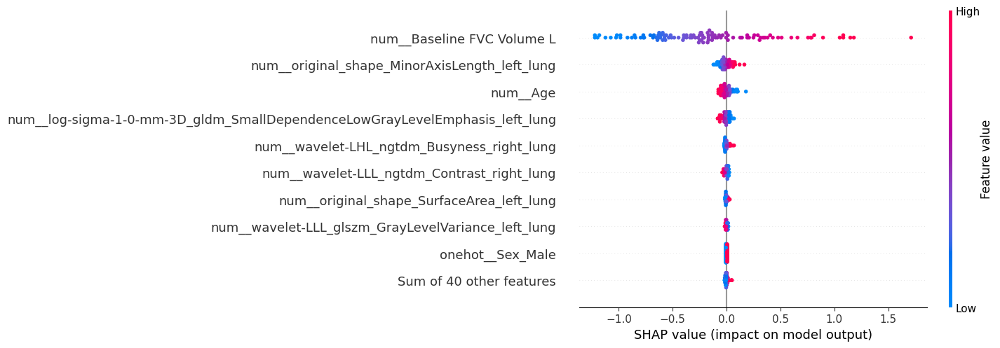

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/plots/_beeswarm.py:1150: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


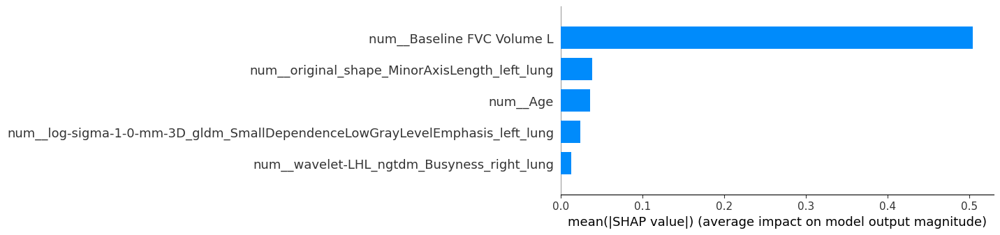

In [8]:
selected_features =['original_shape_MinorAxisLength_left_lung', 'wavelet-HHH_glcm_MCC_right_lung', 'wavelet-LLL_glszm_GrayLevelVariance_left_lung', 'original_shape_MinorAxisLength_right_lung', 'wavelet-LHL_glrlm_GrayLevelNonUniformity_right_lung', 'log-sigma-1-0-mm-3D_gldm_GrayLevelNonUniformity_left_lung', 'log-sigma-3-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Busyness_right_lung', 'log-sigma-2-0-mm-3D_ngtdm_Busyness_left_lung', 'original_firstorder_90Percentile_right_lung', 'log-sigma-3-0-mm-3D_glszm_ZoneVariance_right_lung', 'original_shape_SurfaceArea_left_lung', 'wavelet-HHL_glrlm_GrayLevelNonUniformity_right_lung', 'original_glszm_SmallAreaHighGrayLevelEmphasis_right_lung', 'log-sigma-1-0-mm-3D_ngtdm_Busyness_right_lung', 'log-sigma-1-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung', 'wavelet-LLH_glrlm_GrayLevelNonUniformity_right_lung', 'wavelet-LHL_firstorder_Kurtosis_right_lung', 'wavelet-LLL_glszm_GrayLevelNonUniformity_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'wavelet-HLL_glrlm_RunLengthNonUniformity_right_lung', 'original_firstorder_90Percentile_left_lung', 'original_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'log-sigma-3-0-mm-3D_glrlm_ShortRunEmphasis_left_lung', 'log-sigma-5-0-mm-3D_gldm_LargeDependenceHighGrayLevelEmphasis_left_lung', 'wavelet-LHL_ngtdm_Busyness_right_lung', 'log-sigma-5-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_left_lung', 'log-sigma-2-0-mm-3D_firstorder_Kurtosis_left_lung', 'wavelet-LLL_ngtdm_Contrast_right_lung', 'log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung']
Clinical_Contineous_data_ext = selected_features + Clinical_Contineous_data
print(Clinical_Contineous_data_ext)
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_clinical_without_harmonization.pkl")
X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)
# Run experiments
results1 = train_and_evaluate_elasticnet(X_train_median_filled, X_test_median_filled, y_train, y_test, selected_features, Clinical_Contineous_data_ext, Clinical_Categorical_data, 
                                         model_name="/home/pansurya/OSIC_thesis/EN_model/Hierarchical_mrmr_VIF_EN_without_harmonization.pkl")
# print("Running LOOCV experiment...")
# results1 = train_and_evaluate_with_LOOCV(X_train, X_test, y_train, y_test, selected_features, model_name="/home/pansurya/OSIC_thesis/Linear_model/Hierarchical_mrmr_VIF_LOOCV.pkl")



['original_shape_MinorAxisLength_right_lung', 'original_shape_SurfaceArea_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'wavelet-HHL_glcm_Idmn_right_lung', 'log-sigma-2-0-mm-3D_firstorder_Median_right_lung', 'log-sigma-3-0-mm-3D_glcm_Idmn_right_lung', 'log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'log-sigma-4-0-mm-3D_glcm_InverseVariance_right_lung', 'original_shape_MinorAxisLength_left_lung', 'log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung', 'Baseline FVC Volume L', 'FEV1 Volume L', 'Age']
Numeric features: ['original_shape_MinorAxisLength_right_lung', 'original_shape_SurfaceArea_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'wavelet-HHL_glcm_Idmn_right_lung', 'log-sigma-2-0-mm-3D_firstorder_Median_right_lung', 'log-sigma-3-0-mm-3D_glcm_Idmn_right_lung', 'log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'log-sigma-4-0-mm-3D_glcm_InverseVariance_right_lung',

MAE: [0.27647560927414727, 0.2321901572978607, 0.29221315243006246, 0.23009649486564845, 0.2720712935174341, 0.2343944258243649, 0.3016487776741674, 0.23736273880892422, 0.22633667196213914, 0.29544896126429826, 0.3291738399819625, 0.2281238293252014, 0.23268835287584014, 0.2802043163251558, 0.23612751799255544]
MSE: [0.15309771636543493, 0.11395235999104095, 0.2063669559910612, 0.10966789570712952, 0.14832876028046058, 0.09480770674794395, 0.18618199878497, 0.1353505677855796, 0.11424463265513934, 0.19584181122242317, 0.22755732868001607, 0.09938017618468017, 0.1300716750702681, 0.15485925145549, 0.12328412143052801]
RMSE: [0.391277032759955, 0.3375683041860431, 0.4542762991738191, 0.33116143451061675, 0.3851347300367244, 0.3079086012893176, 0.4314881212559275, 0.36790021444079046, 0.33800093587908797, 0.4425401803479806, 0.4770296937089096, 0.31524621517899337, 0.3606545092886932, 0.3935216022729756, 0.3511183866312444]
R2: [0.8289164001823149, 0.8626371121511831, 0.7715164837714686,

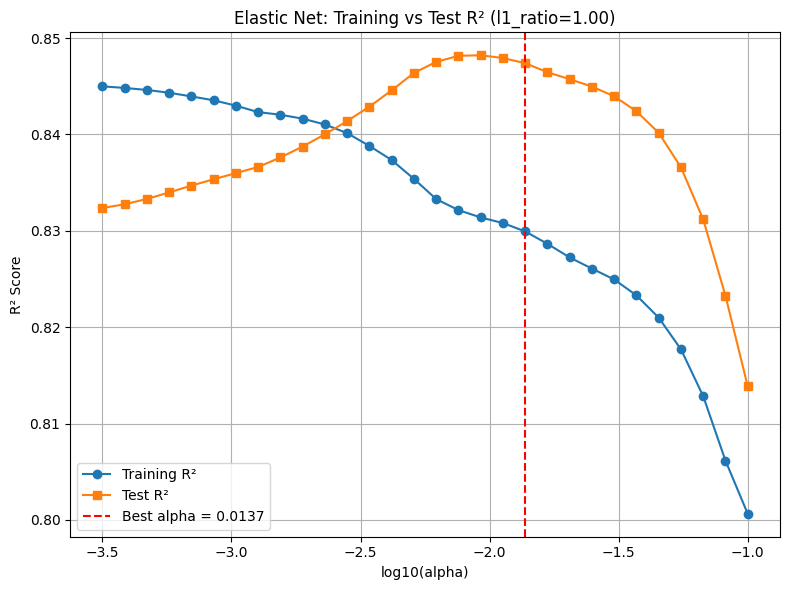

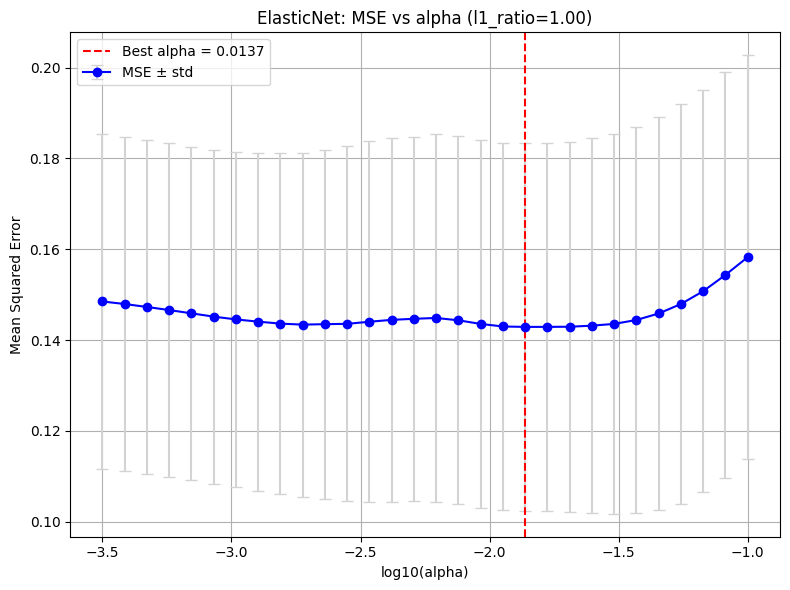


Computing MSE vs l1_ratio...


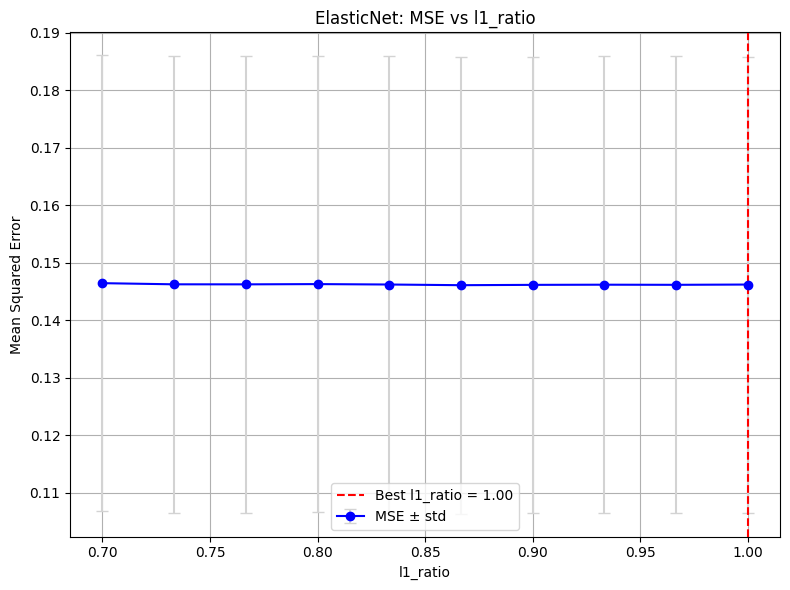


Test set performance:
- MAE:  0.23 L
- MSE:  0.10 L²
- RMSE: 0.31 L
- R²:   0.847

Training set performance:
- MAE:  0.25 L
- MSE:  0.13 L²
- RMSE: 0.37 L
- R²:   0.830

Model coefficients (sorted by |coef|):
                                              Feature   Coefficient
10                              Baseline FVC Volume L  7.094628e-01
12                                                Age -6.550003e-02
8            original_shape_MinorAxisLength_left_lung  5.823284e-02
9   log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGra... -3.813859e-02
29                                         Sex_Female -2.028197e-02
5            log-sigma-3-0-mm-3D_glcm_Idmn_right_lung -1.992832e-02
7   log-sigma-4-0-mm-3D_glcm_InverseVariance_right... -1.412994e-02
3                    wavelet-HHL_glcm_Idmn_right_lung  1.351511e-02
6   log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLeve...  1.042981e-02
2   original_gldm_LargeDependenceLowGrayLevelEmpha...  4.852332e-03
11                                      FE

/tmp/ipykernel_1436971/1153454105.py:260: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


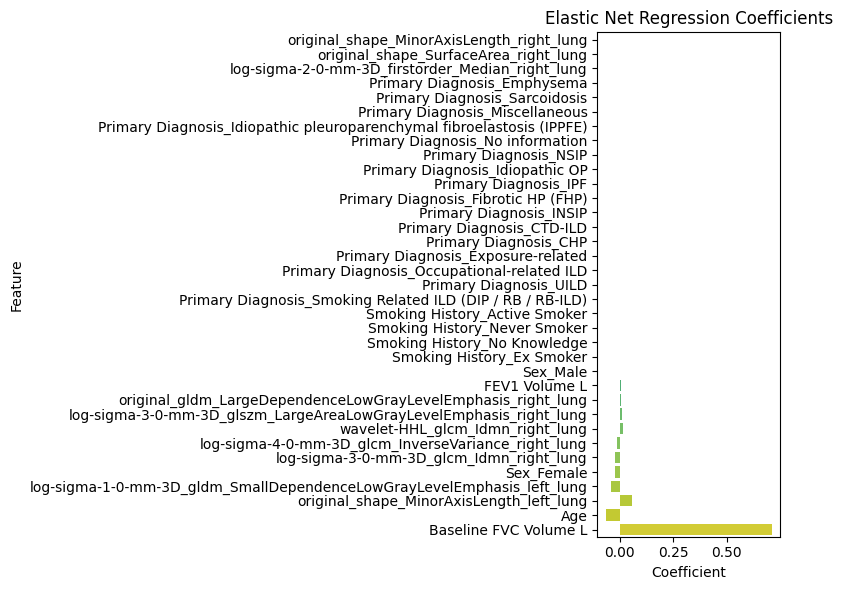

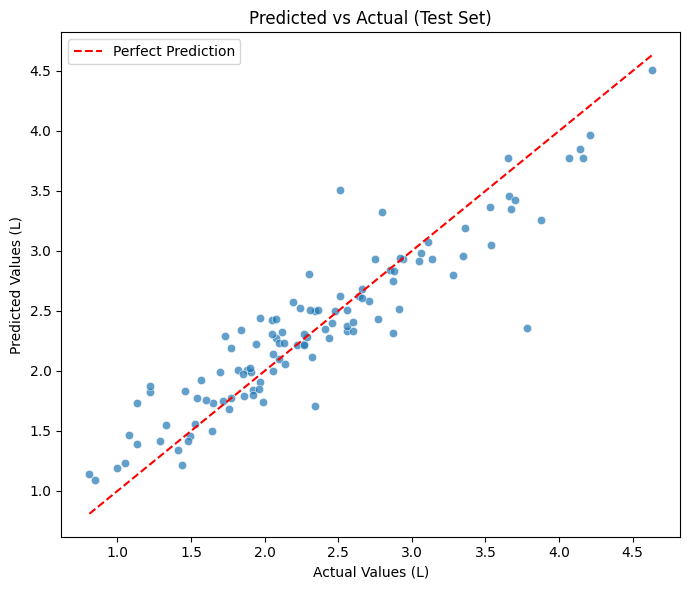

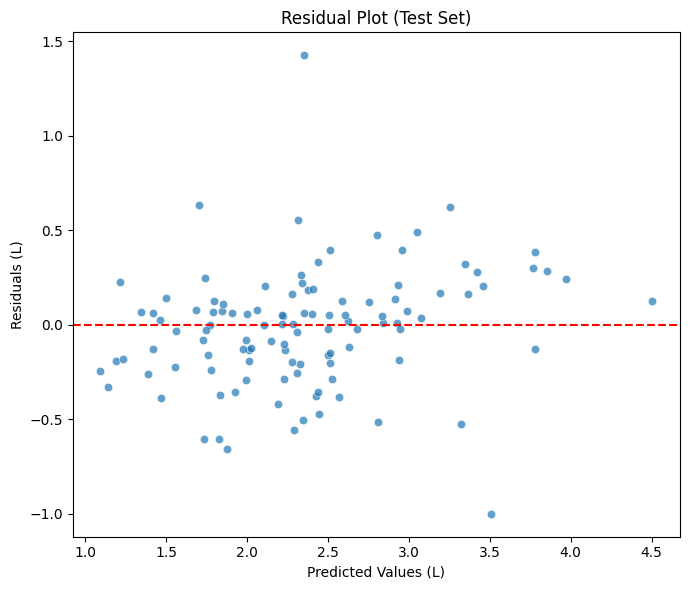


Top 5 patients with largest errors:
     Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  Baseline_FVC_Week  \
123          2.23        3.78       2.354093   1.425907                0.0   
152          3.63        2.51       3.509317   0.999317                0.0   
233          1.98        1.22       1.877585   0.657585                0.0   
28           1.89        2.34       1.704924   0.635076                0.0   
81           3.59        3.88       3.256767   0.623233                0.0   

     Followup_FVC_Week  
123               51.0  
152               53.0  
233               54.0  
28                48.0  
81                52.0  


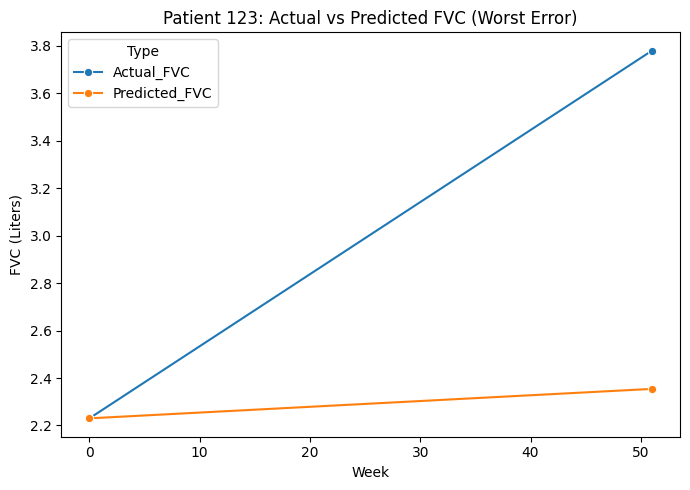

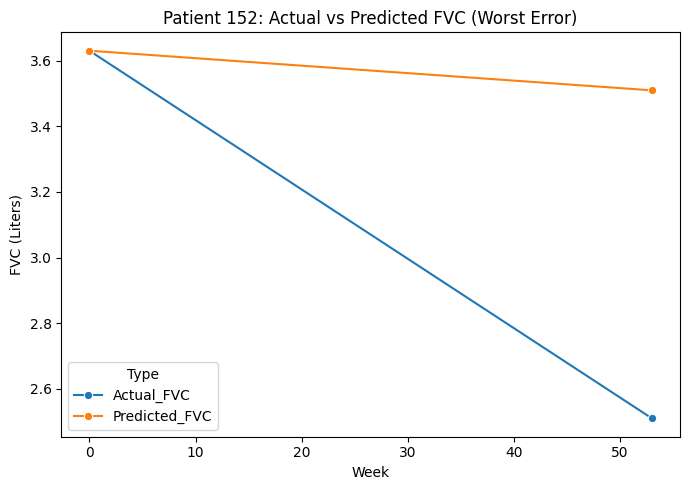

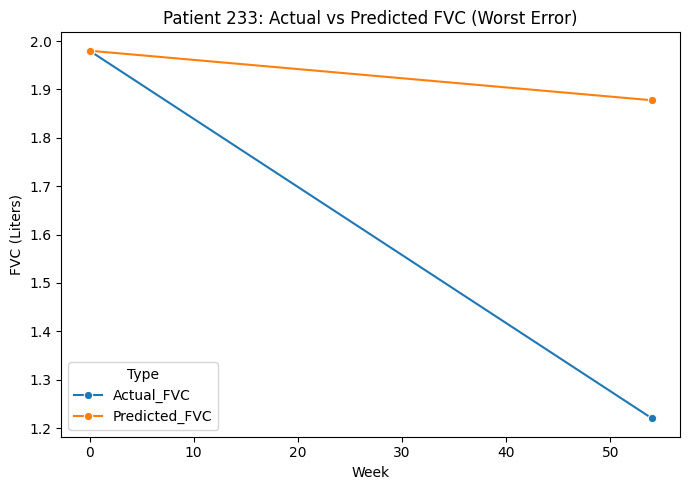

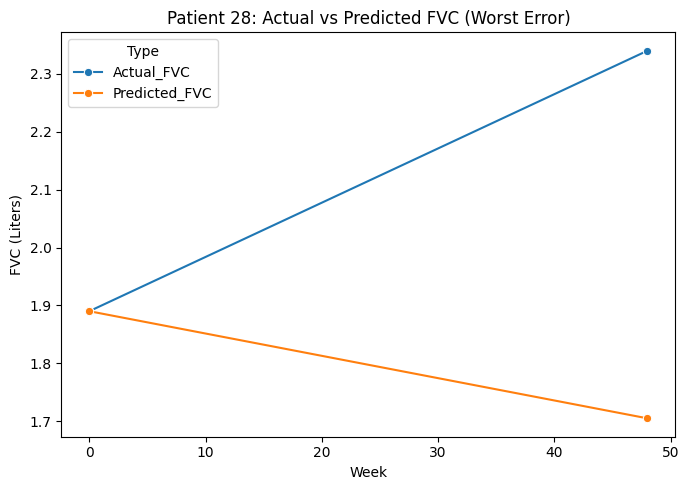

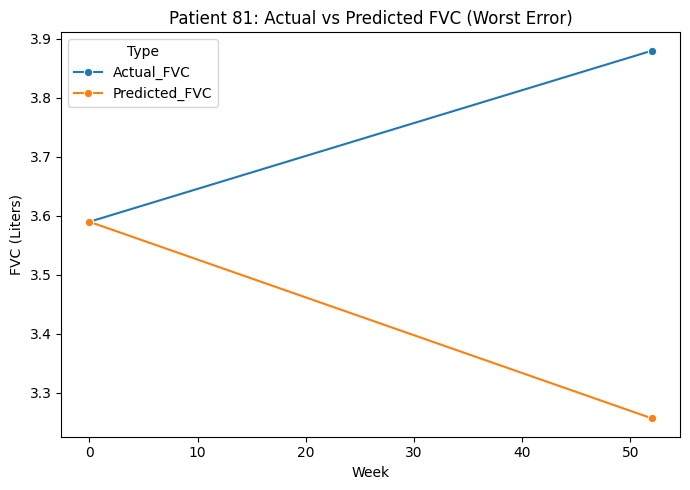


Top 5 patients with increasing FVC and lowest error:
     Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  Baseline_FVC_Week  \
426          1.66        1.72       1.748124   0.028124                0.0   
511          1.43        1.49       1.461862   0.028138                0.0   
229          3.02        3.11       3.074944   0.035056                0.0   
107          2.81        2.88       2.832201   0.047799                0.0   
114          2.47        2.56       2.507635   0.052365                0.0   

     Followup_FVC_Week  
426               52.0  
511               54.0  
229               52.0  
107               54.0  
114               51.0  


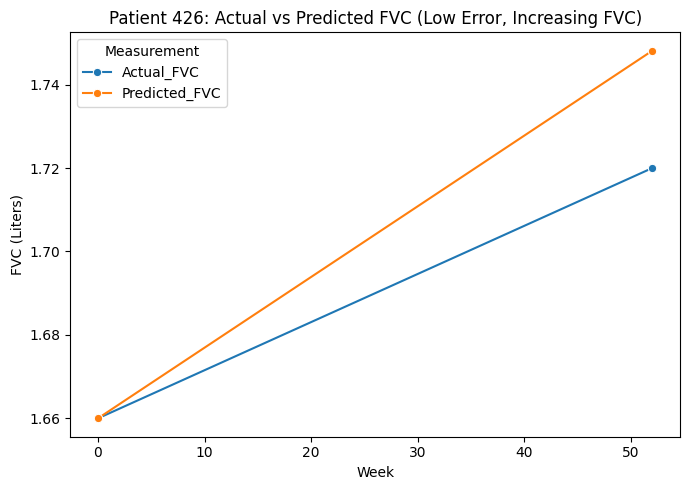

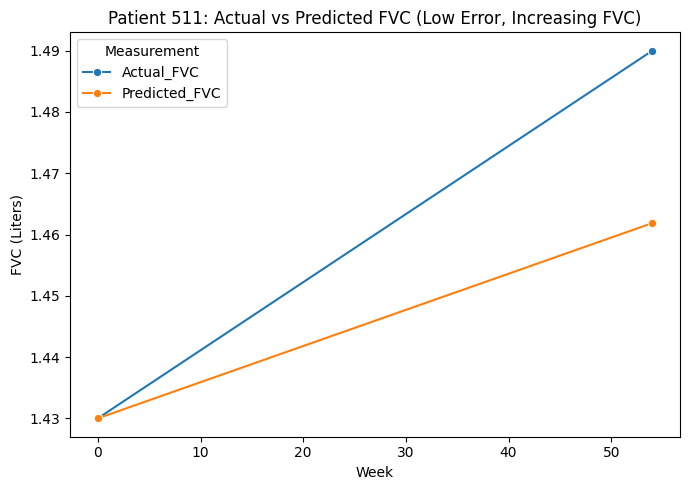

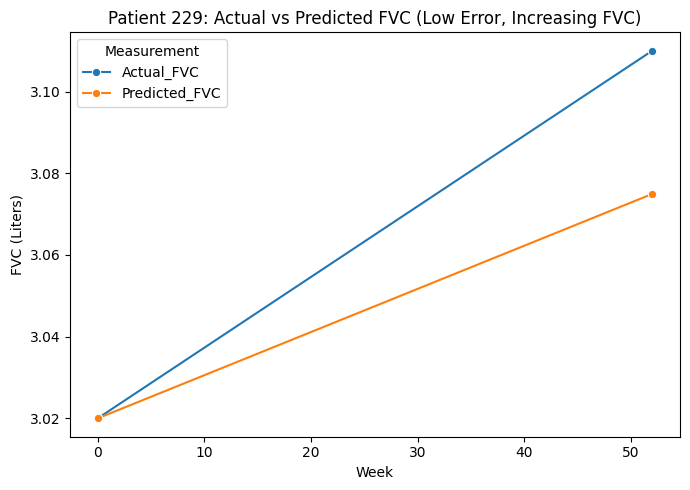

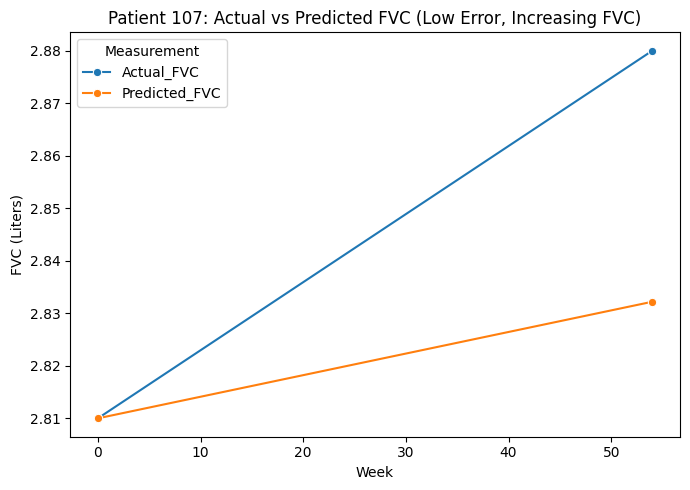

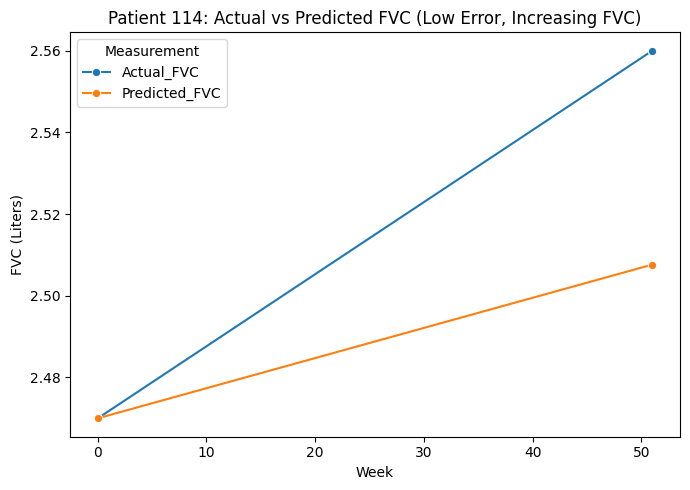

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


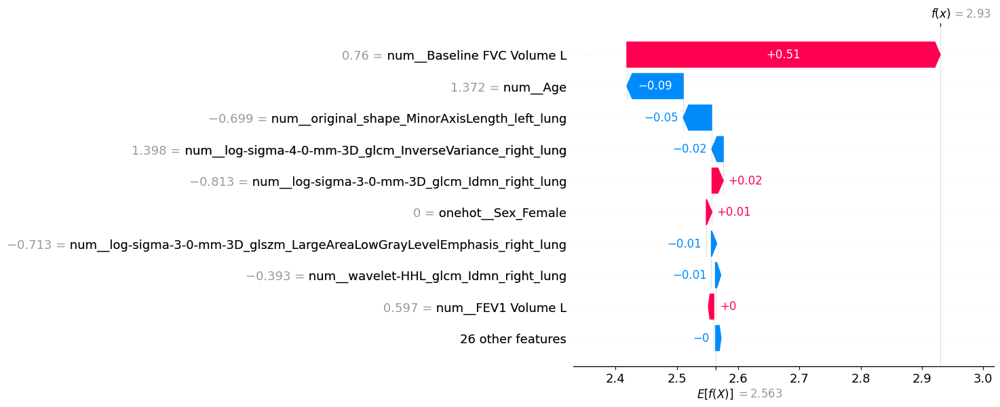

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/plots/_beeswarm.py:1150: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


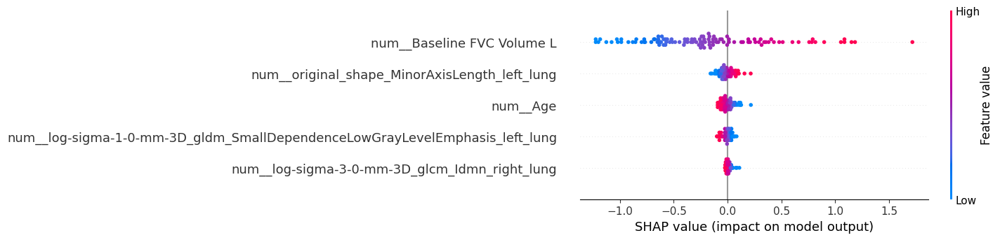

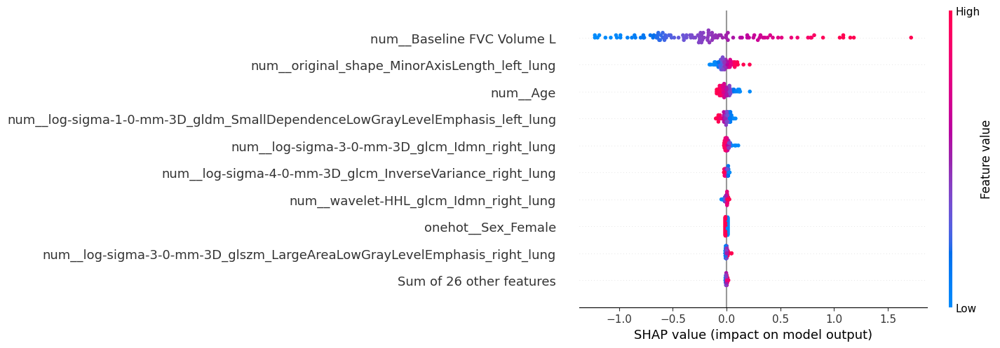

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/plots/_beeswarm.py:1150: UserWarning: Tight layout not applied. The left and right margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


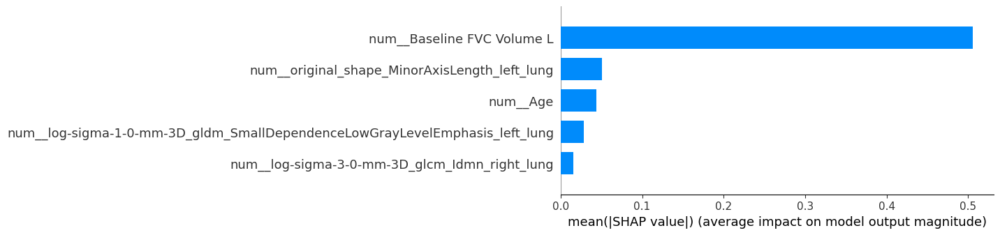

In [6]:
selected_features = ['original_shape_MinorAxisLength_right_lung', 'original_shape_SurfaceArea_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'wavelet-HHL_glcm_Idmn_right_lung', 'log-sigma-2-0-mm-3D_firstorder_Median_right_lung', 'log-sigma-3-0-mm-3D_glcm_Idmn_right_lung', 'log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'log-sigma-4-0-mm-3D_glcm_InverseVariance_right_lung', 'original_shape_MinorAxisLength_left_lung', 'log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung']
Clinical_Contineous_data_ext = selected_features + Clinical_Contineous_data
print(Clinical_Contineous_data_ext)
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_clinical_without_harmonization.pkl")
X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)
results1 = train_and_evaluate_elasticnet(X_train_median_filled, X_test_median_filled, y_train, y_test, selected_features, Clinical_Contineous_data_ext, Clinical_Categorical_data, 
                                         model_name="/home/pansurya/OSIC_thesis/EN_model/Correlation_based_Using_Target_FVC_EN_without_harmonization.pkl")
# print("Running LOOCV experiment...")
# results1 = train_and_evaluate_with_LOOCV(X_train, X_test, y_train, y_test, selected_features, model_name="/home/pansurya/OSIC_thesis/Linear_model/PAM_ANOVA_VIF_LOOCV.pkl")


['original_shape_MinorAxisLength_left_lung', 'wavelet-HLH_gldm_DependenceNonUniformityNormalized_right_lung', 'log-sigma-2-0-mm-3D_firstorder_10Percentile_right_lung', 'original_shape_MinorAxisLength_right_lung', 'wavelet-HHL_glcm_Idmn_right_lung', 'original_shape_SurfaceArea_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'log-sigma-3-0-mm-3D_glcm_InverseVariance_right_lung', 'log-sigma-2-0-mm-3D_firstorder_Kurtosis_left_lung', 'log-sigma-1-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung', 'log-sigma-4-0-mm-3D_glcm_InverseVariance_right_lung', 'wavelet-LHL_glcm_Idmn_left_lung', 'log-sigma-1-0-mm-3D_firstorder_Skewness_left_lung', 'wavelet-HLL_firstorder_Kurtosis_left_lung', 'Baseline FVC Volume L', 'FEV1 Volume L', 'Age']


Numeric features: ['original_shape_MinorAxisLength_left_lung', 'wavelet-HLH_gldm_DependenceNonUniformityNormalized_right_lung', 'log-sigma-2-0-mm-3D_firstorder_10Percentile_right_lung', 'original_shape_MinorAxisLength_right_lung', 'wavelet-HHL_glcm_Idmn_right_lung', 'original_shape_SurfaceArea_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'log-sigma-3-0-mm-3D_glcm_InverseVariance_right_lung', 'log-sigma-2-0-mm-3D_firstorder_Kurtosis_left_lung', 'log-sigma-1-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung', 'log-sigma-4-0-mm-3D_glcm_InverseVariance_right_lung', 'wavelet-LHL_glcm_Idmn_left_lung', 'log-sigma-1-0-mm-3D_firstorder_Skewness_left_lung', 'wavelet-HLL_firstorder_Kurtosis_left_lung', 'Baseline FVC Volume L', 'FEV1 Volume L', 'Age']
One-hot features: ['Primary Diagnosis_CHP', 'Primary Diagnosis_CTD-ILD

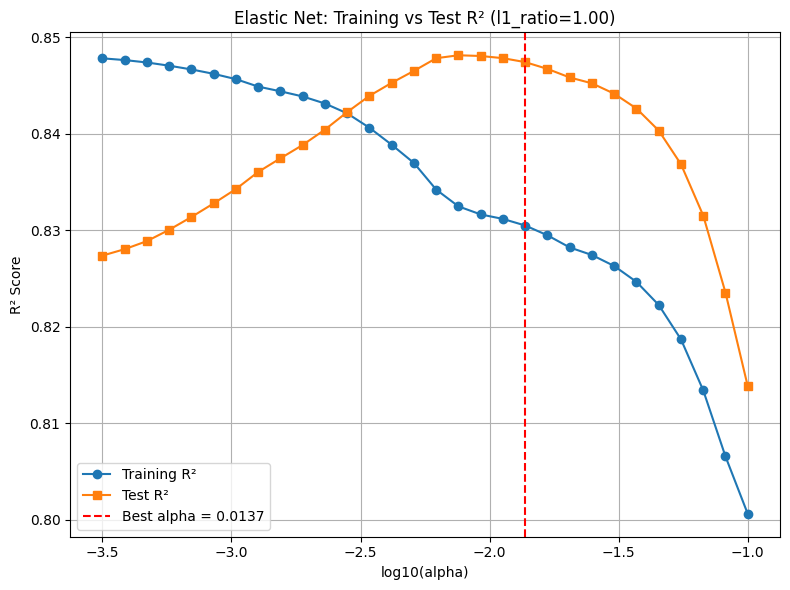

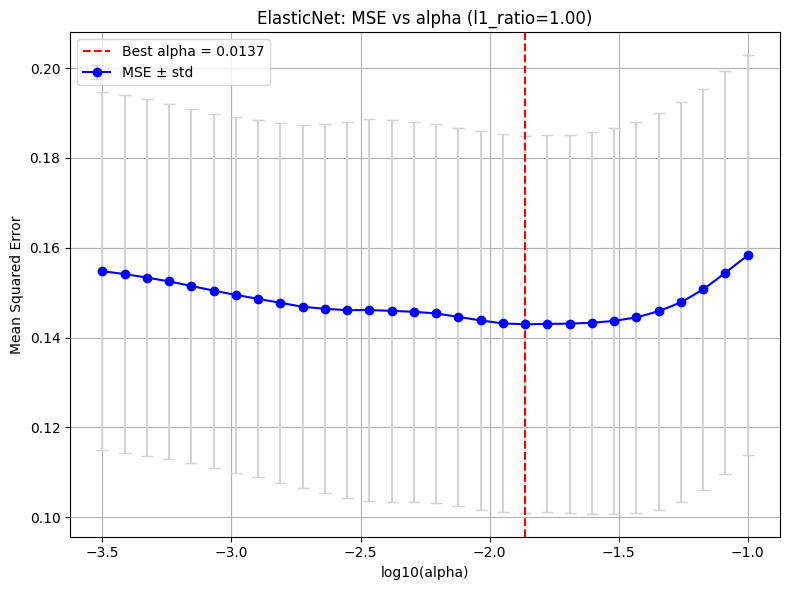


Computing MSE vs l1_ratio...


/home/pansurya/.venv/lib64/python3.9/site-packages/joblib/externals/loky/process_executor.py:782: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


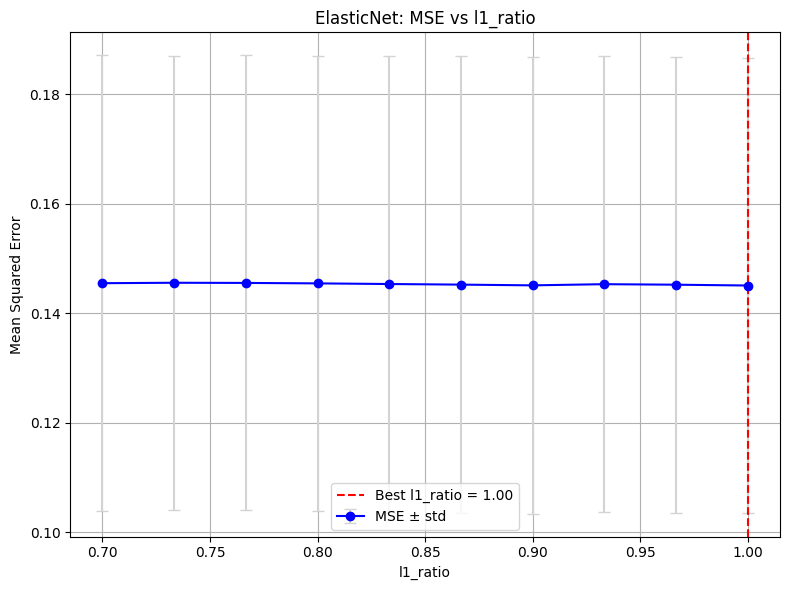


Test set performance:
- MAE:  0.23 L
- MSE:  0.10 L²
- RMSE: 0.31 L
- R²:   0.847

Training set performance:
- MAE:  0.25 L
- MSE:  0.13 L²
- RMSE: 0.36 L
- R²:   0.830

Model coefficients (sorted by |coef|):
                                              Feature   Coefficient
16                              Baseline FVC Volume L  6.992750e-01
18                                                Age -6.583943e-02
0            original_shape_MinorAxisLength_left_lung  5.427591e-02
35                                         Sex_Female -3.700846e-02
13                    wavelet-LHL_glcm_Idmn_left_lung  2.705597e-02
2   log-sigma-2-0-mm-3D_firstorder_10Percentile_ri...  2.624614e-02
11  log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGra... -1.735665e-02
14  log-sigma-1-0-mm-3D_firstorder_Skewness_left_lung -7.631556e-03
10  log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLeve...  5.834039e-03
5               original_shape_SurfaceArea_right_lung  5.239037e-03
17                                      FE

/tmp/ipykernel_1436971/1153454105.py:260: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


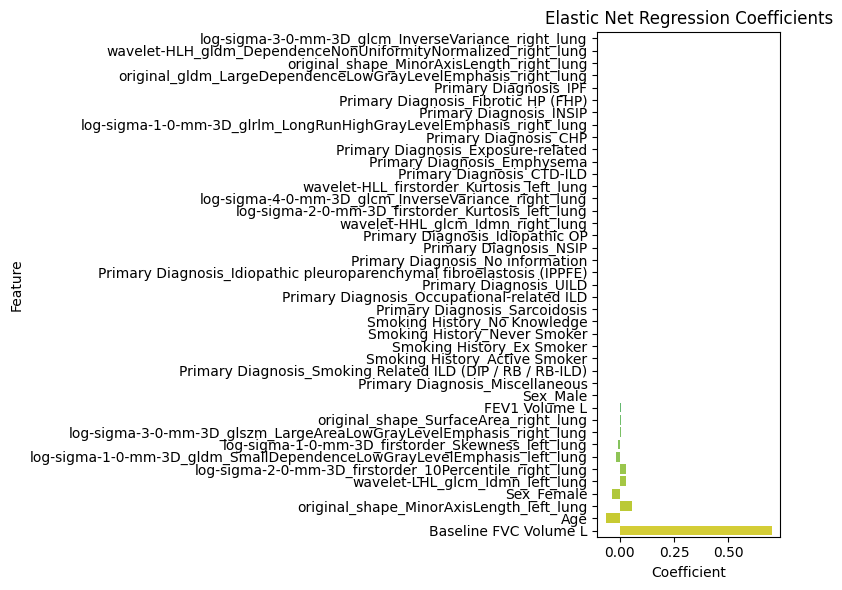

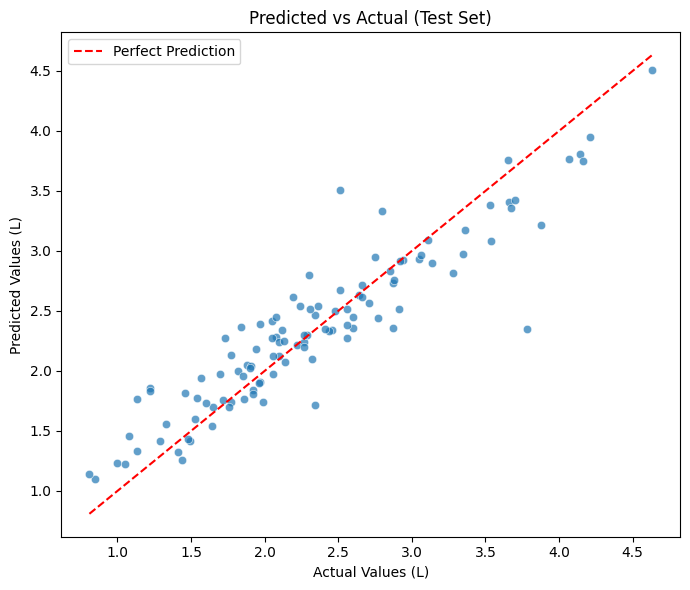

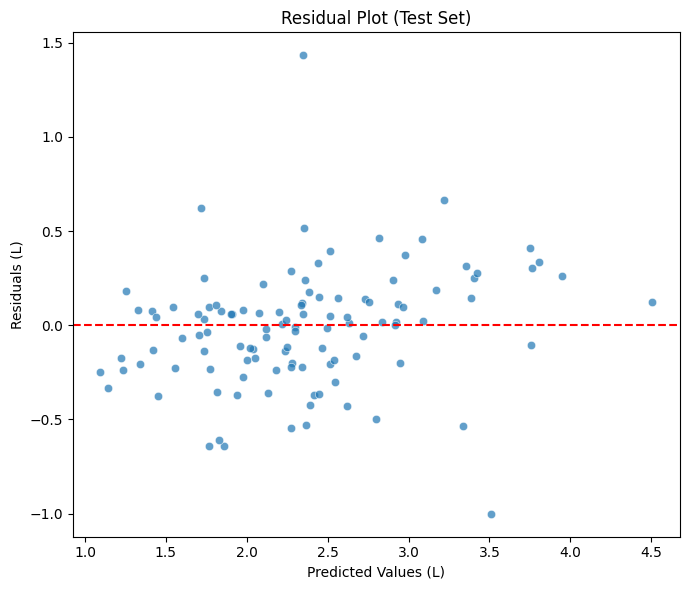


Top 5 patients with largest errors:
     Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  Baseline_FVC_Week  \
123          2.23        3.78       2.347212   1.432788                0.0   
152          3.63        2.51       3.510753   1.000753                0.0   
81           3.59        3.88       3.217925   0.662075                0.0   
416          1.80        1.22       1.861131   0.641131                0.0   
368          1.56        1.13       1.769108   0.639108                0.0   

     Followup_FVC_Week  
123               51.0  
152               53.0  
81                52.0  
416               50.0  
368               49.0  


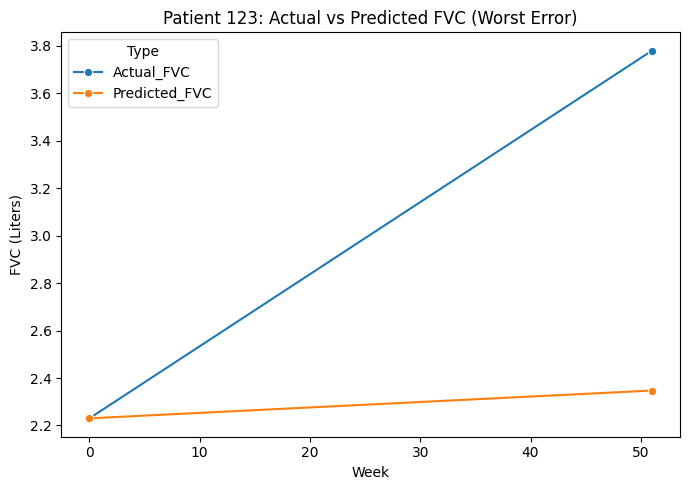

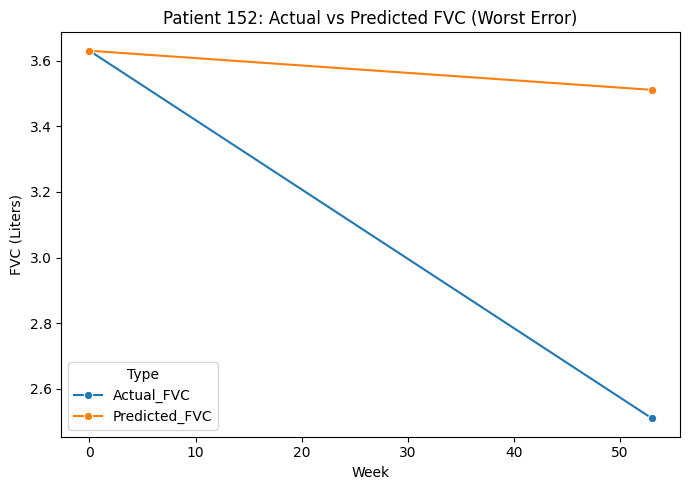

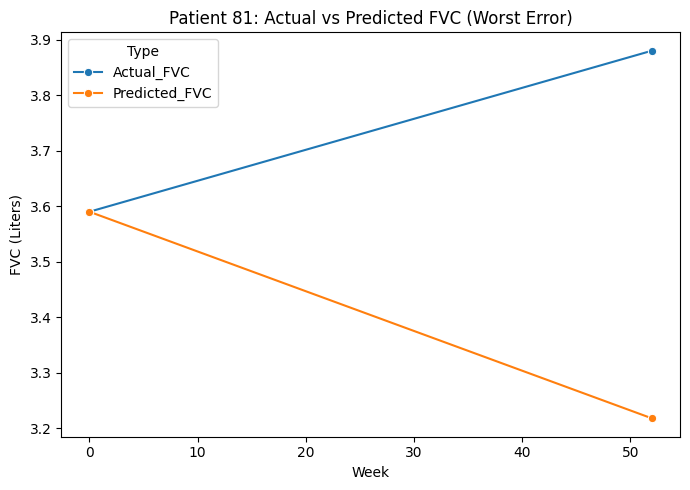

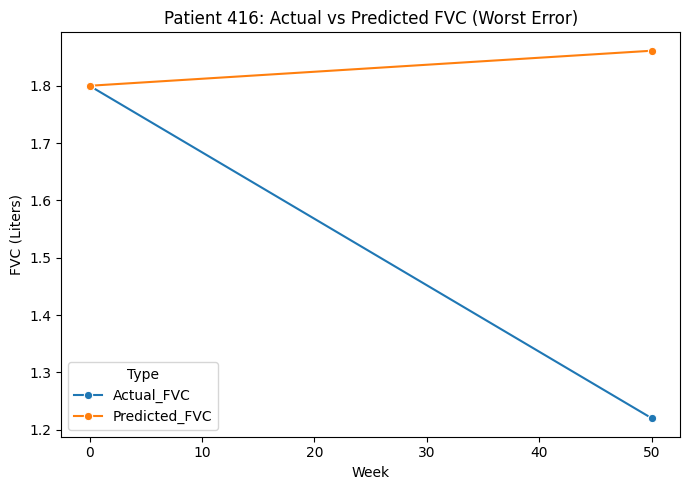

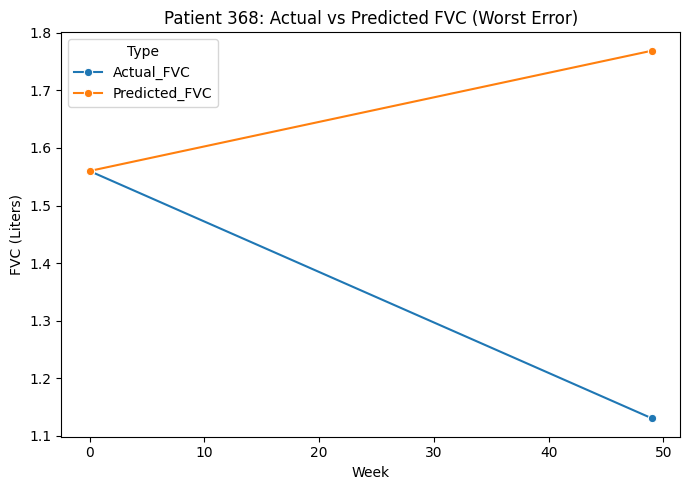


Top 5 patients with increasing FVC and lowest error:
     Baseline_FVC  Target_FVC  Predicted_FVC  Abs_Error  Baseline_FVC_Week  \
229          3.02        3.11       3.089440   0.020560                0.0   
426          1.66        1.72       1.754376   0.034376                0.0   
514          2.65        2.66       2.618252   0.041748                0.0   
535          1.43        1.48       1.436928   0.043072                0.0   
114          2.47        2.56       2.512086   0.047914                0.0   

     Followup_FVC_Week  
229               52.0  
426               52.0  
514               52.0  
535               55.0  
114               51.0  


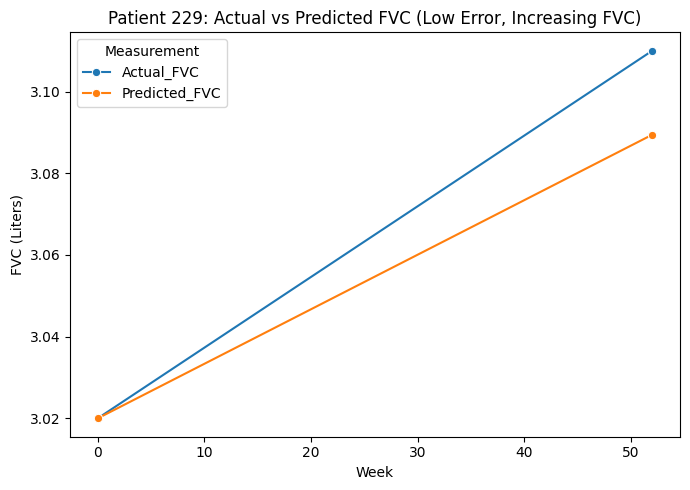

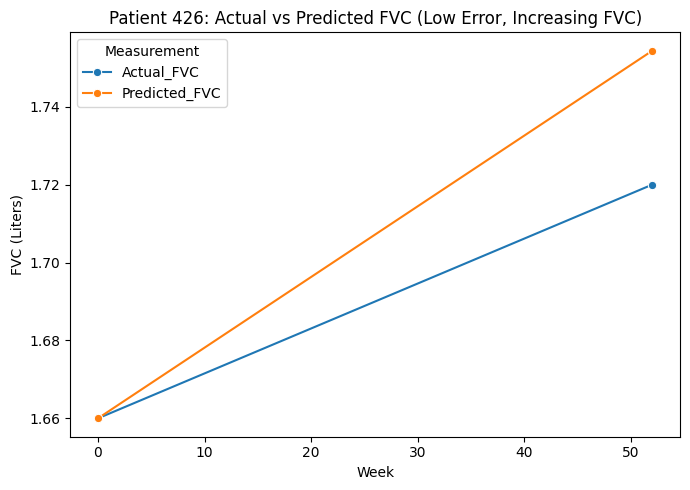

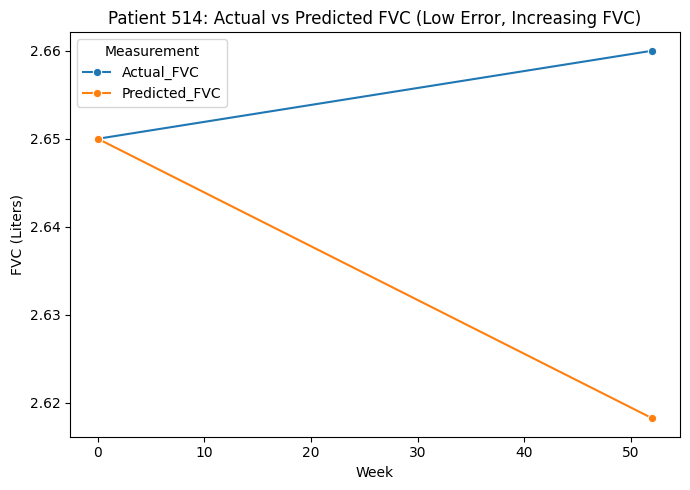

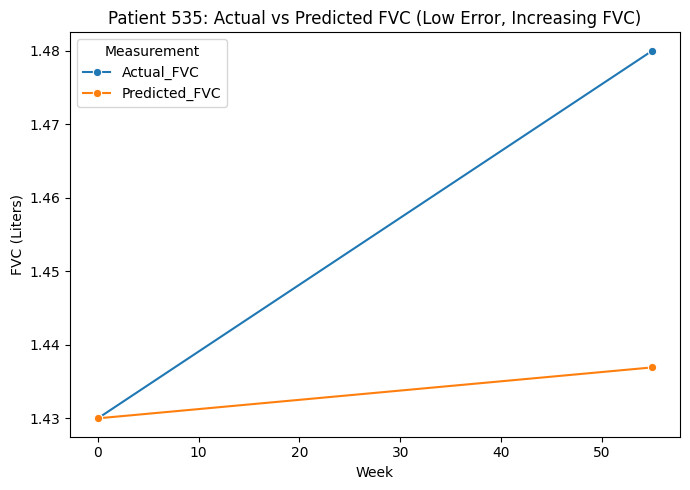

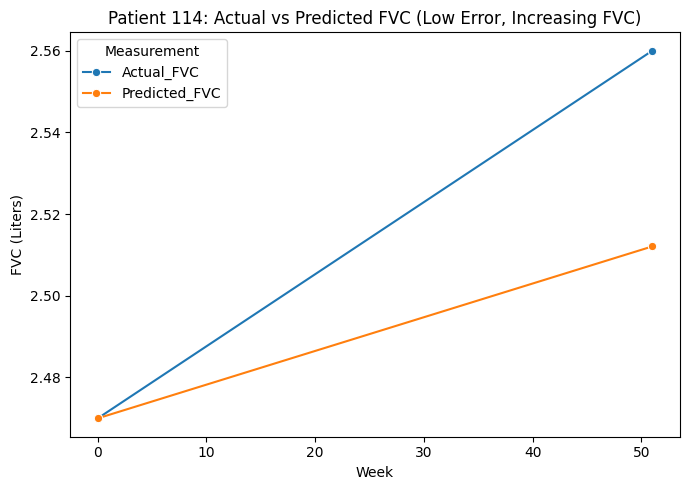

/home/pansurya/.venv/lib64/python3.9/site-packages/shap/explainers/_linear.py:99: FutureWarning: The feature_perturbation option is now deprecated in favor of using the appropriate masker (maskers.Independent, maskers.Partition or maskers.Impute).
  warnings.warn(wmsg, FutureWarning)


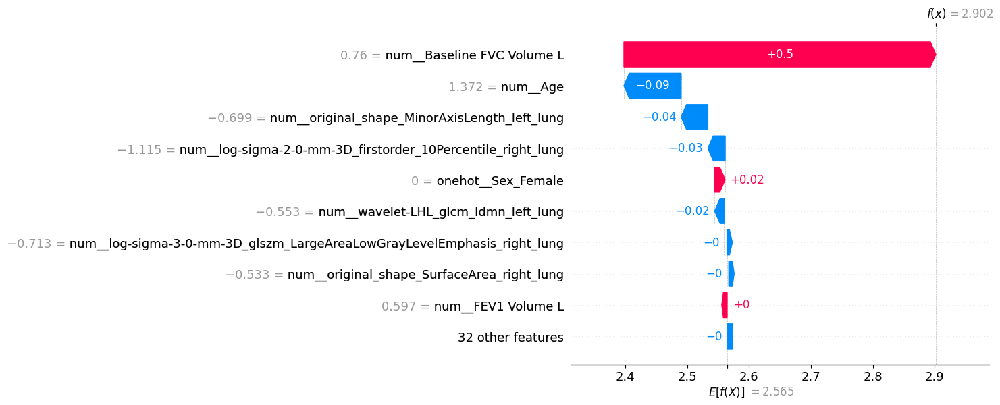

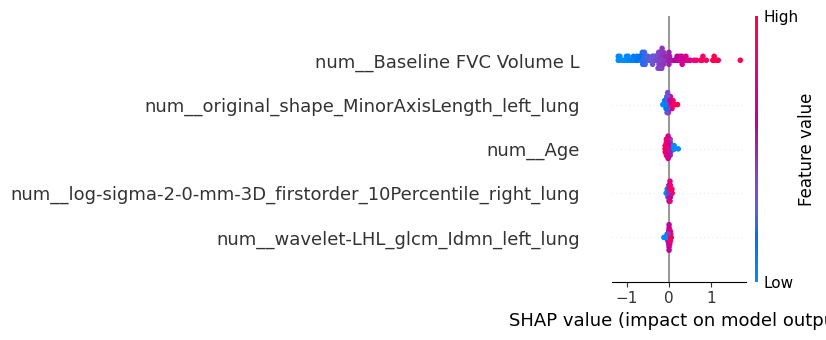

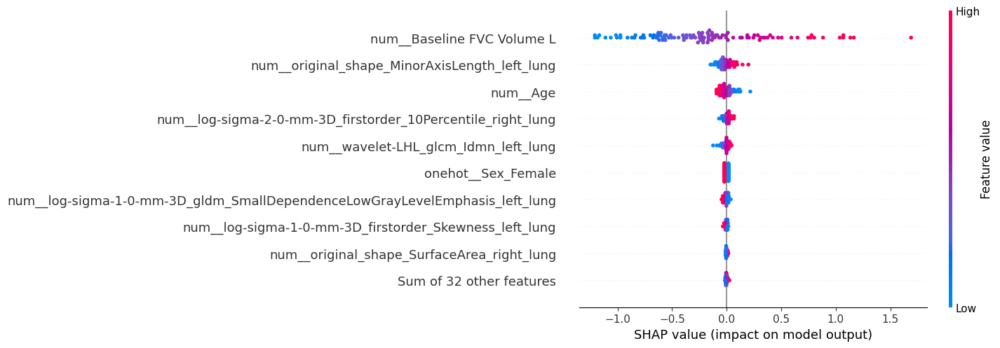

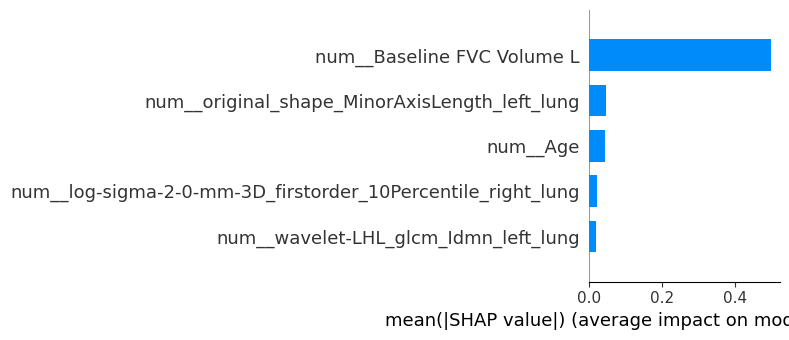

In [5]:
selected_features = ['original_shape_MinorAxisLength_left_lung', 'wavelet-HLH_gldm_DependenceNonUniformityNormalized_right_lung', 'log-sigma-2-0-mm-3D_firstorder_10Percentile_right_lung', 'original_shape_MinorAxisLength_right_lung', 'wavelet-HHL_glcm_Idmn_right_lung', 'original_shape_SurfaceArea_right_lung', 'original_gldm_LargeDependenceLowGrayLevelEmphasis_right_lung', 'log-sigma-3-0-mm-3D_glcm_InverseVariance_right_lung', 'log-sigma-2-0-mm-3D_firstorder_Kurtosis_left_lung', 'log-sigma-1-0-mm-3D_glrlm_LongRunHighGrayLevelEmphasis_right_lung', 'log-sigma-3-0-mm-3D_glszm_LargeAreaLowGrayLevelEmphasis_right_lung', 'log-sigma-1-0-mm-3D_gldm_SmallDependenceLowGrayLevelEmphasis_left_lung', 'log-sigma-4-0-mm-3D_glcm_InverseVariance_right_lung', 'wavelet-LHL_glcm_Idmn_left_lung', 'log-sigma-1-0-mm-3D_firstorder_Skewness_left_lung', 'wavelet-HLL_firstorder_Kurtosis_left_lung']
Clinical_Contineous_data_ext = selected_features + Clinical_Contineous_data
print(Clinical_Contineous_data_ext)
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_clinical_without_harmonization.pkl")
X_train_clini_log = X_train.copy()
X_test_clini_log  = X_test.copy()

# Transform Age
for col in ['Age']:
    X_train_clini_log[col] = np.log(X_train_clini_log[col])
    X_test_clini_log[col] = np.log(X_test_clini_log[col])

# Median imputation (only needed if missing values exist)
imp_median = SimpleImputer(strategy='median')
imp_median.fit(X_train_clini_log)

X_train_median_filled = pd.DataFrame(
    imp_median.transform(X_train_clini_log),
    columns=X_train_clini_log.columns,
    index=X_train_clini_log.index
)

X_test_median_filled = pd.DataFrame(
    imp_median.transform(X_test_clini_log),
    columns=X_test_clini_log.columns,
    index=X_test_clini_log.index
)


# Run experiments
results1 = train_and_evaluate_elasticnet(X_train_median_filled, X_test_median_filled, y_train, y_test, selected_features, Clinical_Contineous_data_ext, Clinical_Categorical_data, 
                                         model_name="/home/pansurya/OSIC_thesis/EN_model/Correlation_based_Using_mrmr_EN_without_harmonization.pkl")
# print("Running LOOCV experiment...")
# results1 = train_and_evaluate_with_LOOCV(X_train, X_test, y_train, y_test, selected_features, model_name="/home/pansurya/OSIC_thesis/Linear_model/PAM_ANOVA_VIF_LOOCV.pkl")


Generating Summary Plot...


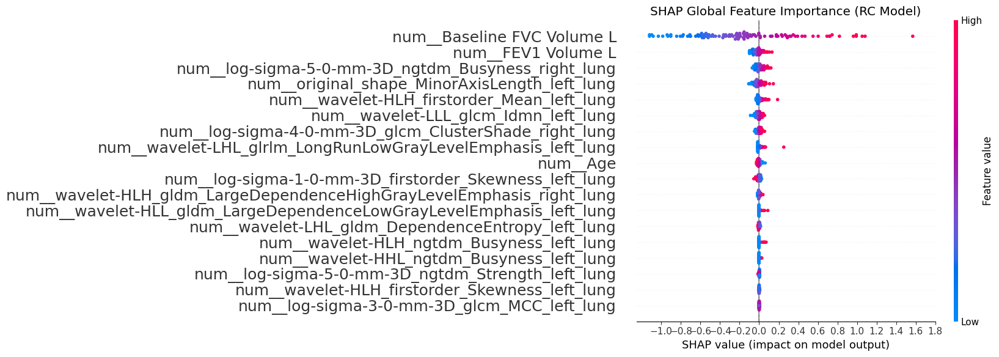


--- Top 10 Most Accurate Patients ---
    Actual_FVC  Predicted_FVC  Absolute_Error
25        2.92       2.924071        0.004071
82        1.48       1.475197        0.004803
76        2.88       2.888228        0.008228
40        1.92       1.929268        0.009268
58        2.29       2.277356        0.012644
95        2.48       2.506094        0.026094
45        1.92       1.893482        0.026518
7         2.85       2.816932        0.033068
12        2.66       2.693198        0.033198
5         1.77       1.732702        0.037298

Selected Patient ID: 25
Actual FVC: 2.92 | Predicted FVC: 2.92


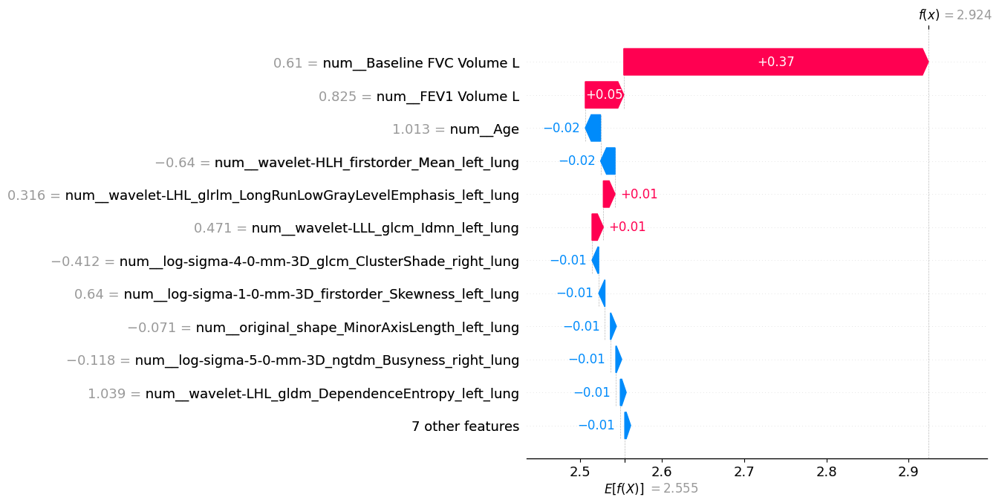

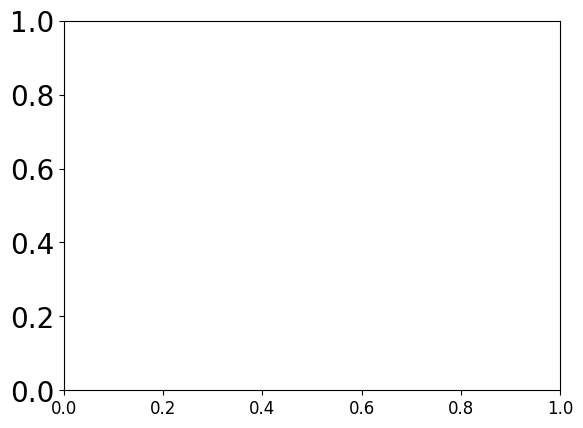

In [11]:
import joblib
import shap
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.impute import SimpleImputer

# ---------------------------------------------------------
# 1. Load Model and Data
# ---------------------------------------------------------
model = joblib.load("/home/pansurya/OSIC_thesis/EN_model/All_Clinical_RadiomicsData/EN_With_All_Clinical_Radiomics_without_harmonization1.pkl")
# model = joblib.load("/home/pansurya/OSIC_thesis/EN_model/Only_with_ClinicalData/EN_With_All_Radiomics_without_harmonization.pkl")
X_train, X_test, y_train, y_test = joblib.load("/home/pansurya/OSIC_thesis/radiomics_files/data_splits_clinical_without_harmonization.pkl")

# Prepare data (matching your training preprocessing)
X_train_log = X_train.copy()
X_test_log  = X_test.copy()

for col in ['Age']:
    X_train_log[col] = np.log1p(X_train_log[col]) # Using log1p is safer for math
    X_test_log[col] = np.log1p(X_test_log[col])

imp_median = SimpleImputer(strategy='median')
X_train_filled = pd.DataFrame(imp_median.fit_transform(X_train_log), columns=X_train_log.columns)
X_test_filled = pd.DataFrame(imp_median.transform(X_test_log), columns=X_test_log.columns)

# Extract internal model components
preprocessor = model.named_steps["scaler"]
en_model = model.named_steps["elasticnet"]
feature_names = preprocessor.get_feature_names_out()

# Transform the data
X_train_transformed = preprocessor.transform(X_train_filled)
X_test_transformed = preprocessor.transform(X_test_filled)

# ---------------------------------------------------------
# 2. SHAP Calculation
# ---------------------------------------------------------
# Use LinearExplainer for Elastic Net
explainer = shap.LinearExplainer(en_model, X_train_transformed)
shap_values_array = explainer.shap_values(X_test_transformed)

# Filter for selected features (non-zero coefficients)
coef = en_model.coef_
selected_mask = coef != 0
selected_features = feature_names[selected_mask]

# Create an Explanation object for all plotting
# Note: .data uses original unscaled values for better readability in plots
explanation = shap.Explanation(
    values=shap_values_array[:, selected_mask],
    base_values=explainer.expected_value,
    data=X_test_transformed[:, selected_mask], # Changed this line
    feature_names=selected_features
)

# ---------------------------------------------------------
# ✅ SHAP SUMMARY PLOT
# ---------------------------------------------------------
print("Generating Summary Plot...")
plt.figure(figsize=(15, 11))

shap.plots.beeswarm(explanation, max_display=20, show=False)
plt.title("SHAP Global Feature Importance (RC Model)")

plt.gcf().set_size_inches(14, 6)
plt.xticks(np.arange(-1, 2, 0.2))
plt.axvline(x=0, color="gray", linestyle="--", linewidth=1)
plt.tight_layout()
for text in plt.gca().get_yticklabels():
    text.set_fontsize(18)
plt.show()

# ---------------------------------------------------------
# 4. Visualization: Dependence Plots
# ---------------------------------------------------------
# # Helper to find column index by name
# def get_idx(name_sub):
#     return [i for i, s in enumerate(selected_features) if name_sub in s][0]

# fvc_idx = get_idx("Baseline FVC Volume L")
# minor_axis_idx = get_idx("original_shape_MinorAxisLength_left_lung")

# print("Generating Dependence Plots...")

# # Plot 1: Baseline FVC
# plt.figure(figsize=(8, 5))
# shap.plots.scatter(explanation[:, fvc_idx], color=explanation[:, fvc_idx], show=False)
# plt.title(f"Dependence Plot: Baseline FVC")
# plt.show()

# # Plot 2: Minor Axis Length (with interaction)
# plt.figure(figsize=(8, 5))
# # Interaction index picks the feature that most explains the variance
# shap.plots.scatter(explanation[:, minor_axis_idx], color=explanation[:, fvc_idx], show=False)
# plt.title(f"Dependence Plot: Minor Axis Length (Colored by Baseline FVC)")
# plt.show()

# # ---------------------------------------------------------
# # 5. Visualization: Waterfall Plot (Individual Patient)
# # ---------------------------------------------------------
# patient_id = 10 # Change this to see different patients
# print(f"Generating Waterfall Plot for Patient {patient_id}...")
# plt.figure(figsize=(10, 6))
# shap.plots.waterfall(explanation[patient_id], max_display=15)

# ---------------------------------------------------------
# ✅ Helper: Find the "Best" Patients for Waterfall Plots
# ---------------------------------------------------------
# 1. Get predictions using the same pre-filled data
predictions = model.predict(X_test_filled)

# 2. Create a comparison table and ensure the index is preserved correctly
comparison_df = pd.DataFrame({
    'Actual_FVC': y_test.values,
    'Predicted_FVC': predictions,
    'Absolute_Error': np.abs(y_test.values - predictions)
})

# Sort by lowest error to find the "best" fit
best_fits = comparison_df.sort_values(by='Absolute_Error').head(10)

print("\n--- Top 10 Most Accurate Patients ---")
print(best_fits)

# ---------------------------------------------------------
# 5. Visualization: Waterfall Plot (Individual Patient)
# ---------------------------------------------------------
# CHOOSE THE PATIENT: Pick the index from the left-most column of the table above
# We cast it to int() to prevent the IndexError
patient_id = int(best_fits.index[0]) 

print(f"\nSelected Patient ID: {patient_id}")
print(f"Actual FVC: {y_test.values[patient_id]:.2f} | Predicted FVC: {predictions[patient_id]:.2f}")



# Create the plot
# explanation[patient_id] correctly slices the SHAP object for that specific row
plt.figure(figsize=(10, 8))
shap.plots.waterfall(explanation[patient_id], max_display=12)
for text in plt.gca().get_yticklabels():
    text.set_fontsize(20)
plt.show()

# from sklearn.inspection import PartialDependenceDisplay
# import matplotlib.pyplot as plt

# # 1. Define the top 5 features
# top_5_features = [
#     "Baseline FVC Volume L", 
#     "FEV1 Volume L",
#     "log-sigma-5-0-mm-3D_ngtdm_Busyness_right_lung",
#     "original_shape_MinorAxisLength_left_lung",
#     "wavelet-LHL_glrlm_LongRunLowGrayLevelEmphasis_left_lung"
# ]

# # 2. Set global font sizes
# plt.rcParams.update({
#     'font.size': 12, 
#     'axes.labelsize': 14, 
#     'ytick.labelsize': 12,
#     'xtick.labelsize': 12
# })

# # 3. Loop through each feature to create individual figures
# for feature in top_5_features:
#     fig, ax = plt.subplots(figsize=(8, 6))
    
#     print(f"Computing ICE plot for: {feature}")
    
#     # Generate the plot
#     display = PartialDependenceDisplay.from_estimator(
#         model, 
#         X_train_filled, 
#         features=[feature],
#         kind='both', 
           
#         subsample=50,      
#         ax=ax,
#         grid_resolution=20
#     )

#     # 4. Universal Styling (Works across all scikit-learn versions)
#     # We grab all lines currently on the axis
#     all_lines = ax.get_lines()
    
#     if len(all_lines) > 0:
#         # ICE lines are all lines EXCEPT the last one
#         for ice_line in all_lines[:-1]:
#             ice_line.set_color('#3274a1')  # Steel Blue
#             ice_line.set_alpha(0.3)
#             ice_line.set_linewidth(1.0)
#             ice_line.set_label('_nolegend_')

#         # The PDP (Average) line is always the LAST line added to the plot
#         pdp_line = all_lines[-1]
#         pdp_line.set_color('#c03d3e')   # Red
#         pdp_line.set_linestyle('--')    # Dashed
#         pdp_line.set_linewidth(3)
#         pdp_line.set_label('Average (PDP)')

#     # 5. Final Formatting
#     ax.legend(loc='upper left', frameon=True)
#     ax.set_title(f"ICE Plot: {feature}", fontsize=15, pad=15)
#     ax.grid(True, linestyle='--', alpha=0.6)
    
#     plt.tight_layout()
#     plt.show()


Generating One-way PDP for: Baseline FVC Volume L


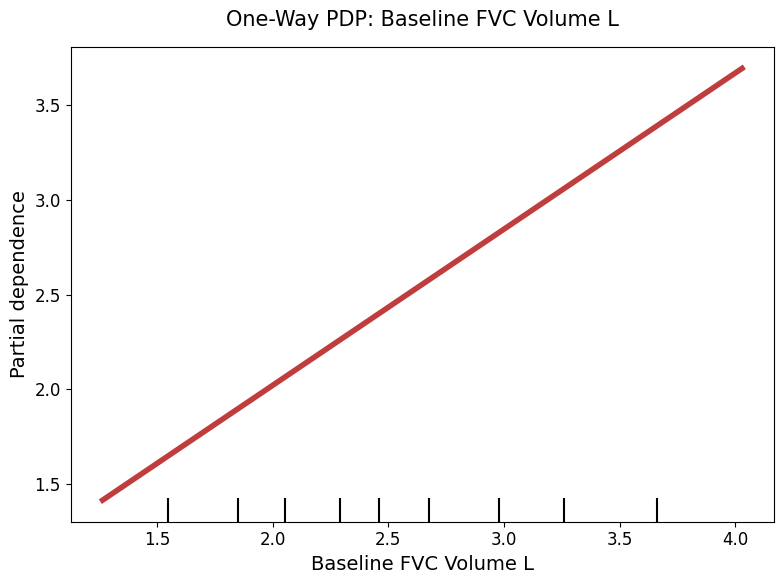

Generating One-way PDP for: FEV1 Volume L


/home/pansurya/.venv/lib64/python3.9/site-packages/sklearn/inspection/_plot/partial_dependence.py:976: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set_ylim([min_val, max_val])


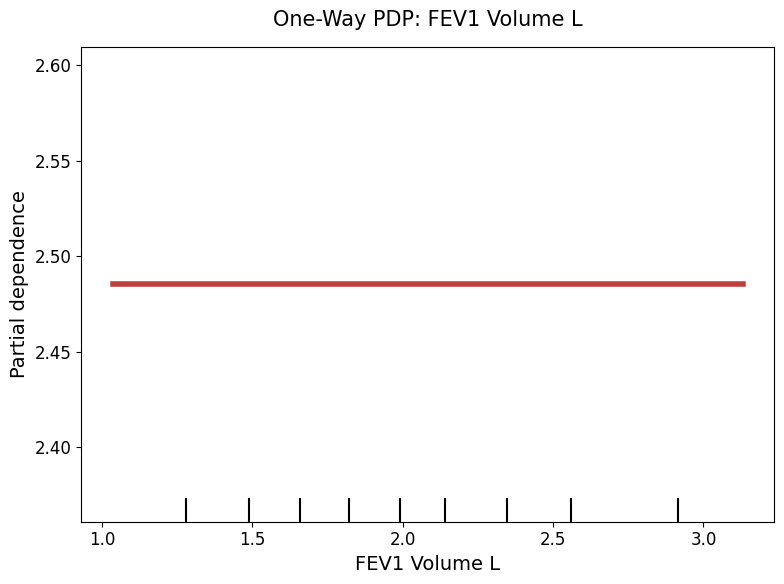

Generating One-way PDP for: log-sigma-5-0-mm-3D_ngtdm_Busyness_right_lung


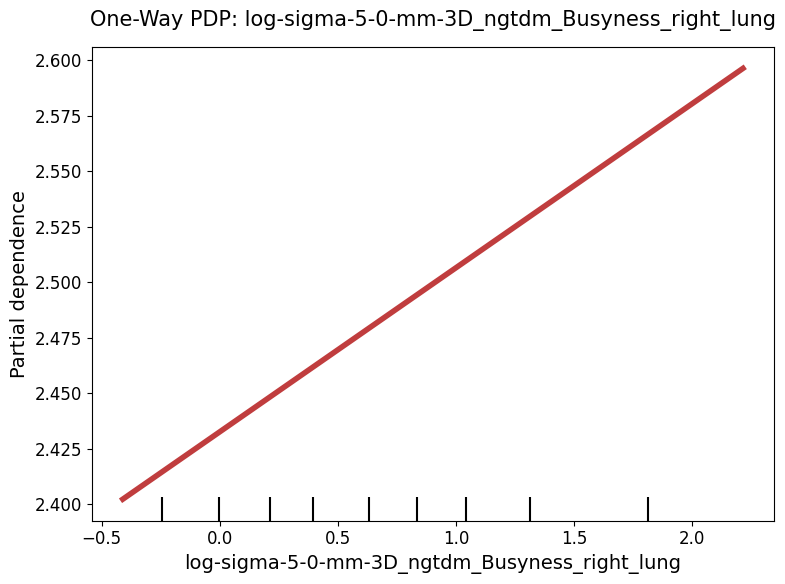

Generating One-way PDP for: original_shape_MinorAxisLength_left_lung


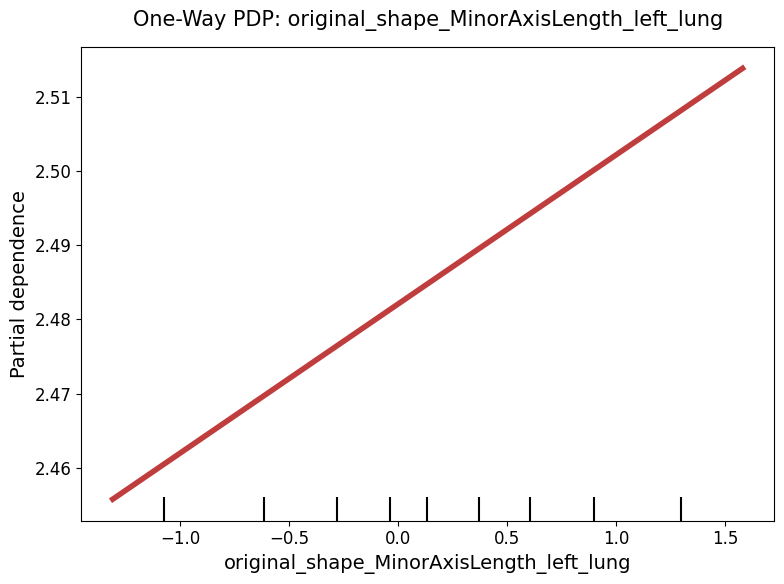

Generating One-way PDP for: wavelet-LHL_glrlm_LongRunLowGrayLevelEmphasis_left_lung


/home/pansurya/.venv/lib64/python3.9/site-packages/sklearn/inspection/_plot/partial_dependence.py:976: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set_ylim([min_val, max_val])


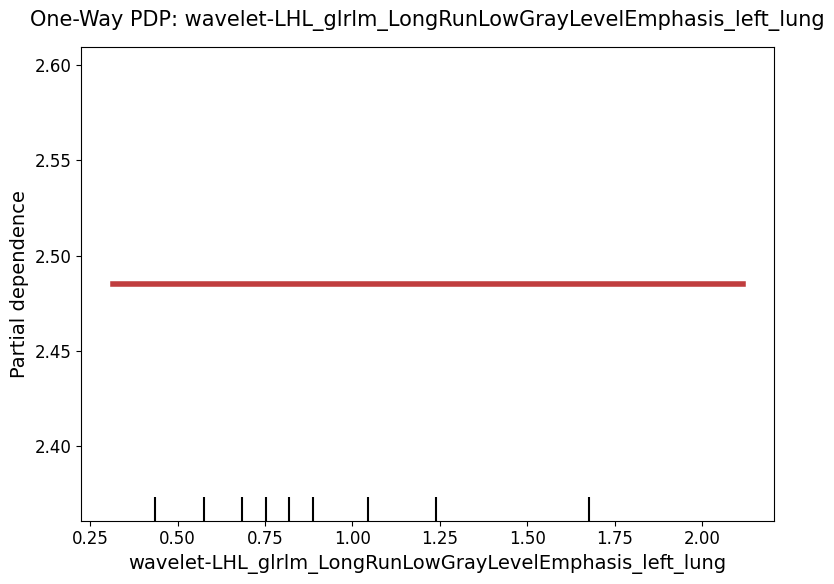

Generating Two-way Interaction PDP...


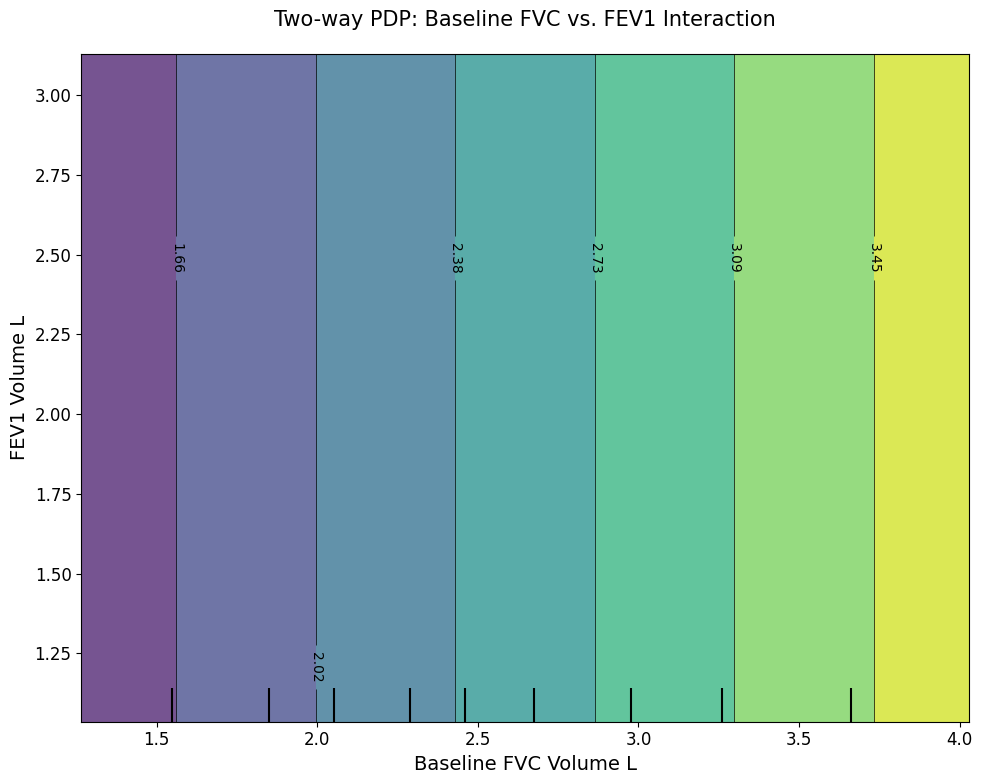

In [22]:
from sklearn.inspection import PartialDependenceDisplay
import matplotlib.pyplot as plt
import matplotlib.lines as mlines

# 1. Define the features for analysis
top_5_features = [
    "Baseline FVC Volume L", 
    "FEV1 Volume L",
    "log-sigma-5-0-mm-3D_ngtdm_Busyness_right_lung",
    "original_shape_MinorAxisLength_left_lung",
    "wavelet-LHL_glrlm_LongRunLowGrayLevelEmphasis_left_lung" 
]

# Define the 2-way interaction pair
interaction_pair = [("Baseline FVC Volume L", "FEV1 Volume L")]

# 2. Set global font sizes for thesis quality
plt.rcParams.update({
    'font.size': 12, 
    'axes.labelsize': 14, 
    'ytick.labelsize': 12,
    'xtick.labelsize': 12
})

# ---------------------------------------------------------
# Part A: One-Way PDP (5 Individual Plots)
# ---------------------------------------------------------
for feature in top_5_features:
    fig, ax = plt.subplots(figsize=(8, 6))
    print(f"Generating One-way PDP for: {feature}")
    
    display = PartialDependenceDisplay.from_estimator(
        model, 
        X_train_filled, 
        features=[feature],
        kind='average', # PDP shows the average marginal effect
        ax=ax,
        grid_resolution=50
    )
    
    # Robust Styling for One-Way Lines
    if hasattr(display, 'lines_') and display.lines_ is not None:
        line_obj = display.lines_[0, 0]
        # Check if it's a list/array of lines or a single Line2D object
        if isinstance(line_obj, (list, np.ndarray)):
            for line in line_obj:
                line.set_color('#c03d3e')
                line.set_linewidth(4)
        else:
            # It's a single Line2D object
            line_obj.set_color('#c03d3e')
            line_obj.set_linewidth(4)
    
    ax.set_title(f"One-Way PDP: {feature}", fontsize=15, pad=15)
    ax.grid(True, linestyle='--', alpha=0.6)
    plt.tight_layout()
    plt.show()

# ---------------------------------------------------------
# Part B: Two-Way PDP (Interaction Plot)
# ---------------------------------------------------------
print("Generating Two-way Interaction PDP...")
# Two-way plots create a contour map to show how features interact
fig, ax = plt.subplots(figsize=(10, 8))

display_2way = PartialDependenceDisplay.from_estimator(
    model,
    X_train_filled,
    features=interaction_pair,
    ax=ax,
    grid_resolution=50
)



plt.title("Two-way PDP: Baseline FVC vs. FEV1 Interaction", fontsize=15, pad=20)
plt.tight_layout()
plt.show()

/tmp/ipykernel_3650755/1706906495.py:48: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df_melted, x="Model", y="R2", palette="Set2")


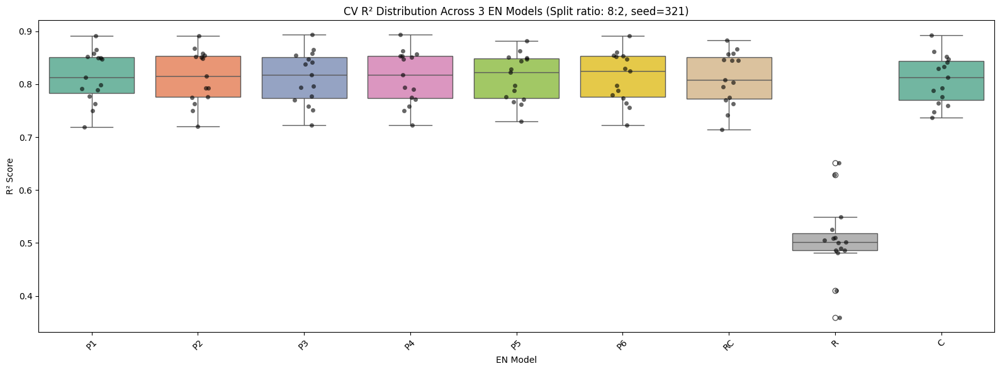

{'P1': (0.814, 0.049), 'P2': (0.814, 0.051), 'P3': (0.812, 0.05), 'P4': (0.813, 0.051), 'P5': (0.812, 0.045), 'P6': (0.813, 0.048), 'RC': (0.811, 0.051), 'R': (0.506, 0.071), 'C': (0.809, 0.047)}


In [7]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# -----------------------------------------
# Your CV results
# -----------------------------------------
pls_results = {
   
"P1": [0.8499021662303697, 0.8657182405140404, 0.7771518476504587, 0.8127353442203078, 0.7628291732075276, 0.8917045812993443, 0.7987719511292112, 0.7895517153671261, 0.8468320534375773, 0.7493583866593225, 0.7195000474170755, 0.8578500234065534, 0.8495909849047337, 0.7915367107122089, 0.8518949819139152],
"P2": [0.8490787576711883, 0.8671359052963563, 0.7747412159879706, 0.8156070399571747, 0.7628148865609397, 0.8915783624956412, 0.7927415112728173, 0.7763843387363235, 0.851563938282861, 0.7503095285112034, 0.7200661809443254, 0.8542342671641064, 0.8507140675189743, 0.7925198882085499, 0.8578858700121699],
"P3": [0.8378386307040281, 0.8657008161697344, 0.776672574217856, 0.8171672532164331, 0.7583369790626662, 0.8932587631892048, 0.7961948725003414, 0.7697224064984325, 0.8414810963116881, 0.751595649807046, 0.7223106676641797, 0.854361346620575, 0.8478783015647927, 0.7942098420854571, 0.8582040590283531],
"P4": [0.8510749315363767, 0.8632954817579356, 0.7715201933492639, 0.8170794781247326, 0.7580824995275686, 0.8938508166533156, 0.7935621886066223, 0.7747168098402701, 0.8567671921796768, 0.7493890507453562, 0.7225201946873905, 0.8535922802043332, 0.8468245561394884, 0.7903483013503385, 0.8528483200629806],
"P5": [0.8289164001823149, 0.8626371121511831, 0.7715164837714686, 0.822534420297039, 0.7659586950224485, 0.8812309902228781, 0.7974757879147709, 0.776188420819623, 0.8436104411060875, 0.7613710297928622, 0.7302213828378743, 0.8514610255611582, 0.8471513262267623, 0.7875497373923459, 0.8495985754402537],
"P6": [0.8300913025639022, 0.8604631601845222, 0.7800445283603714, 0.8248305839521322, 0.7645940061718595, 0.8911925254584945, 0.7974888990774871, 0.7732126402337829, 0.8519438754589648, 0.7557601030341409, 0.7220559081392677, 0.854460705534767, 0.8474403963210349, 0.7882908000240968, 0.8535544381565747],
"RC": [0.8451280356714355, 0.8567102115428339, 0.7751754699768421, 0.807588076280595, 0.7707020555551813, 0.8830866419358774, 0.7950359588903128, 0.7632452510007237, 0.8657820121292865, 0.7412506156398349, 0.714738460609015, 0.8449283127121281, 0.8461755173448127, 0.8038572611132123, 0.8584951333657166],
"R": [0.5257104791456415, 0.48663111198386877, 0.5100303562139092, 0.5486979406275487, 0.48921680292512393, 0.48607462196273576, 0.505090312266113, 0.40986588160587456, 0.6508063992776769, 0.5000201546907213, 0.3588781958924744, 0.5021933624217346, 0.6291552233149798, 0.4818721775421889, 0.5089296600072744],
 "C": [0.8332034162395368, 0.8619788676168155, 0.7647524111993251, 0.8125902354842292, 0.7596290725392665, 0.8924876547564977, 0.792931281774716, 0.7762572485540523, 0.8299093205662293, 0.7472274956676928, 0.736878662804751, 0.8467937474187655, 0.8417490064355213, 0.7882801968695461, 0.8526809550711562],
 # "R": [0.5052773837691227, 0.4753963071671864, 0.5013988220383401, 0.5464157499455298, 0.47519908007344214, 0.46284732525648464, 0.4736247482671534, 0.41024364999044893, 0.6451814793033495, 0.4494890300939307, 0.34634928493765405, 0.5062687002983743, 0.5873468679567269, 0.4629992453705617, 0.5084557215730123],
}

# -----------------------------------------
# Your test R² values
# -----------------------------------------
test_r2 = {

"P1":   0.838,
"P2":    0.845,
"P3":   0.846,
"P4": 0.848,
"P5": 0.847,
"P6":  0.847,
"RC": 0.842,
"R": 0.586,
"C":0.839,
}

# -----------------------------------------
# Convert dictionary → long-format DataFrame
# -----------------------------------------
df = pd.DataFrame(pls_results)
df_melted = df.melt(var_name="Model", value_name="R2")

# -----------------------------------------
# Plot: Individual boxplots for each model
# -----------------------------------------
plt.figure(figsize=(16, 6))
sns.boxplot(data=df_melted, x="Model", y="R2", palette="Set2")
sns.stripplot(data=df_melted, x="Model", y="R2", color="black", alpha=0.6, jitter=True)

# # -----------------------------------------
# # Add full-width red horizontal lines at each model's median
# # -----------------------------------------
# medians = df_melted.groupby("Model")["R2"].median()
# for model, median_value in medians.items():
#     plt.axhline(y=median_value, color="red", linestyle="--", linewidth=1.5)
#     plt.text(
#         x=-0.4,
#         y=median_value,
#         s=f"{median_value:.3f}",
#         color="red",
#         va="center",
#         ha="right",
#         fontsize=10,
#         fontweight="bold"
#     )

# # -----------------------------------------
# # Add full-width blue horizontal lines for test R²
# # -----------------------------------------
# for model, test_value in test_r2.items():
#     plt.axhline(y=test_value, color="blue", linestyle="--", linewidth=1.5)
#     plt.text(
#         x=len(test_r2) + 0.4,
#         y=test_value,
#         s=f"Test R² {model}: {test_value:.3f}",
#         color="blue",
#         va="center",
#         ha="left",
#         fontsize=10,
#         fontweight="bold"
#     )

# -----------------------------------------
# Labels and formatting
# -----------------------------------------
plt.title("CV R² Distribution Across 3 EN Models (Split ratio: 8:2, seed=321)")
plt.xlabel("EN Model")
plt.ylabel("R² Score")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

import numpy as np



import numpy as np



results = {}

for key, values in pls_results.items():
    arr = np.array(values)
    median = np.median(arr)
    mean = np.mean(arr)
    std = np.std(arr, ddof=1)  # sample standard deviation
    results[key] = (
        # round(median, 3),
        round(mean, 3),
        round(std, 3)
    )

results


print(results)



/tmp/ipykernel_3650755/2810268383.py:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x='Coefficient', y='Feature', data=df, palette=colors)


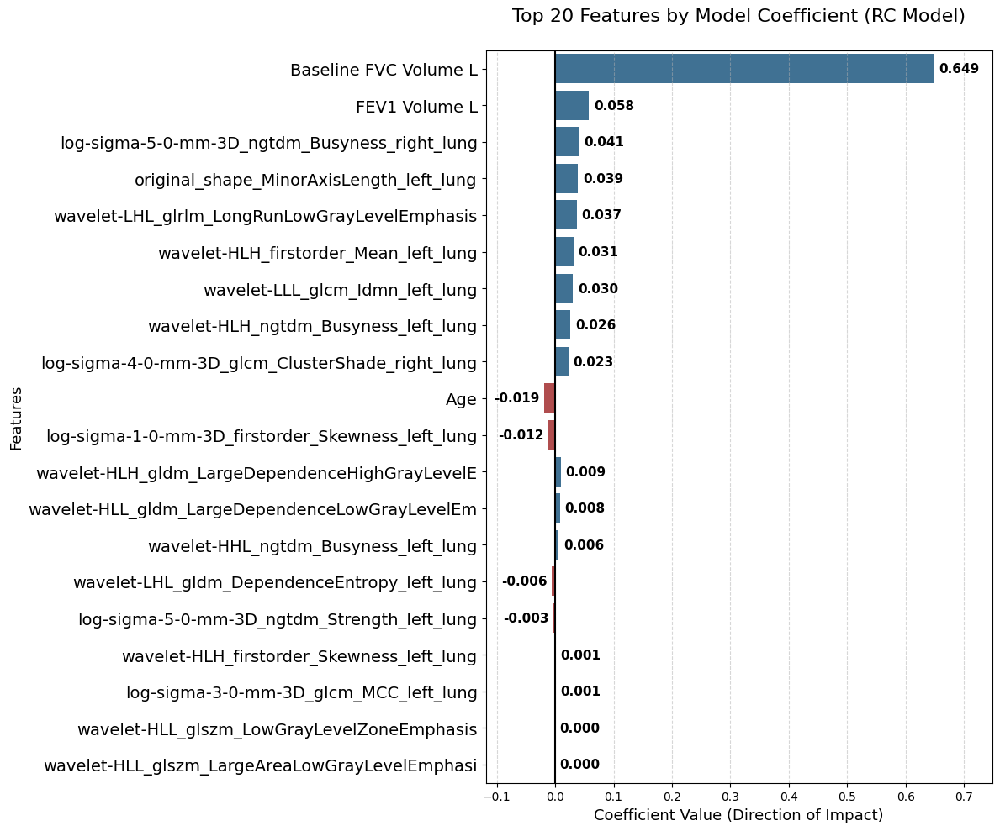

In [17]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Prepare the data
data = {
    'Feature': [
        'Baseline FVC Volume L', 'FEV1 Volume L', 'log-sigma-5-0-mm-3D_ngtdm_Busyness_right_lung',
        'original_shape_MinorAxisLength_left_lung', 'wavelet-LHL_glrlm_LongRunLowGrayLevelEmphasis',
        'wavelet-HLH_firstorder_Mean_left_lung', 'wavelet-LLL_glcm_Idmn_left_lung',
        'wavelet-HLH_ngtdm_Busyness_left_lung', 'log-sigma-4-0-mm-3D_glcm_ClusterShade_right_lung',
        'Age', 'log-sigma-1-0-mm-3D_firstorder_Skewness_left_lung',
        'wavelet-HLH_gldm_LargeDependenceHighGrayLevelE', 'wavelet-HLL_gldm_LargeDependenceLowGrayLevelEm',
        'wavelet-HHL_ngtdm_Busyness_left_lung', 'wavelet-LHL_gldm_DependenceEntropy_left_lung',
        'log-sigma-5-0-mm-3D_ngtdm_Strength_left_lung', 'wavelet-HLH_firstorder_Skewness_left_lung',
        'log-sigma-3-0-mm-3D_glcm_MCC_left_lung', 'wavelet-HLL_glszm_LowGrayLevelZoneEmphasis',
        'wavelet-HLL_glszm_LargeAreaLowGrayLevelEmphasi'
    ],
    'Coefficient': [
        0.648916, 0.057841, 0.041486, 0.039299, 0.036615, 0.031332, 0.030423, 0.025970, 0.022784,
        -0.019087, -0.012099, 0.009389, 0.008235, 0.006031, -0.005539, -0.002580, 0.000927,
        0.000729, 0.000000, 0.000000
    ]
}

df = pd.DataFrame(data)
df['AbsCoefficient'] = df['Coefficient'].abs()
df = df.sort_values(by='AbsCoefficient', ascending=False).head(20)

# 2. Create the plot
plt.figure(figsize=(12, 10))
# Using colors from your provided style
colors = ['#3274a1' if x >= 0 else '#c03d3e' for x in df['Coefficient']]

ax = sns.barplot(x='Coefficient', y='Feature', data=df, palette=colors)

# --- ADDED THIS LINE TO INCREASE FEATURE NAME FONT SIZE ---
plt.yticks(fontsize=14) 
# ---------------------------------------------------------

# 3. Dynamic Text Placement (3 Decimals)
max_val = df['Coefficient'].max()
min_val = df['Coefficient'].min()
offset = (max_val - min_val) * 0.012 # Adjusting offset for 3 decimals

for i, v in enumerate(df['Coefficient']):
    if v >= 0:
        # Place label to the right of positive bars
        ax.text(v + offset, i, f'{v:.3f}', va='center', ha='left', fontsize=11, fontweight='bold')
    else:
        # Place label to the left of negative bars
        ax.text(v - offset, i, f'{v:.3f}', va='center', ha='right', fontsize=11, fontweight='bold')

# 4. Final Styling
plt.title('Top 20 Features by Model Coefficient (RC Model)', fontsize=16, pad=25)
plt.xlabel('Coefficient Value (Direction of Impact)', fontsize=13)
plt.ylabel('Features', fontsize=13)

# Expand X-limits to prevent labels from being cut off
plt.xlim(min_val - 0.1, max_val + 0.1)

plt.grid(axis='x', linestyle='--', alpha=0.5)
plt.axvline(0, color='black', linewidth=1.5)
plt.tight_layout()

plt.show()